In [1]:
import matplotlib.pyplot as plt
import sklearn.datasets as datasets

import torch
from torch import nn
from torch import optim

from nflows.flows.base import Flow
from nflows.distributions.normal import StandardNormal
from nflows.transforms.base import CompositeTransform
from nflows.transforms.autoregressive import MaskedAffineAutoregressiveTransform
from nflows.transforms.permutations import ReversePermutation

import corner
import pandas as pd
import numpy as np
import pickle

In [2]:
torch.manual_seed(0)
np.random.seed(0)

In [3]:
nsamplesdata = 200000

In [4]:
ssfilename = f'transform_nsamples{nsamplesdata}.pkl'
datafilename = f'fullpop_nsamples{nsamplesdata}.pkl'
try:
    data = pd.read_pickle(datafilename)
    ss = pickle.load(open(ssfilename,'rb'))
    
except FileNotFoundError:
    data = pd.read_pickle('/mnt/home/landerson/extinctions/fullpop.pkl').sample(nsamplesdata)
    data.to_pickle(datafilename)
    from sklearn.preprocessing import StandardScaler
    ss = StandardScaler()
    ss.fit(np.array(data))
    import pickle
    pickle.dump(ss, open(f'transform_nsamples{nsamplesdata}.pkl','wb'))


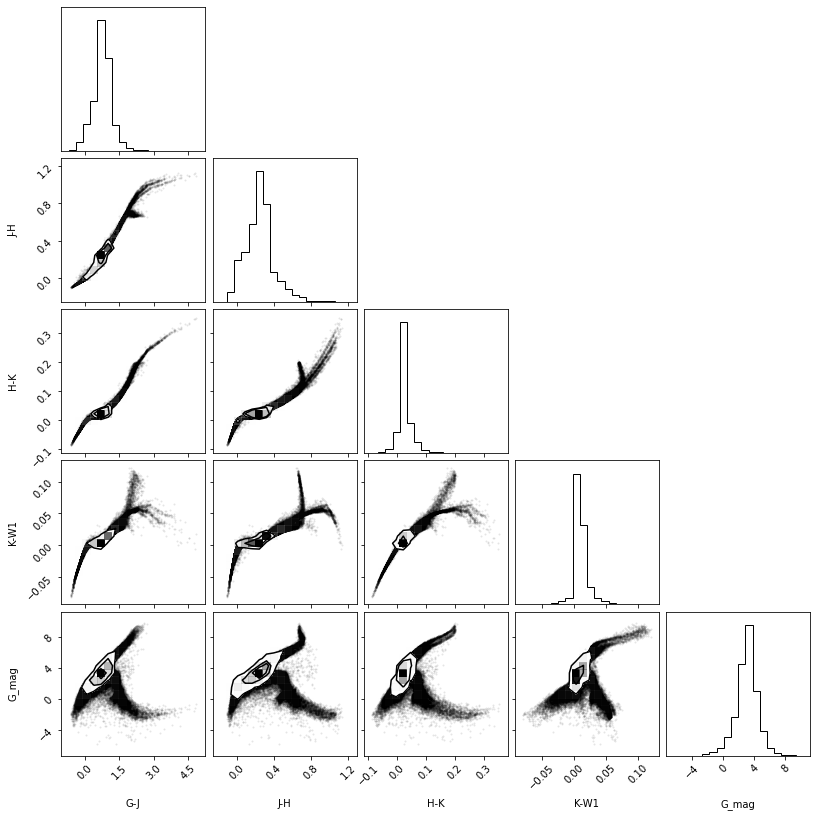

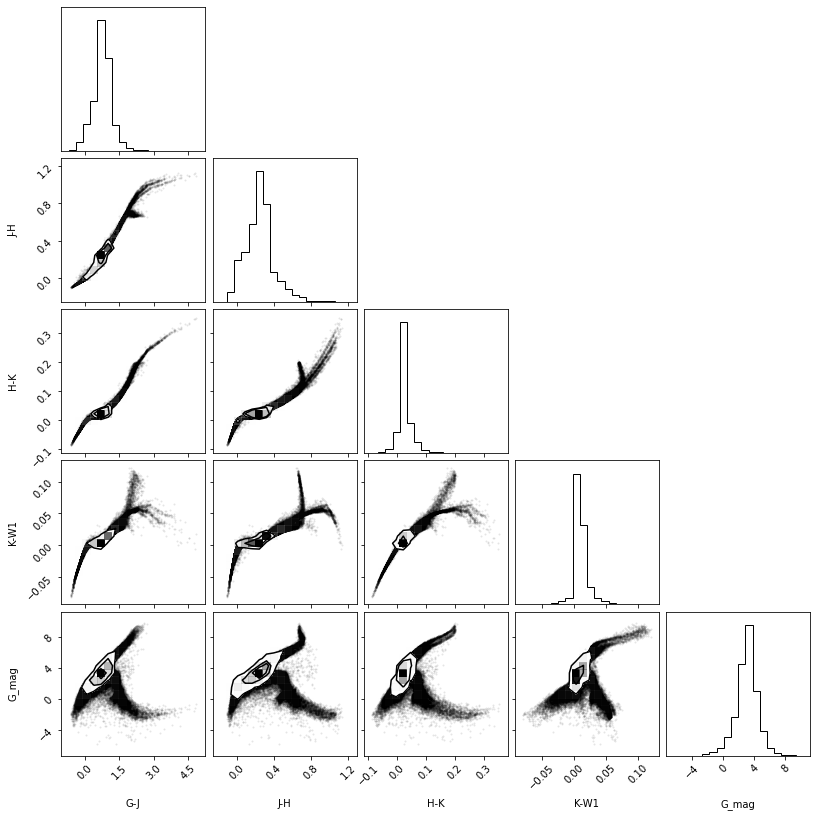

In [5]:
labels = data.columns
bins = [np.linspace(np.min(data[c]), np.max(data[c]), 100) for c in data.columns]
means = [data[c].mean() for c in data.columns]
stds = [data[c].std() for c in data.columns]
binrange = [[np.min(b)-s, np.max(b)+s] for b, s in zip(bins, stds)]#[[np.min(b)-s, np.max(b)+s] for b, s in zip(bins, stds)]
corner.corner(data, label=labels, range=binrange)

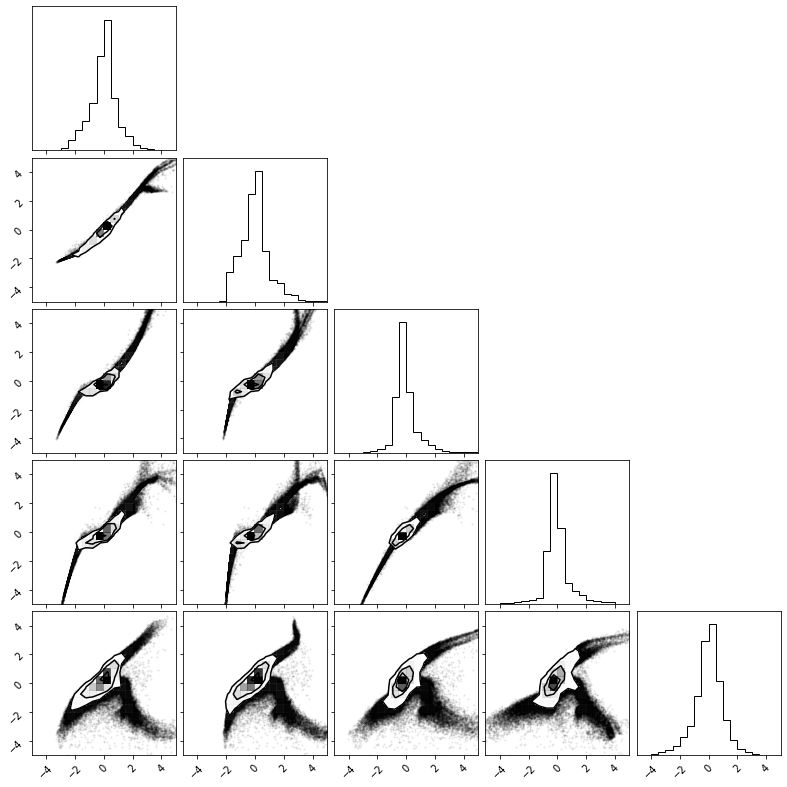

In [6]:
from sklearn.preprocessing import StandardScaler
ss = StandardScaler()
ss.fit(np.array(data))
corner.corner(ss.transform(data.values), label=labels, range=[[-5, 5]]*5)

from torch.utils.data import TensorDataset, DataLoader

data = torch.tensor(ss.transform(data.values), dtype=torch.float32)
#data = torch.from_numpy(np.array(data).astype(np.float32))

dataset = TensorDataset(data)
batch = 1024
N = len(data)
train = DataLoader(dataset[:-(N//5)], batch_size=batch, shuffle=True)
test = DataLoader(dataset[-(N//5):], batch_size=batch, shuffle=False)


In [7]:
xline = torch.linspace(-5, 5, 5)
grids = torch.meshgrid([xline]*5)
xyinput = torch.cat([x.reshape(-1, 1) for x in grids], dim=1)

In [8]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu") 
print(device)
#torch.set_default_tensor_type('torch.cuda.FloatTensor')

cuda:0


In [9]:
base_dist = StandardNormal(shape=[5]).to(device)
samples = base_dist.sample(num_samples=10)
print(samples.device)

cuda:0


In [10]:
#device=torch.device('cpu')

In [15]:
num_layers = 8
base_dist = StandardNormal(shape=(5,))
samples = base_dist.sample(num_samples=10)
print(samples.device)
transforms = []
for _ in range(num_layers):
    transforms.append(ReversePermutation(features=5).to(device))
    transforms.append(MaskedAffineAutoregressiveTransform(features=5, 
                                                          hidden_features=128).to(device))
transform = CompositeTransform(transforms).to(device)

flow = Flow(transform, base_dist).to(device)
samples = base_dist.sample(num_samples=10)
print(samples.device)
learning_rate = 0.005 #1e-3          
max_lr = 0.005
epochs = 2000000
optimizer = optim.Adam(flow.parameters(), weight_decay=1e-6, amsgrad=True, lr=learning_rate)
sched = torch.optim.lr_scheduler.OneCycleLR(optimizer,
                                            max_lr=max_lr,
                                            steps_per_epoch=len(train),
                                            epochs=epochs)

cuda:0
cuda:0


In [16]:
print([p.is_cuda for p in flow.parameters()])

[True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True, True]


In [17]:
binrange_ss = [[-8,8]]*5

100 1.9432811737060547 1.8701398372650146 0.7719974517822266 -inf
200 -0.7656065225601196 -0.8078556656837463 1.54307222366333 -1.3479445795987169e+35
300 -1.5796961784362793 -1.691785454750061 0.3105583190917969 -inf
400 -1.7822622060775757 -1.7805354595184326 0.5443472862243652 -inf
500 -2.3465139865875244 -2.3033905029296875 0.02274608612060547 -inf
600 -1.9224663972854614 -1.9706441164016724 1.302344799041748 -inf
700 -1.9473401308059692 -2.0539801120758057 0.5990724563598633 -inf
800 -2.510164737701416 -2.5435755252838135 0.7371010780334473 -inf
900 -2.422846794128418 -2.4406073093414307 0.8532118797302246 -inf
1000 0.8027651906013489 0.6610609292984009 -1.3197617530822754 -inf
-1.3197617530822754 -inf


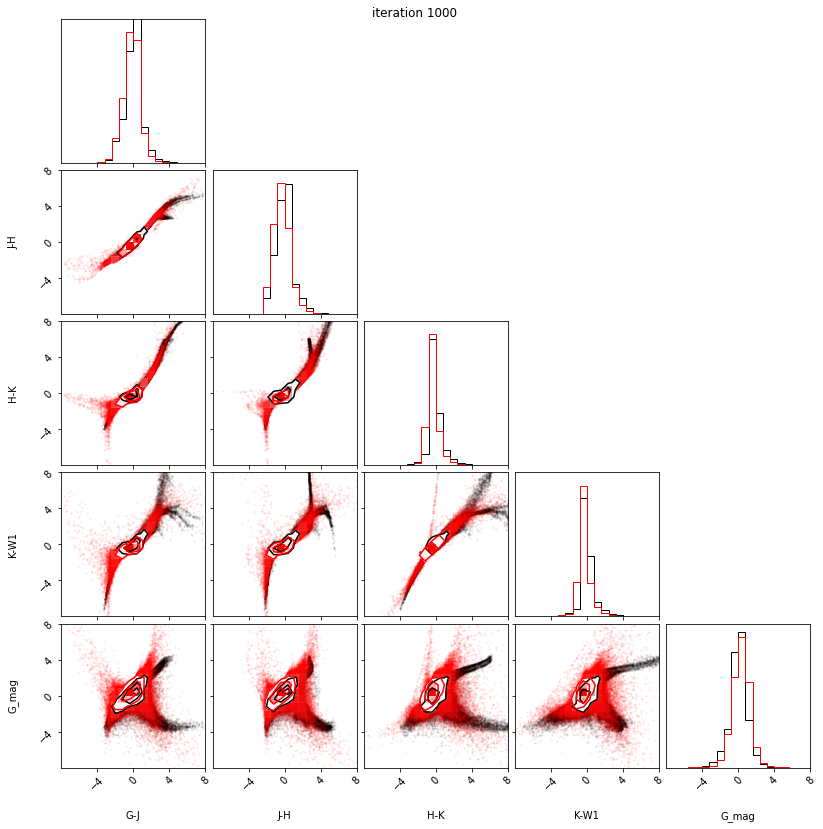

1100 -2.7431275844573975 -2.7783615589141846 0.8912525177001953 -inf
1200 -2.300438165664673 -2.4896111488342285 1.0110788345336914 -inf
1300 -2.616074800491333 -2.676239013671875 0.5756754875183105 -inf
1400 -2.8284318447113037 -2.873757839202881 0.6860308647155762 -inf
1500 -2.412883996963501 -2.4638993740081787 0.966463565826416 -inf
1600 2.203779935836792 2.0693986415863037 -1.2111124992370605 -inf
1700 -1.1436277627944946 -1.1828173398971558 0.7033038139343262 -inf
1800 -2.0071566104888916 -2.0409207344055176 0.5758876800537109 -inf
1900 -2.541811943054199 -2.5698328018188477 0.06773090362548828 -inf
2000 -2.823920488357544 -2.742445707321167 -0.2646651268005371 -inf
-0.2646651268005371 -inf


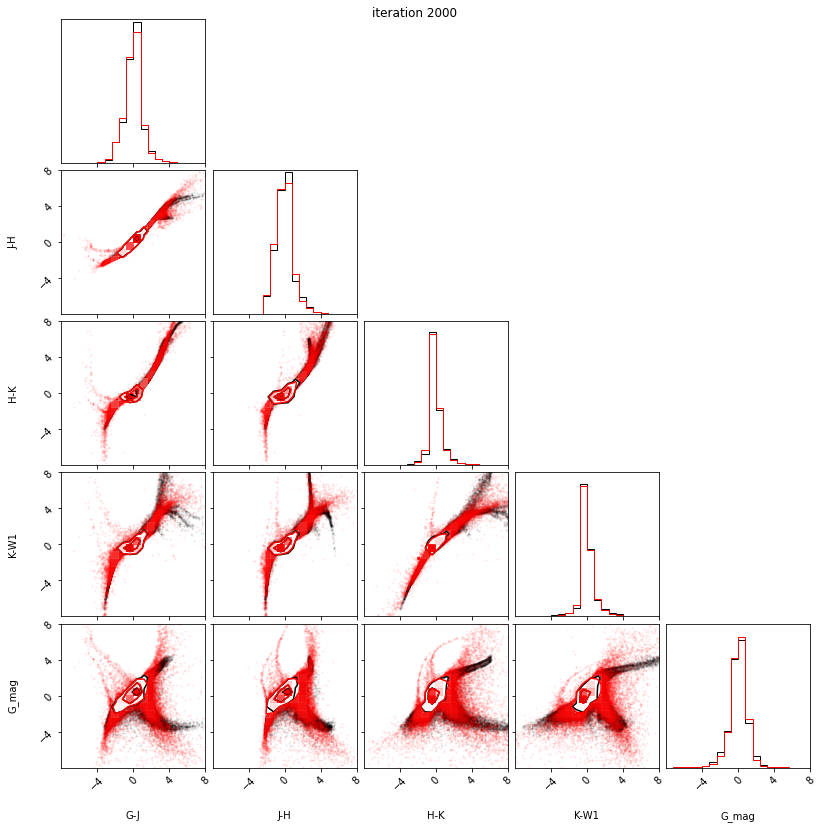

2100 -2.5208187103271484 -2.5103800296783447 -0.18010187149047852 -inf
2200 -3.1549086570739746 -3.1862707138061523 0.10151481628417969 -inf
2300 -3.1340723037719727 -3.0529043674468994 0.39107227325439453 -inf
2400 -1.5604525804519653 -1.791153073310852 -0.41906213760375977 -inf
2500 -3.3964672088623047 -3.416844367980957 0.21216726303100586 -inf
2600 -0.6789395213127136 -0.7106976509094238 0.48249053955078125 -inf
2700 -2.4144463539123535 -2.4405875205993652 0.4088115692138672 -inf
2800 -3.0677781105041504 -3.095235824584961 0.3089118003845215 -inf
2900 -3.31350040435791 -3.1997621059417725 0.09138822555541992 -inf
3000 -2.907741069793701 -2.925051212310791 0.4822416305541992 -inf
0.4822416305541992 -inf


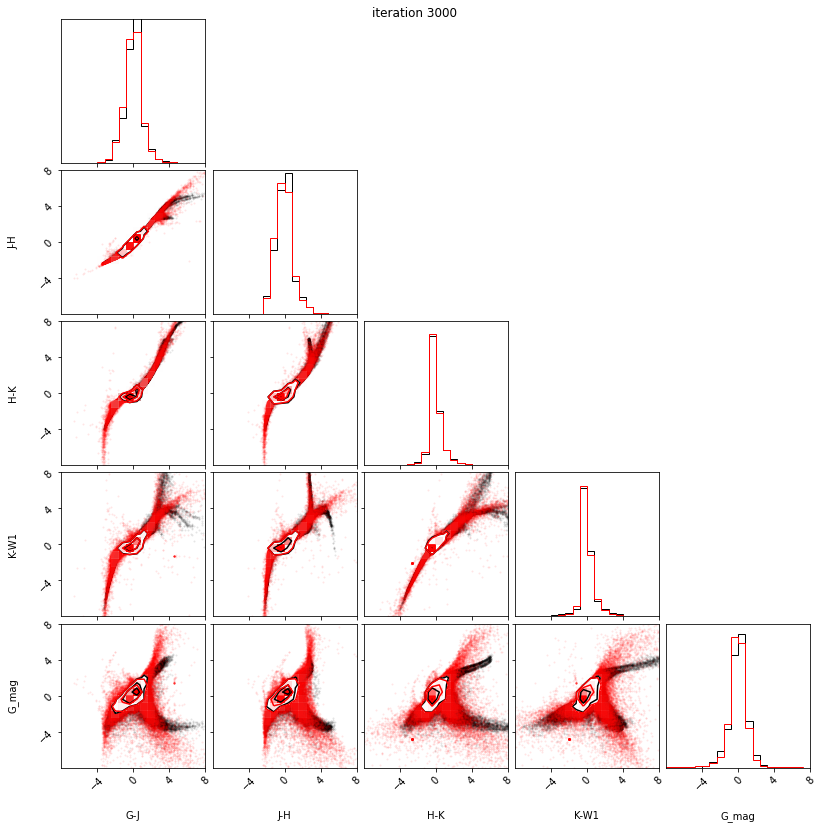

3100 -1.3236360549926758 -1.2851427793502808 -1.311631202697754 -inf
3200 -3.4526302814483643 -3.5574405193328857 0.439450740814209 -inf
3300 -3.563633918762207 -3.5948104858398438 0.551180362701416 -inf
3400 -1.7288482189178467 -1.7719066143035889 0.08899259567260742 -inf
3500 -3.7518608570098877 -3.7835867404937744 0.749664306640625 -inf
3600 -3.708540439605713 -3.6809592247009277 0.6265754699707031 -inf
3700 -3.543217182159424 -3.6143076419830322 0.48396873474121094 -inf
3800 -3.11954402923584 -3.3426241874694824 0.5938863754272461 -inf
3900 -3.775226354598999 -3.812553882598877 0.6658444404602051 -inf
4000 -3.9830689430236816 -3.9125444889068604 0.687993049621582 -inf
0.687993049621582 -inf


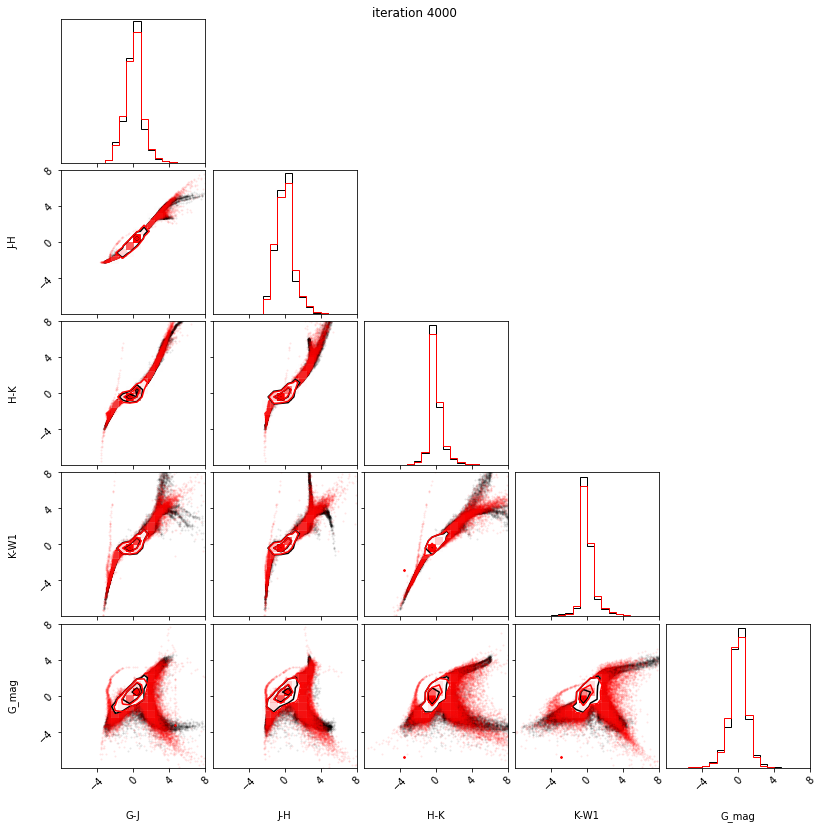

4100 -4.168807506561279 -4.194997310638428 0.6947269439697266 -inf
4200 -4.066527366638184 -4.242173671722412 0.5243325233459473 -inf
4300 -4.103871822357178 -4.1181559562683105 0.833747386932373 -inf
4400 -3.8668198585510254 -4.063724994659424 0.797156810760498 -inf
4500 -4.412847518920898 -4.357987880706787 0.6957182884216309 -inf
4600 -4.279507637023926 -4.340427398681641 0.9034442901611328 -inf
4700 -4.5360941886901855 -4.509565353393555 0.5805606842041016 -inf
4800 -4.198251247406006 -4.259435653686523 0.6244096755981445 -inf
4900 -1.4900853633880615 -1.6021095514297485 -0.7580318450927734 -inf
5000 -4.463804721832275 -4.4975504875183105 0.7845430374145508 -inf
0.7845430374145508 -inf


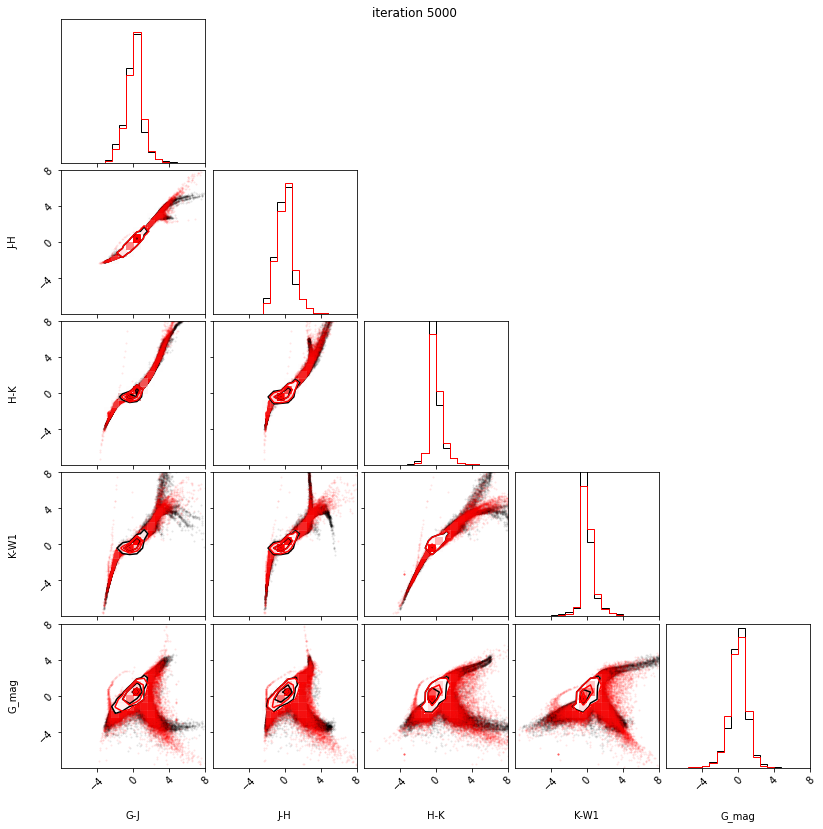

5100 -4.215759754180908 -4.217006683349609 0.6022119522094727 -inf
5200 -3.7536182403564453 -3.230451822280884 0.7625627517700195 -inf
5300 -4.668946266174316 -4.699746608734131 0.818056583404541 -inf
5400 -4.604013919830322 -4.533380508422852 0.7437233924865723 -inf
5500 -4.722777843475342 -4.788289546966553 0.7269072532653809 -inf
5600 -4.389807224273682 -4.367282867431641 0.7563543319702148 -inf
5700 -4.885555267333984 -4.90556526184082 0.6881217956542969 -inf
5800 -4.814383029937744 -4.39547061920166 0.48516845703125 -inf
5900 -4.973537445068359 -5.014444351196289 0.748967170715332 -inf
6000 -1.8408308029174805 -1.2812836170196533 -2.267148494720459 -inf
-2.267148494720459 -inf


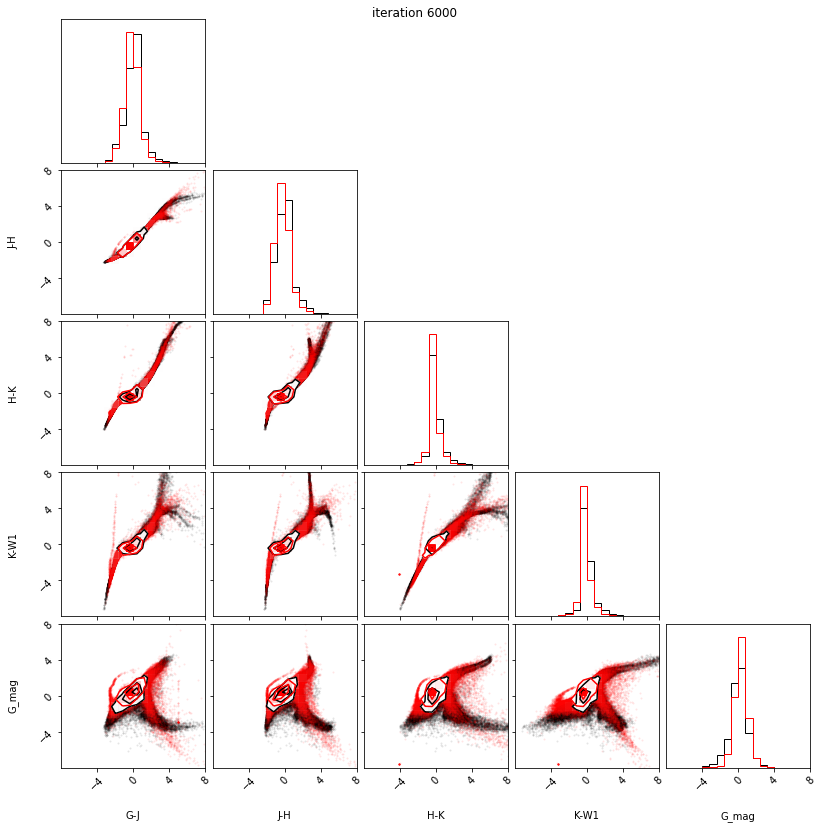

6100 -4.845457553863525 -4.865658760070801 1.205307960510254 -inf
6200 -5.060054302215576 -5.081845283508301 0.6834049224853516 -inf
6300 -4.735294342041016 -4.868806838989258 0.7484641075134277 -inf
6400 -4.227792263031006 -3.3772647380828857 0.5254101753234863 -inf
6500 -5.021825790405273 -5.089319229125977 0.9434409141540527 -inf
6600 -5.113907814025879 -5.19110631942749 0.680903434753418 -inf
6700 -4.418446063995361 -4.509517669677734 0.6313033103942871 -inf
6800 -4.979164123535156 -4.729516506195068 0.6740145683288574 -inf
6900 -5.140115261077881 -5.002751350402832 0.5339665412902832 -inf
7000 -4.832469940185547 -4.89864444732666 0.6494345664978027 -inf
0.6494345664978027 -inf


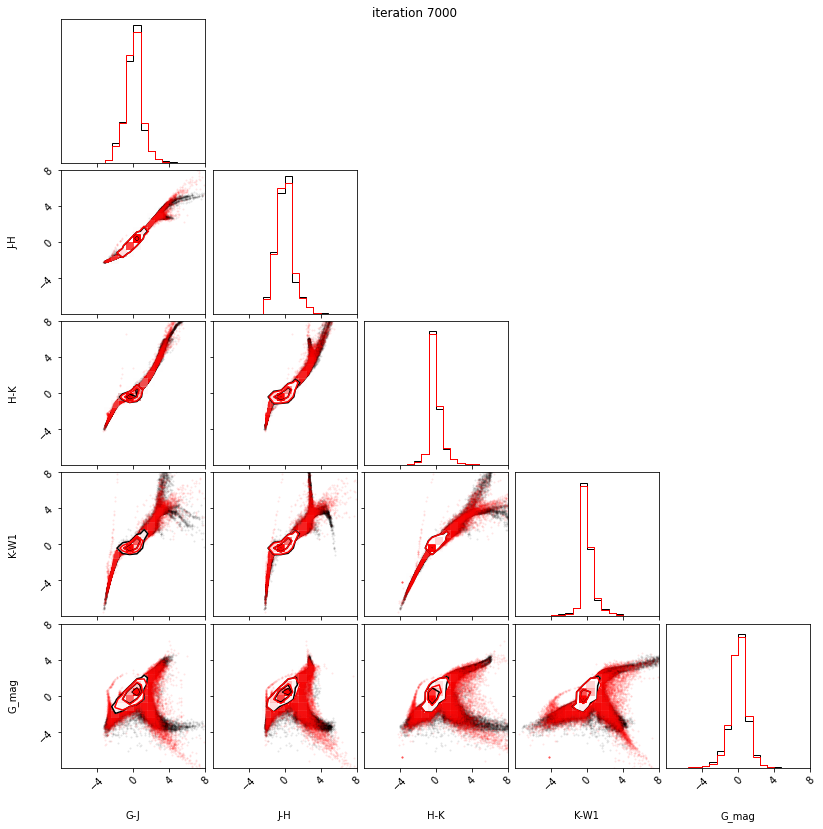

7100 -5.336579322814941 -5.344162940979004 0.7312569618225098 -inf
7200 -4.5751848220825195 -4.9210100173950195 0.9190187454223633 -inf
7300 -5.284536361694336 -5.279275417327881 0.6117610931396484 -inf
7400 -5.200150489807129 -5.294126987457275 0.6239242553710938 -inf
7500 -5.3629984855651855 -5.406357765197754 0.6081767082214355 -inf
7600 -3.1016061305999756 -3.540097951889038 0.6377081871032715 -inf
7700 -5.245235919952393 -5.287417888641357 0.6551599502563477 -inf
7800 -1.8931227922439575 -1.2219898700714111 -0.675990104675293 -inf
7900 -5.2861647605896 -5.303767204284668 0.7157487869262695 -inf
8000 -0.4537893831729889 -0.4595605432987213 -0.5468497276306152 -inf
-0.5468497276306152 -inf


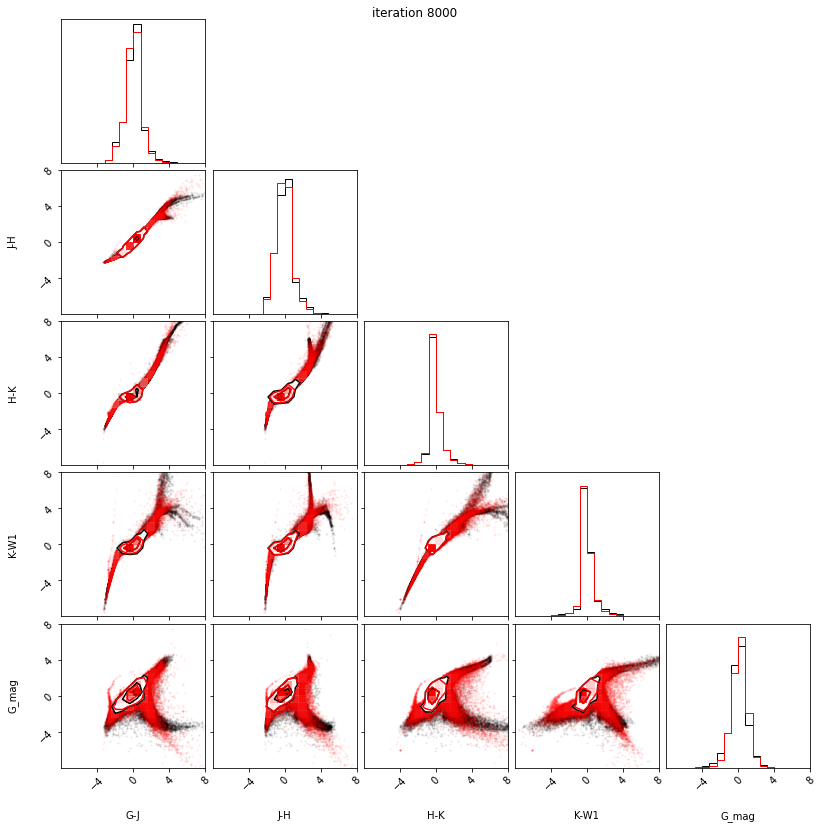

8100 -5.222445011138916 -5.259604454040527 0.9433846473693848 -inf
8200 -5.032070636749268 -5.462097644805908 0.3527212142944336 -inf
8300 -5.34804105758667 -5.35981559753418 0.8622474670410156 -inf
8400 -5.352925777435303 -5.4519219398498535 0.6030678749084473 -inf
8500 -5.498051643371582 -5.372481346130371 0.7167496681213379 -inf
8600 -5.50839900970459 -5.549498081207275 0.7633247375488281 -inf
8700 -5.269453048706055 -5.039011001586914 0.8391094207763672 -inf
8800 -5.484501838684082 -5.258350372314453 0.8744449615478516 -inf
8900 -5.180230140686035 -5.0714802742004395 0.7918305397033691 -inf
9000 -5.496800422668457 -5.484297752380371 0.7387404441833496 -inf
0.7387404441833496 -inf


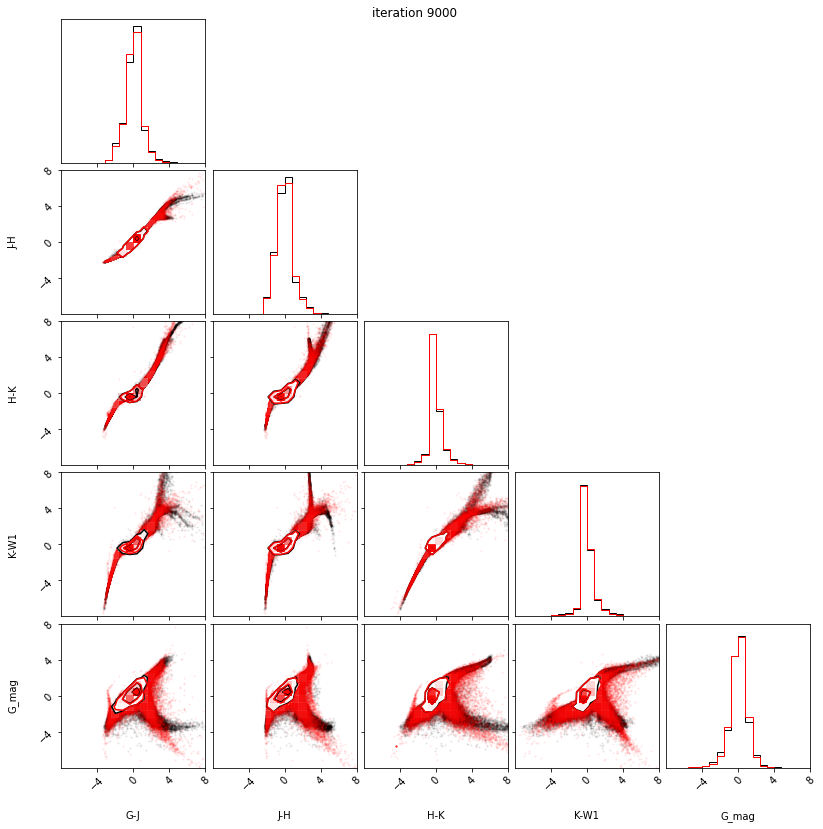

9100 -5.4532623291015625 -5.347495079040527 0.4393730163574219 -inf
9200 -5.47832727432251 -5.539389133453369 0.805518627166748 -inf
9300 -5.190317153930664 -4.5952467918396 0.5805106163024902 -inf
9400 -5.5918450355529785 -5.534923553466797 0.9068536758422852 -inf
9500 -5.384392738342285 -5.562168598175049 0.5434665679931641 -inf
9600 -4.451314926147461 -4.622309684753418 1.007211685180664 -inf
9700 -5.587997913360596 -5.617096424102783 0.7130336761474609 -inf
9800 -5.30531120300293 -5.570611476898193 0.6596713066101074 -inf
9900 -4.802891254425049 -4.197259902954102 1.1289691925048828 -inf
10000 -5.661934852600098 -5.6927337646484375 0.5733895301818848 -inf
0.5733895301818848 -inf


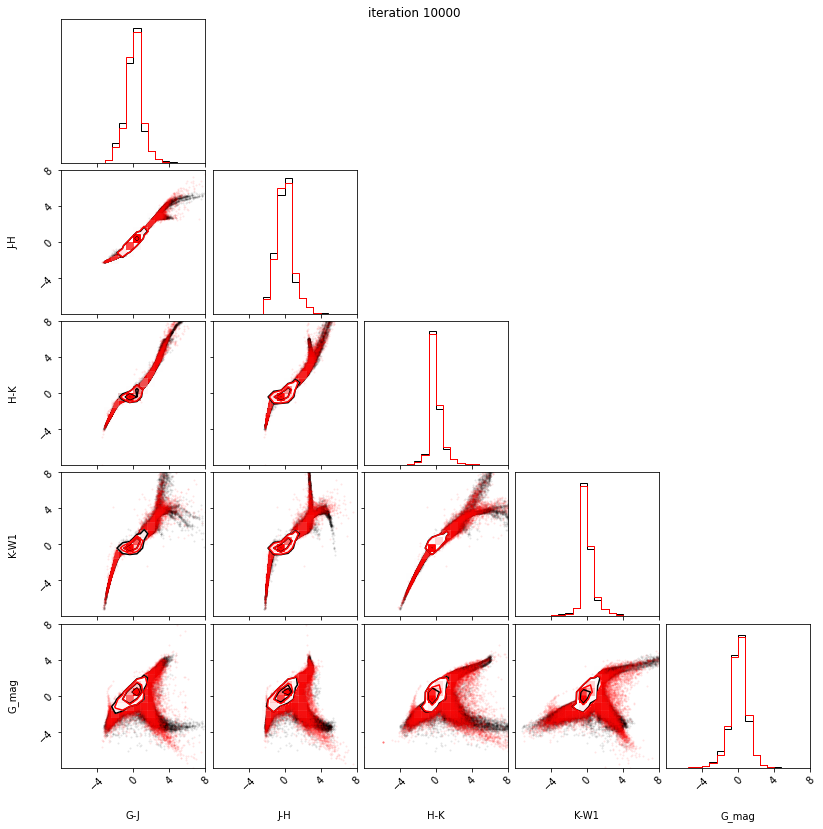

10100 -5.400390625 -5.3741912841796875 1.0135693550109863 -inf
10200 -5.742156982421875 -5.768657684326172 0.6197352409362793 -inf
10300 -5.506800651550293 -5.574028015136719 1.0623798370361328 -inf
10400 -5.57116174697876 -5.752847194671631 0.4284520149230957 -inf
10500 -3.854994535446167 -4.238802433013916 0.5035190582275391 -inf
10600 -5.032136917114258 -4.6692986488342285 0.7316341400146484 -inf
10700 -5.702317714691162 -5.628148078918457 0.8003463745117188 -inf
10800 -5.339256286621094 -5.383145809173584 0.4502882957458496 -inf
10900 -5.759098529815674 -5.796583652496338 0.5957999229431152 -inf
11000 -5.317601203918457 -5.292477130889893 -0.2857232093811035 -inf
-0.2857232093811035 -inf


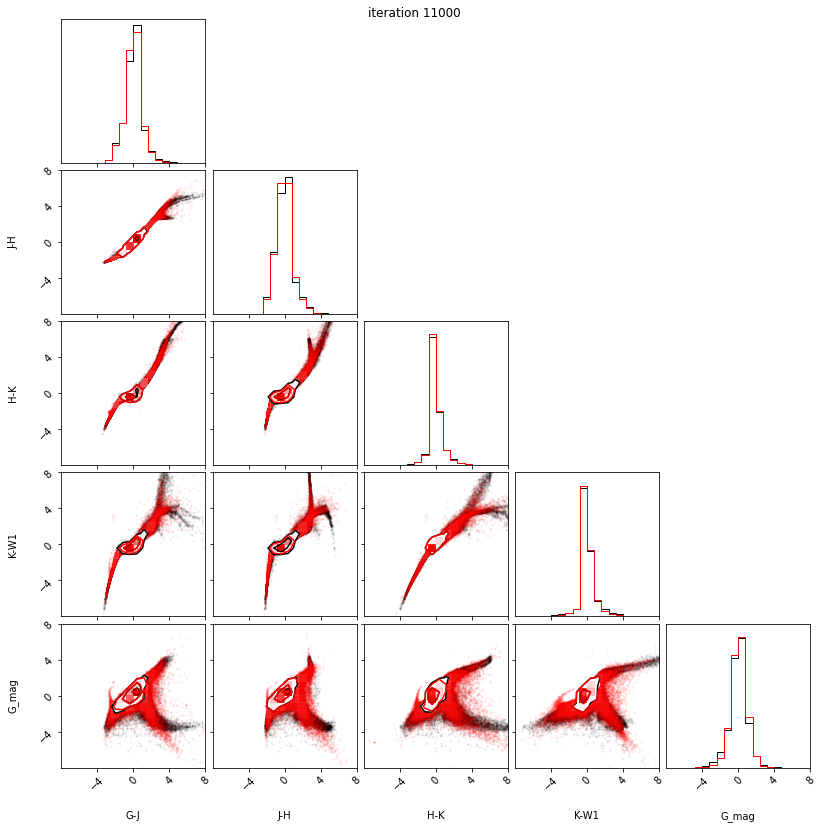

11100 -5.834540367126465 -5.881067276000977 0.40773773193359375 -inf
11200 -5.349803924560547 -5.325096130371094 0.8422274589538574 -inf
11300 -5.845653057098389 -5.873013973236084 0.5218100547790527 -inf
11400 -5.7366814613342285 -5.782981872558594 0.38024282455444336 -inf
11500 -5.023070812225342 -5.3545708656311035 -0.3852653503417969 -inf
11600 -5.883295059204102 -5.90526819229126 0.28106689453125 -inf
11700 -5.770918846130371 -5.775542259216309 0.3864006996154785 -inf
11800 -5.83434534072876 -5.920206546783447 0.37478208541870117 -inf
11900 -5.806318759918213 -5.854517936706543 0.04143047332763672 -inf
12000 -5.871153354644775 -5.786102771759033 0.4384646415710449 -inf
0.4384646415710449 -inf


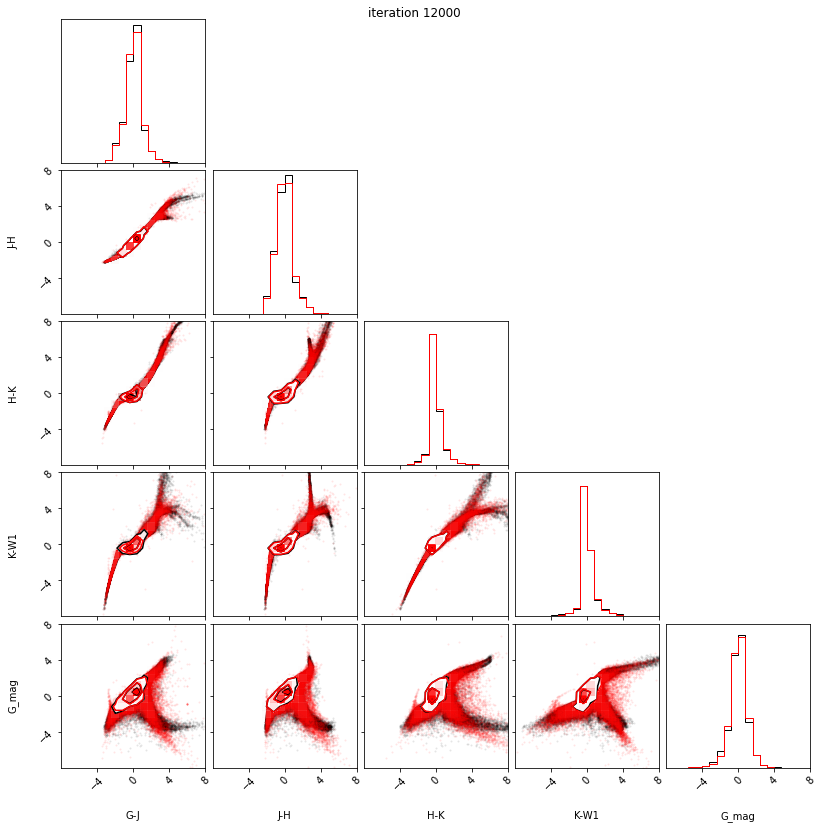

12100 -5.786340713500977 -5.934036731719971 0.1361699104309082 -inf
12200 -5.882701396942139 -5.817099094390869 0.20375871658325195 -inf
12300 -5.508810997009277 -5.5804762840271 -0.018643856048583984 -inf
12400 -5.934142112731934 -5.953595161437988 0.3591899871826172 -inf
12500 -5.428584098815918 -5.481515407562256 0.8706903457641602 -inf
12600 -5.966259002685547 -5.975549221038818 0.03307819366455078 -inf
12700 -5.645956993103027 -5.655769348144531 -0.17185115814208984 -inf
12800 -5.156207084655762 -4.535274982452393 -0.5039267539978027 -inf
12900 -5.555710792541504 -5.306528568267822 -0.2838263511657715 -inf
13000 -4.388255596160889 -5.290937900543213 0.21544504165649414 -inf
0.21544504165649414 -inf


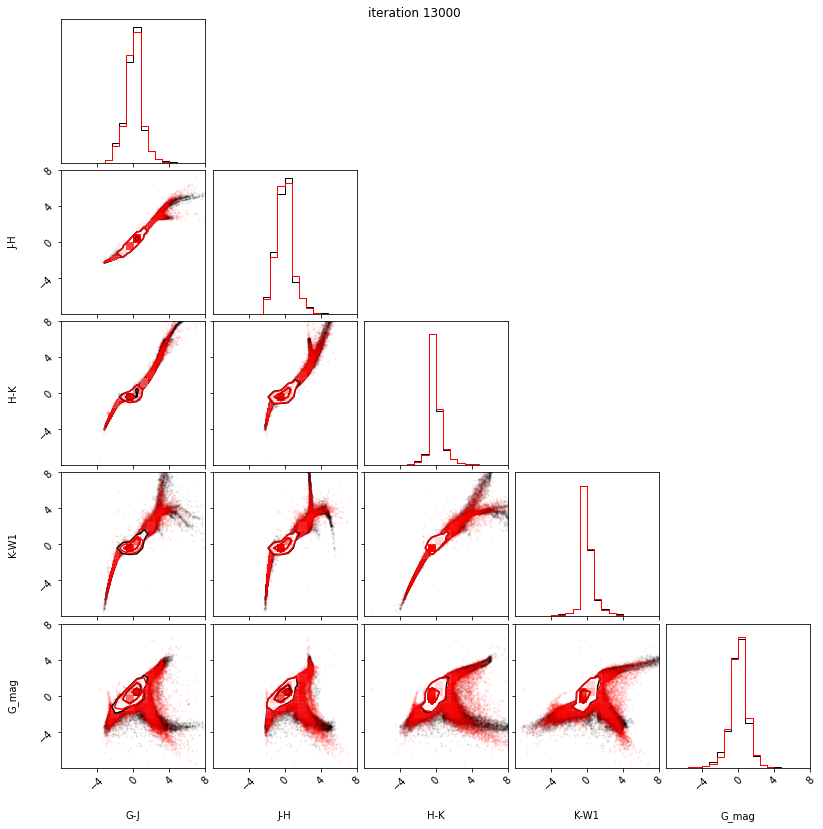

13100 -5.6130266189575195 -5.560728549957275 -0.10580110549926758 -inf
13200 -5.349605083465576 -5.084435939788818 -0.4716334342956543 -inf
13300 -1.591814398765564 -3.6649386882781982 -0.34278345108032227 -inf
13400 -5.915570259094238 -5.9137067794799805 -0.37032508850097656 -inf
13500 -4.892542839050293 -5.809187889099121 -0.19294214248657227 -inf
13600 -6.052572727203369 -6.038122653961182 -0.7311878204345703 -inf
13700 -5.914868354797363 -5.91038179397583 -0.790992259979248 -inf
13800 -5.7892937660217285 -5.784303188323975 -0.6336860656738281 -inf
13900 -6.064553737640381 -6.0709991455078125 -0.8136410713195801 -inf
14000 -6.070879936218262 -6.062486171722412 -0.7339916229248047 -inf
-0.7339916229248047 -inf


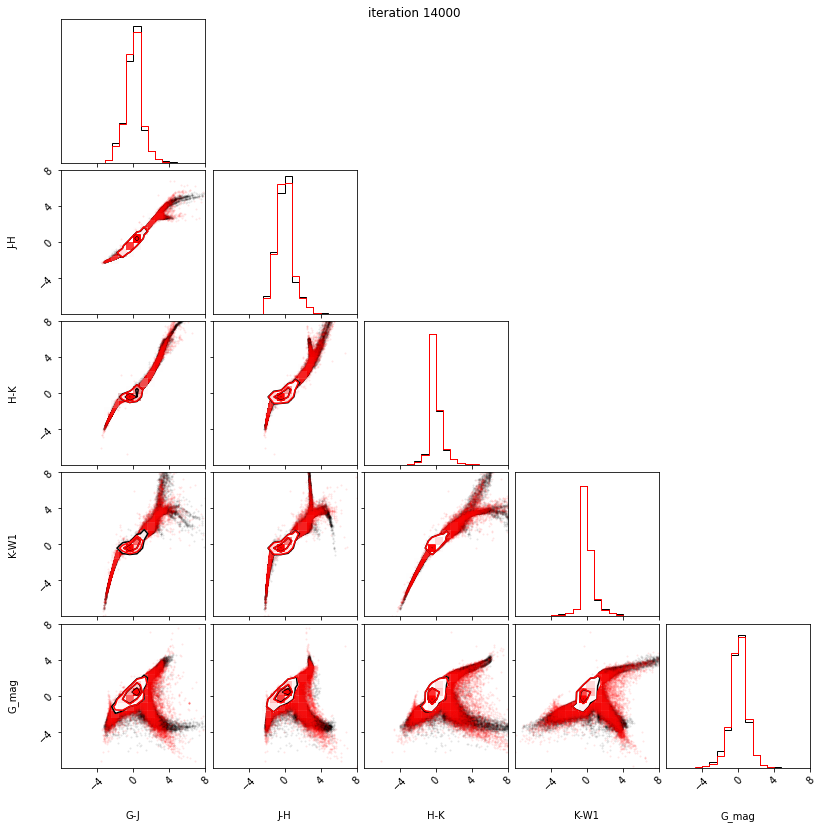

14100 -4.16633415222168 -2.4388821125030518 -1.2060632705688477 -inf
14200 -6.054066181182861 -5.948309898376465 -0.5860891342163086 -inf
14300 -5.934231758117676 -5.9684295654296875 -0.9106836318969727 -inf
14400 -6.071999549865723 -6.055938243865967 -0.9148569107055664 -inf
14500 -5.295298099517822 -4.83507776260376 -1.4524474143981934 -inf
14600 -5.861826419830322 -5.994928359985352 -0.4319438934326172 -inf
14700 -4.615755558013916 -4.4965715408325195 1.257650375366211 -inf
14800 -5.979815483093262 -5.964945316314697 -1.1166925430297852 -inf
14900 -6.089476108551025 -6.027741432189941 -0.9619736671447754 -inf
15000 -5.91464900970459 -5.84276008605957 -0.9383935928344727 -inf
-0.9383935928344727 -inf


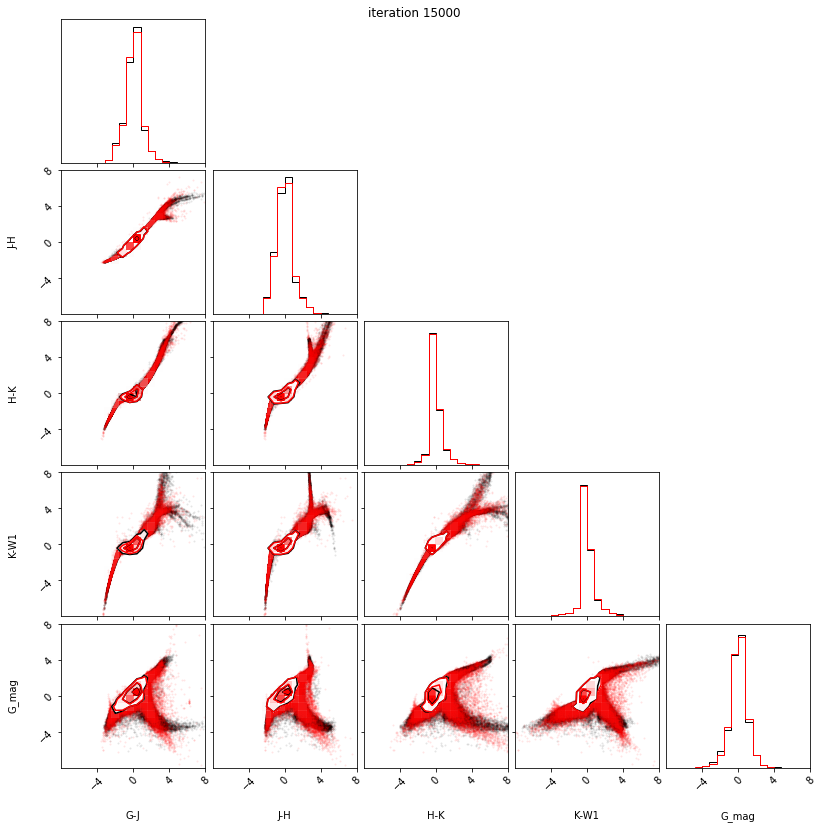

15100 -5.740468502044678 -5.7639007568359375 -1.5901751518249512 -inf
15200 -5.949439525604248 -5.824306964874268 -0.09202194213867188 -inf
15300 -5.845648288726807 -5.8210978507995605 -0.956629753112793 -inf
15400 -5.070376396179199 -4.700104236602783 -1.9221320152282715 -inf
15500 -6.1314873695373535 -6.094781875610352 -2.192411422729492 -inf
15600 -5.409733295440674 -5.618478775024414 -1.5402722358703613 -inf
15700 -6.18673038482666 -6.138464450836182 -2.2516770362854004 -inf
15800 -6.158986568450928 -6.1626458168029785 -2.4643149375915527 -inf
15900 -6.159825801849365 -6.0985283851623535 -2.577033042907715 -inf
16000 -4.386256217956543 -3.970304489135742 -3.007831573486328 -inf
-3.007831573486328 -inf


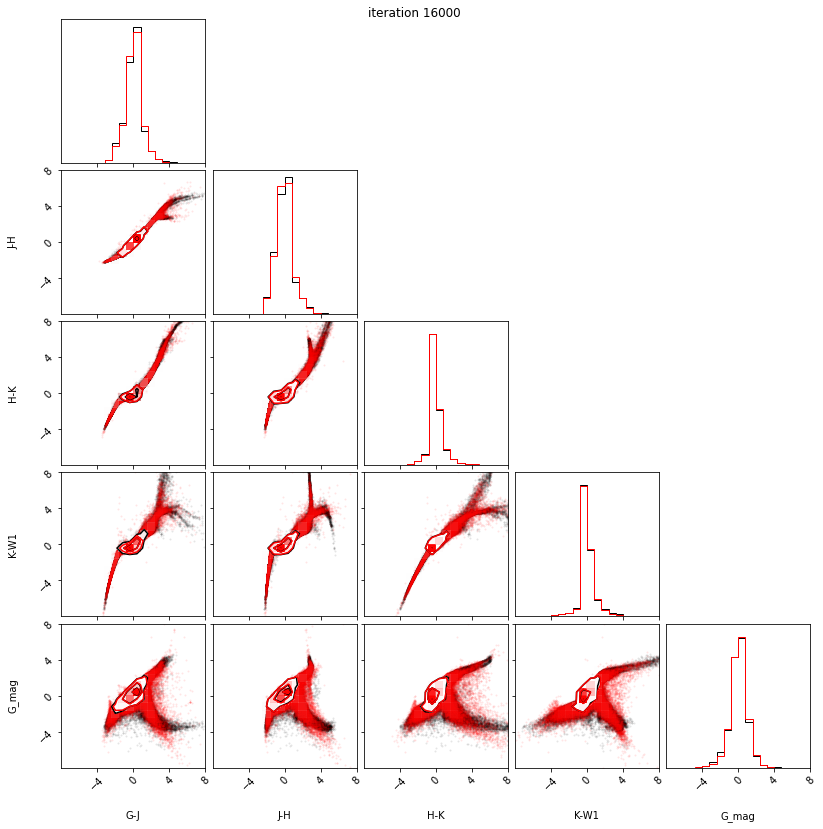

16100 -6.058246612548828 -6.056709289550781 -2.1705636978149414 -inf
16200 -6.199082851409912 -6.14635705947876 -2.860197067260742 -inf
16300 -6.1240973472595215 -6.165947437286377 -2.824000358581543 -inf
16400 -6.084802150726318 -6.0961127281188965 -3.043306827545166 -inf
16500 -6.270157814025879 -6.243983268737793 -3.3640542030334473 -inf
16600 -6.042130947113037 -6.050355434417725 -2.0755457878112793 -inf
16700 -6.0925397872924805 -5.6586785316467285 -3.107795238494873 -inf
16800 -6.22186279296875 -6.177565097808838 -3.7215118408203125 -inf
16900 -6.212213039398193 -6.220217227935791 -3.779202938079834 -inf
17000 -5.372889041900635 -5.38516902923584 -1.4643325805664062 -inf
-1.4643325805664062 -inf


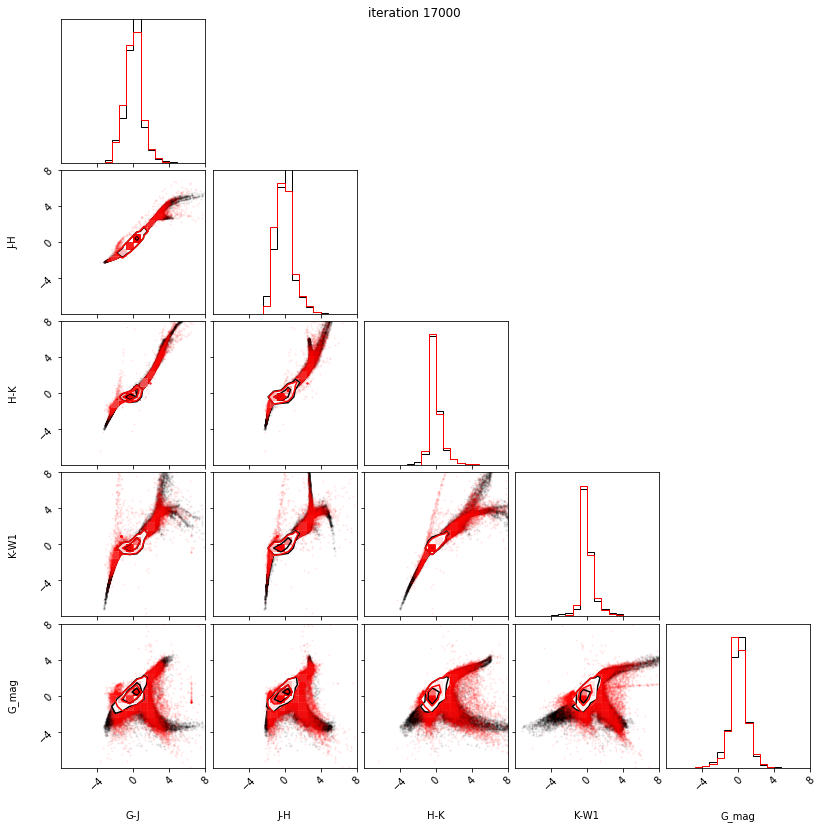

17100 -6.127082824707031 -6.159175395965576 -2.5086793899536133 -inf
17200 -6.094906330108643 -6.104439735412598 -3.2537102699279785 -inf
17300 -5.025757312774658 -4.4523138999938965 -2.2640819549560547 -inf
17400 -6.177917957305908 -6.173715114593506 -3.9071788787841797 -inf
17500 -5.632549285888672 -3.869758129119873 -1.5954442024230957 -inf
17600 -6.216851234436035 -6.210757732391357 -3.9441027641296387 -inf
17700 -6.007960796356201 -6.128161430358887 -3.2352981567382812 -inf
17800 -5.511783599853516 -6.228241920471191 -3.862431526184082 -inf
17900 -6.097387313842773 -6.102293014526367 -4.253608703613281 -inf
18000 -5.692413330078125 -6.194188594818115 -3.795376777648926 -inf
-3.795376777648926 -inf


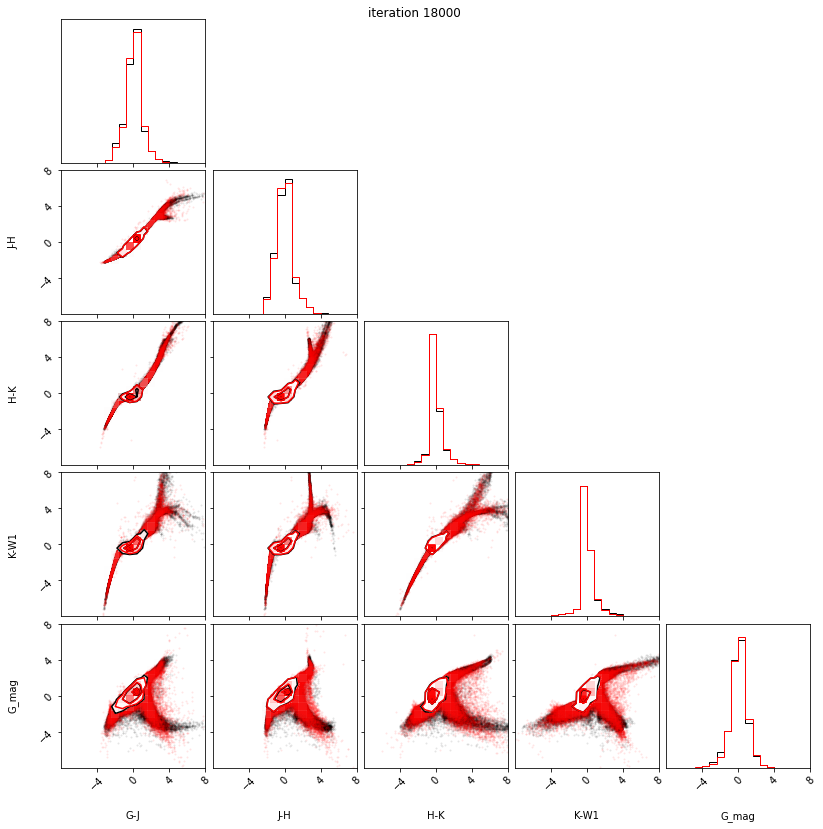

18100 -6.297614574432373 -6.286486625671387 -3.976935386657715 -inf
18200 -5.657662868499756 -6.042035102844238 -3.2122225761413574 -inf
18300 -5.916281700134277 -6.2219414710998535 -3.520275592803955 -inf
18400 -6.192399501800537 -6.124741077423096 -3.8989782333374023 -inf
18500 -6.086487770080566 -5.89748477935791 -3.4892396926879883 -inf
18600 -6.23539924621582 -6.156317710876465 -3.4691224098205566 -inf
18700 -6.313783645629883 -6.19641637802124 -3.5617733001708984 -inf
18800 -6.300110816955566 -6.211738109588623 -3.564424514770508 -inf
18900 -5.697618007659912 -5.755744457244873 -2.338987350463867 -inf
19000 -6.165205478668213 -6.026897430419922 -3.2733640670776367 -inf
-3.2733640670776367 -inf


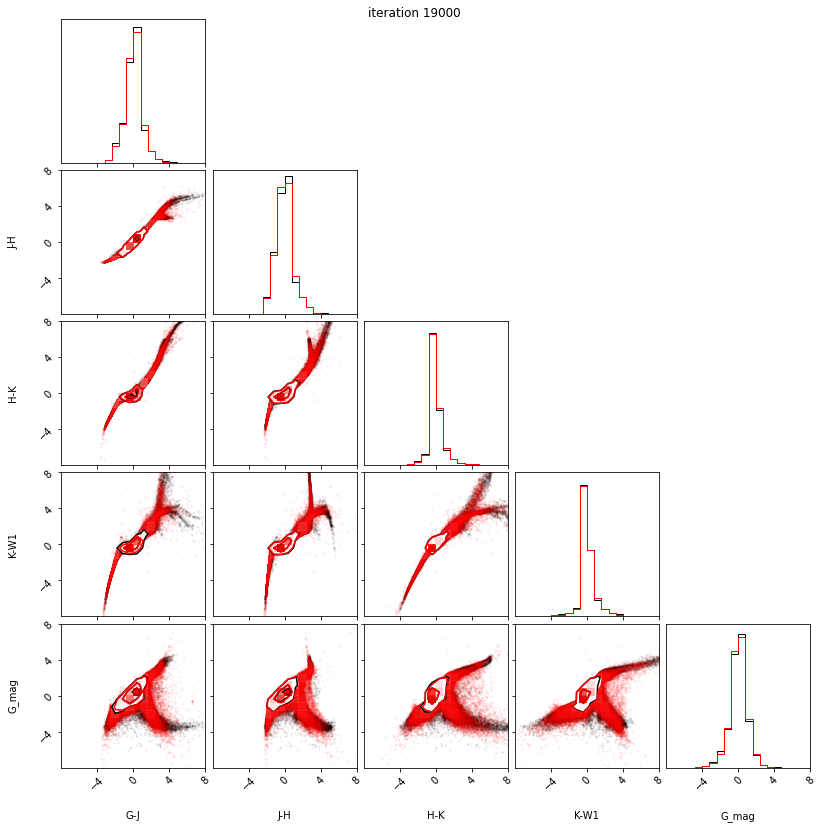

19100 -5.502264499664307 -6.205090522766113 -3.386587142944336 -inf
19200 -6.387546062469482 -6.307031154632568 -3.7471303939819336 -inf
19300 -6.212902069091797 -6.241213798522949 -2.9516849517822266 -inf
19400 -6.08773946762085 -5.955324649810791 -3.6643266677856445 -inf
19500 -5.819969654083252 -5.94340705871582 -3.497115135192871 -inf
19600 -5.206543445587158 -3.9486870765686035 -2.578953266143799 -inf
19700 -6.336321830749512 -6.310468673706055 -3.6038155555725098 -inf
19800 -2.9890873432159424 -2.9599218368530273 -1.0731730461120605 -inf
19900 -6.151815891265869 -5.903820514678955 -3.178645133972168 -inf
20000 -6.40963888168335 -6.268518924713135 -3.783935070037842 -inf
-3.783935070037842 -inf


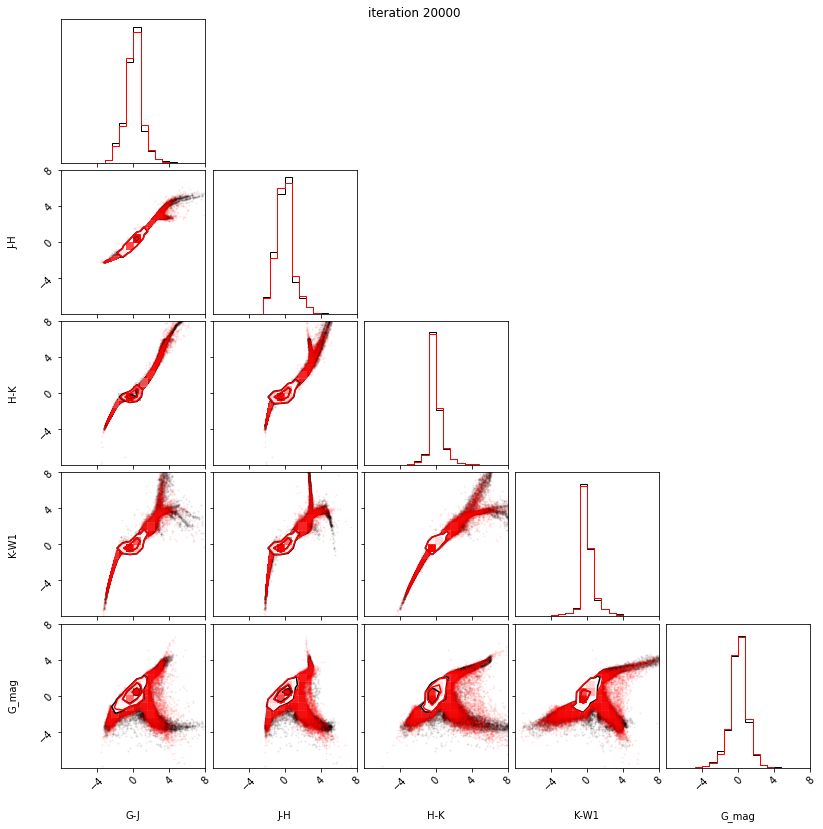

20100 -6.315907001495361 -6.257381916046143 -3.534517288208008 -inf
20200 -6.2666707038879395 -6.17388391494751 -3.3560056686401367 -inf
20300 -5.593735218048096 -5.604187965393066 -2.799617290496826 -inf
20400 -6.454843044281006 -6.268248081207275 -3.75685453414917 -inf
20500 -6.441253185272217 -6.163899898529053 -3.6689586639404297 -inf
20600 -6.0079145431518555 -5.539678573608398 -3.5564470291137695 -inf
20700 -4.819605827331543 -4.223145008087158 -3.3411989212036133 -inf
20800 -6.157313823699951 -6.161413669586182 -3.685849666595459 -inf
20900 -5.969059944152832 -6.180365562438965 -3.0616750717163086 -inf
21000 -6.493155479431152 -6.221526622772217 -3.4903669357299805 -inf
-3.4903669357299805 -inf


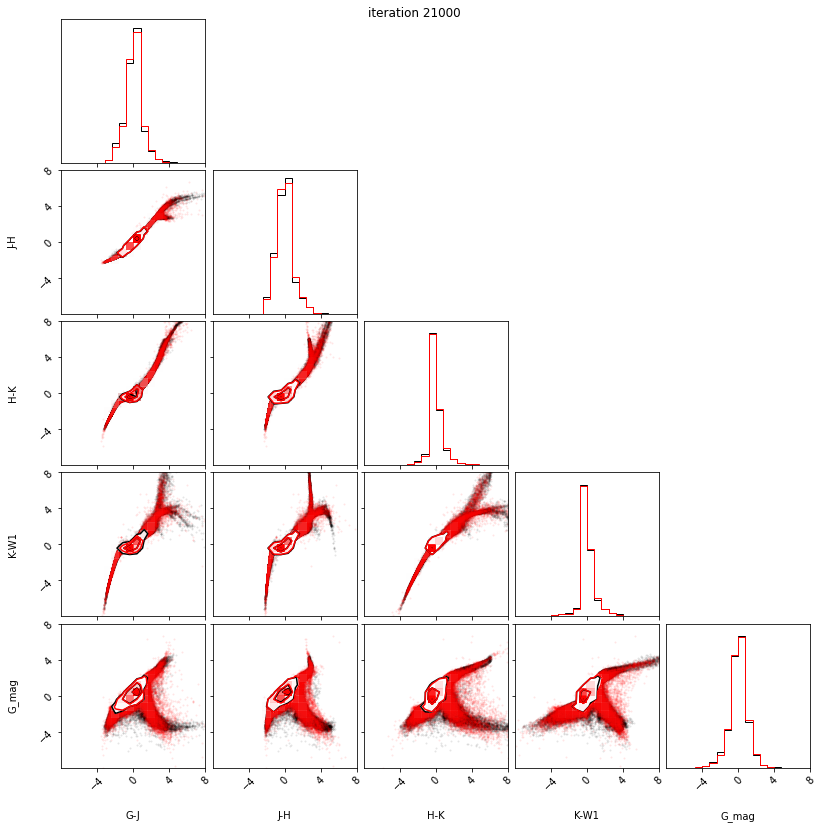

21100 -6.247100830078125 -6.141425609588623 -3.1063055992126465 -inf
21200 -6.346238613128662 -6.008770942687988 -3.423501968383789 -inf
21300 -4.867060661315918 -5.569540500640869 -1.9941182136535645 -inf
21400 -6.38531494140625 -6.279585838317871 -3.3806991577148438 -inf
21500 -5.838927745819092 -5.347250461578369 -2.7238664627075195 -inf
21600 -6.455955505371094 -6.279531002044678 -3.5703935623168945 -inf
21700 -6.202317237854004 -6.203726291656494 -2.4999542236328125 -inf
21800 -5.921388149261475 -5.629045009613037 -2.7482166290283203 -inf
21900 -5.810837745666504 -4.947575092315674 -2.9018630981445312 -inf
22000 -6.512111663818359 -6.3163299560546875 -3.355069160461426 -inf
-3.355069160461426 -inf


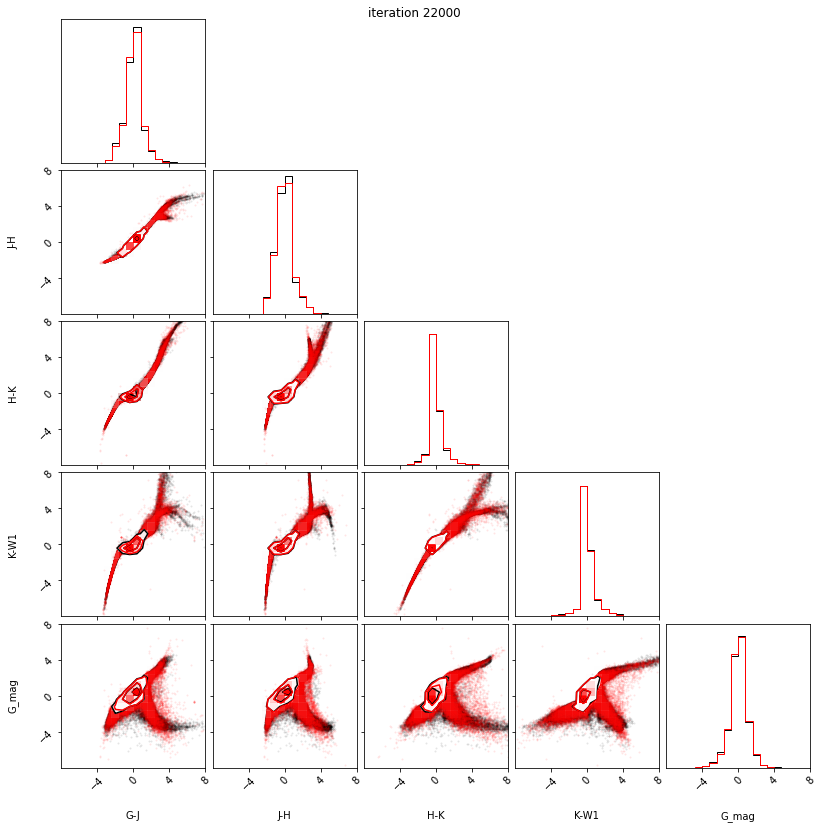

22100 -6.18856143951416 -6.258301258087158 -3.1124534606933594 -inf
22200 -6.157285690307617 -6.214537143707275 -2.9569482803344727 -inf
22300 -6.475052356719971 -6.254436016082764 -3.1426963806152344 -inf
22400 -6.470118999481201 -6.389873504638672 -3.2908244132995605 -inf
22500 -5.582749843597412 -5.715590476989746 -1.048929214477539 -inf
22600 -6.428889274597168 -6.341317653656006 -3.7360706329345703 -inf
22700 -6.283711910247803 -6.284897327423096 -3.015500068664551 -inf
22800 -6.413591384887695 -6.326839447021484 -3.0650529861450195 -inf
22900 -6.3765974044799805 -6.316248416900635 -3.0812950134277344 -inf
23000 -6.467316627502441 -6.354061603546143 -2.8172855377197266 -inf
-2.8172855377197266 -inf


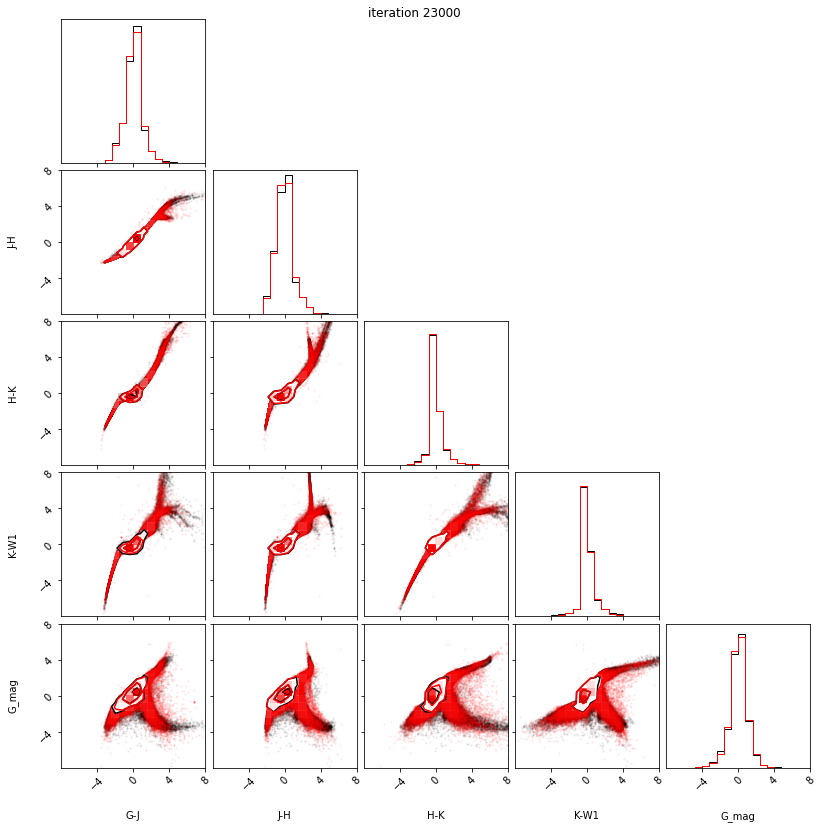

23100 -6.478208065032959 -6.146677017211914 -3.161945343017578 -inf
23200 -6.520401954650879 -6.41660213470459 -3.1579532623291016 -inf
23300 -5.953548908233643 -5.95267391204834 -2.015064239501953 -inf
23400 -6.474062919616699 -6.316289901733398 -3.616854190826416 -inf
23500 -6.355963230133057 -6.16935396194458 -3.2623462677001953 -inf
23600 -6.27133321762085 -6.376999855041504 -2.9441537857055664 -inf
23700 -5.564756393432617 -5.469549179077148 -2.2775893211364746 -inf
23800 -6.288161754608154 -6.391933917999268 -3.0588507652282715 -inf
23900 -6.35473108291626 -6.312033653259277 -3.0138516426086426 -inf
24000 -6.473250389099121 -6.455573081970215 -2.7029480934143066 -inf
-2.7029480934143066 -inf


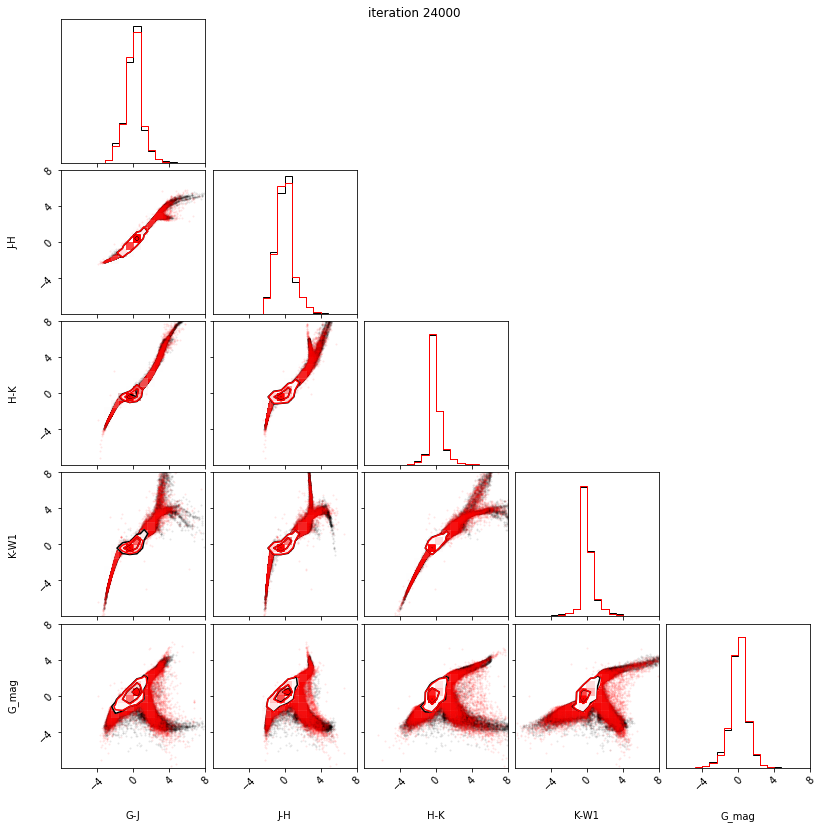

24100 -5.973505973815918 -5.999248504638672 -2.648648262023926 -inf
24200 -6.554337501525879 -6.483309268951416 -2.576443672180176 -inf
24300 -6.340484619140625 -4.573111057281494 -2.2445425987243652 -inf
24400 -6.274190902709961 -6.114116191864014 -2.316465377807617 -inf
24500 -6.594830513000488 -6.42334508895874 -3.2252845764160156 -inf
24600 -6.450211524963379 -6.4648613929748535 -2.906400680541992 -inf
24700 -6.030855655670166 -5.251437664031982 -1.4935359954833984 -inf
24800 -6.58167028427124 -6.4946794509887695 -3.1544713973999023 -inf
24900 -6.416253089904785 -6.399245738983154 -2.809067726135254 -inf
25000 -4.987443923950195 -5.473674774169922 -1.435129165649414 -inf
-1.435129165649414 -inf


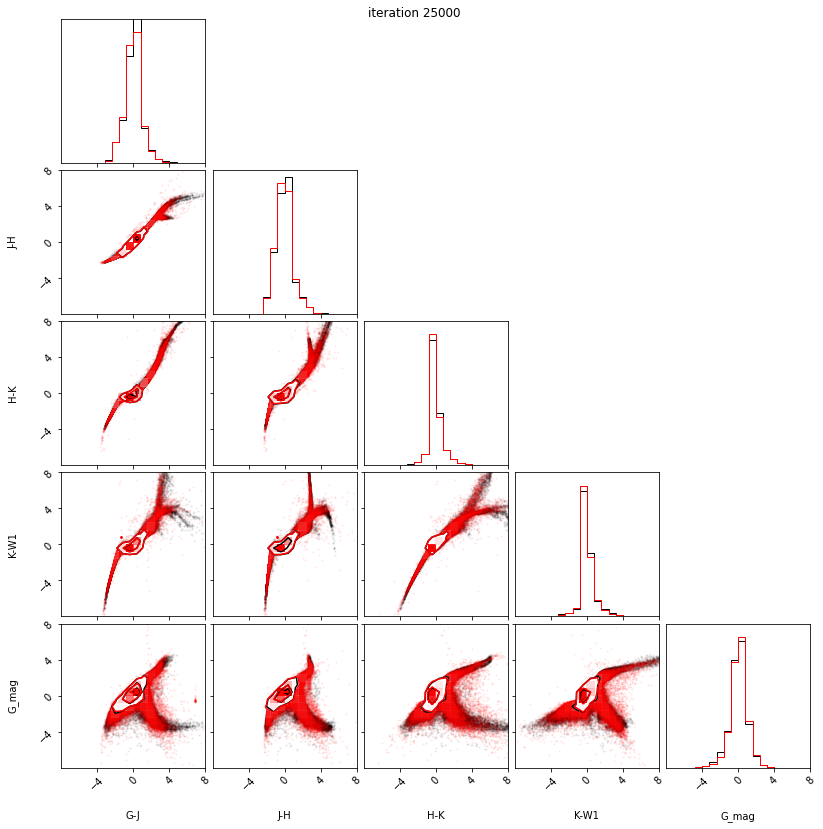

25100 -6.511760234832764 -6.470353603363037 -3.3159122467041016 -inf
25200 -6.5348968505859375 -6.077181816101074 -2.3888635635375977 -inf
25300 -6.41801643371582 -6.311089038848877 -2.778244972229004 -inf
25400 -6.318384170532227 -6.281806945800781 -2.6789708137512207 -inf
25500 -6.40388822555542 -5.881021499633789 -1.9174237251281738 -inf
25600 -6.120034217834473 -6.354310989379883 -2.058793067932129 -inf
25700 -4.6002421379089355 -5.001953125 -0.5180511474609375 -inf
25800 -6.390542507171631 -6.382719993591309 -3.4137063026428223 -inf
25900 -6.259527206420898 -6.308660984039307 -3.153534412384033 -inf
26000 -6.6060004234313965 -6.469411849975586 -2.582857131958008 -inf
-2.582857131958008 -inf


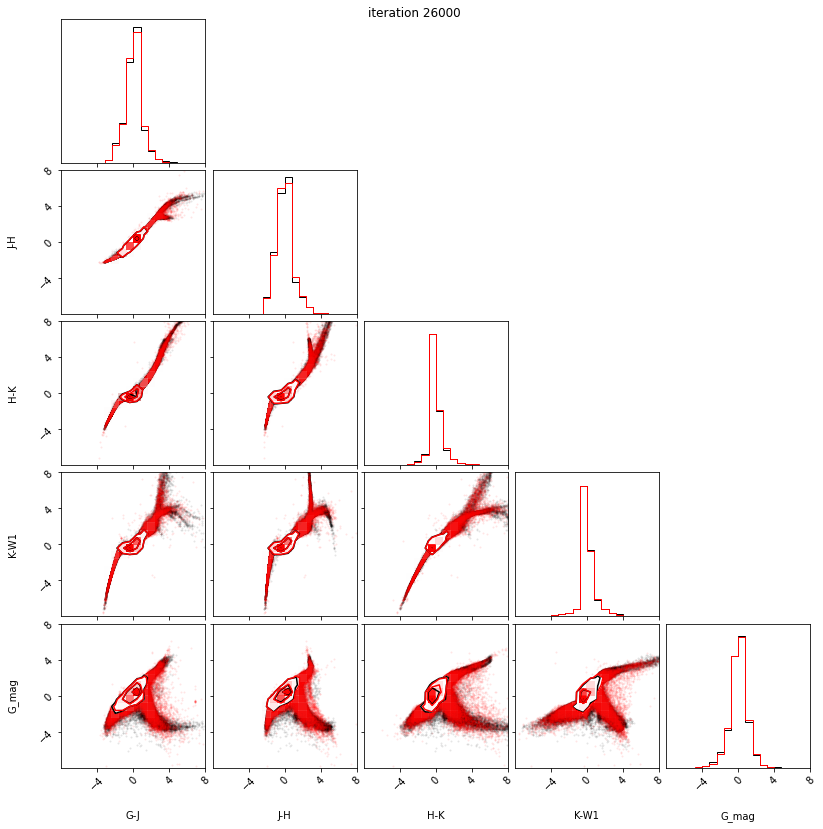

26100 -6.637338161468506 -6.623812198638916 -2.8722352981567383 -inf
26200 -6.61513090133667 -6.530454158782959 -2.559074878692627 -inf
26300 -3.6606318950653076 -3.761911630630493 0.8011665344238281 -inf
26400 -6.290578842163086 -6.313556671142578 -1.610002040863037 -inf
26500 -6.461710453033447 -6.52013635635376 -2.749997138977051 -inf
26600 -6.452788352966309 -6.3657941818237305 -2.8667654991149902 -inf
26700 -6.152138710021973 -6.169628143310547 -2.333462715148926 -inf
26800 -4.841151237487793 -5.820817947387695 -3.138597011566162 -inf
26900 -6.643852233886719 -6.6374897956848145 -2.8637638092041016 -inf
27000 -6.299763202667236 -6.3400468826293945 -2.7258238792419434 -inf
-2.7258238792419434 -inf


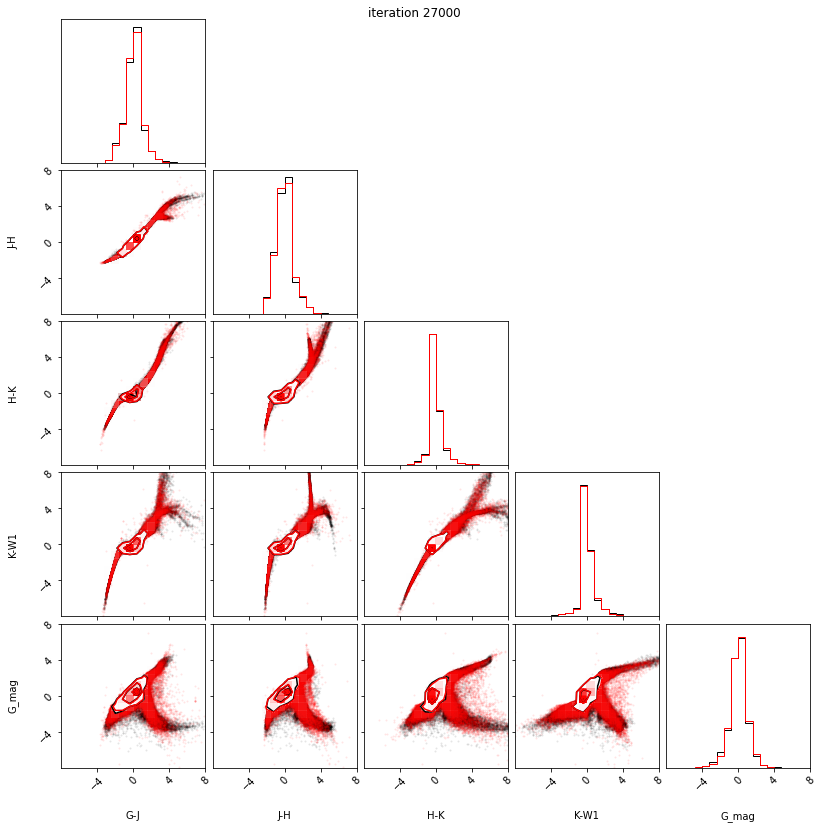

27100 -6.48711633682251 -6.495128154754639 -2.129709243774414 -inf
27200 -6.619594573974609 -6.58868408203125 -2.6361160278320312 -inf
27300 -5.89882230758667 -5.3122735023498535 -1.2910971641540527 -inf
27400 -6.046231746673584 -6.103623390197754 -1.3240265846252441 -inf
27500 -6.481863021850586 -6.512166976928711 -2.518341541290283 -inf
27600 -6.253113746643066 -6.1200270652771 -1.586026668548584 -inf
27700 -6.368009090423584 -5.944863796234131 -1.989821434020996 -inf
27800 -6.450680255889893 -6.491005897521973 -2.481236457824707 -inf
27900 -4.715706825256348 -4.503115177154541 -2.7232093811035156 -inf
28000 -6.5377068519592285 -6.578176975250244 -2.740933418273926 -inf
-2.740933418273926 -inf


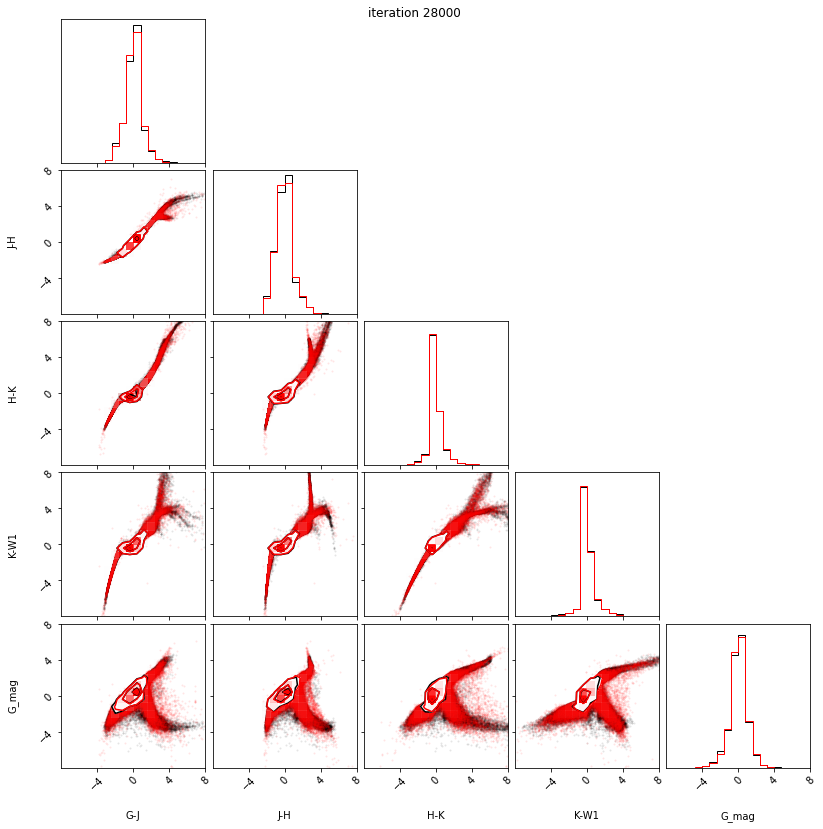

28100 -0.8711106181144714 -1.4018112421035767 -2.535581588745117 -inf
28200 -6.152587890625 -6.177058696746826 -2.035536766052246 -inf
28300 -6.568456649780273 -6.5841546058654785 -3.7282915115356445 -inf
28400 -6.502054691314697 -6.524187088012695 -2.852778911590576 -inf
28500 -6.3318047523498535 -6.321548938751221 -2.9670591354370117 -inf
28600 -6.48399019241333 -6.5065531730651855 -2.6833510398864746 -inf
28700 -6.522078037261963 -6.461905479431152 -2.896653175354004 -inf
28800 -5.738589763641357 -5.710205554962158 -2.3397598266601562 -inf
28900 -6.160324573516846 -6.221442222595215 -1.7078056335449219 -inf
29000 -6.61978006362915 -6.64560604095459 -3.416545867919922 -inf
-3.416545867919922 -inf


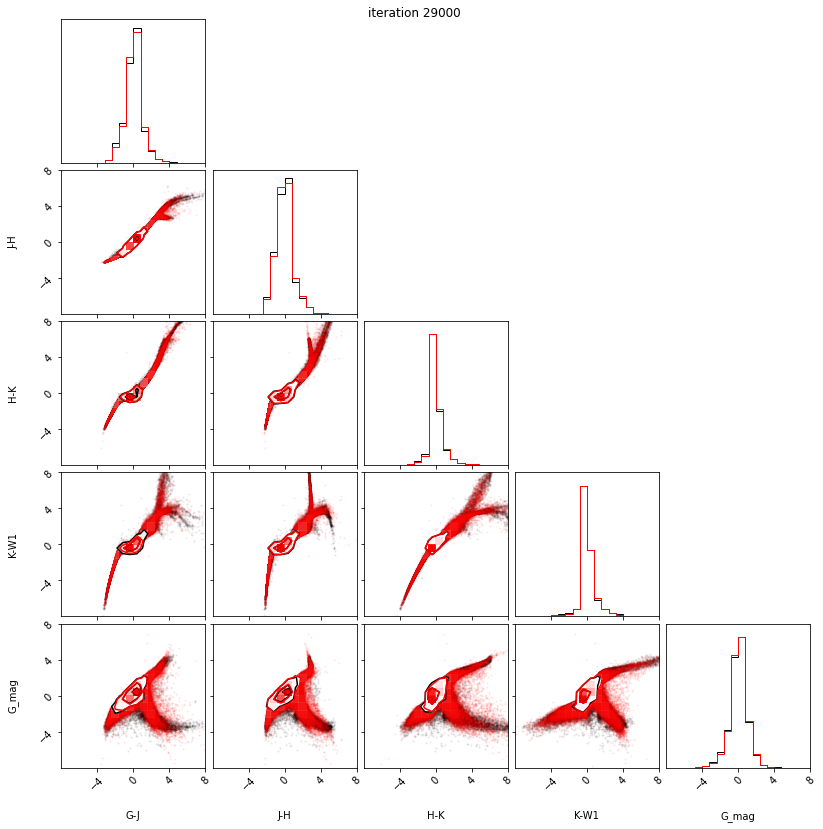

29100 -6.295741081237793 -5.512449264526367 -1.9289259910583496 -inf
29200 -6.375278949737549 -5.919312000274658 -2.962656021118164 -inf
29300 -6.498162269592285 -6.510662078857422 -2.9001107215881348 -inf
29400 -6.372370719909668 -6.103888034820557 -2.500021457672119 -inf
29500 -6.61701774597168 -6.354607105255127 -2.5522146224975586 -inf
29600 -5.973703861236572 -5.6555352210998535 -1.2214679718017578 -inf
29700 -6.676973342895508 -6.6954121589660645 -2.948967933654785 -inf
29800 -6.446446418762207 -6.612816333770752 -2.4679980278015137 -inf
29900 -6.658473968505859 -6.661904335021973 -2.8060503005981445 -inf
30000 -6.6638875007629395 -6.566769599914551 -2.316110610961914 -inf
-2.316110610961914 -inf


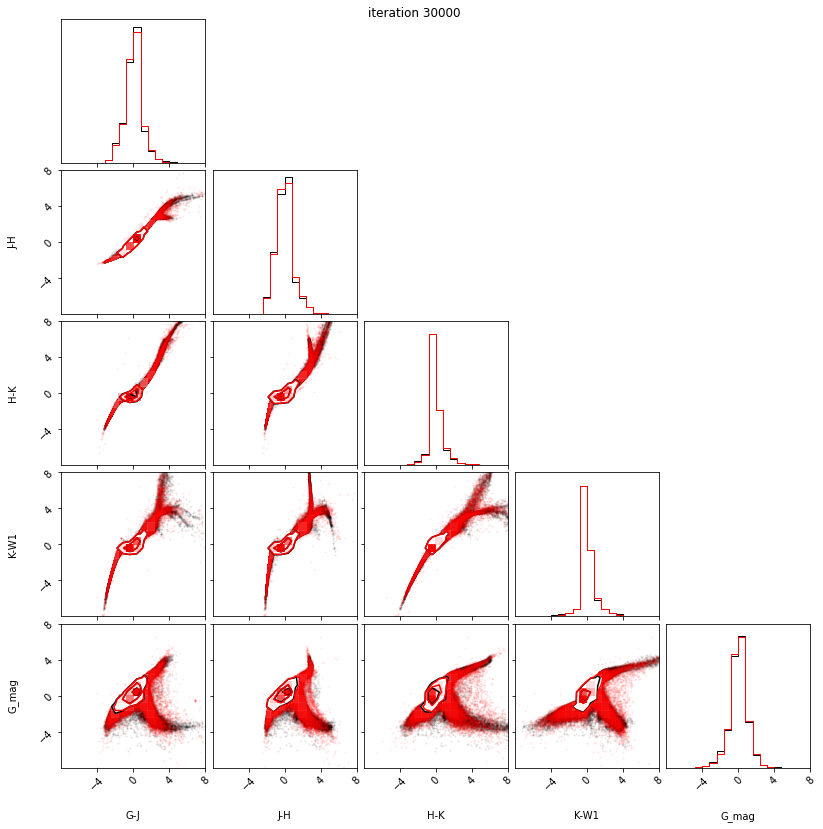

30100 -6.134646892547607 -6.220615386962891 -2.6533966064453125 -inf
30200 -6.254956245422363 -6.357385635375977 -2.693711757659912 -inf
30300 -6.727667808532715 -6.709503650665283 -2.6544437408447266 -inf
30400 -6.59269905090332 -6.482882976531982 -2.645493507385254 -inf
30500 -6.334474086761475 -6.244856357574463 -2.803699493408203 -inf
30600 -2.7494451999664307 -6.287283420562744 -1.9119043350219727 -inf
30700 -6.638149261474609 -6.65158748626709 -3.0076732635498047 -inf
30800 -5.87912654876709 -6.196783542633057 -1.6989378929138184 -inf
30900 -6.701070308685303 -6.7205281257629395 -3.215923309326172 -inf
31000 -6.34945821762085 -6.047311782836914 -2.010448455810547 -inf
-2.010448455810547 -inf


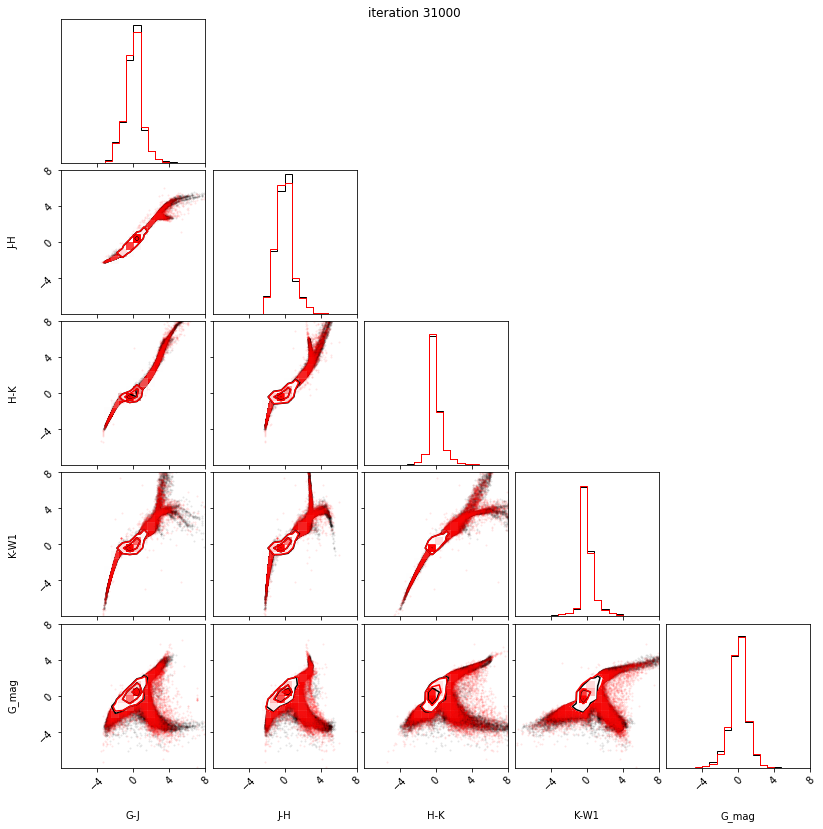

31100 -6.528730869293213 -6.441078186035156 -3.1826982498168945 -inf
31200 -6.1729936599731445 -6.155727863311768 -2.630084991455078 -inf
31300 -6.643120288848877 -6.6737871170043945 -2.909572124481201 -inf
31400 -5.2373528480529785 -5.38775634765625 0.03969907760620117 -inf
31500 -6.510293483734131 -6.538368225097656 -2.874882221221924 -inf
31600 -5.946924686431885 -5.755058288574219 -2.755615711212158 -inf
31700 -6.7248005867004395 -6.6994123458862305 -3.42840576171875 -inf
31800 -6.475013732910156 -6.613814830780029 -2.753589630126953 -inf
31900 -5.890017986297607 -6.3707170486450195 -2.6251392364501953 -inf
32000 -5.871664524078369 -6.333716869354248 -1.8950190544128418 -inf
-1.8950190544128418 -inf


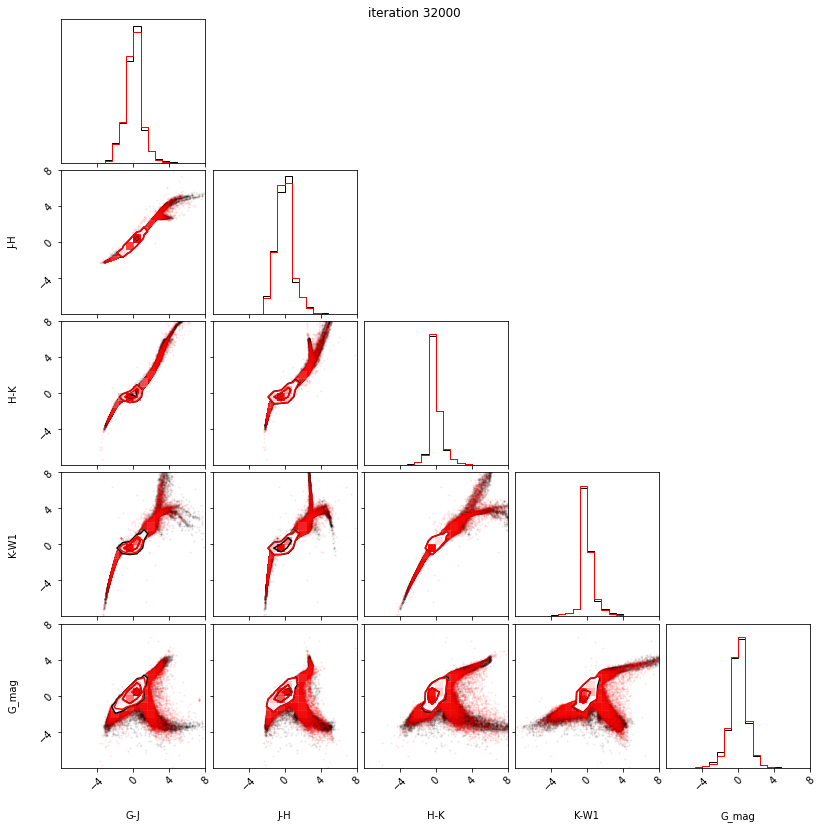

32100 -5.6111860275268555 -4.7192063331604 -2.0652976036071777 -inf
32200 -6.6069655418396 -6.738173484802246 -2.64395809173584 -inf
32300 -6.5142903327941895 -6.331220626831055 -2.2377748489379883 -inf
32400 -6.120502948760986 -6.339386463165283 -2.297360420227051 -inf
32500 -6.481464862823486 -6.610576629638672 -2.5735673904418945 -inf
32600 -6.461752414703369 -6.027219295501709 -1.9668703079223633 -inf
32700 -3.1605746746063232 -3.6811351776123047 0.6001214981079102 -inf
32800 -6.456385135650635 -6.4872918128967285 -2.4652867317199707 -inf
32900 -6.755157470703125 -6.778115272521973 -3.2813944816589355 -inf
33000 -6.474346160888672 -6.538585662841797 -2.377277374267578 -inf
-2.377277374267578 -inf


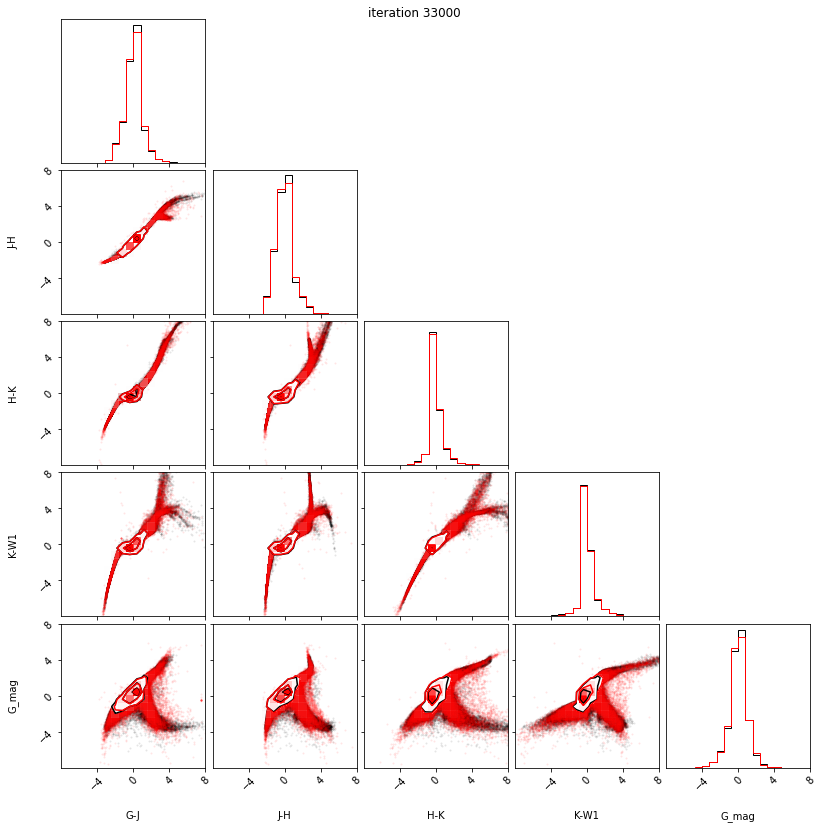

33100 -6.658303737640381 -6.539834022521973 -3.09564208984375 -inf
33200 -6.749055862426758 -6.715878963470459 -2.8355493545532227 -inf
33300 -5.804934024810791 -5.65183162689209 -2.2555179595947266 -inf
33400 -5.505402088165283 -5.21566915512085 -1.8203325271606445 -inf
33500 27.409805297851562 27.01641845703125 -17.040361404418945 -1.1755115035754496e+17
33600 11.912413597106934 11.799454689025879 -7.912199020385742 -4.618991840497308e+30
33700 5.1903462409973145 5.193743705749512 -4.714974403381348 -4.1116678884553235e+20
33800 3.11599063873291 3.0818307399749756 -3.368454933166504 -2.8315755104623214e+27
33900 1.747539758682251 1.7013484239578247 -2.0991406440734863 -1.6105728057239677e+31
34000 0.45420071482658386 0.439055860042572 -0.634089469909668 -5.768634639111664e+28
-0.634089469909668 -5.768634639111664e+28


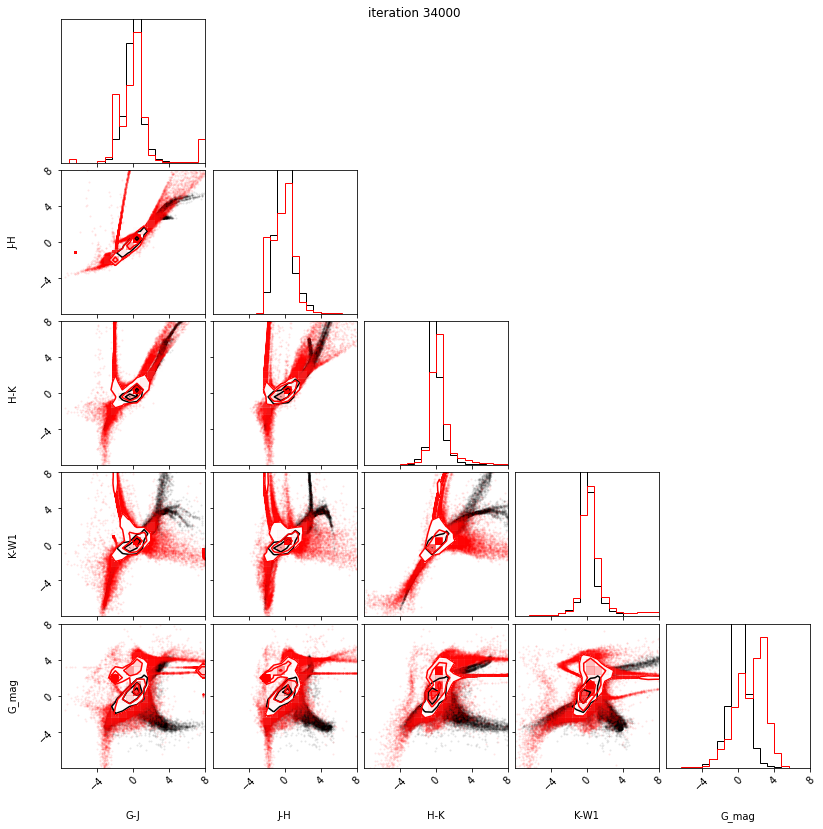

34100 -0.37392473220825195 -0.3755477964878082 -0.22447681427001953 -inf
34200 -0.9101110100746155 -0.9292057156562805 0.3353395462036133 -inf
34300 -1.3545669317245483 -1.3803136348724365 1.0638117790222168 -7.647328901804115e+37
34400 -1.638573169708252 -1.6653878688812256 1.1476507186889648 -4.716218395253926e+35
34500 -1.8572806119918823 -1.8827097415924072 0.9322705268859863 -5.342271412625392e+35
34600 -2.029055118560791 -2.0528318881988525 0.7900161743164062 -4.095177272214951e+36
34700 -2.1610982418060303 -2.183178424835205 0.6047840118408203 -2.3071859537646686e+37
34800 -2.2784605026245117 -2.2978436946868896 0.46671199798583984 -1.1602132567890142e+38
34900 -2.3851475715637207 -2.4046273231506348 0.39465904235839844 -inf
35000 -2.488057851791382 -2.508897304534912 0.14030742645263672 -inf
0.14030742645263672 -inf


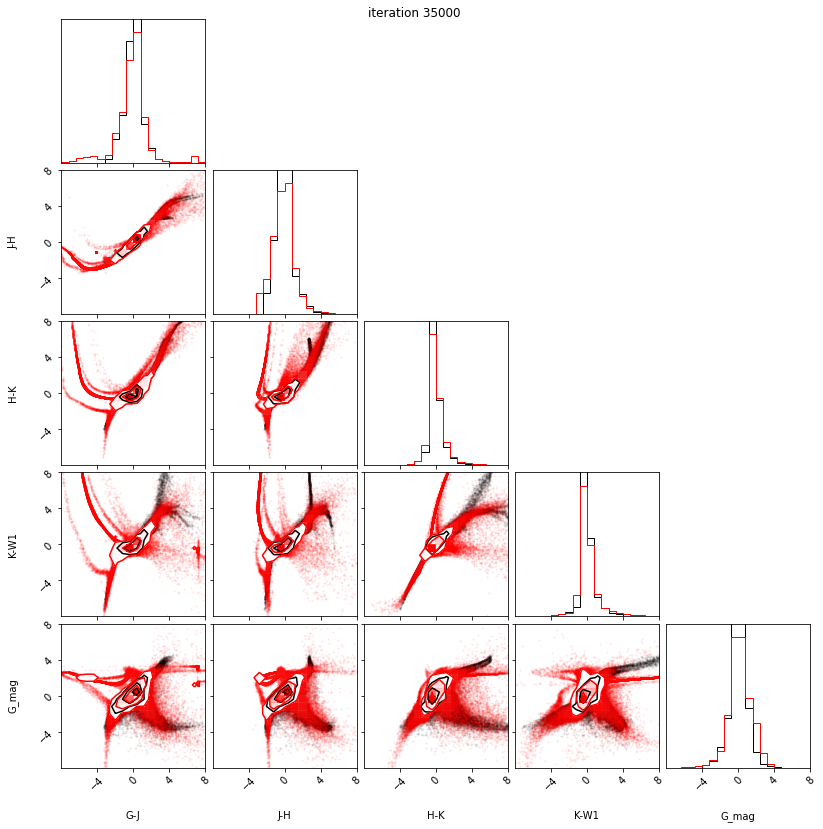

35100 -2.577226400375366 -2.5993590354919434 -0.05938720703125 -inf
35200 -2.664346694946289 -2.6896185874938965 -0.15917110443115234 -inf
35300 -2.7616257667541504 -2.79063081741333 -0.222137451171875 -inf
35400 -2.8542280197143555 -2.8870840072631836 -0.32483863830566406 -inf
35500 -2.9400901794433594 -2.9725029468536377 -0.40058422088623047 -inf
35600 -3.01625919342041 -3.05012845993042 -0.4283418655395508 -inf
35700 -3.0925731658935547 -3.1240105628967285 -0.5333213806152344 -inf
35800 -3.1668128967285156 -3.1973867416381836 -0.7199726104736328 -inf
35900 -3.245502471923828 -3.2757270336151123 -0.8468294143676758 -inf
36000 -3.3149654865264893 -3.3440604209899902 -0.8739910125732422 -inf
-0.8739910125732422 -inf


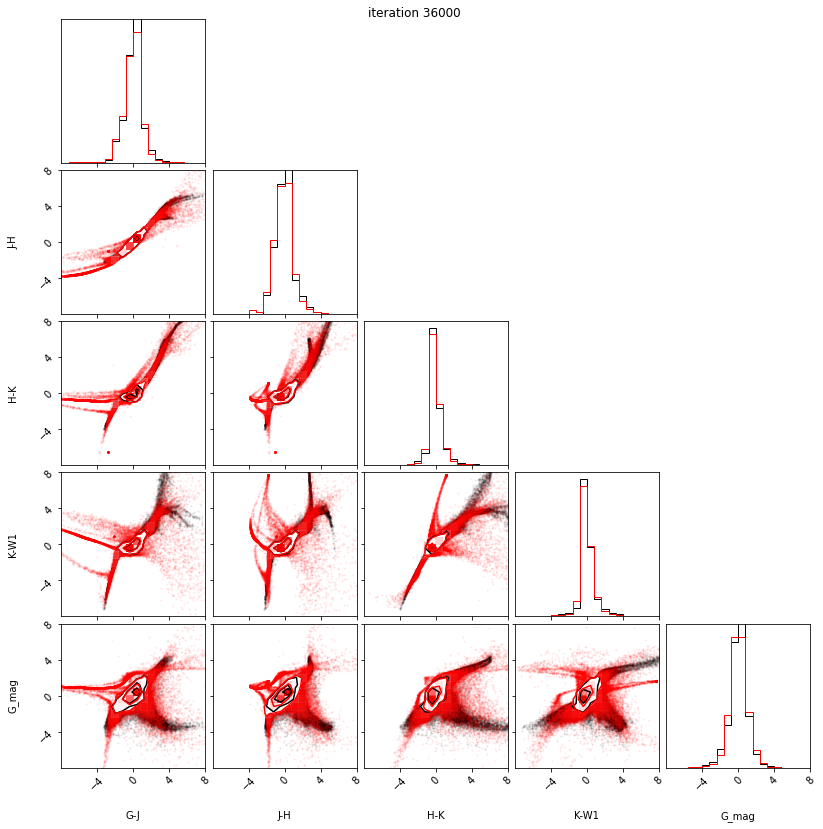

36100 -3.3029608726501465 -3.315361261367798 -0.8653430938720703 -inf
36200 -3.432262420654297 -3.4600040912628174 -0.8267574310302734 -inf
36300 -3.4839093685150146 -3.5106940269470215 -0.7420587539672852 -inf
36400 -3.4999964237213135 -3.5544421672821045 -0.6469326019287109 -inf
36500 -3.579439401626587 -3.6047749519348145 -0.6293268203735352 -inf
36600 -3.6236865520477295 -3.648409366607666 -0.6045722961425781 -inf
36700 -3.66348934173584 -3.6480119228363037 -0.5122652053833008 -inf
36800 -3.700779914855957 -3.7246768474578857 -0.5116052627563477 -inf
36900 -3.736335515975952 -3.7600021362304688 -0.46674346923828125 -inf
37000 -3.7706708908081055 -3.7944014072418213 -0.3842744827270508 -inf
-0.3842744827270508 -inf


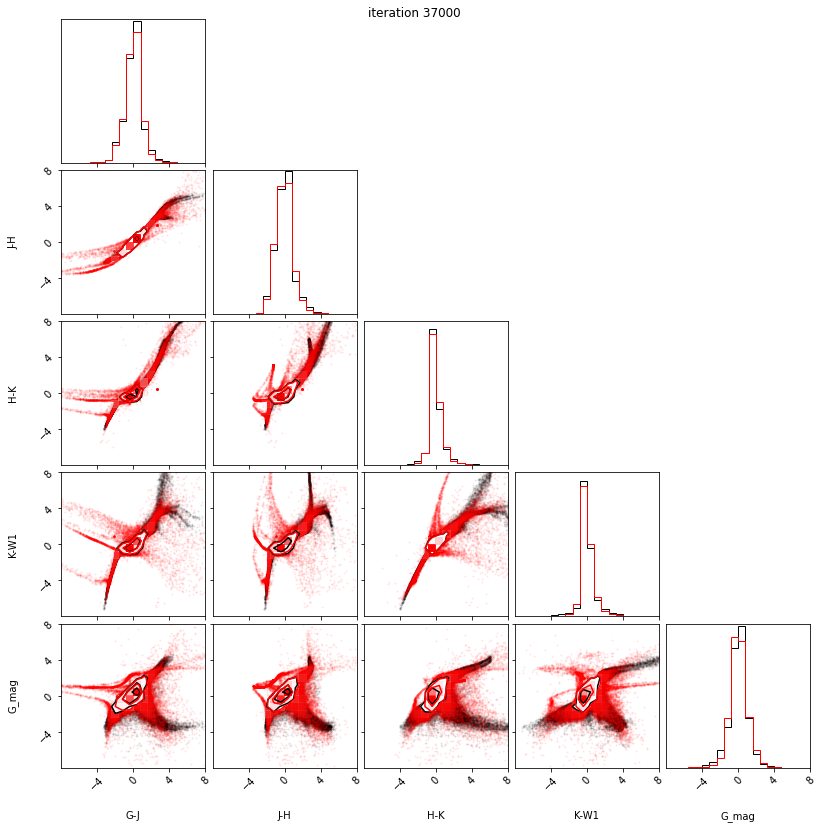

37100 -3.8045265674591064 -3.828181505203247 -0.24102020263671875 -inf
37200 -3.8394627571105957 -3.8632607460021973 -0.12894725799560547 -inf
37300 -3.872364044189453 -3.896214008331299 -0.06910896301269531 -inf
37400 -3.848278522491455 -3.8526248931884766 0.06803226470947266 -inf
37500 -3.9294893741607666 -3.9528937339782715 0.0618133544921875 -inf
37600 -3.9564483165740967 -3.979290246963501 0.1438274383544922 -inf
37700 -3.966655731201172 -3.998173236846924 0.25775718688964844 -inf
37800 -4.003849029541016 -4.026309490203857 0.26168251037597656 -inf
37900 -4.026268482208252 -4.0488433837890625 0.2890911102294922 -inf
38000 -4.04911994934082 -4.071761131286621 0.2820405960083008 -inf
0.2820405960083008 -inf


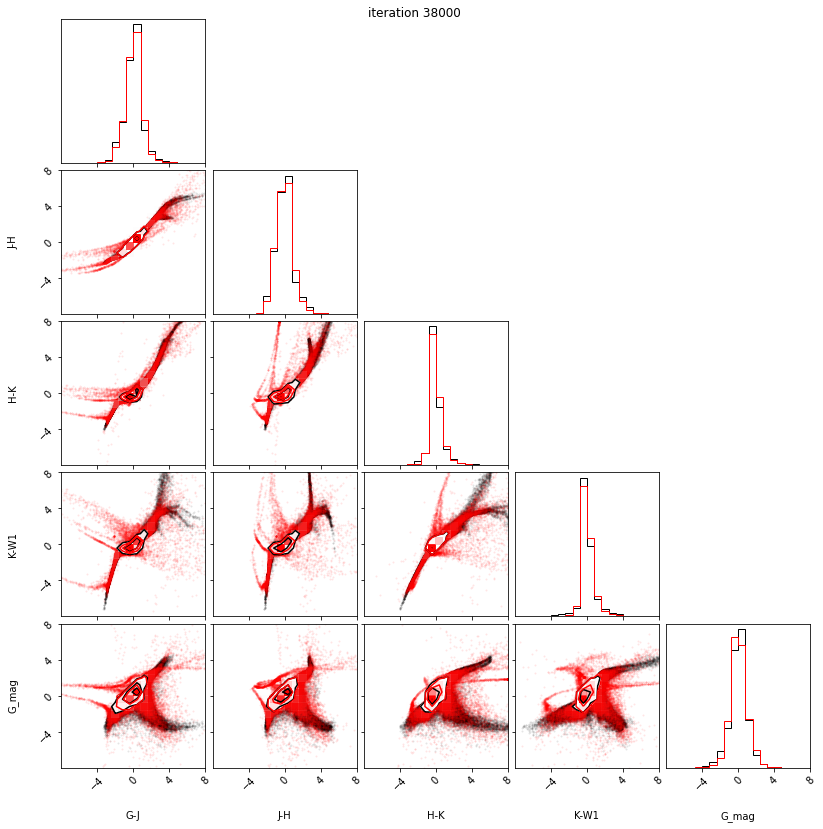

38100 -4.070113658905029 -4.091953754425049 0.28314876556396484 -inf
38200 -4.089428424835205 -4.1124677658081055 0.3808317184448242 -inf
38300 -4.092851638793945 -4.134664058685303 0.45975494384765625 -inf
38400 -4.133124828338623 -4.155391693115234 0.5376682281494141 -inf
38500 -4.15204381942749 -4.174004554748535 0.6164932250976562 -inf
38600 -4.170267105102539 -4.192313194274902 0.7101631164550781 -inf
38700 -4.188660621643066 -4.210937976837158 0.7989940643310547 -inf
38800 -4.203703880310059 -4.2207770347595215 0.8390512466430664 -inf
38900 -4.213688850402832 -4.2338762283325195 0.9182109832763672 -inf
39000 -4.164214134216309 -4.180383682250977 0.9423437118530273 -inf
0.9423437118530273 -inf


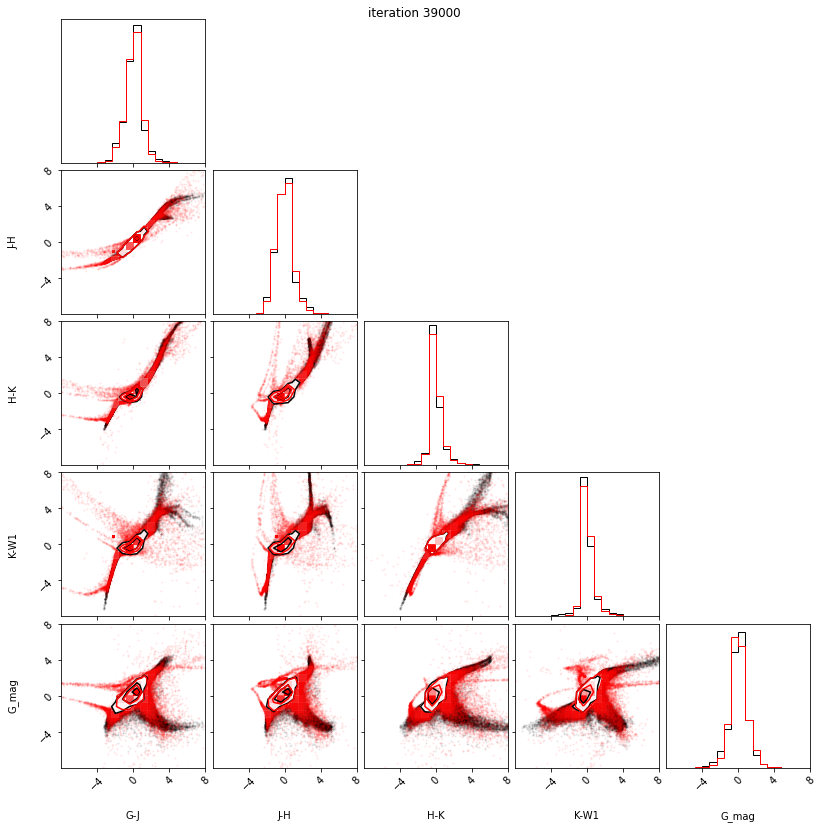

39100 -4.260100841522217 -4.281233310699463 1.148406982421875 -inf
39200 -4.277742862701416 -4.298477649688721 1.217855453491211 -inf
39300 -4.272191524505615 -4.3028130531311035 1.3213224411010742 -inf
39400 -4.30825138092041 -4.329013824462891 1.3340692520141602 -inf
39500 -4.324541091918945 -4.345034599304199 1.3855137825012207 -inf
39600 -4.345473289489746 -4.365764141082764 1.318624496459961 -inf
39700 -4.356464385986328 -4.375419616699219 1.285935878753662 -inf
39800 -4.364710330963135 -4.385958671569824 1.3433804512023926 -inf
39900 -4.381389141082764 -4.400429725646973 1.424149513244629 -inf
40000 -4.385110855102539 -4.413245677947998 1.554868221282959 -inf
1.554868221282959 -inf


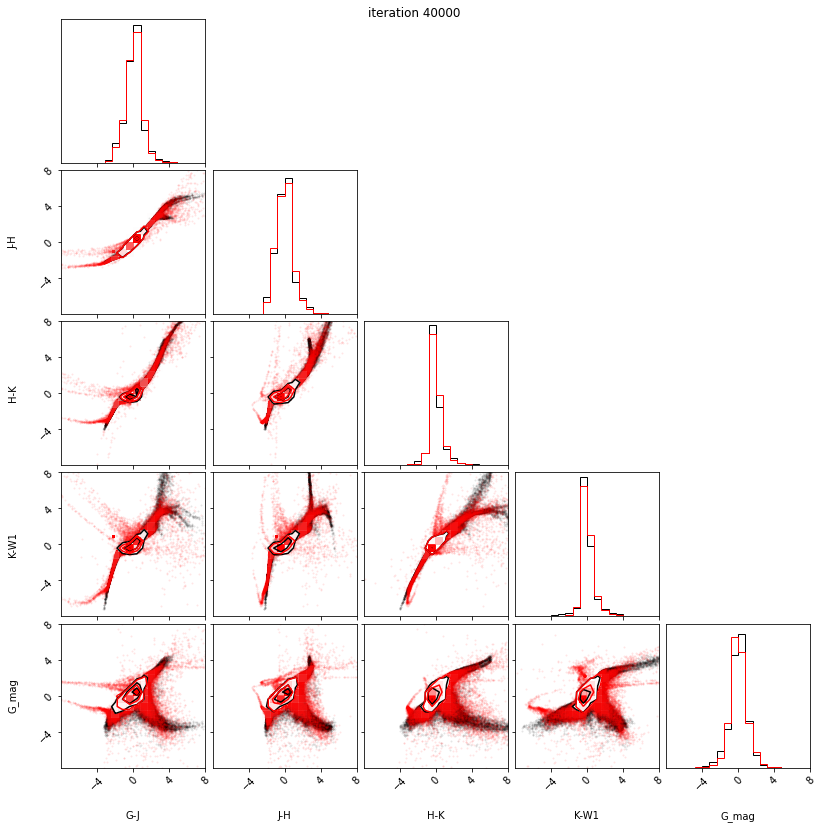

40100 -4.423664569854736 -4.443819999694824 1.5285663604736328 -inf
40200 -4.432761192321777 -4.45241641998291 1.5203938484191895 -inf
40300 -4.451020240783691 -4.470958709716797 1.5108814239501953 -inf
40400 -4.4647297859191895 -4.484645366668701 1.5118093490600586 -inf
40500 -4.457165718078613 -4.494528770446777 1.56502103805542 -inf
40600 -4.489255905151367 -4.509215354919434 1.5384330749511719 -inf
40700 -4.502152442932129 -4.5218353271484375 1.5457115173339844 -inf
40800 -4.36361837387085 -4.403627872467041 1.6172633171081543 -inf
40900 -4.4532952308654785 -4.459263324737549 1.6312084197998047 -inf
41000 -4.535874843597412 -4.554642677307129 1.5988001823425293 -inf
1.5988001823425293 -inf


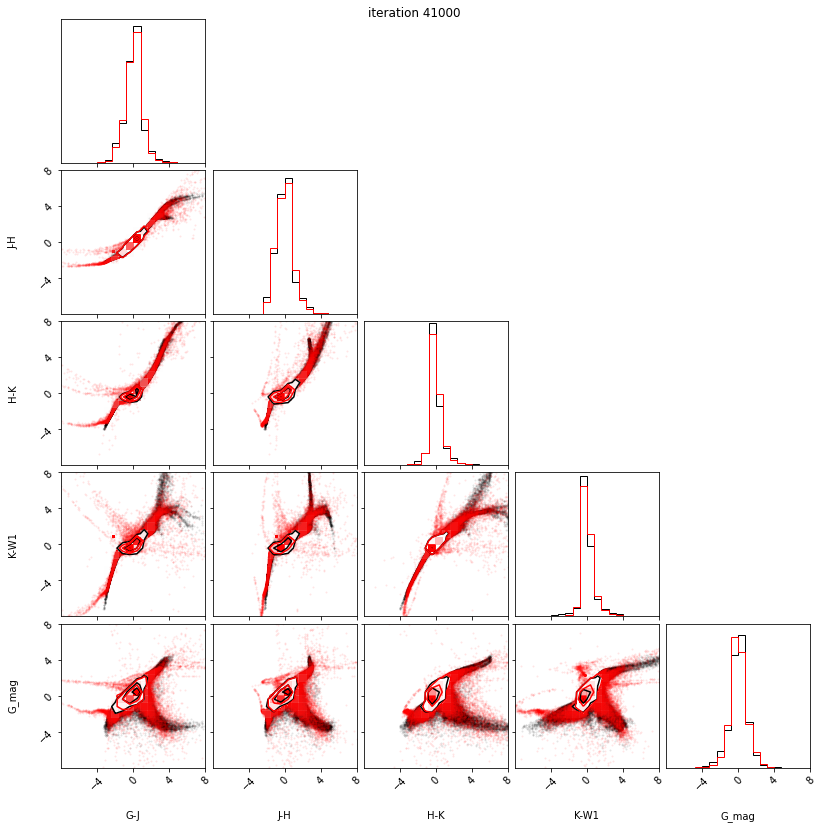

41100 -4.545339107513428 -4.5671257972717285 1.6270108222961426 -inf
41200 -4.559831142425537 -4.578946590423584 1.6488037109375 -inf
41300 -4.56259822845459 -4.588104724884033 1.676788330078125 -inf
41400 -4.580855369567871 -4.599460124969482 1.672072410583496 -inf
41500 -4.571200370788574 -4.5938496589660645 1.7126708030700684 -inf
41600 -4.521480560302734 -4.521310806274414 1.7216429710388184 -inf
41700 -4.609119892120361 -4.628378868103027 1.6753568649291992 -inf
41800 -4.5637688636779785 -4.560372352600098 1.6103148460388184 -inf
41900 -4.628425121307373 -4.647672176361084 1.6571178436279297 -inf
42000 -4.6393656730651855 -4.657841682434082 1.6605596542358398 -inf
1.6605596542358398 -inf


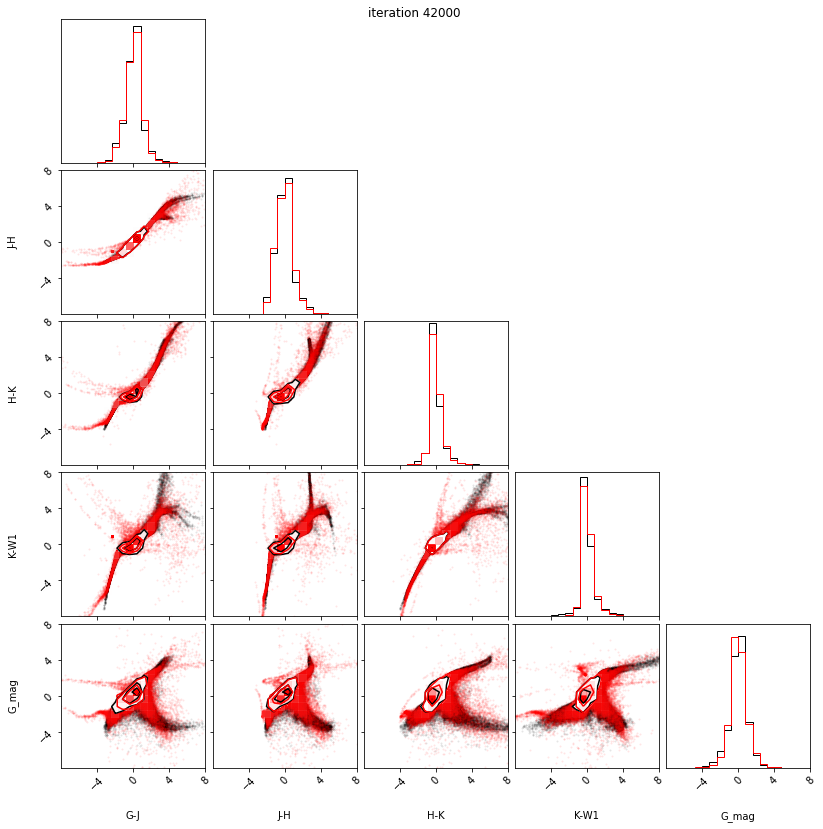

42100 -4.6208600997924805 -4.637306213378906 1.709768295288086 -inf
42200 -4.628771781921387 -4.639019012451172 1.6078505516052246 -inf
42300 -4.666537284851074 -4.685032367706299 1.646183967590332 -inf
42400 -4.671041965484619 -4.689248085021973 1.6526412963867188 -inf
42500 -4.662387847900391 -4.684173583984375 1.6280078887939453 -inf
42600 -4.666405200958252 -4.671915054321289 1.63322114944458 -inf
42700 -4.578141212463379 -4.587846755981445 1.5449914932250977 -inf
42800 -4.640401363372803 -4.640724182128906 1.5395097732543945 -inf
42900 -4.719067573547363 -4.736876487731934 1.5739269256591797 -inf
43000 -4.715433120727539 -4.730868816375732 1.5575742721557617 -inf
1.5575742721557617 -inf


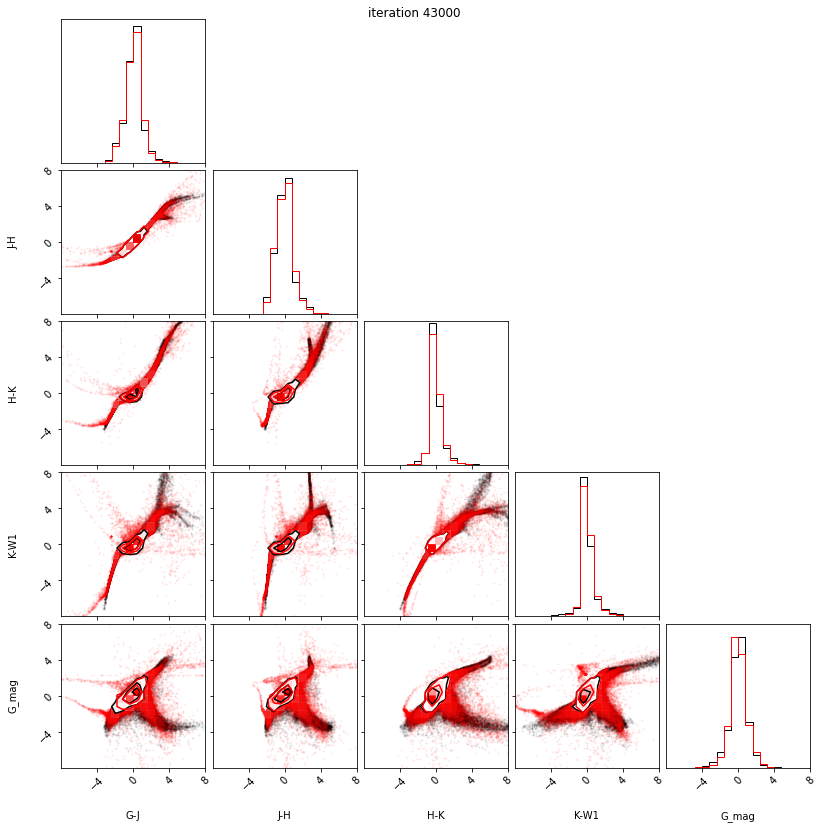

43100 -4.69915246963501 -4.7273969650268555 1.5770196914672852 -inf
43200 -4.745217800140381 -4.763706207275391 1.5238966941833496 -inf
43300 -4.743679523468018 -4.761673927307129 1.5006389617919922 -inf
43400 -4.641381740570068 -4.703882694244385 1.3971233367919922 -inf
43500 -4.769748687744141 -4.787966728210449 1.4302115440368652 -inf
43600 -4.7751569747924805 -4.793806076049805 1.3880243301391602 -inf
43700 -4.784888744354248 -4.804932117462158 1.3874988555908203 -inf
43800 -4.791948318481445 -4.812967300415039 1.3862180709838867 -inf
43900 -4.796001434326172 -4.8133344650268555 1.358614444732666 -inf
44000 -4.811394691467285 -4.8298258781433105 1.321192741394043 -inf
1.321192741394043 -inf


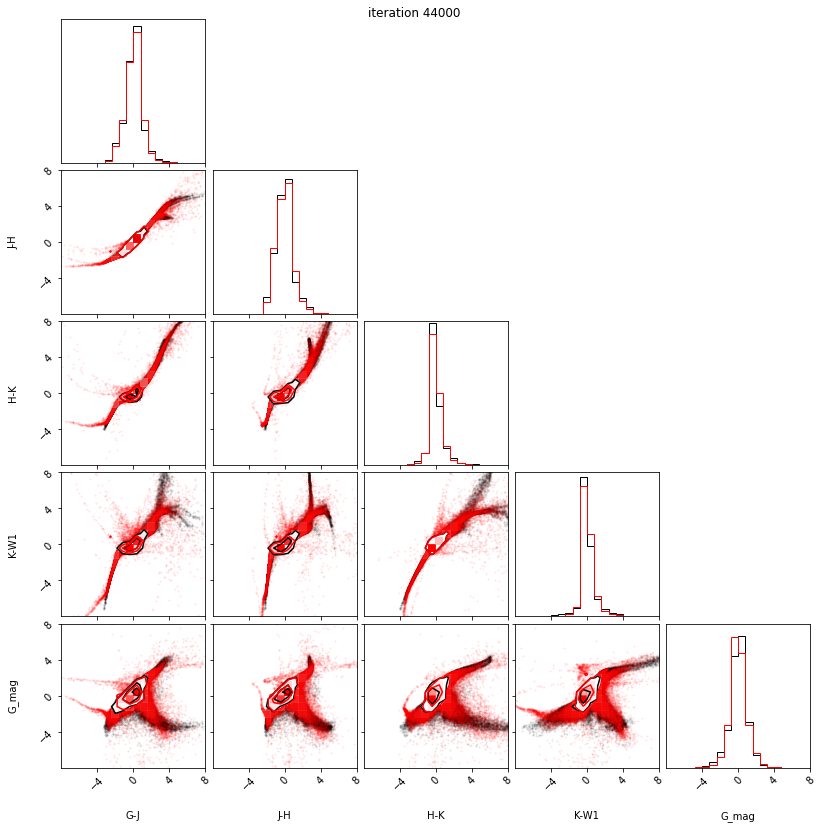

44100 -4.8131608963012695 -4.828816890716553 1.287485122680664 -inf
44200 -4.827348232269287 -4.845725059509277 1.3150367736816406 -inf
44300 -4.825904369354248 -4.846836566925049 1.319188117980957 -inf
44400 -4.824583530426025 -4.842024803161621 1.303849220275879 -inf
44500 -4.844442844390869 -4.855607509613037 1.3263540267944336 -inf
44600 -4.857996463775635 -4.876663684844971 1.3274779319763184 -inf
44700 -4.852212429046631 -4.870569229125977 1.345672607421875 -inf
44800 -4.86500358581543 -4.884404182434082 1.3280811309814453 -inf
44900 -4.871860027313232 -4.8871331214904785 1.4093055725097656 -inf
45000 -4.8858137130737305 -4.904359340667725 1.3221683502197266 -inf
1.3221683502197266 -inf


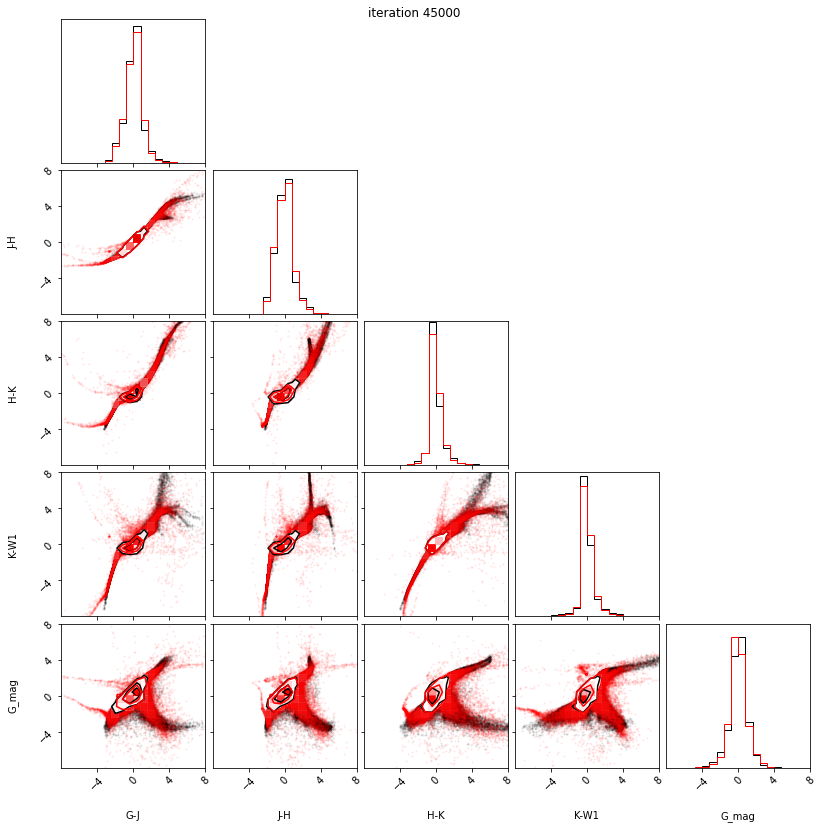

45100 -4.8937578201293945 -4.9125075340271 1.3258991241455078 -inf
45200 -4.897464275360107 -4.916609287261963 1.3048982620239258 -inf
45300 -4.904537677764893 -4.923003196716309 1.3270349502563477 -inf
45400 -4.89467716217041 -4.9118428230285645 1.329240322113037 -inf
45500 -4.896109104156494 -4.916842460632324 1.2984542846679688 -inf
45600 -4.926192283630371 -4.943129539489746 1.2985663414001465 -inf
45700 -4.924837589263916 -4.945253849029541 1.3140816688537598 -inf
45800 -4.934592247009277 -4.955610752105713 1.2893328666687012 -inf
45900 -4.911707878112793 -4.933262348175049 1.3309626579284668 -inf
46000 -4.940389156341553 -4.956407070159912 1.2976760864257812 -inf
1.2976760864257812 -inf


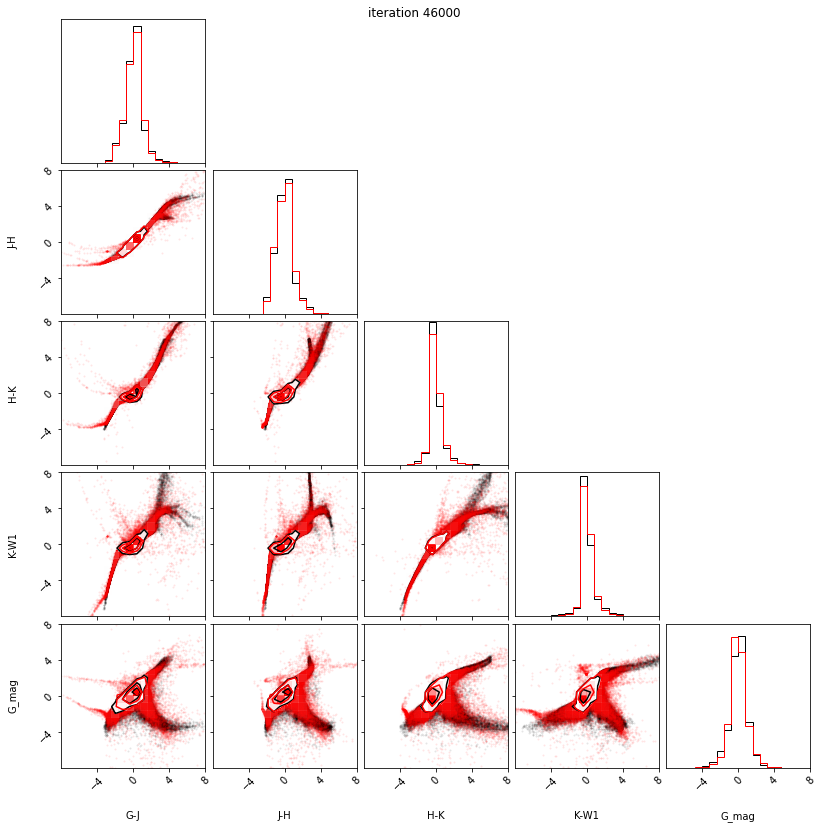

46100 -4.9026007652282715 -4.948794364929199 1.2913966178894043 -inf
46200 -4.8967719078063965 -4.970138072967529 1.3066134452819824 -inf
46300 -4.969564914703369 -4.986032485961914 1.2801666259765625 -inf
46400 -4.966637134552002 -4.984716892242432 1.3041067123413086 -inf
46500 -4.8131890296936035 -4.796688079833984 1.3244619369506836 -inf
46600 -4.8704352378845215 -4.858404636383057 1.3143539428710938 -inf
46700 -4.869217872619629 -4.911578178405762 1.3081793785095215 -inf
46800 -4.9018778800964355 -4.932406902313232 1.2947092056274414 -inf
46900 -4.761377811431885 -4.778944492340088 1.1845827102661133 -inf
47000 -4.715420722961426 -4.775452136993408 1.286055564880371 -inf
1.286055564880371 -inf


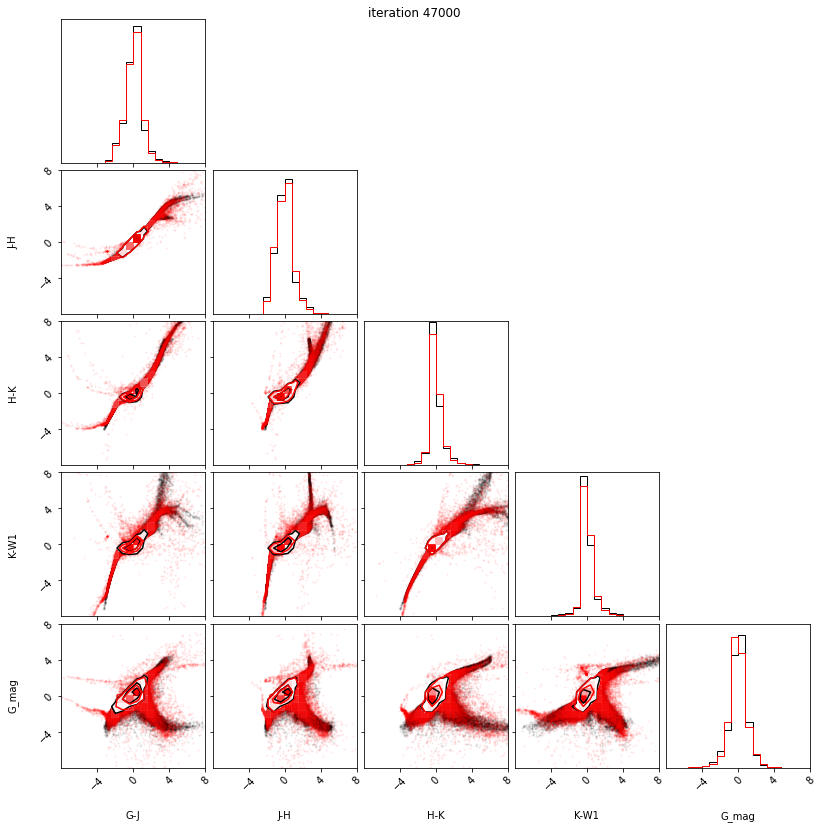

47100 -5.017083644866943 -5.033335208892822 1.2598423957824707 -inf
47200 -5.022174835205078 -5.0407891273498535 1.2788848876953125 -inf
47300 -5.025920867919922 -5.045586109161377 1.2870421409606934 -inf
47400 -4.863966464996338 -4.871363162994385 1.3213391304016113 -inf
47500 -4.9986491203308105 -5.014222145080566 1.3417606353759766 -inf
47600 -4.984986782073975 -4.989845275878906 1.2893061637878418 -inf
47700 -4.968204498291016 -4.962956428527832 1.292109489440918 -inf
47800 -4.95082950592041 -5.020436763763428 1.3107867240905762 -inf
47900 -5.052520751953125 -5.06102991104126 1.368586540222168 -inf
48000 -4.988227844238281 -4.927708148956299 1.423534870147705 -inf
1.423534870147705 -inf


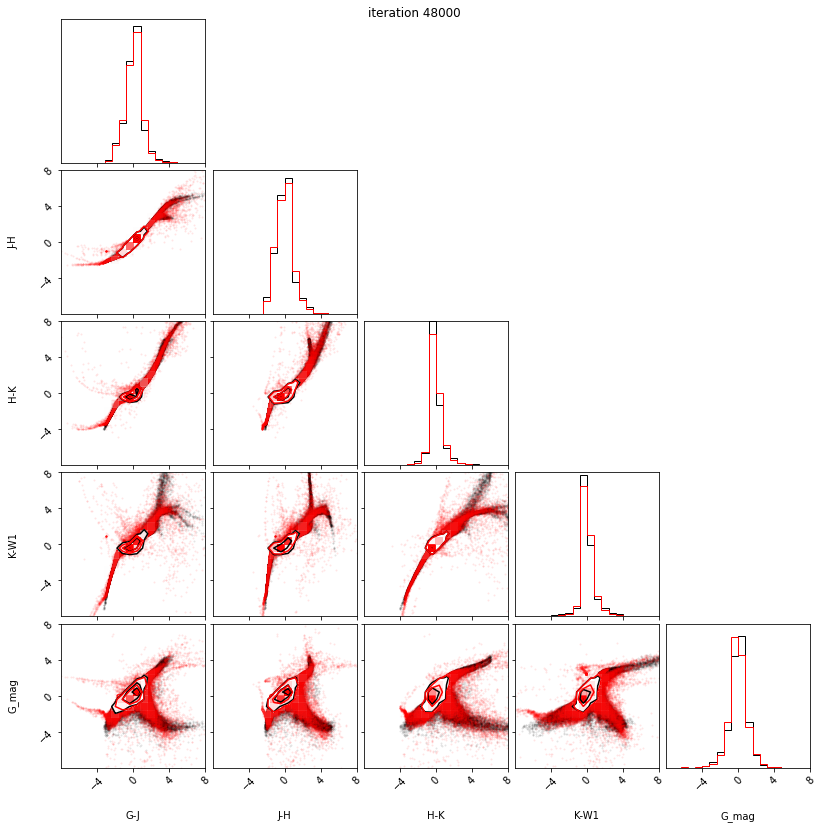

48100 -5.072248935699463 -5.0887651443481445 1.3500113487243652 -inf
48200 -5.080724239349365 -5.096175670623779 1.3470244407653809 -inf
48300 -5.045323371887207 -5.052347660064697 1.3756380081176758 -inf
48400 -5.084764003753662 -5.105266094207764 1.376157283782959 -inf
48500 -5.085365295410156 -5.096079349517822 1.3480186462402344 -inf
48600 -5.054627895355225 -5.114420413970947 1.3894658088684082 -inf
48700 -5.107004642486572 -5.121578216552734 1.3693127632141113 -inf
48800 -5.108409404754639 -5.1211442947387695 1.363722324371338 -inf
48900 -4.884392738342285 -4.9382500648498535 1.3209228515625 -inf
49000 -5.106801986694336 -5.1075615882873535 1.437974452972412 -inf
1.437974452972412 -inf


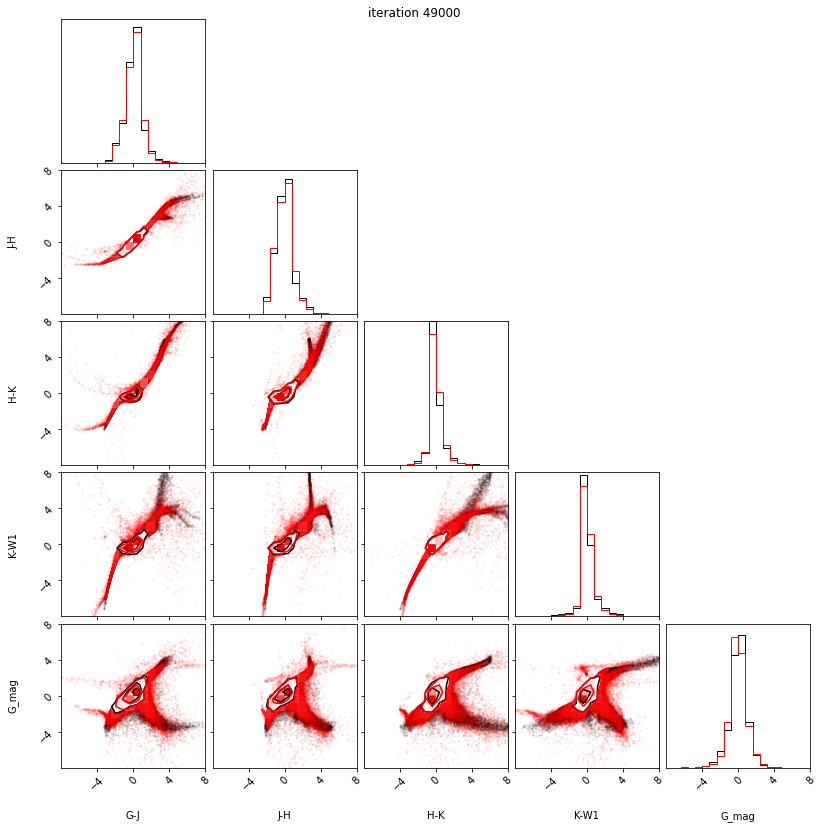

49100 -5.116582870483398 -5.1227264404296875 1.4478559494018555 -inf
49200 -5.026435852050781 -5.04318380355835 1.4170928001403809 -inf
49300 -5.09879732131958 -5.105960845947266 1.4097256660461426 -inf
49400 -5.130727767944336 -5.149327278137207 1.4448165893554688 -inf
49500 -5.1453070640563965 -5.157557487487793 1.4112296104431152 -inf
49600 -5.1172051429748535 -5.158631324768066 1.4313735961914062 -inf
49700 -5.144642353057861 -5.167444229125977 1.4362444877624512 -inf
49800 -5.100607872009277 -5.093111515045166 1.3871469497680664 -inf
49900 -5.039626598358154 -5.0168561935424805 1.364710807800293 -inf
50000 -5.0216264724731445 -4.9718804359436035 1.4545211791992188 -inf
1.4545211791992188 -inf


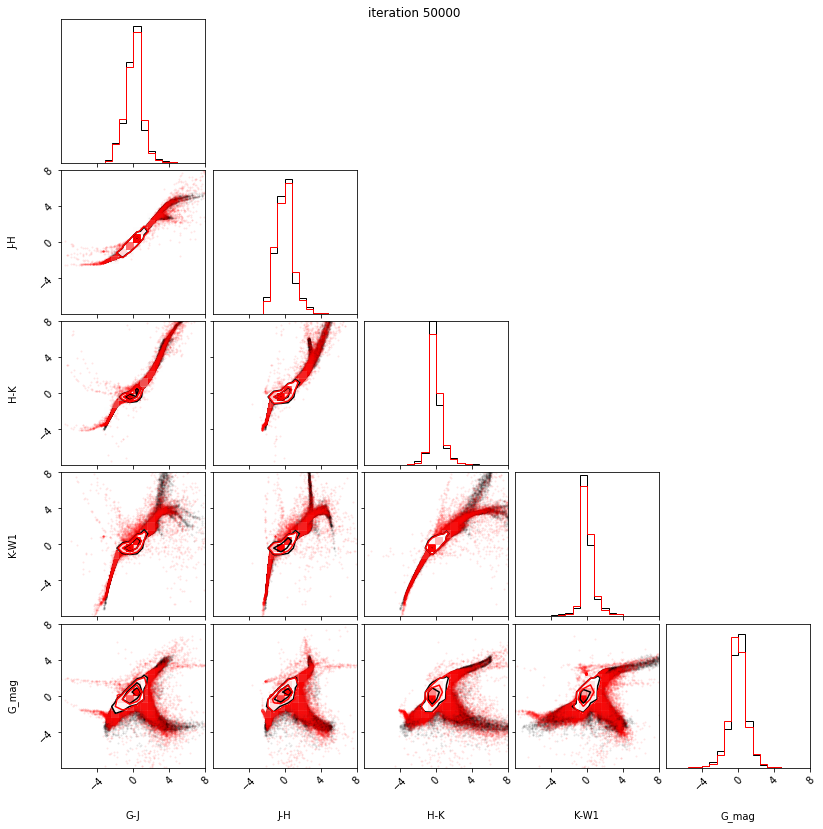

50100 -5.055360794067383 -5.038873672485352 1.454634666442871 -inf
50200 -5.162164211273193 -5.164855003356934 1.4787969589233398 -inf
50300 -5.174809455871582 -5.178330898284912 1.4996380805969238 -inf
50400 -5.099216938018799 -5.038908004760742 1.5710053443908691 -inf
50500 -5.190892696380615 -5.204620361328125 1.438004493713379 -inf
50600 -5.197021961212158 -5.210898399353027 1.4389162063598633 -inf
50700 -5.182631969451904 -5.188506126403809 1.4230279922485352 -inf
50800 -5.1860809326171875 -5.17117977142334 1.453512191772461 -inf
50900 -5.203798294067383 -5.220064640045166 1.4444689750671387 -inf
51000 -5.201405048370361 -5.222680568695068 1.4632940292358398 -inf
1.4632940292358398 -inf


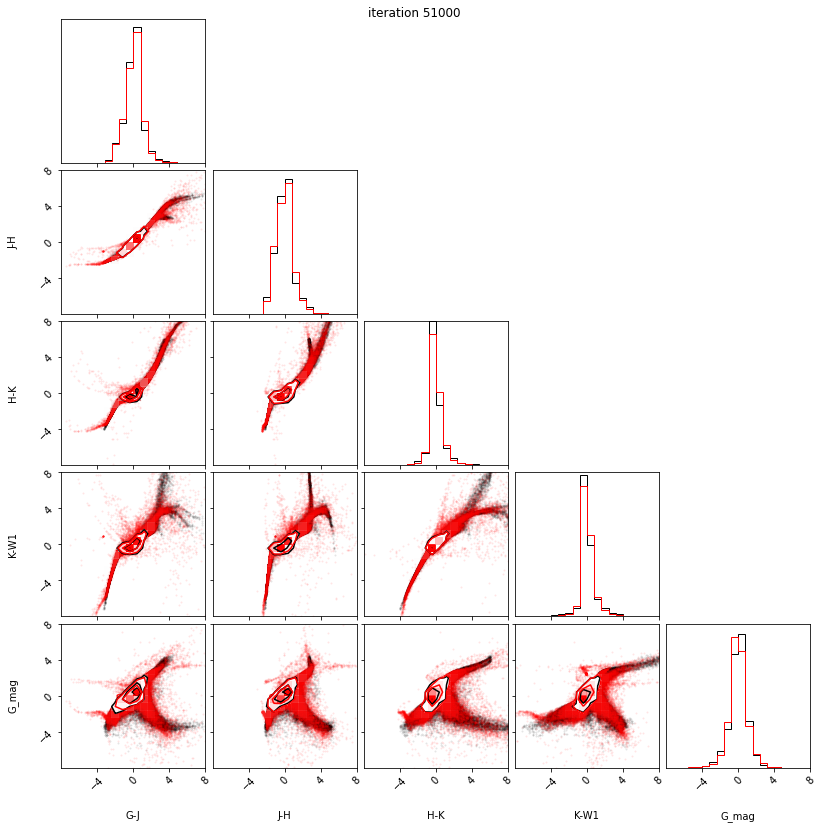

51100 -5.173415660858154 -5.175185203552246 1.4120354652404785 -inf
51200 -5.202380180358887 -5.224531650543213 1.493201732635498 -inf
51300 -5.19257116317749 -5.226712226867676 1.4516887664794922 -inf
51400 -5.16775369644165 -5.167895793914795 1.4519824981689453 -inf
51500 -5.075931072235107 -5.101502895355225 1.468172550201416 -inf
51600 -5.235607624053955 -5.250687599182129 1.4446420669555664 -inf
51700 -5.209151268005371 -5.246828079223633 1.4680919647216797 -inf
51800 -5.081416130065918 -5.153919219970703 1.4589309692382812 -inf
51900 -5.196135997772217 -5.201031684875488 1.4422025680541992 -inf
52000 -5.222814559936523 -5.24796724319458 1.4450092315673828 -inf
1.4450092315673828 -inf


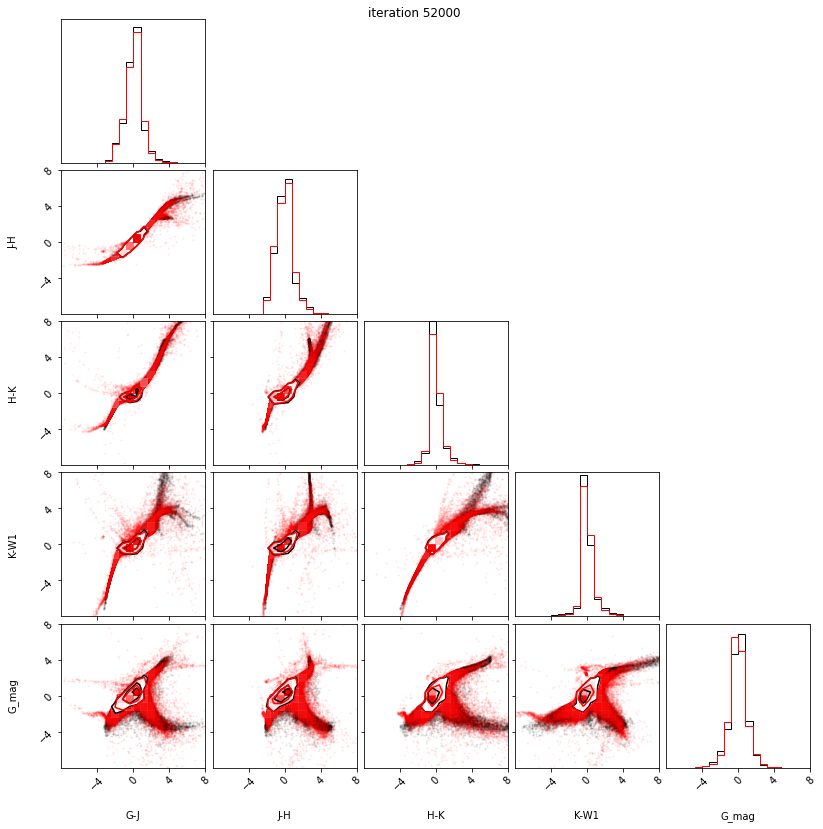

52100 -5.191065311431885 -5.1822099685668945 1.4493002891540527 -inf
52200 -5.2147297859191895 -5.2179131507873535 1.4812440872192383 -inf
52300 -5.261580944061279 -5.260828971862793 1.4870128631591797 -inf
52400 -5.251368045806885 -5.257500648498535 1.451263427734375 -inf
52500 -5.245504856109619 -5.257519245147705 1.4528155326843262 -inf
52600 -5.271566867828369 -5.288174152374268 1.4383912086486816 -inf
52700 -5.1327080726623535 -5.164184093475342 1.3711953163146973 -inf
52800 -5.2414445877075195 -5.239382743835449 1.4650049209594727 -inf
52900 -5.248662948608398 -5.246969223022461 1.4002838134765625 -inf
53000 -5.120818614959717 -5.154877662658691 1.4537553787231445 -inf
1.4537553787231445 -inf


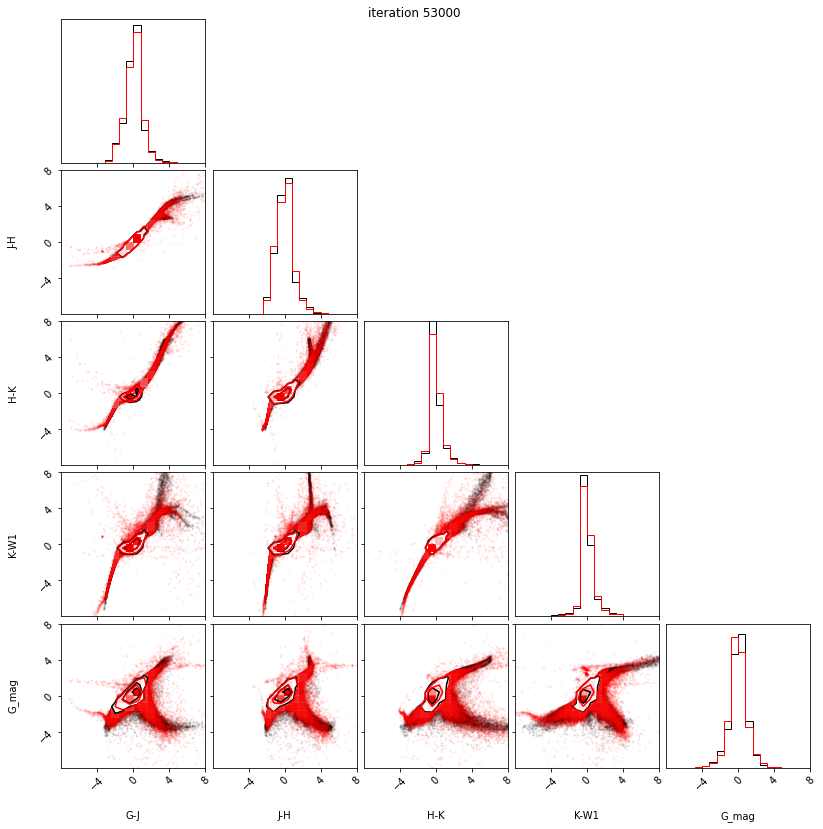

53100 -5.2327880859375 -5.264156341552734 1.4177460670471191 -inf
53200 -5.297248363494873 -5.309659004211426 1.3817191123962402 -inf
53300 -5.2875261306762695 -5.301041126251221 1.3542308807373047 -inf
53400 -5.296894550323486 -5.315650463104248 1.3547945022583008 -inf
53500 -5.295414924621582 -5.302597522735596 1.4083881378173828 -inf
53600 -5.294066429138184 -5.317624092102051 1.3648300170898438 -inf
53700 -5.310244560241699 -5.323912620544434 1.342057228088379 -inf
53800 -5.301740646362305 -5.31712007522583 1.3165216445922852 -inf
53900 -5.278825759887695 -5.32520055770874 1.3655176162719727 -inf
54000 -5.280964374542236 -5.2998480796813965 1.3596138954162598 -inf
1.3596138954162598 -inf


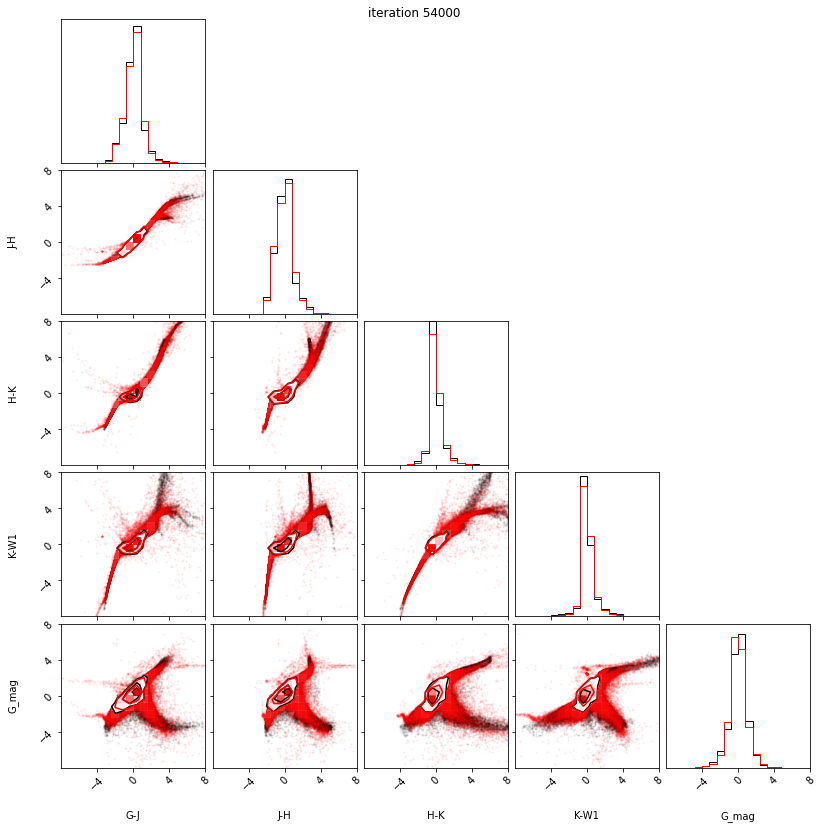

54100 -5.319579601287842 -5.335679531097412 1.3503317832946777 -inf
54200 -5.31072998046875 -5.314817905426025 1.315744400024414 -inf
54300 -5.3190460205078125 -5.316227436065674 1.324427604675293 -inf
54400 -5.261956691741943 -5.332714080810547 1.343496322631836 -inf
54500 -5.274968147277832 -5.317203998565674 1.3119316101074219 -inf
54600 -5.27643346786499 -5.29844856262207 1.3095970153808594 -inf
54700 -5.333460807800293 -5.352083206176758 1.265481948852539 -inf
54800 -5.258459568023682 -5.222050666809082 1.212573528289795 -inf
54900 -5.344722270965576 -5.358551979064941 1.2398161888122559 -inf
55000 -5.339982509613037 -5.355754852294922 1.21451997756958 -inf
1.21451997756958 -inf


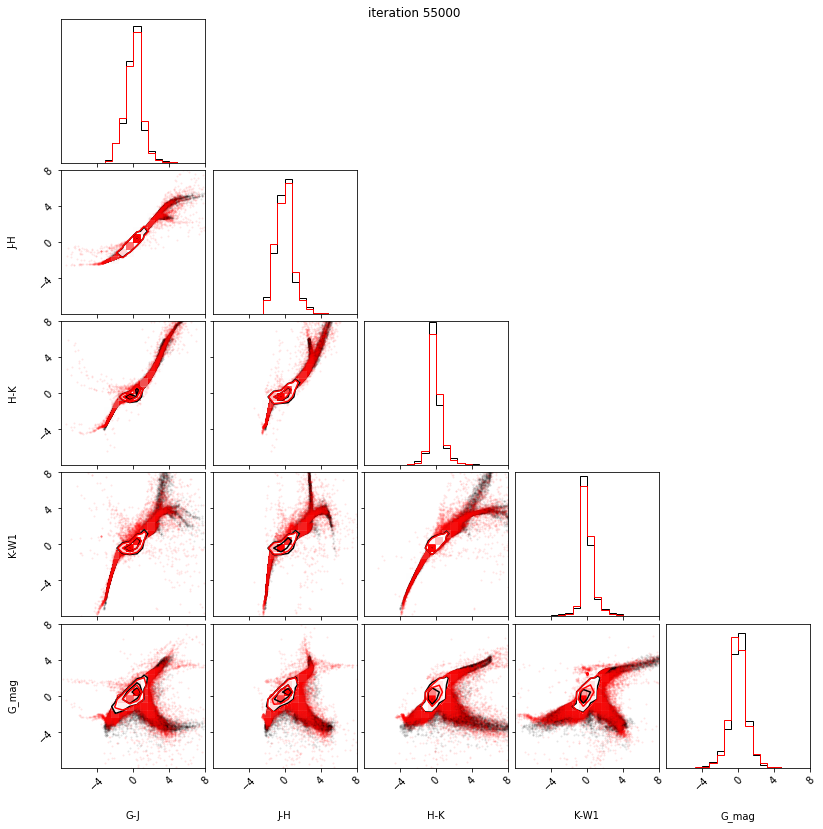

55100 -5.3604302406311035 -5.373610973358154 1.2336926460266113 -inf
55200 -5.338071823120117 -5.344895362854004 1.2082924842834473 -inf
55300 -5.304892063140869 -5.255616188049316 1.2967758178710938 -inf
55400 -5.370854377746582 -5.381997585296631 1.2098784446716309 -inf
55500 -5.288600444793701 -5.279388904571533 1.190359115600586 -inf
55600 -5.288149833679199 -5.231110095977783 1.2459487915039062 -inf
55700 -5.376018524169922 -5.3873114585876465 1.1951241493225098 -inf
55800 -5.378976345062256 -5.3932671546936035 1.1704111099243164 -inf
55900 -5.319418430328369 -5.319818019866943 1.1256661415100098 -inf
56000 -5.351992607116699 -5.3952717781066895 1.2049493789672852 -inf
1.2049493789672852 -inf


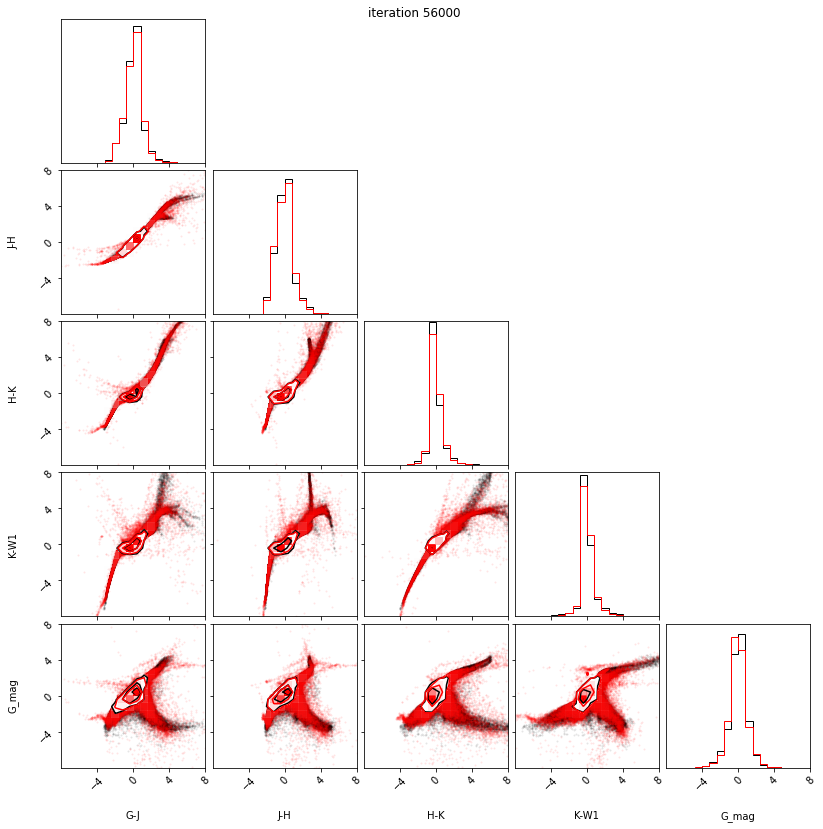

56100 -5.355940818786621 -5.381751537322998 1.1648635864257812 -inf
56200 -5.385555267333984 -5.361763000488281 1.200913429260254 -inf
56300 -5.38331413269043 -5.359961032867432 1.172685146331787 -inf
56400 -5.327177047729492 -5.321284770965576 1.2163033485412598 -inf
56500 -5.357562065124512 -5.300312519073486 1.2493767738342285 -inf
56600 -5.109462261199951 -5.163802146911621 1.0958619117736816 -inf
56700 -5.331358432769775 -5.396771430969238 1.1530418395996094 -inf
56800 -5.408617973327637 -5.423128128051758 1.135429859161377 -inf
56900 -5.154448986053467 -5.200374126434326 1.104602336883545 -inf
57000 -5.4146037101745605 -5.425851345062256 1.1085257530212402 -inf
1.1085257530212402 -inf


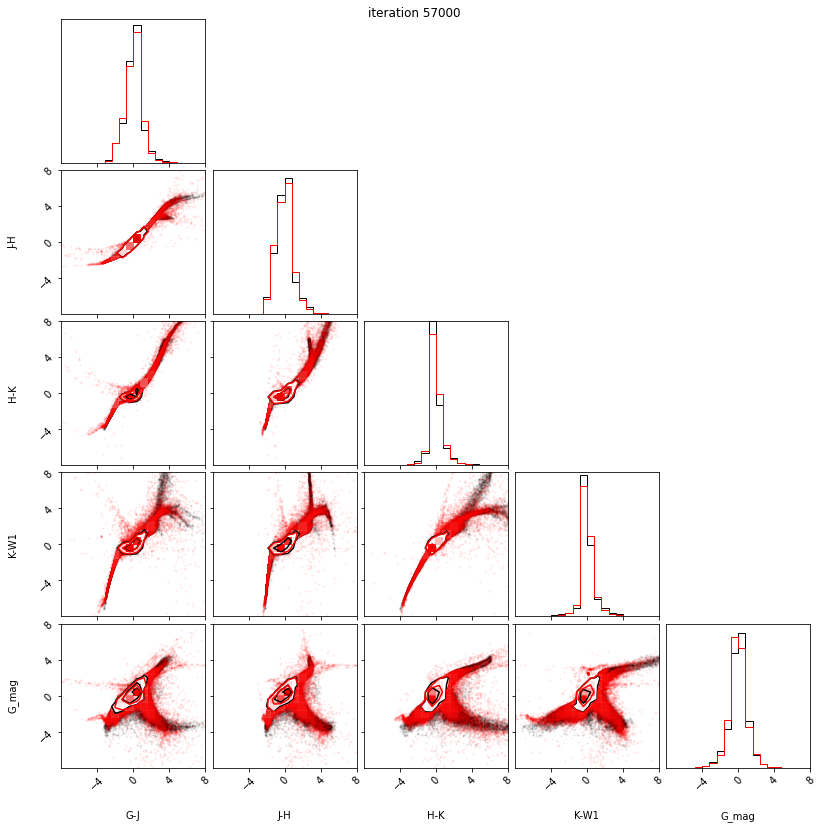

57100 -5.295555114746094 -5.290389537811279 1.1396760940551758 -inf
57200 -5.3860554695129395 -5.394269943237305 1.0898571014404297 -inf
57300 -5.418104648590088 -5.4357099533081055 1.0809478759765625 -inf
57400 -5.249365329742432 -5.26019287109375 1.019676685333252 -inf
57500 -5.419644355773926 -5.4430155754089355 1.0463342666625977 -inf
57600 -5.404393672943115 -5.434890270233154 1.0483102798461914 -inf
57700 -5.439388275146484 -5.451877117156982 1.0633935928344727 -inf
57800 -5.356875419616699 -5.329063415527344 0.9976701736450195 -inf
57900 -5.442465782165527 -5.453185081481934 1.0140109062194824 -inf
58000 -5.447492599487305 -5.460991859436035 1.0074191093444824 -inf
1.0074191093444824 -inf


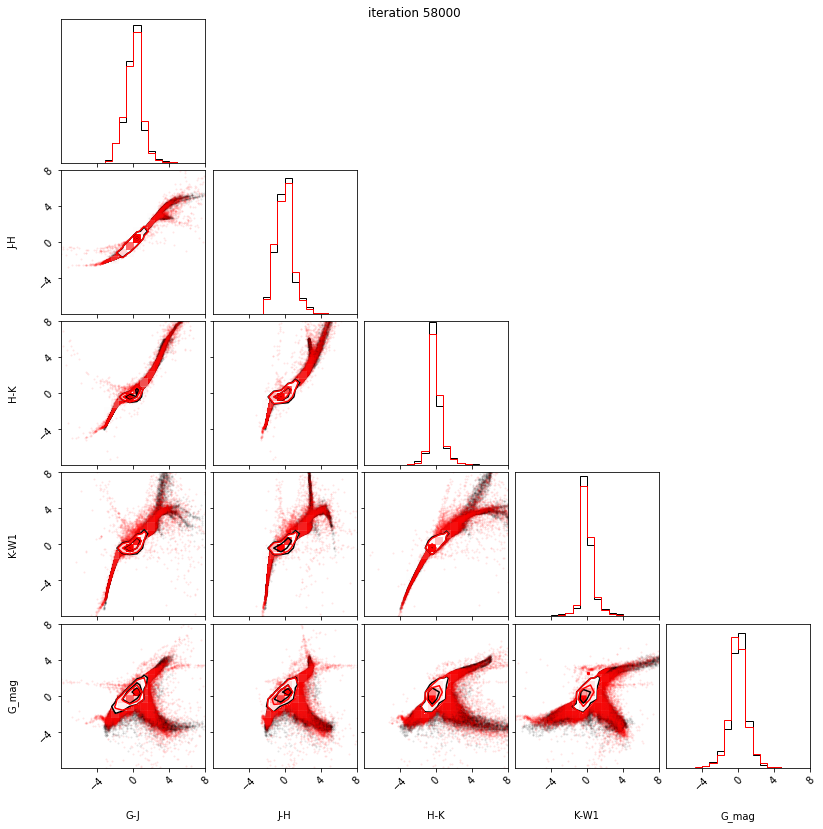

58100 -5.420238494873047 -5.435474395751953 1.016700267791748 -inf
58200 -5.42162561416626 -5.449601650238037 0.9898281097412109 -inf
58300 -5.4518866539001465 -5.452415466308594 1.0443840026855469 -inf
58400 -5.432523250579834 -5.429602146148682 0.8876819610595703 -inf
58500 -5.307363986968994 -5.345426559448242 0.9569625854492188 -inf
58600 -5.4473676681518555 -5.464509010314941 0.8598480224609375 -inf
58700 -5.465355396270752 -5.480201244354248 0.8417086601257324 -inf
58800 -5.210268497467041 -5.173995018005371 0.7321100234985352 -inf
58900 -5.460168838500977 -5.455366611480713 0.8227982521057129 -inf
59000 -5.475768089294434 -5.490009784698486 0.7825069427490234 -inf
0.7825069427490234 -inf


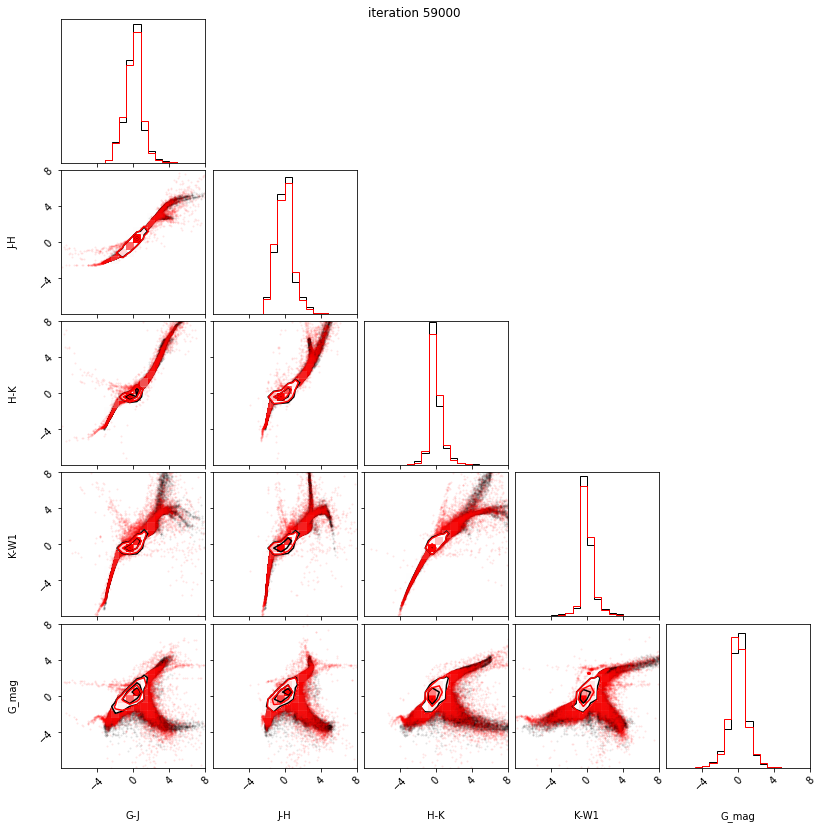

59100 -5.326591491699219 -5.319332122802734 0.7318048477172852 -inf
59200 -5.2418599128723145 -5.370087146759033 0.7237539291381836 -inf
59300 -4.574006080627441 -4.988104343414307 0.6206817626953125 -inf
59400 -5.489249229431152 -5.498709201812744 0.7465577125549316 -inf
59500 -5.482503890991211 -5.486135959625244 0.7452430725097656 -inf
59600 -5.475934028625488 -5.479022026062012 0.7604169845581055 -inf
59700 -5.063556671142578 -5.048281669616699 0.7737436294555664 -inf
59800 -5.385083198547363 -5.377091407775879 0.7415304183959961 -inf
59900 -5.469165325164795 -5.4870924949646 0.7619915008544922 -inf
60000 -5.4136552810668945 -5.41126012802124 0.7579565048217773 -inf
0.7579565048217773 -inf


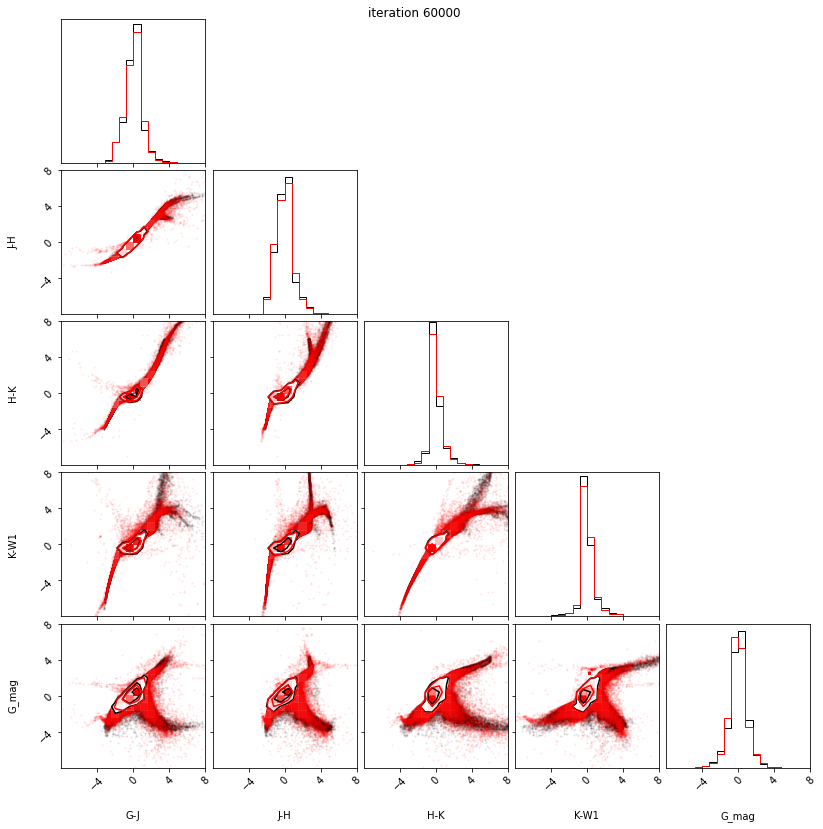

60100 -5.315934181213379 -5.31738805770874 0.7669858932495117 -inf
60200 -5.442492961883545 -5.446442127227783 0.7970132827758789 -inf
60300 -5.3249664306640625 -5.397184371948242 0.8146791458129883 -inf
60400 -5.011163711547852 -5.099254131317139 0.6862087249755859 -inf
60500 -5.40662956237793 -5.352405548095703 0.8089256286621094 -inf
60600 -5.414371967315674 -5.444431781768799 0.7673764228820801 -inf
60700 -5.483334064483643 -5.525515556335449 0.8606328964233398 -inf
60800 -5.495471000671387 -5.4849700927734375 0.8237142562866211 -inf
60900 -5.527690410614014 -5.523200035095215 0.7596220970153809 -inf
61000 -5.406296253204346 -5.360289573669434 0.7182989120483398 -inf
0.7182989120483398 -inf


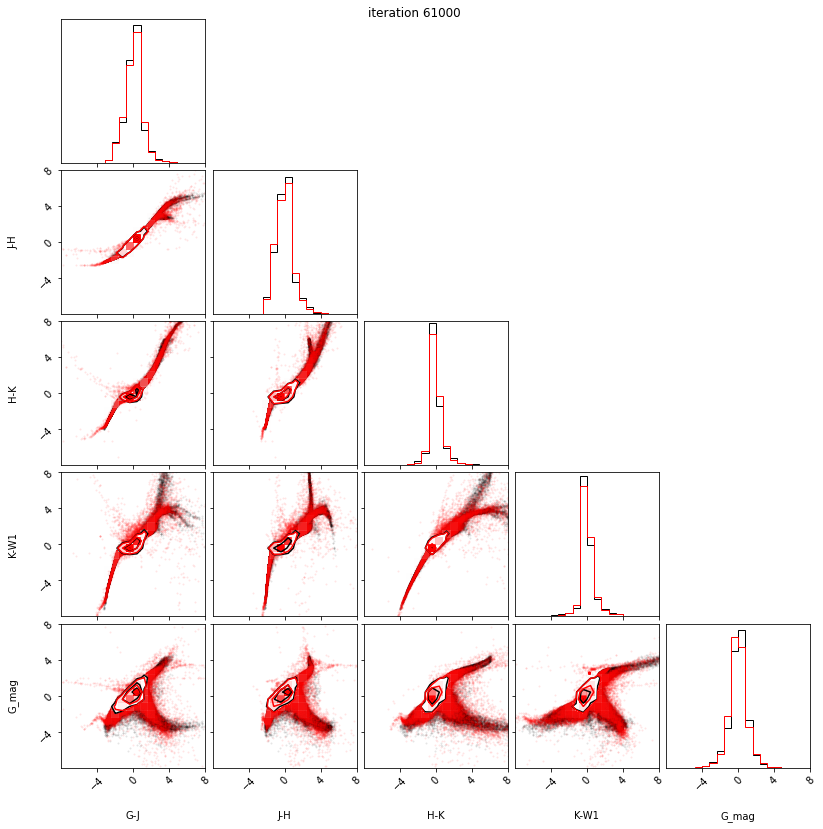

61100 -5.3560895919799805 -5.464168548583984 0.7965312004089355 -inf
61200 -5.271379470825195 -5.389089107513428 0.7087326049804688 -inf
61300 -5.5180487632751465 -5.542176246643066 0.7449030876159668 -inf
61400 -5.4381585121154785 -5.442718505859375 0.7195773124694824 -inf
61500 -5.544836521148682 -5.54911994934082 0.6817822456359863 -inf
61600 -5.5423126220703125 -5.554933071136475 0.6557784080505371 -inf
61700 -5.413050651550293 -5.4261474609375 0.6947546005249023 -inf
61800 -5.554361343383789 -5.562603950500488 0.7199902534484863 -inf
61900 -5.519168376922607 -5.506285667419434 0.773167610168457 -inf
62000 -4.662216663360596 -4.60826301574707 0.6224174499511719 -inf
0.6224174499511719 -inf


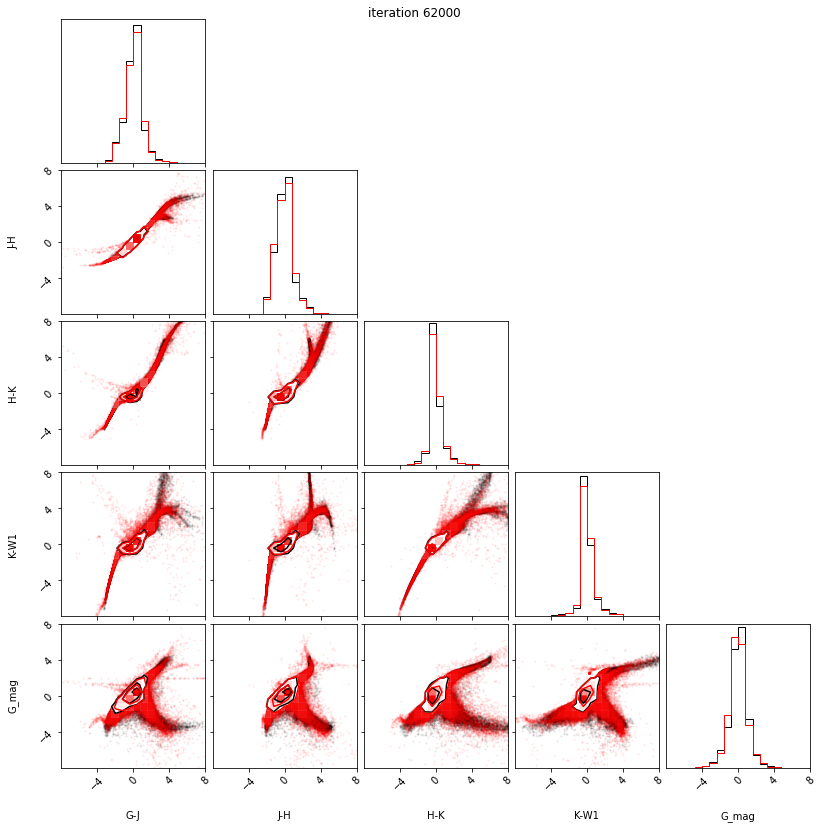

62100 -5.522243499755859 -5.520806312561035 0.6426644325256348 -inf
62200 -4.97254753112793 -4.838085651397705 0.5700778961181641 -inf
62300 -5.381162166595459 -5.3703389167785645 0.633152961730957 -inf
62400 -5.569229602813721 -5.579817771911621 0.6768121719360352 -inf
62500 -5.104421138763428 -5.084784030914307 0.6706638336181641 -inf
62600 -5.424371719360352 -5.29147481918335 0.8317470550537109 -inf
62700 -5.578646183013916 -5.582646369934082 0.6831684112548828 -inf
62800 -5.460605621337891 -5.516755104064941 0.7898950576782227 -inf
62900 -5.57487154006958 -5.579296588897705 0.7359418869018555 -inf
63000 -5.588011741638184 -5.58989143371582 0.7647628784179688 -inf
0.7647628784179688 -inf


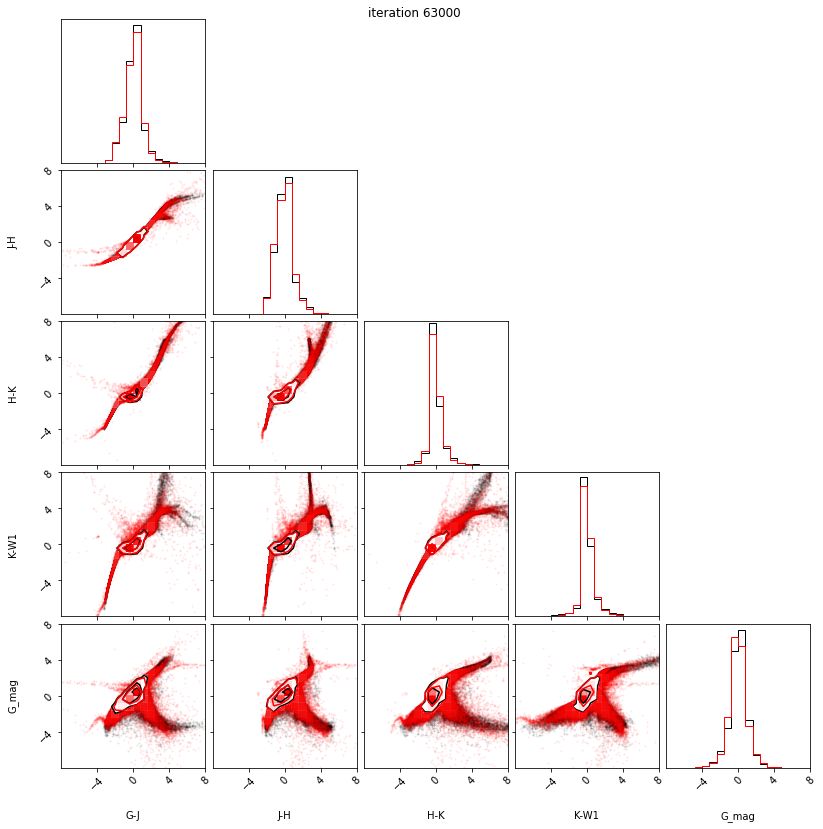

63100 -5.376100540161133 -5.428992748260498 0.7480568885803223 -inf
63200 -5.542999267578125 -5.593376636505127 0.7425451278686523 -inf
63300 -5.593627452850342 -5.586512565612793 0.7251796722412109 -inf
63400 -5.449891567230225 -5.579362392425537 0.7254972457885742 -inf
63500 -5.527318000793457 -5.577250003814697 0.7070951461791992 -inf
63600 -5.603306770324707 -5.606617450714111 0.7418689727783203 -inf
63700 -5.564347267150879 -5.600647449493408 0.8040628433227539 -inf
63800 -5.600170612335205 -5.5924482345581055 0.7630200386047363 -inf
63900 -5.574770927429199 -5.573302268981934 0.7830519676208496 -inf
64000 -5.550233840942383 -5.563446998596191 0.7691926956176758 -inf
0.7691926956176758 -inf


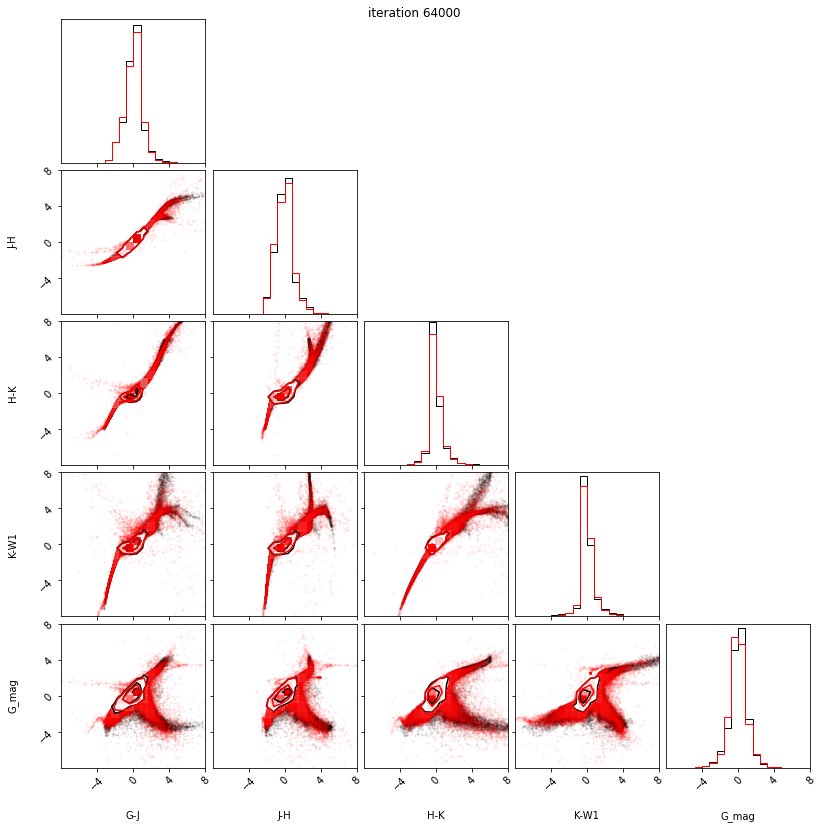

64100 -5.566208362579346 -5.558140277862549 0.7798852920532227 -inf
64200 -5.376308917999268 -5.389720439910889 0.7770328521728516 -inf
64300 -5.44109582901001 -5.564887046813965 0.8745851516723633 -inf
64400 -4.808335781097412 -4.646670341491699 0.7316350936889648 -inf
64500 -5.597126483917236 -5.601654052734375 0.8346099853515625 -inf
64600 -5.627047061920166 -5.633646011352539 0.8809137344360352 -inf
64700 -5.622751235961914 -5.615529537200928 0.8708291053771973 -inf
64800 -5.592691421508789 -5.611181259155273 0.962836742401123 -inf
64900 -5.609325408935547 -5.49745512008667 0.9595632553100586 -inf
65000 -5.601858139038086 -5.558913230895996 0.8861150741577148 -inf
0.8861150741577148 -inf


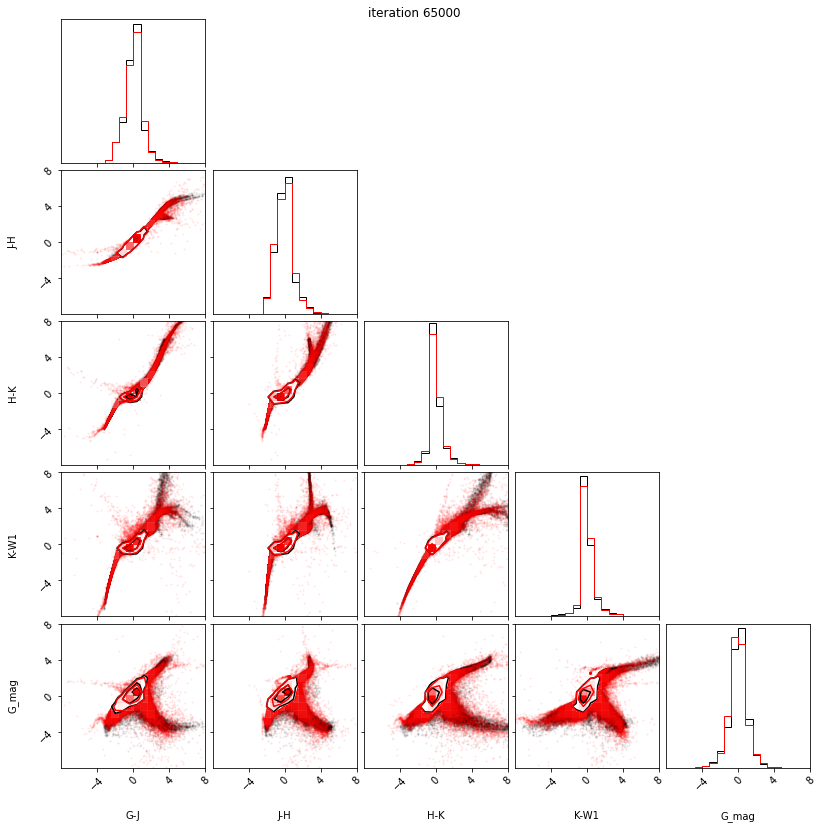

65100 -5.546371936798096 -5.5008344650268555 0.8502960205078125 -inf
65200 -5.515594959259033 -5.461517810821533 0.8829364776611328 -inf
65300 -5.645849704742432 -5.651314735412598 0.8950400352478027 -inf
65400 -5.635810852050781 -5.643135070800781 0.9703426361083984 -inf
65500 -5.5972676277160645 -5.616397857666016 0.9565796852111816 -inf
65600 -5.6501359939575195 -5.657950401306152 0.9316816329956055 -inf
65700 -5.622612953186035 -5.639634132385254 0.9259395599365234 -inf
65800 -5.603025913238525 -5.604888916015625 0.9438304901123047 -inf
65900 -5.53225040435791 -5.564874649047852 0.9009485244750977 -inf
66000 -5.47946834564209 -5.522741317749023 0.9192671775817871 -inf
0.9192671775817871 -inf


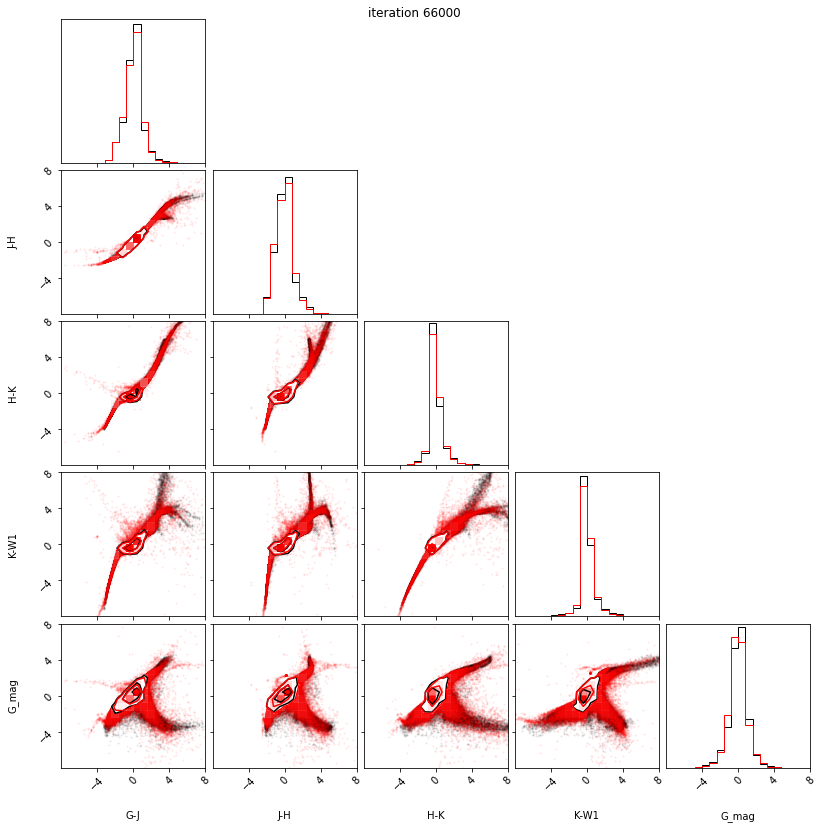

66100 -5.5982513427734375 -5.591963768005371 0.9922876358032227 -inf
66200 -5.602274417877197 -5.574067115783691 0.9664230346679688 -inf
66300 -5.571334362030029 -5.616876602172852 0.961756706237793 -inf
66400 -5.621266841888428 -5.611713886260986 0.9520797729492188 -inf
66500 -5.589522361755371 -5.5718889236450195 0.9641914367675781 -inf
66600 -5.561831951141357 -5.542571544647217 0.9459419250488281 -inf
66700 -5.606420040130615 -5.577969551086426 0.9586992263793945 -inf
66800 -5.669829845428467 -5.627500534057617 0.980196475982666 -inf
66900 -5.518057346343994 -5.524384021759033 0.9999489784240723 -inf
67000 -5.286025524139404 -4.940412521362305 1.0461797714233398 -inf
1.0461797714233398 -inf


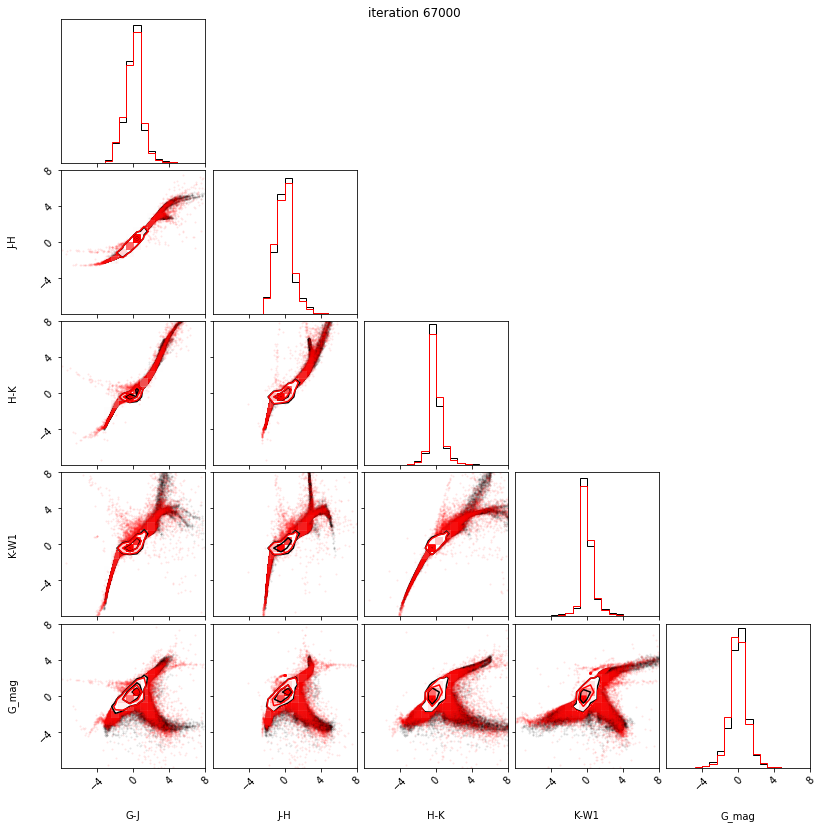

67100 -5.682765483856201 -5.689316272735596 0.9560079574584961 -inf
67200 -5.638153076171875 -5.646291255950928 0.9456272125244141 -inf
67300 -5.584071636199951 -5.6046833992004395 0.9666233062744141 -inf
67400 -5.614705562591553 -5.630373954772949 0.9386591911315918 -inf
67500 -5.667670249938965 -5.675224781036377 0.949256420135498 -inf
67600 -5.617599010467529 -5.620418548583984 0.9603257179260254 -inf
67700 -5.679887294769287 -5.701285362243652 1.001413345336914 -inf
67800 -5.698944568634033 -5.691773414611816 1.0276050567626953 -inf
67900 -5.491598129272461 -5.471255302429199 0.9857864379882812 -inf
68000 -5.632810115814209 -5.571101188659668 0.9575610160827637 -inf
0.9575610160827637 -inf


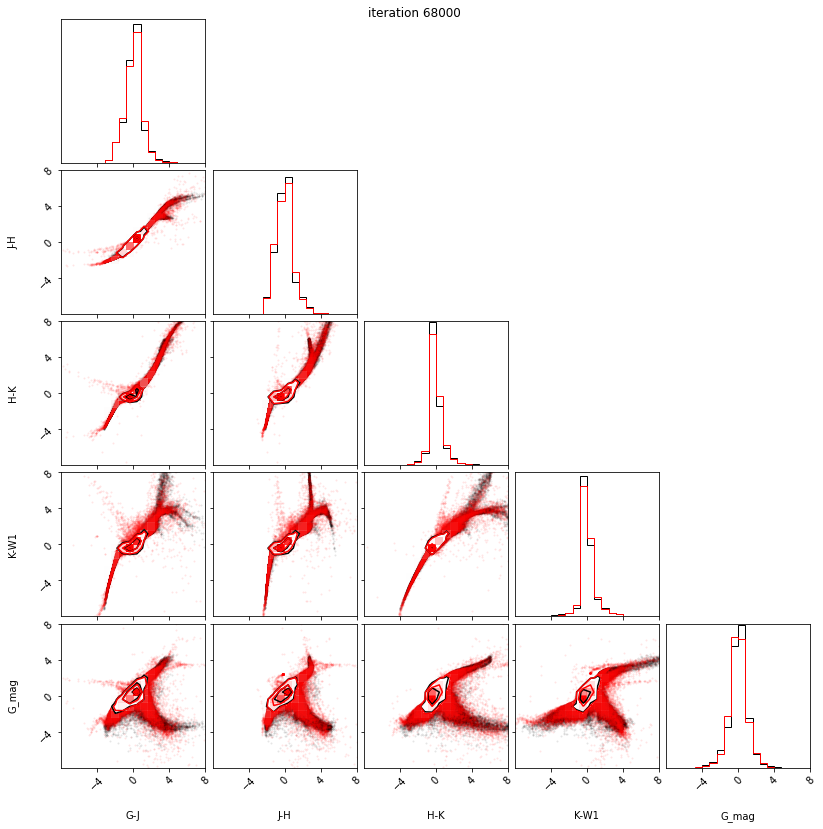

68100 -5.614816665649414 -5.667909622192383 1.1335539817810059 -inf
68200 -5.647249221801758 -5.488065719604492 1.0384016036987305 -inf
68300 -5.5058817863464355 -5.416826248168945 1.0618510246276855 -inf
68400 -5.595459938049316 -5.549709796905518 1.026906967163086 -inf
68500 -5.716451644897461 -5.721625804901123 0.982419490814209 -inf
68600 -5.702455520629883 -5.702145099639893 1.005706787109375 -inf
68700 -5.678801536560059 -5.66733980178833 1.0311846733093262 -inf
68800 -5.634519577026367 -5.668338775634766 1.068671703338623 -inf
68900 -5.6399664878845215 -5.630466461181641 1.060685157775879 -inf
69000 -5.721535682678223 -5.7190117835998535 1.0660443305969238 -inf
1.0660443305969238 -inf


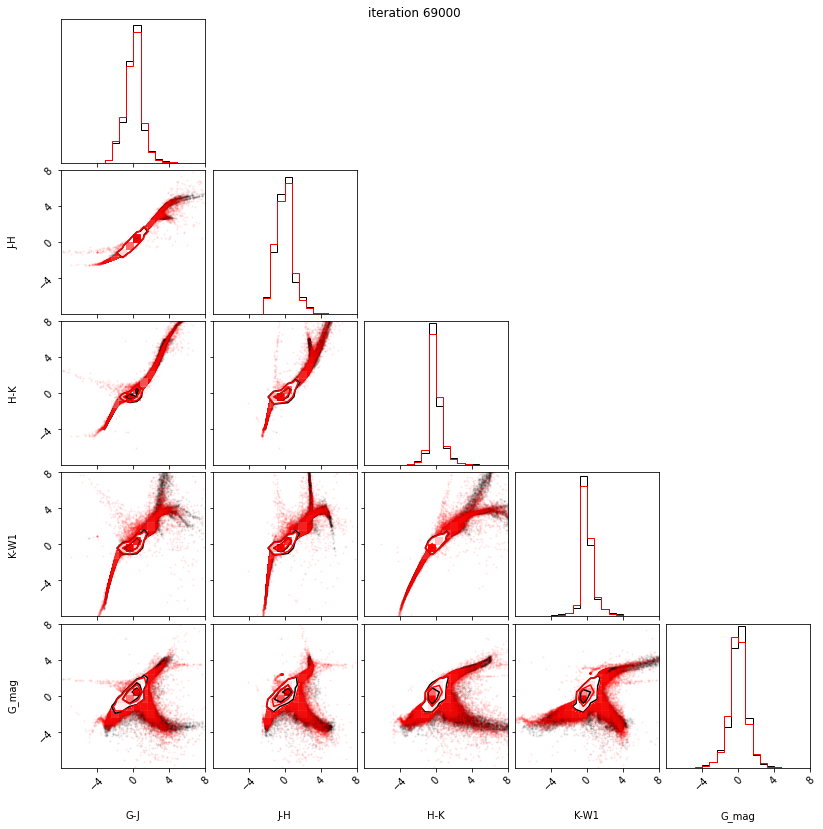

69100 -5.495729446411133 -5.63150691986084 1.0860352516174316 -inf
69200 -5.7148966789245605 -5.717746734619141 1.057708740234375 -inf
69300 -5.603119373321533 -5.682930946350098 1.203810214996338 -inf
69400 -5.5964765548706055 -5.643582344055176 1.1119327545166016 -inf
69500 -5.725678443908691 -5.71889066696167 1.1614494323730469 -inf
69600 -5.557657718658447 -5.569765090942383 1.0923409461975098 -inf
69700 -5.6388068199157715 -5.6701788902282715 1.1007213592529297 -inf
69800 -5.549666881561279 -5.249049663543701 1.2090177536010742 -inf
69900 -5.135247707366943 -5.0822882652282715 1.1184139251708984 -inf
70000 -5.722733497619629 -5.6975274085998535 1.195500373840332 -inf
1.195500373840332 -inf


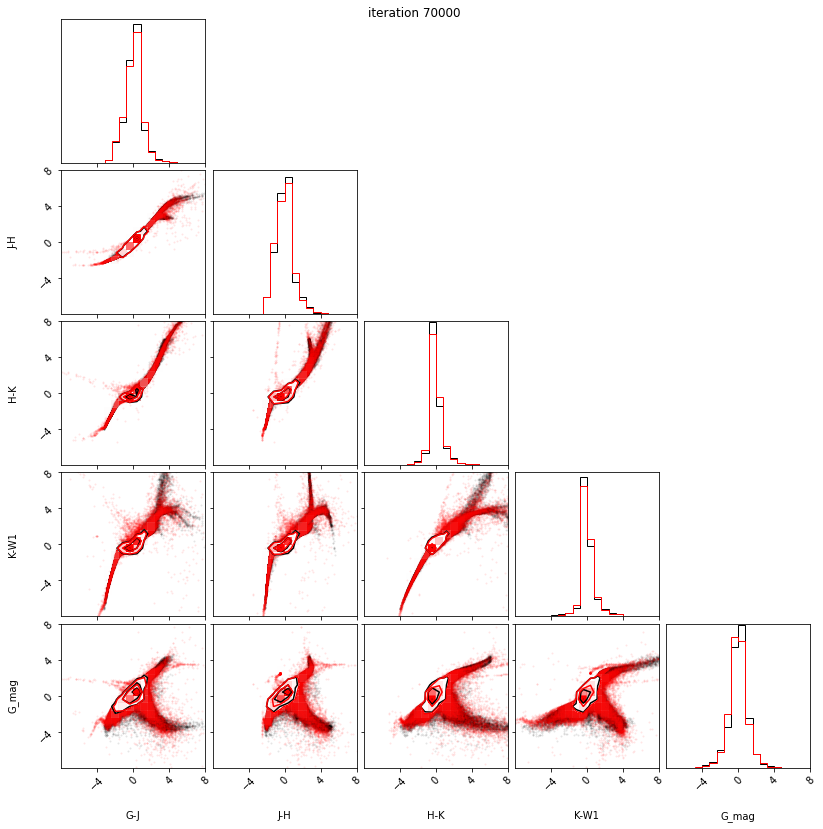

70100 -5.668406963348389 -5.631119728088379 1.1317806243896484 -inf
70200 -5.713433265686035 -5.747312545776367 1.138352870941162 -inf
70300 -5.518890380859375 -5.599874973297119 1.163912296295166 -inf
70400 -5.552221298217773 -5.2412285804748535 1.2551746368408203 -inf
70500 -4.4641008377075195 -4.350852966308594 1.1272988319396973 -inf
70600 -5.737584114074707 -5.736701965332031 1.218165397644043 -inf
70700 -5.7491679191589355 -5.754023551940918 1.196826457977295 -inf
70800 -5.740183353424072 -5.75536584854126 1.21433687210083 -inf
70900 -5.737679481506348 -5.755527973175049 1.187894344329834 -inf
71000 -5.708256244659424 -5.731272220611572 1.2181806564331055 -inf
1.2181806564331055 -inf


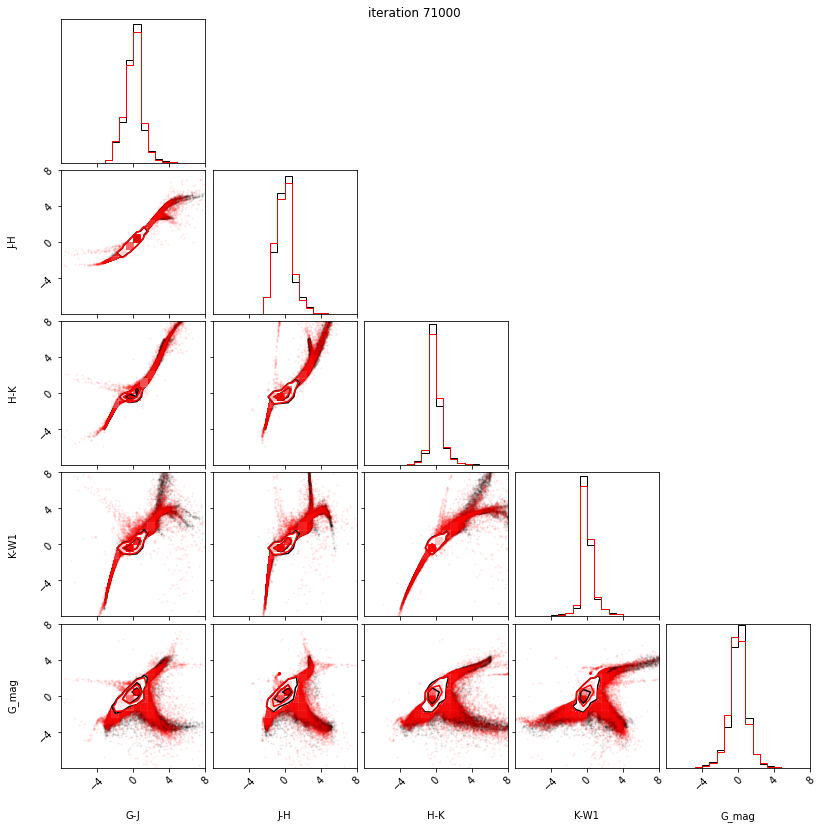

71100 -5.730494499206543 -5.756555557250977 1.243490219116211 -inf
71200 -5.731841087341309 -5.736355781555176 1.2142152786254883 -inf
71300 -5.728003025054932 -5.680631160736084 1.2845559120178223 -inf
71400 -5.070878028869629 -5.204369068145752 1.3639750480651855 -inf
71500 -5.7672882080078125 -5.767045974731445 1.2487821578979492 -inf
71600 -5.764451026916504 -5.77232551574707 1.2043933868408203 -inf
71700 -5.769219398498535 -5.762345314025879 1.2019963264465332 -inf
71800 -5.741970062255859 -5.727895736694336 1.2991094589233398 -inf
71900 -5.629487991333008 -5.494043827056885 1.1994514465332031 -inf
72000 -5.721092224121094 -5.772204399108887 1.2442622184753418 -inf
1.2442622184753418 -inf


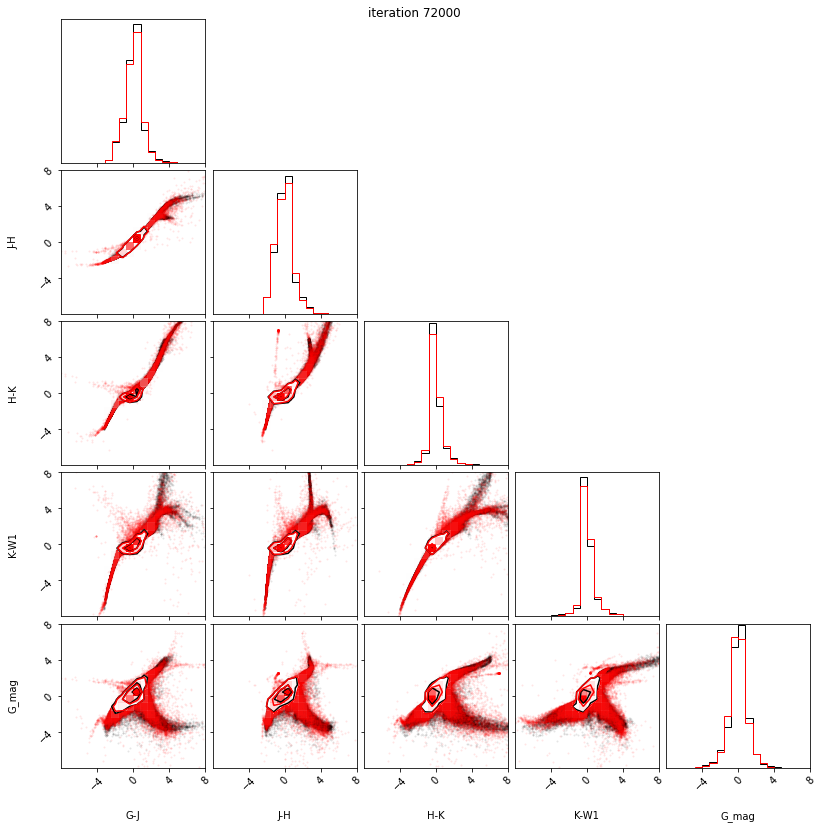

72100 -5.543113708496094 -5.536211013793945 1.216252326965332 -inf
72200 -5.765382766723633 -5.714803218841553 1.2109355926513672 -inf
72300 -5.766783237457275 -5.756772994995117 1.215318202972412 -inf
72400 -5.74908971786499 -5.729471206665039 1.1658353805541992 -inf
72500 -5.785244941711426 -5.7882161140441895 1.2356882095336914 -inf
72600 -5.773591041564941 -5.790308475494385 1.252912998199463 -inf
72700 -5.775802135467529 -5.72420597076416 1.3127079010009766 -inf
72800 -5.6334452629089355 -5.683011531829834 1.0700035095214844 -inf
72900 -5.53396463394165 -5.666128158569336 1.2777900695800781 -inf
73000 -5.45048713684082 -5.474080562591553 1.2018752098083496 -inf
1.2018752098083496 -inf


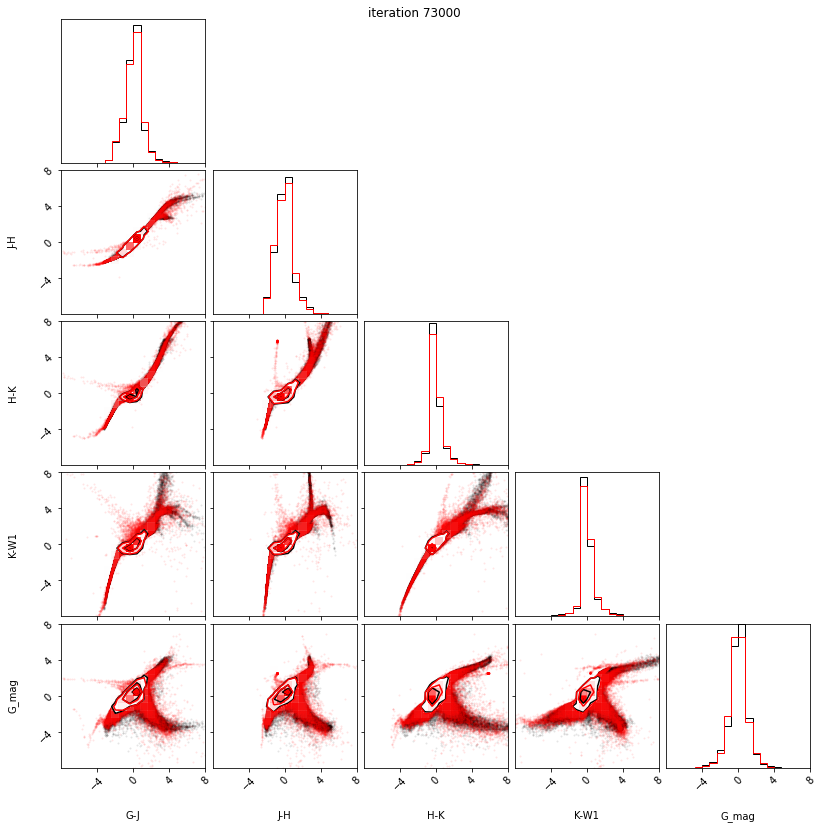

73100 -5.3378753662109375 -5.232949733734131 1.1873040199279785 -inf
73200 -5.196040630340576 -5.2713446617126465 1.1290287971496582 -inf
73300 -4.839113712310791 -4.950677871704102 1.319167137145996 -inf
73400 -5.802684783935547 -5.806516170501709 1.1805305480957031 -inf
73500 -5.7120184898376465 -5.698983192443848 1.2179875373840332 -inf
73600 -5.6038498878479 -5.69734525680542 1.2007317543029785 -inf
73700 -5.759160995483398 -5.685603618621826 1.1746788024902344 -inf
73800 -5.668864727020264 -5.762840270996094 1.1654281616210938 -inf
73900 -5.693216323852539 -5.654223918914795 1.1468300819396973 -inf
74000 -5.8064141273498535 -5.753551959991455 1.2569260597229004 -inf
1.2569260597229004 -inf


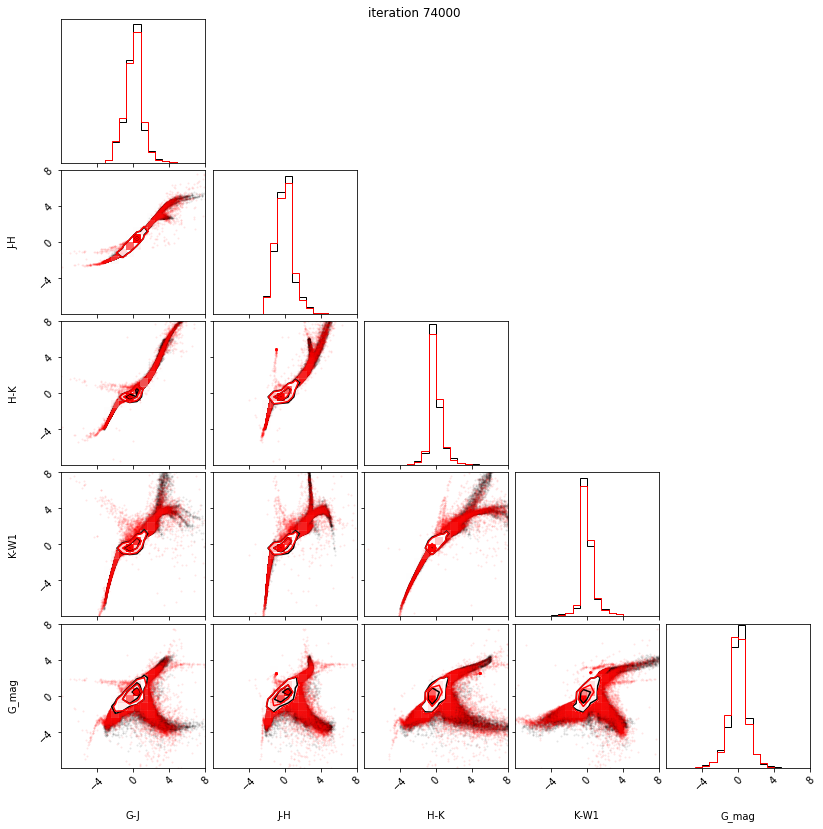

74100 -5.707810401916504 -5.782993793487549 1.221388816833496 -inf
74200 -5.787977695465088 -5.817902088165283 1.1696372032165527 -inf
74300 -5.7531418800354 -5.765206336975098 1.1469264030456543 -inf
74400 -5.070898532867432 -5.1095380783081055 1.1794819831848145 -inf
74500 -5.670297622680664 -5.726677894592285 1.3382763862609863 -inf
74600 -5.620578289031982 -5.722235202789307 1.2302184104919434 -inf
74700 -5.617337226867676 -5.681108474731445 1.1293087005615234 -inf
74800 -5.673887252807617 -5.630323886871338 1.1763019561767578 -inf
74900 -5.743336200714111 -5.521987438201904 1.0285086631774902 -inf
75000 -5.768386363983154 -5.699394702911377 1.068213939666748 -inf
1.068213939666748 -inf


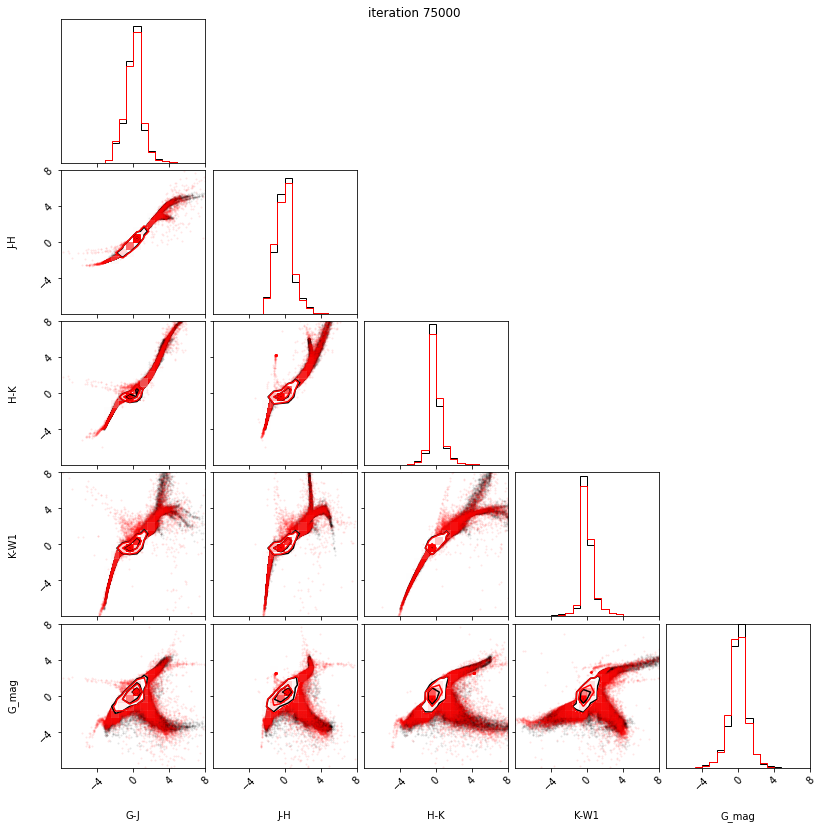

75100 -5.707235813140869 -5.680080413818359 1.0763564109802246 -inf
75200 -5.46738338470459 -5.624843120574951 1.081143856048584 -inf
75300 -5.752268314361572 -5.640509128570557 1.080735206604004 -inf
75400 -5.751845359802246 -5.671412467956543 1.1345033645629883 -inf
75500 -5.7182769775390625 -5.742464542388916 1.064073085784912 -inf
75600 -5.695077419281006 -5.7556352615356445 1.126093864440918 -inf
75700 -5.58914041519165 -5.783660888671875 1.1511316299438477 -inf
75800 -5.707453727722168 -5.632242202758789 1.1037235260009766 -inf
75900 -5.838857650756836 -5.850754737854004 1.1244277954101562 -inf
76000 -5.785598278045654 -5.822101593017578 1.1336121559143066 -inf
1.1336121559143066 -inf


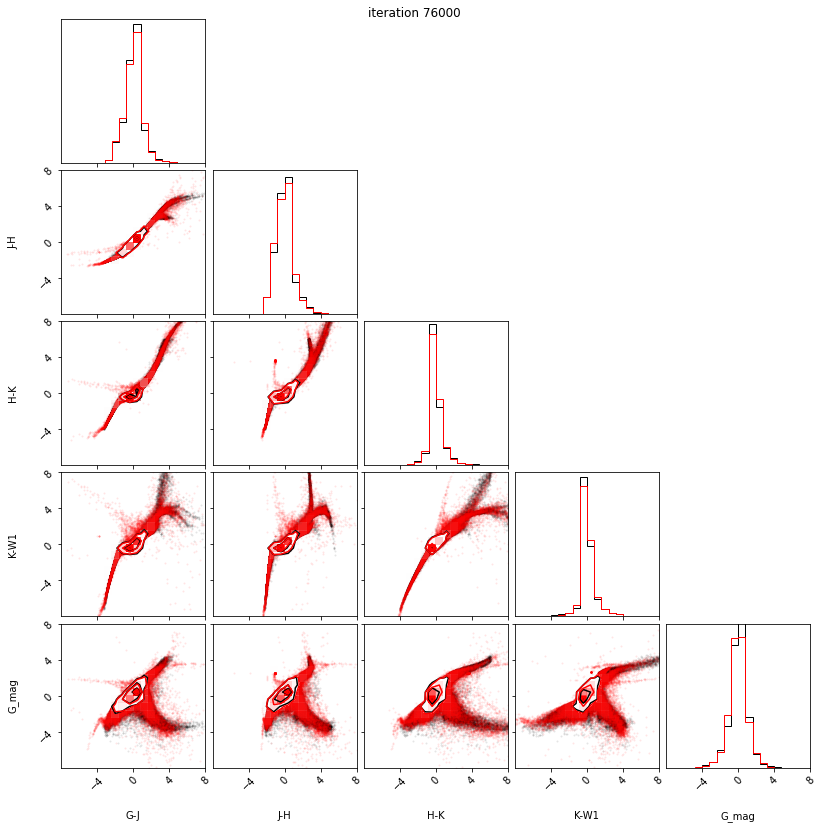

76100 -5.681912422180176 -5.743566513061523 1.1712779998779297 -inf
76200 -5.670434951782227 -5.696359634399414 1.1916780471801758 -inf
76300 -5.663382053375244 -5.806476593017578 1.0920162200927734 -inf
76400 -5.857811450958252 -5.848423957824707 1.1025280952453613 -inf
76500 -5.804891109466553 -5.73743200302124 0.9751248359680176 -inf
76600 -5.849875450134277 -5.865392208099365 1.0187487602233887 -inf
76700 -5.707638263702393 -5.551537990570068 1.1057705879211426 -inf
76800 -5.839749813079834 -5.733911037445068 1.0548510551452637 -inf
76900 -5.757927417755127 -5.814637184143066 1.0310983657836914 -inf
77000 -5.778193473815918 -5.830291271209717 0.9998540878295898 -inf
0.9998540878295898 -inf


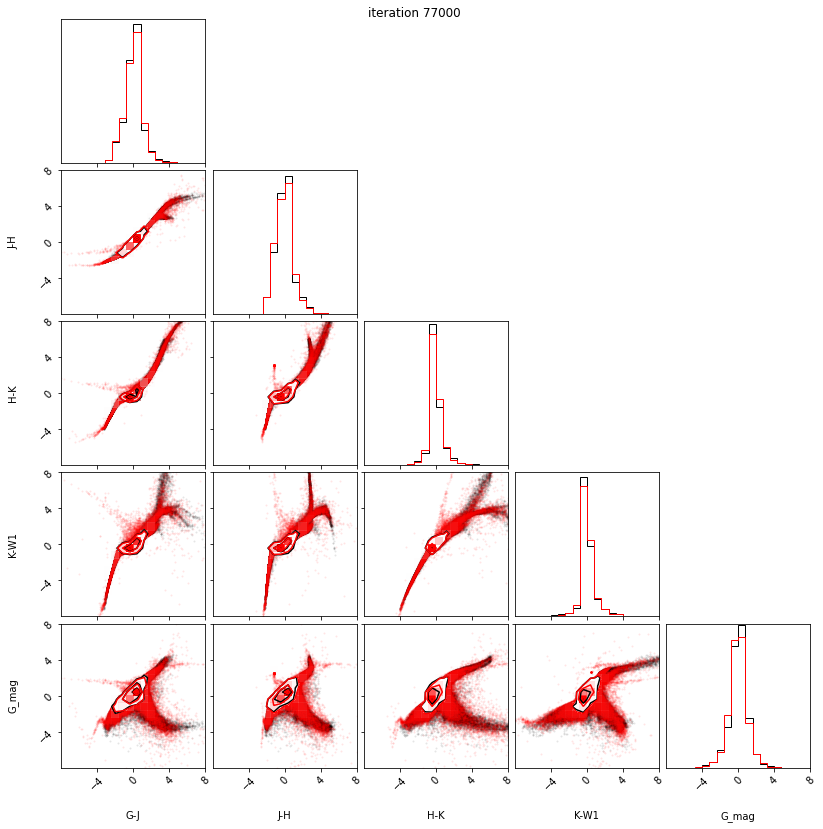

77100 -5.33171272277832 -5.08635139465332 1.1902079582214355 -inf
77200 -5.443859100341797 -5.658450603485107 1.0374231338500977 -inf
77300 -5.863424777984619 -5.8733906745910645 1.0681829452514648 -inf
77400 -5.656260013580322 -5.65671968460083 1.095916748046875 -inf
77500 -5.729962348937988 -5.792752742767334 1.0273356437683105 -inf
77600 -5.771091938018799 -5.638676643371582 1.174072265625 -inf
77700 -5.804477691650391 -5.8247857093811035 1.0029592514038086 -inf
77800 -5.806360244750977 -5.818167209625244 0.9903697967529297 -inf
77900 -5.5527873039245605 -5.498278617858887 1.0296969413757324 -inf
78000 -5.885202407836914 -5.888866901397705 0.9979276657104492 -inf
0.9979276657104492 -inf


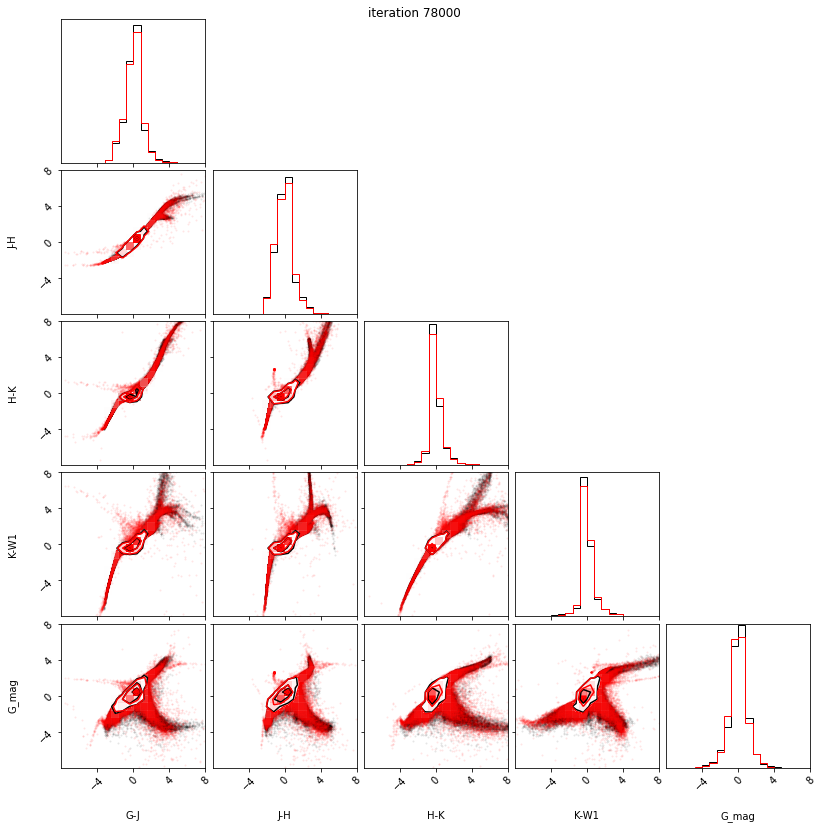

78100 -5.757146835327148 -5.554823875427246 1.1157450675964355 -inf
78200 -3.4507498741149902 -4.668571949005127 1.1582627296447754 -inf
78300 -5.873144149780273 -5.869719982147217 1.0797295570373535 -inf
78400 -5.87175989151001 -5.836052417755127 1.0830812454223633 -inf
78500 -5.846112251281738 -5.779763221740723 1.026045322418213 -inf
78600 -5.886277198791504 -5.856140613555908 1.007573127746582 -inf
78700 -5.842165470123291 -5.808902740478516 0.971491813659668 -inf
78800 -5.6223273277282715 -5.824716091156006 1.0788359642028809 -inf
78900 -5.47363805770874 -5.257241725921631 1.0519962310791016 -inf
79000 -5.869470596313477 -5.8632493019104 1.0226073265075684 -inf
1.0226073265075684 -inf


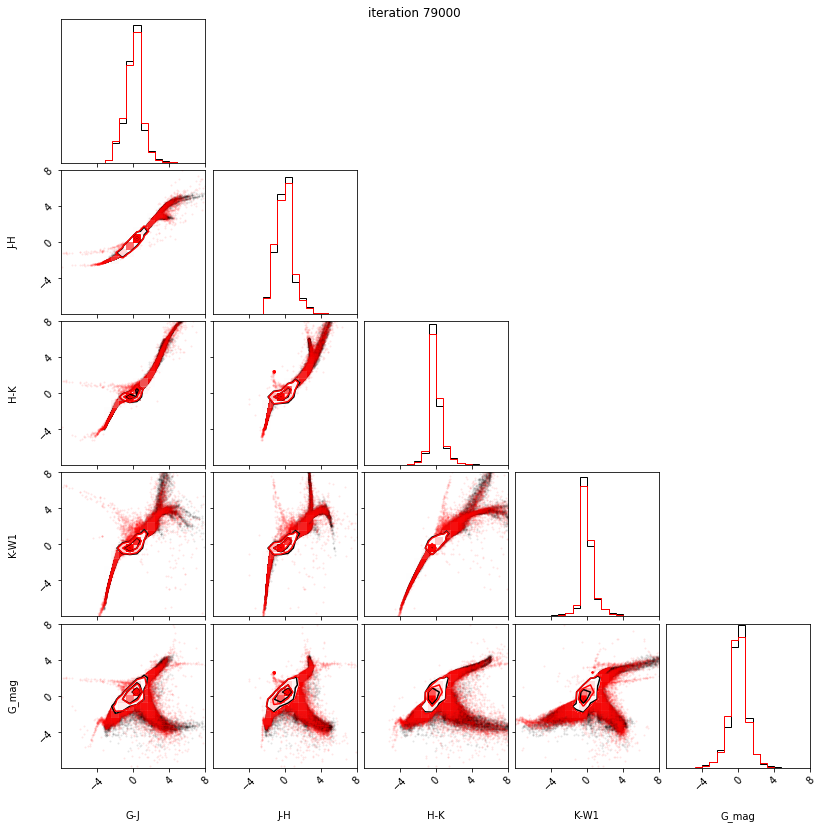

79100 -5.676320552825928 -5.572700500488281 1.033646583557129 -inf
79200 -5.662436008453369 -5.6410136222839355 0.918428897857666 -inf
79300 -5.850159168243408 -5.853911399841309 1.1118741035461426 -inf
79400 -5.902034282684326 -5.89114236831665 1.0293159484863281 -inf
79500 -5.80578088760376 -5.764471054077148 0.900423526763916 -inf
79600 -4.711712837219238 -5.225498199462891 0.9299759864807129 -inf
79700 -5.903225421905518 -5.9022016525268555 1.025899887084961 -inf
79800 -5.864943504333496 -5.898890495300293 0.9814634323120117 -inf
79900 -5.773168087005615 -5.850053787231445 0.9883723258972168 -inf
80000 -5.871262550354004 -5.870601177215576 1.0176067352294922 -inf
1.0176067352294922 -inf


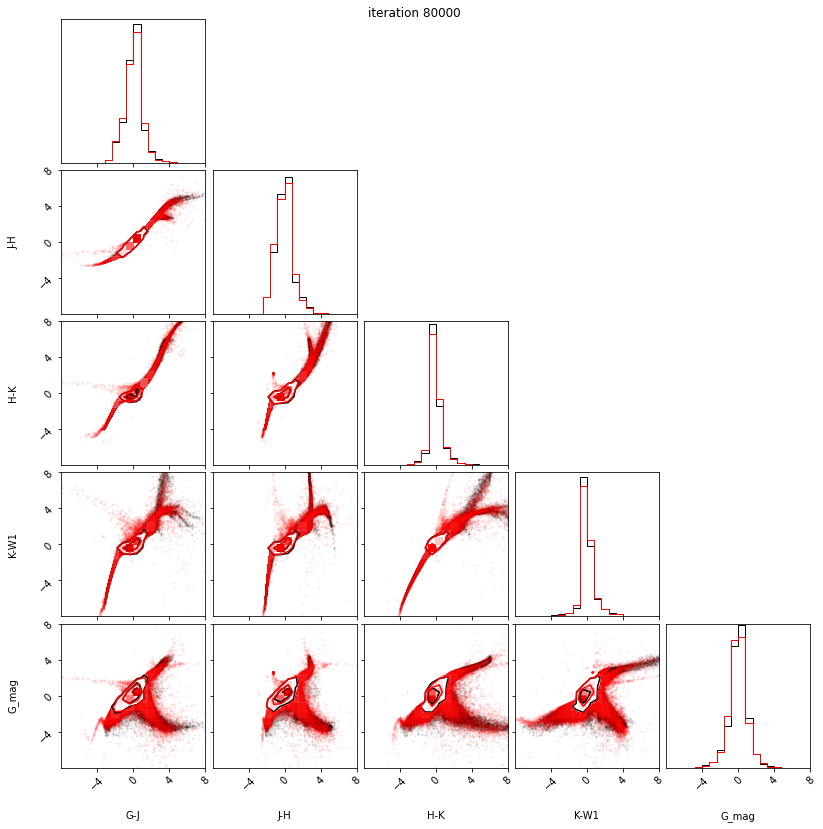

80100 -5.58063268661499 -5.424103736877441 0.9971780776977539 -inf
80200 -5.783296585083008 -5.605186462402344 1.0717487335205078 -inf
80300 -5.904200077056885 -5.8912577629089355 0.9998493194580078 -inf
80400 -5.90110445022583 -5.901021957397461 1.0068936347961426 -inf
80500 -5.616478443145752 -5.781257629394531 0.9274587631225586 -inf
80600 -5.527901649475098 -5.498446941375732 0.9967541694641113 -inf
80700 -5.850490570068359 -5.740981578826904 0.9922504425048828 -inf
80800 -5.715647220611572 -5.769760608673096 0.992617130279541 -inf
80900 -5.756241321563721 -5.848982334136963 0.9468345642089844 -inf
81000 -5.894802570343018 -5.899390697479248 1.1486430168151855 -inf
1.1486430168151855 -inf


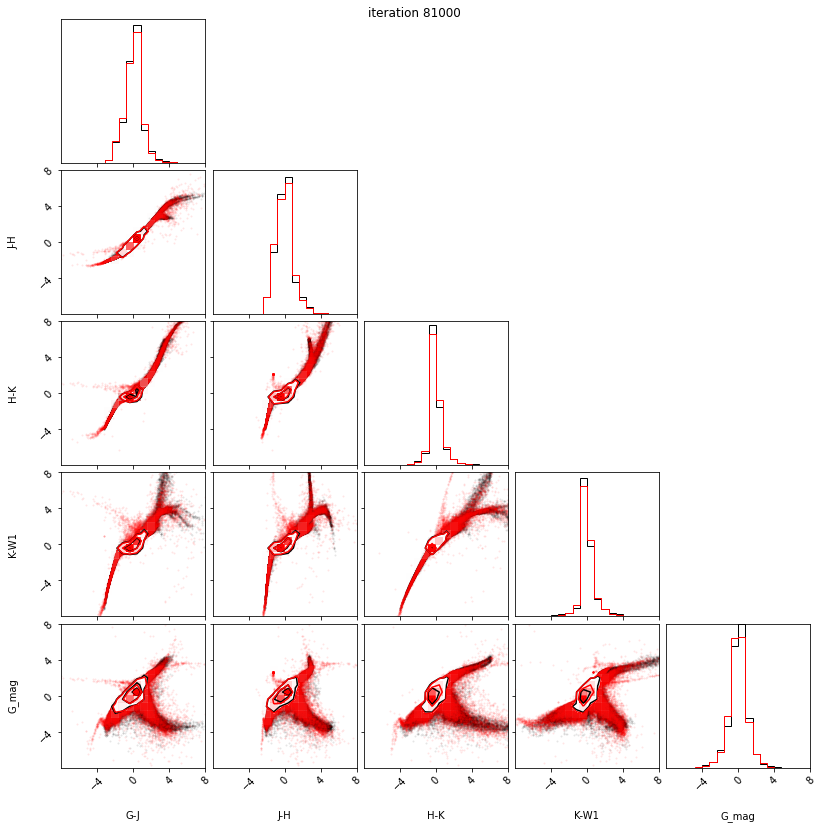

81100 -5.773709297180176 -5.7846245765686035 1.1163277626037598 -inf
81200 -5.802687168121338 -5.841846942901611 1.0204143524169922 -inf
81300 -5.808106422424316 -5.815813064575195 0.9732122421264648 -inf
81400 -5.788864612579346 -5.843118190765381 0.9840302467346191 -inf
81500 -5.886845111846924 -5.762209415435791 1.0764756202697754 -inf
81600 -5.941439151763916 -5.941361427307129 0.9783182144165039 -inf
81700 -5.927295207977295 -5.921743392944336 0.9477357864379883 -inf
81800 -5.9318461418151855 -5.9269890785217285 1.0052251815795898 -inf
81900 -5.930817604064941 -5.892914295196533 0.9967122077941895 -inf
82000 -5.825223445892334 -5.747757434844971 1.0771994590759277 -inf
1.0771994590759277 -inf


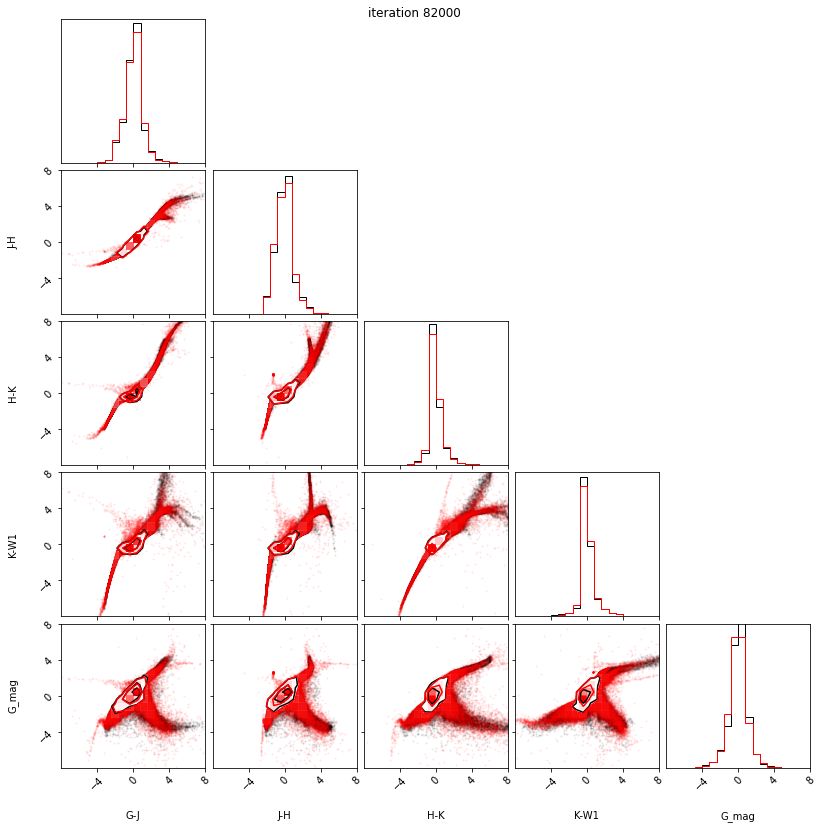

82100 -5.918708801269531 -5.875214099884033 1.0195503234863281 -inf
82200 -5.882076263427734 -5.840231895446777 1.0248050689697266 -inf
82300 -3.9417455196380615 -4.763648986816406 0.6977529525756836 -inf
82400 -5.92186164855957 -5.923191070556641 1.0220727920532227 -inf
82500 -5.951750755310059 -5.94743537902832 1.0272307395935059 -inf
82600 -5.944880485534668 -5.941292762756348 1.0279450416564941 -inf
82700 -5.91542911529541 -5.906857013702393 1.0659470558166504 -inf
82800 -5.943338871002197 -5.943912506103516 1.0001897811889648 -inf
82900 -5.839175701141357 -5.828855514526367 1.024134635925293 -inf
83000 -5.88243293762207 -5.891326427459717 0.9764266014099121 -inf
0.9764266014099121 -inf


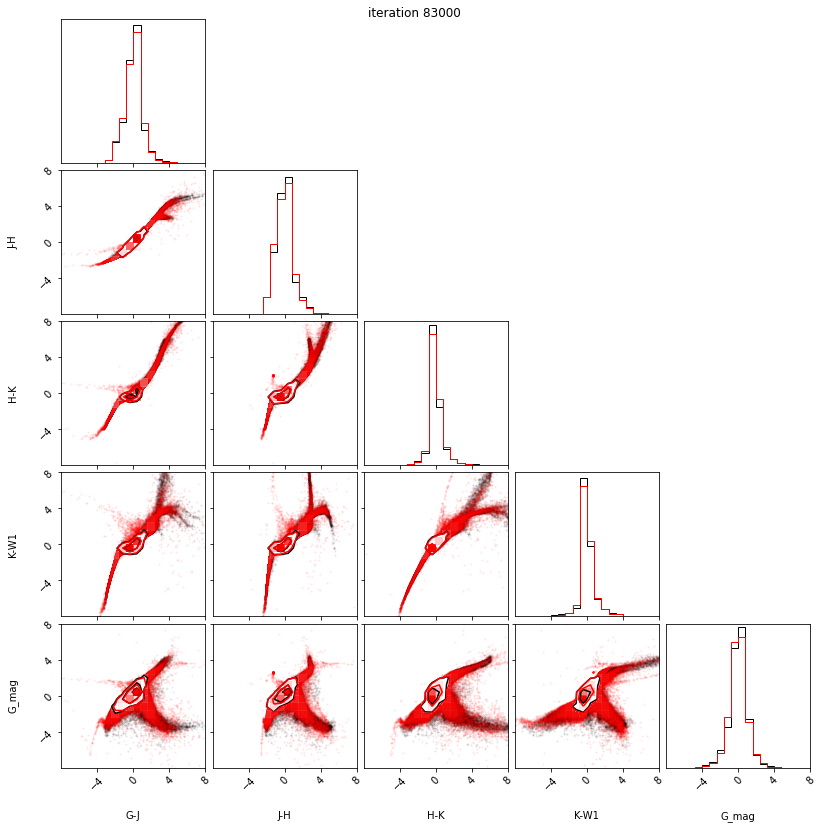

83100 -5.922065258026123 -5.920627117156982 1.0831503868103027 -inf
83200 -5.882412910461426 -5.843648910522461 1.1226139068603516 -inf
83300 -5.672804355621338 -5.603257179260254 1.084507942199707 -inf
83400 -5.826727867126465 -5.555115699768066 0.9548325538635254 -inf
83500 -5.809507846832275 -5.724007606506348 1.0887432098388672 -inf
83600 -5.795310974121094 -5.8401265144348145 0.9881420135498047 -inf
83700 -5.950442314147949 -5.879989147186279 1.0207061767578125 -inf
83800 -5.793254375457764 -5.607223033905029 1.115466594696045 -inf
83900 -5.688736915588379 -5.754084587097168 0.8393688201904297 -inf
84000 -5.7271728515625 -5.905688285827637 0.8590688705444336 -inf
0.8590688705444336 -inf


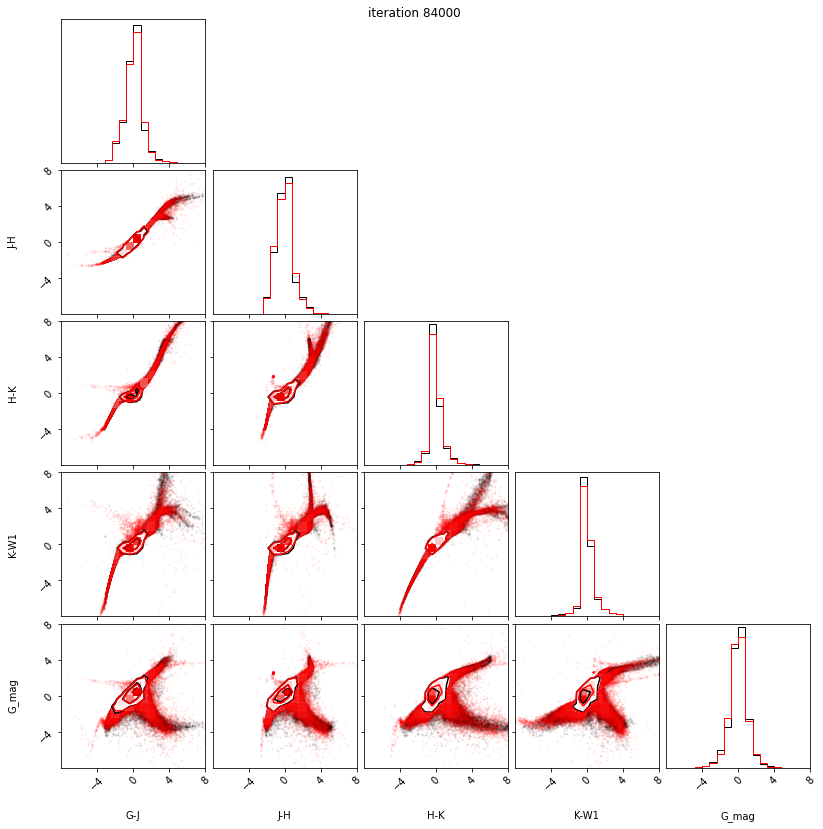

84100 -5.295429706573486 -5.3905253410339355 1.056948184967041 -inf
84200 -5.949990272521973 -5.975307464599609 0.986548900604248 -inf
84300 -5.805420398712158 -5.888657093048096 0.8945293426513672 -inf
84400 -5.66948938369751 -5.696442604064941 0.9484329223632812 -inf
84500 -5.756339073181152 -5.707768440246582 0.9978089332580566 -inf
84600 -5.953910827636719 -5.939420223236084 0.9543251991271973 -inf
84700 -5.958087921142578 -5.950441837310791 0.9643316268920898 -inf
84800 -5.8859944343566895 -5.83524751663208 0.9225506782531738 -inf
84900 -5.442584037780762 -5.540341854095459 0.8900132179260254 -inf
85000 -5.571268558502197 -5.828766822814941 1.009803295135498 -inf
1.009803295135498 -inf


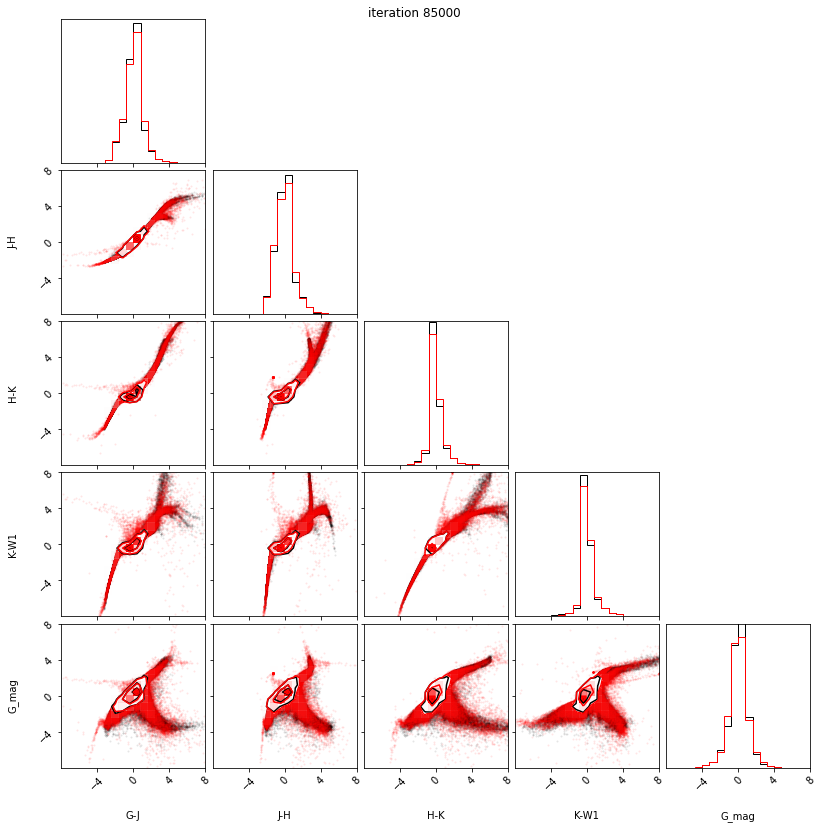

85100 -5.950752258300781 -5.931358337402344 0.9543771743774414 -inf
85200 -5.950642108917236 -5.921462535858154 0.9137024879455566 -inf
85300 -5.7994160652160645 -5.661485195159912 0.8985557556152344 -inf
85400 -5.736431121826172 -5.6027092933654785 1.1552181243896484 -inf
85500 -5.772511005401611 -5.775758266448975 0.7731804847717285 -inf
85600 -5.875774383544922 -5.820199012756348 1.1329283714294434 -inf
85700 -5.95392370223999 -5.905933856964111 0.8969111442565918 -inf
85800 -5.709580898284912 -5.6607232093811035 0.9869627952575684 -inf
85900 -5.774600028991699 -5.843219757080078 1.0394535064697266 -inf
86000 -5.976523399353027 -5.937768459320068 0.9777736663818359 -inf
0.9777736663818359 -inf


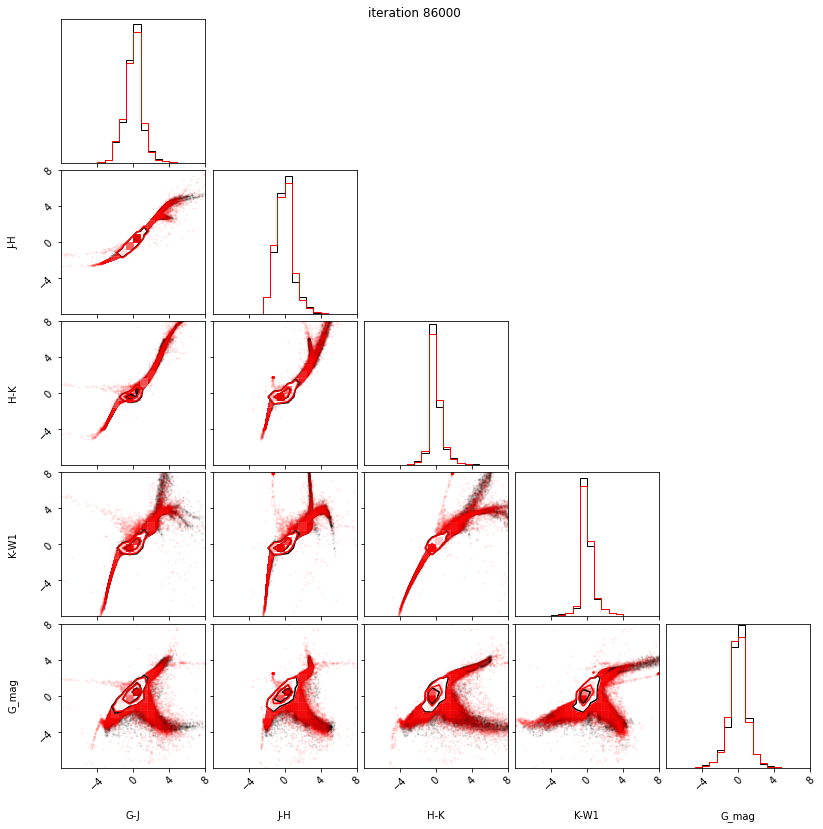

86100 -5.870117664337158 -5.969517707824707 0.9834880828857422 -inf
86200 -5.887545108795166 -5.900895595550537 0.9719734191894531 -inf
86300 -5.978524208068848 -5.974815368652344 1.0482468605041504 -inf
86400 -5.937150001525879 -5.947037220001221 1.1483287811279297 -inf
86500 -4.9970622062683105 -5.809152126312256 0.7797021865844727 -inf
86600 -5.980973243713379 -5.983987331390381 1.079878330230713 -inf
86700 -5.854394435882568 -5.955193042755127 0.952301025390625 -inf
86800 -5.834173679351807 -5.844690799713135 0.9836015701293945 -inf
86900 -5.983129978179932 -6.003146648406982 0.9876198768615723 -inf
87000 -5.956268310546875 -5.975552082061768 0.9991612434387207 -inf
0.9991612434387207 -inf


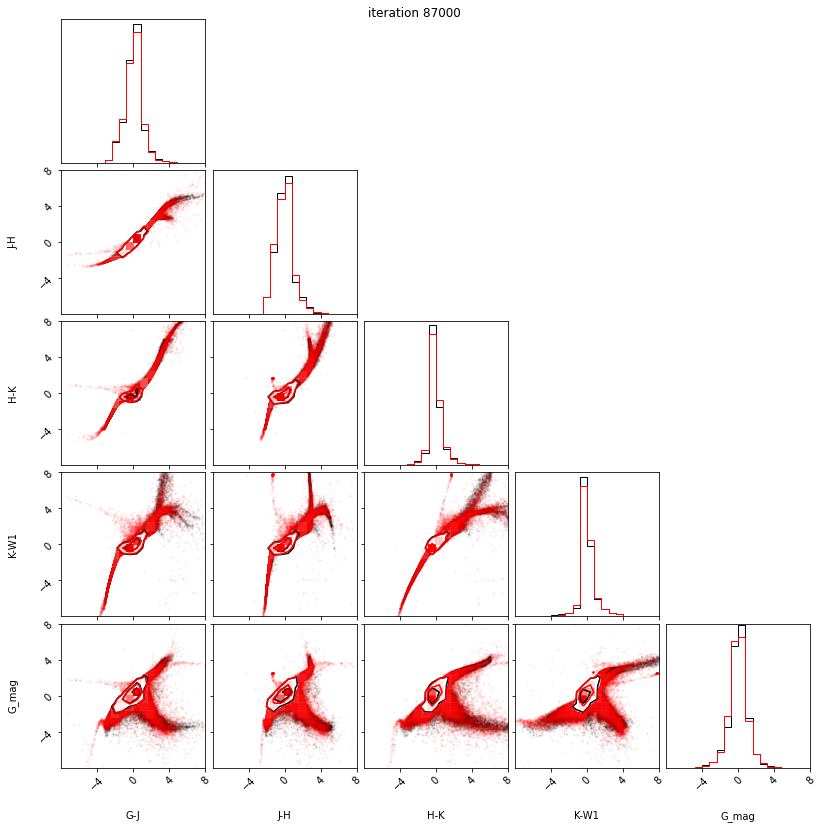

87100 -5.891368865966797 -5.897868633270264 1.0579843521118164 -inf
87200 -6.017457008361816 -6.020743370056152 1.0026545524597168 -inf
87300 -5.871303558349609 -5.761693000793457 0.9726033210754395 -inf
87400 -5.994536399841309 -6.017128944396973 1.0436310768127441 -inf
87500 -5.955435752868652 -5.973397254943848 1.0163774490356445 -inf
87600 -5.861635208129883 -5.863196849822998 0.903902530670166 -inf
87700 -5.960258960723877 -5.896536827087402 1.055689811706543 -inf
87800 -5.422322750091553 -5.412467002868652 0.8957023620605469 -inf
87900 -5.9591546058654785 -5.965821266174316 1.0378398895263672 -inf
88000 -5.72023868560791 -5.757490634918213 1.1104369163513184 -inf
1.1104369163513184 -inf


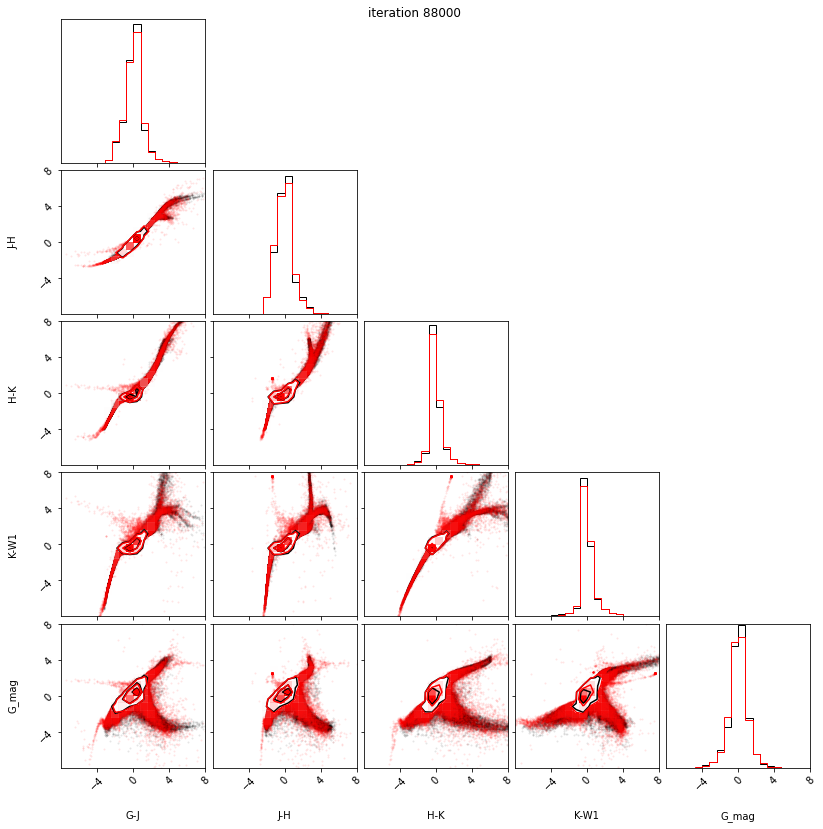

88100 -5.964762210845947 -5.927952766418457 1.0456781387329102 -inf
88200 -6.008556842803955 -5.99912166595459 1.0316691398620605 -inf
88300 -5.914242744445801 -5.884690761566162 1.1486406326293945 -inf
88400 -5.854193687438965 -5.842428207397461 1.02239990234375 -inf
88500 -5.967134952545166 -5.994441986083984 1.0747532844543457 -inf
88600 -5.8874125480651855 -5.783263206481934 1.1915922164916992 -inf
88700 -5.974027156829834 -6.0134968757629395 1.0441527366638184 -inf
88800 -5.920985698699951 -5.927720546722412 1.0096230506896973 -inf
88900 -5.971719264984131 -5.685123920440674 0.84405517578125 -inf
89000 -6.003659725189209 -5.996219158172607 1.1256251335144043 -inf
1.1256251335144043 -inf


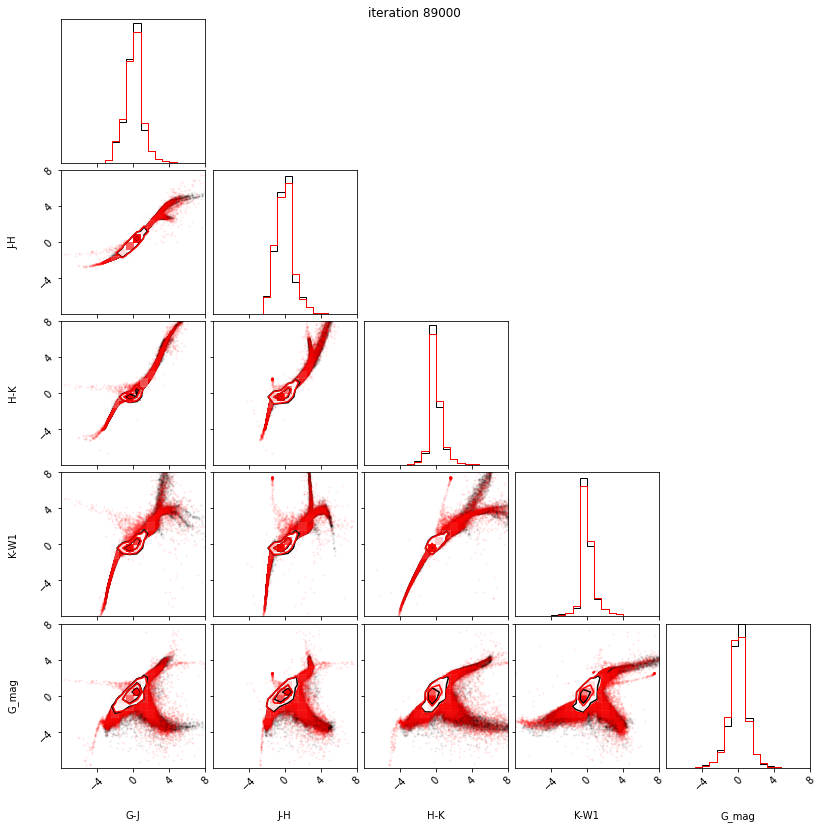

89100 -6.017569541931152 -6.014550685882568 1.0755891799926758 -inf
89200 -5.935370922088623 -6.018936634063721 1.0965285301208496 -inf
89300 -5.82900857925415 -5.858903884887695 0.9434027671813965 -inf
89400 -6.030843257904053 -6.015933513641357 1.1371374130249023 -inf
89500 -5.853331089019775 -5.957737445831299 1.1670541763305664 -inf
89600 -5.286530494689941 -4.633523941040039 1.16998291015625 -inf
89700 -6.022230625152588 -6.0211262702941895 1.094139575958252 -inf
89800 -5.673098087310791 -5.888313293457031 1.0866613388061523 -inf
89900 -5.955239772796631 -6.001735210418701 1.097719669342041 -inf
90000 -4.792943000793457 -5.001389980316162 0.9316625595092773 -inf
0.9316625595092773 -inf


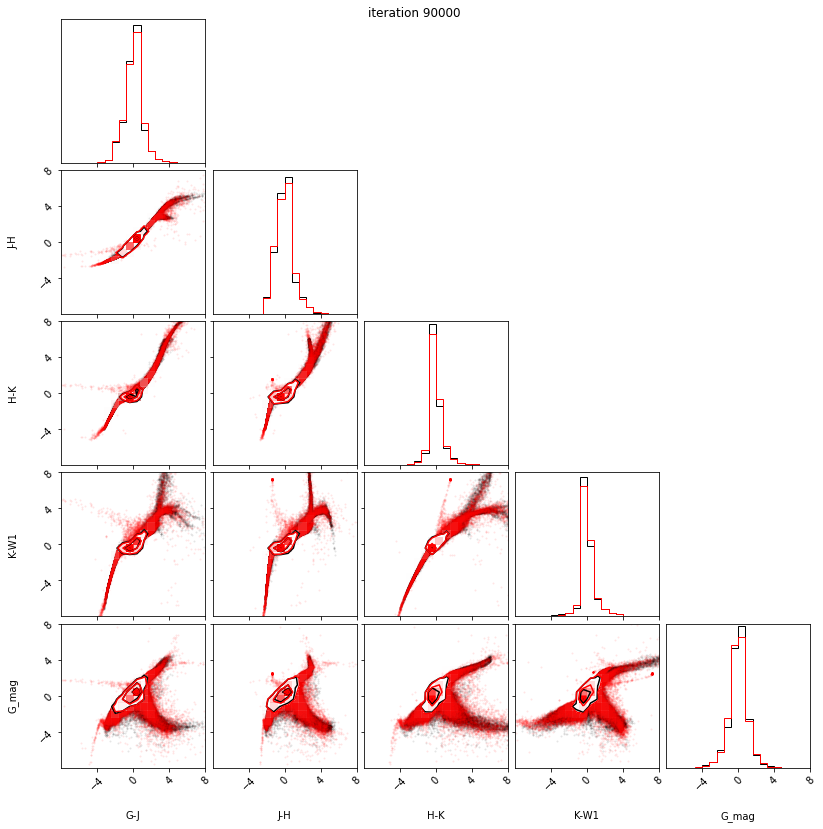

90100 -5.9641337394714355 -5.940069198608398 1.2186808586120605 -inf
90200 -6.011528968811035 -6.0146589279174805 1.1110739707946777 -inf
90300 -6.031083583831787 -6.034866809844971 1.133631706237793 -inf
90400 -6.0318427085876465 -6.018519401550293 1.170119285583496 -inf
90500 -6.035479545593262 -6.033673286437988 1.1495304107666016 -inf
90600 -5.848563194274902 -5.996262550354004 1.1264872550964355 -inf
90700 -5.997973918914795 -5.970889091491699 1.1598858833312988 -inf
90800 -5.698008060455322 -5.779606819152832 0.9803881645202637 -inf
90900 -5.80863618850708 -5.666184425354004 1.136303424835205 -inf
91000 -5.933453559875488 -6.002060413360596 1.0214018821716309 -inf
1.0214018821716309 -inf


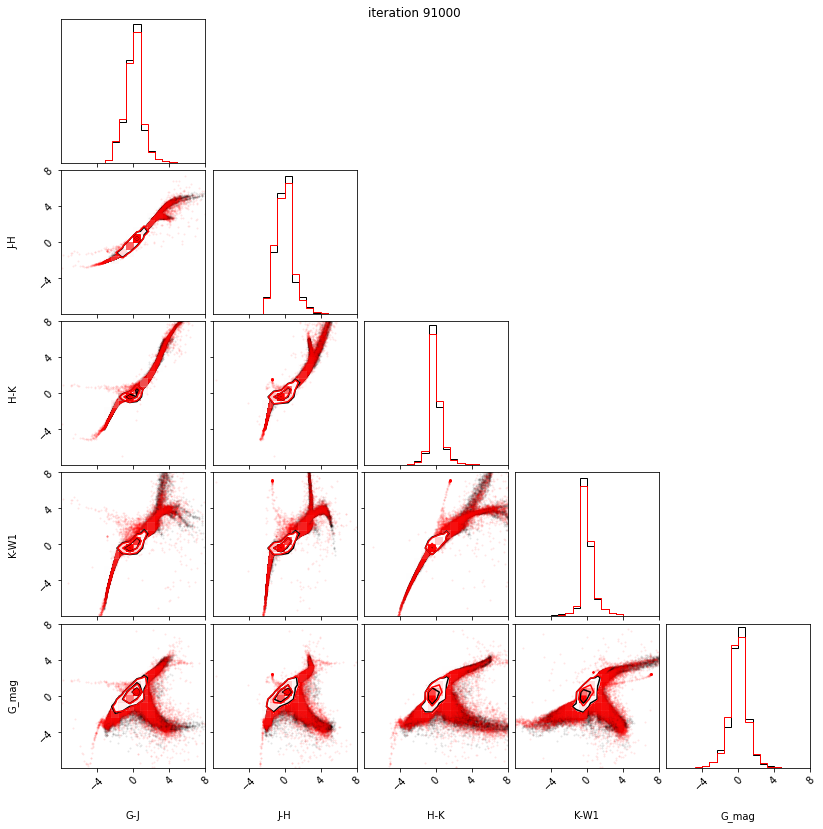

91100 -5.9790520668029785 -5.890964508056641 1.2351722717285156 -inf
91200 -5.63266134262085 -5.018002033233643 1.315009593963623 -inf
91300 -6.0327372550964355 -6.052830219268799 1.2172303199768066 -inf
91400 -5.909937381744385 -5.896842956542969 1.138031005859375 -inf
91500 -5.73783016204834 -5.686275959014893 1.2371606826782227 -inf
91600 -4.752059459686279 -5.836330890655518 1.05828857421875 -inf
91700 -6.04311466217041 -6.0430378913879395 1.2069988250732422 -inf
91800 -6.040380477905273 -6.054975509643555 1.094834327697754 -inf
91900 -6.056808948516846 -6.065126419067383 1.0870566368103027 -inf
92000 -5.366154670715332 -5.3394575119018555 1.031224250793457 -inf
1.031224250793457 -inf


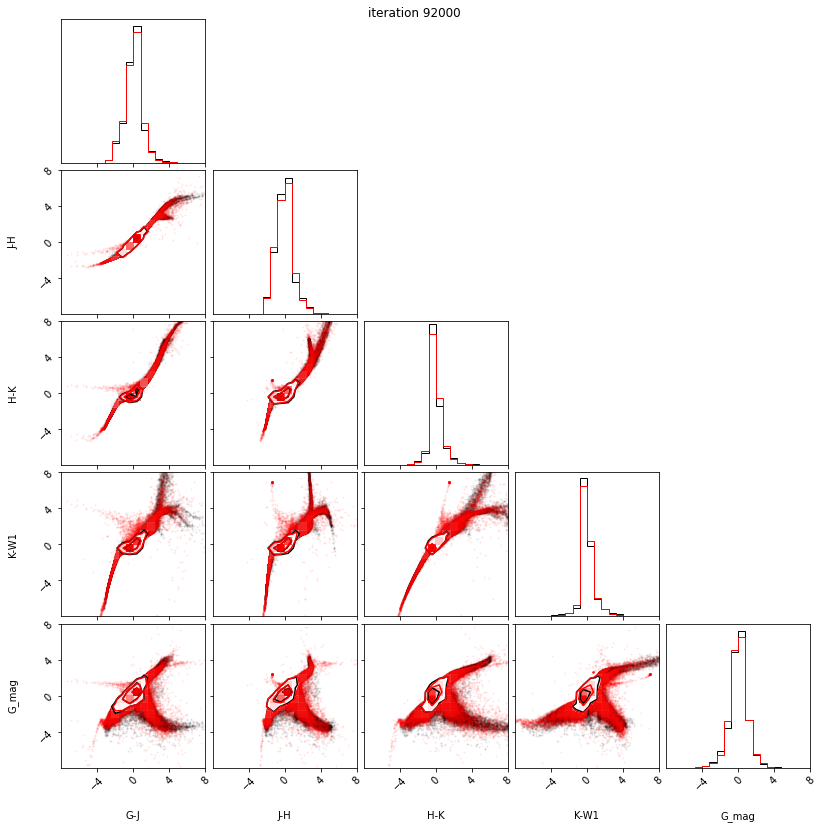

92100 -5.14334774017334 -5.510173320770264 0.7173590660095215 -inf
92200 -5.321473121643066 -5.120213985443115 1.142829418182373 -inf
92300 -5.704686641693115 -5.714439868927002 0.9479303359985352 -inf
92400 -5.919448375701904 -5.816434383392334 1.0810127258300781 -inf
92500 -5.986691474914551 -6.072389125823975 1.0883736610412598 -inf
92600 -5.905396461486816 -5.92424201965332 0.9917654991149902 -inf
92700 -4.967634677886963 -4.864651203155518 1.2011280059814453 -inf
92800 -5.064308166503906 -4.963934421539307 1.101386547088623 -inf
92900 -6.066720008850098 -6.070255756378174 1.1602249145507812 -inf
93000 -5.942379951477051 -5.962018966674805 1.1843223571777344 -inf
1.1843223571777344 -inf


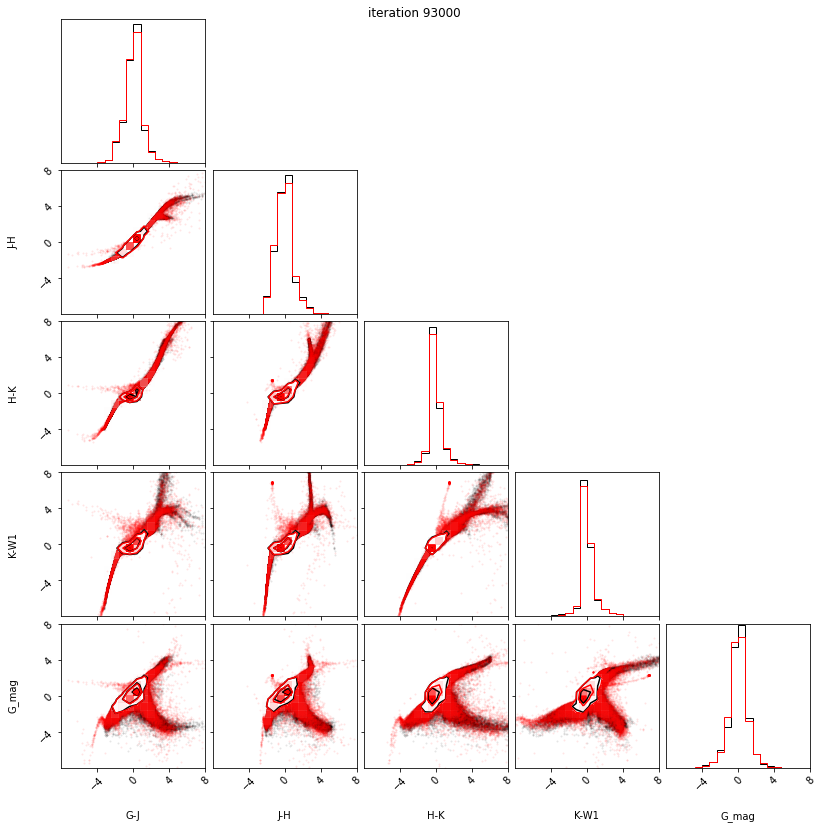

93100 -5.873137950897217 -5.427576065063477 1.129539966583252 -inf
93200 -6.071201801300049 -6.07075309753418 1.0453143119812012 -inf
93300 -6.065126419067383 -6.024510860443115 1.1531424522399902 -inf
93400 -6.018218040466309 -6.013031959533691 1.1246519088745117 -inf
93500 -5.99452018737793 -5.901638031005859 1.0747652053833008 -inf
93600 -5.93446683883667 -6.026299953460693 1.0187263488769531 -inf
93700 -5.865145206451416 -5.927837371826172 1.2110042572021484 -inf
93800 -5.60999059677124 -4.575597763061523 0.6166377067565918 -inf
93900 -6.070221900939941 -6.074143409729004 1.170304298400879 -inf
94000 -6.023358345031738 -6.049908638000488 1.1358246803283691 -inf
1.1358246803283691 -inf


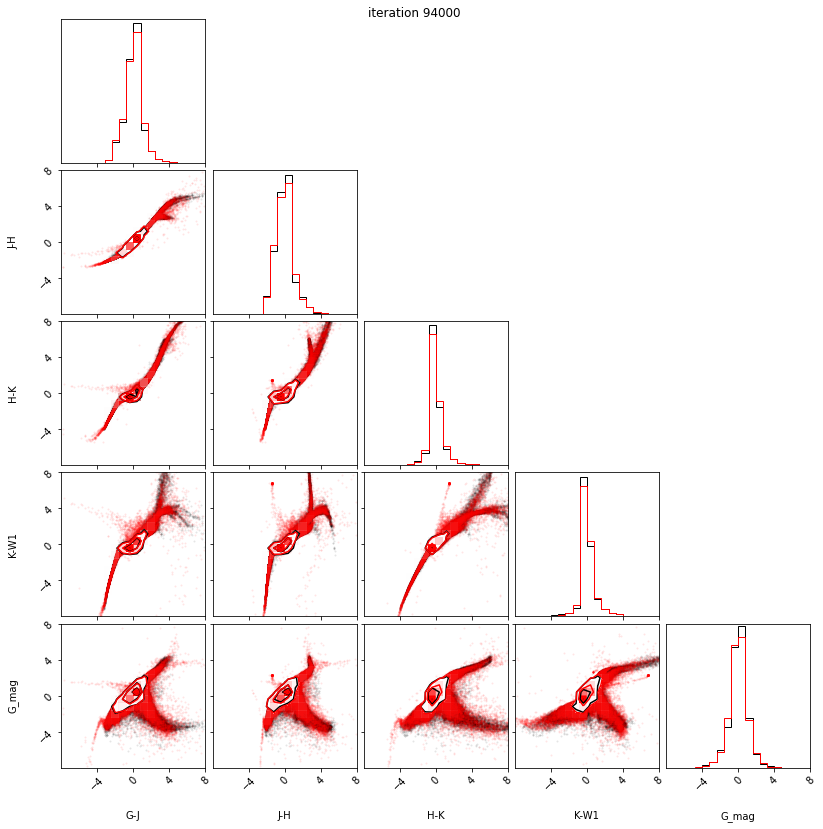

94100 -5.759304046630859 -5.860098838806152 0.9952754974365234 -inf
94200 -5.594161033630371 -5.791744709014893 1.1242914199829102 -inf
94300 -5.761754035949707 -5.6382155418396 1.0615205764770508 -inf
94400 -5.636668682098389 -5.9362568855285645 0.9826321601867676 -inf
94500 -5.444822788238525 -5.829990863800049 1.0277538299560547 -inf
94600 -5.866804599761963 -5.791008472442627 0.9870882034301758 -inf
94700 -5.932695388793945 -5.268470287322998 1.1346397399902344 -inf
94800 -6.026367664337158 -6.029136657714844 1.1685876846313477 -inf
94900 -5.75404691696167 -5.8671650886535645 0.9615883827209473 -inf
95000 -5.293886661529541 -5.594602108001709 1.2672343254089355 -inf
1.2672343254089355 -inf


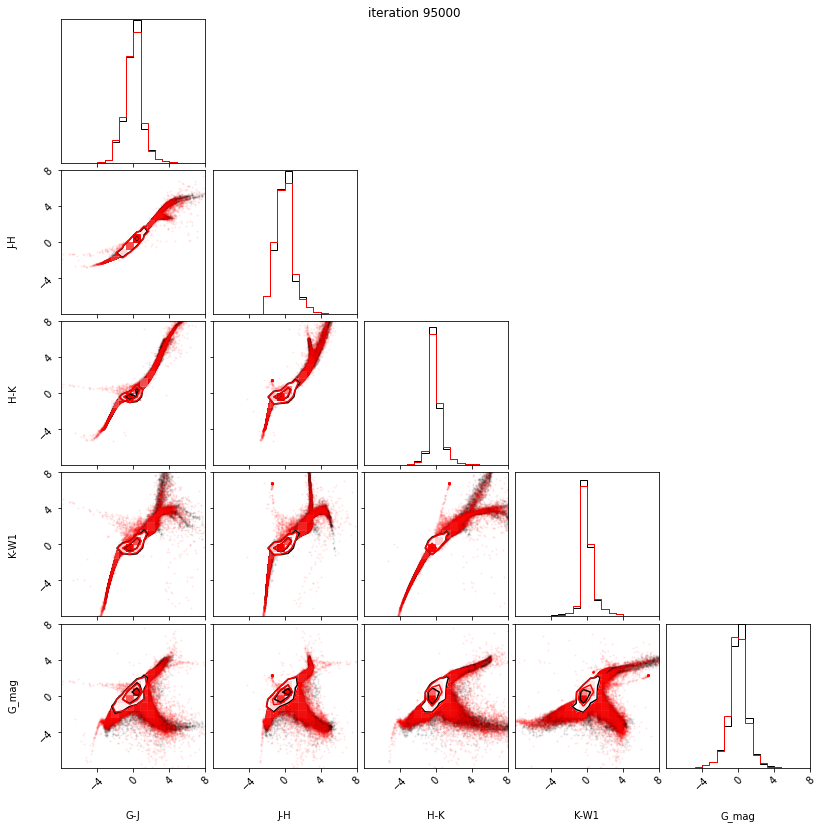

95100 -6.079821586608887 -6.086722373962402 1.1204771995544434 -inf
95200 -6.077670097351074 -6.079278945922852 1.1108875274658203 -inf
95300 -6.014176368713379 -6.025491237640381 1.1709485054016113 -inf
95400 -5.399446964263916 -5.578747749328613 1.1100192070007324 -inf
95500 -5.617849826812744 -5.9301981925964355 1.0743131637573242 -inf
95600 -5.44482421875 -5.8852362632751465 0.943397045135498 -inf
95700 -6.033219337463379 -6.056299686431885 1.14766263961792 -inf
95800 -6.0055317878723145 -6.047333240509033 1.0546140670776367 -inf
95900 -6.075921535491943 -6.014932632446289 1.1175246238708496 -inf
96000 -6.074856281280518 -6.050563812255859 1.1478228569030762 -inf
1.1478228569030762 -inf


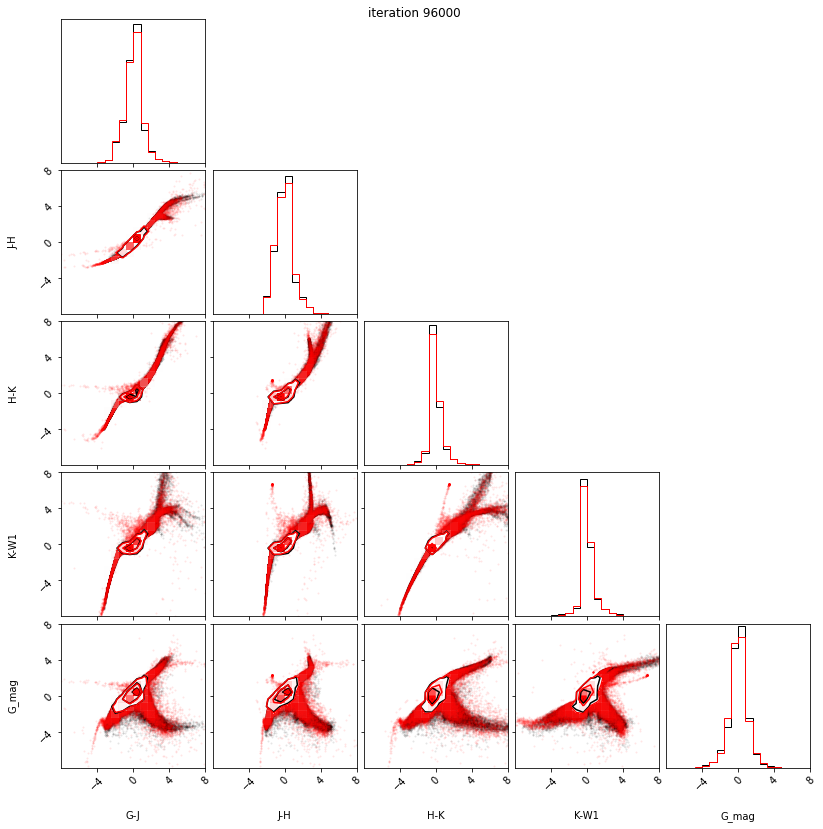

96100 -5.889166355133057 -5.66825008392334 1.1928834915161133 -inf
96200 -5.621749401092529 -5.6650590896606445 1.0618658065795898 -inf
96300 -5.944135665893555 -5.936145305633545 1.0795764923095703 -inf
96400 -6.095102787017822 -6.101866245269775 1.0994925498962402 -inf
96500 -6.065331935882568 -6.0367841720581055 1.0353550910949707 -inf
96600 -5.6885881423950195 -5.780568599700928 1.124800682067871 -inf
96700 -5.874228000640869 -5.789385795593262 1.2268543243408203 -inf
96800 -6.103384971618652 -6.109033584594727 1.1369962692260742 -inf
96900 -5.978006362915039 -5.756670951843262 1.0607037544250488 -inf
97000 -5.660267353057861 -5.304681777954102 1.2209696769714355 -inf
1.2209696769714355 -inf


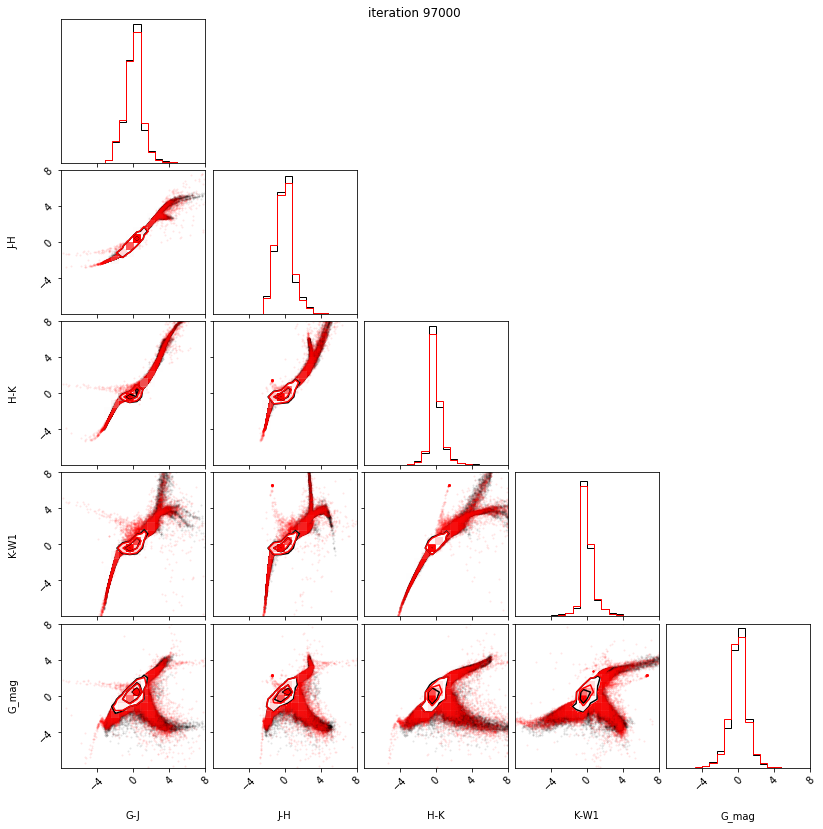

97100 -6.024982452392578 -6.015396595001221 1.1751422882080078 -inf
97200 -5.982484817504883 -5.861034393310547 1.1594610214233398 -inf
97300 -5.712760925292969 -4.910654067993164 0.9375729560852051 -inf
97400 -6.0863871574401855 -6.1003570556640625 1.1377429962158203 -inf
97500 -6.0688982009887695 -6.0393524169921875 1.1462383270263672 -inf
97600 -6.018881320953369 -5.976938724517822 1.2218527793884277 -inf
97700 -5.960978031158447 -5.95556640625 1.1501717567443848 -inf
97800 -5.619333267211914 -5.5774827003479 1.036792278289795 -inf
97900 -6.0615105628967285 -6.055702209472656 1.1628913879394531 -inf
98000 -6.08641242980957 -6.083034038543701 1.131101131439209 -inf
1.131101131439209 -inf


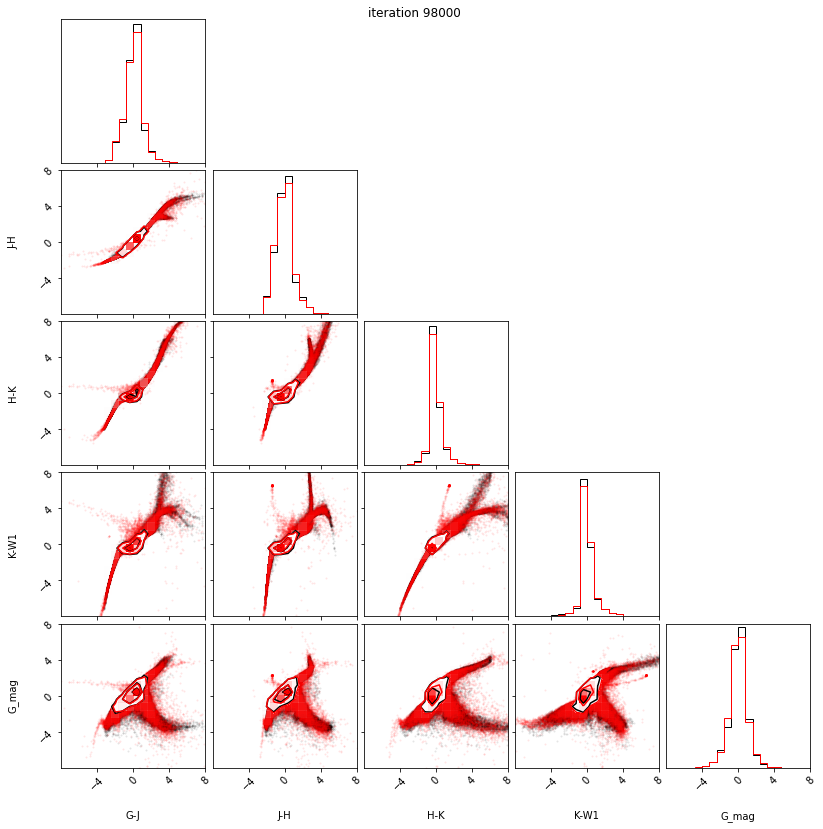

98100 -4.748196601867676 -5.855467796325684 0.8854446411132812 -inf
98200 -4.151315212249756 -3.347013235092163 1.1469569206237793 -inf
98300 -6.112208366394043 -6.1155829429626465 1.1316189765930176 -inf
98400 -6.029979705810547 -5.999423503875732 1.1640949249267578 -inf
98500 -5.234116077423096 -5.834142208099365 1.0497512817382812 -inf
98600 -6.067789554595947 -6.085488319396973 1.1745624542236328 -inf
98700 -6.089541912078857 -6.089547634124756 1.1025018692016602 -inf
98800 -5.9155192375183105 -5.976221561431885 1.0860910415649414 -inf
98900 -5.84990930557251 -5.894774913787842 0.9726223945617676 -inf
99000 -5.774439811706543 -5.942290306091309 1.2454771995544434 -inf
1.2454771995544434 -inf


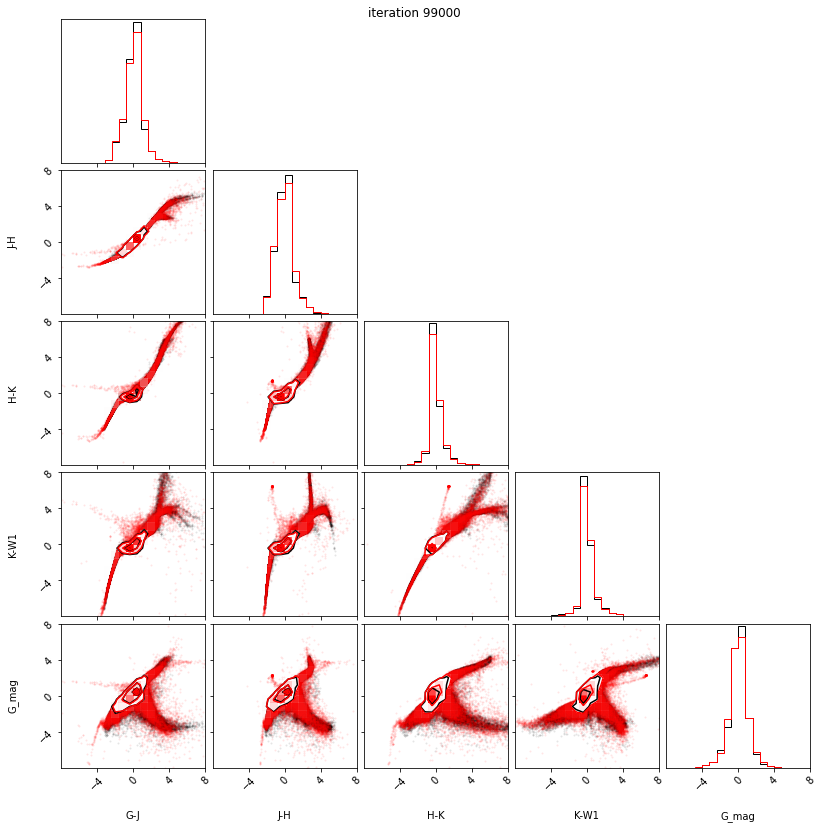

99100 -6.098509311676025 -6.02274227142334 1.125363826751709 -inf
99200 -5.451671123504639 -5.6331281661987305 1.091273307800293 -inf
99300 -5.6611647605896 -5.840316295623779 1.0921921730041504 -inf
99400 -5.716437816619873 -5.8045973777771 0.9779019355773926 -inf
99500 -5.741629600524902 -5.997467041015625 1.0689220428466797 -inf
99600 -5.8247785568237305 -5.646711349487305 1.128861427307129 -inf
99700 -6.078280448913574 -6.028622627258301 1.1287860870361328 -inf
99800 -6.018842697143555 -5.708507537841797 1.186966896057129 -inf
99900 -5.784707069396973 -5.932769298553467 1.0939021110534668 -inf
100000 -5.143534183502197 -5.991726398468018 1.0202393531799316 -inf
1.0202393531799316 -inf


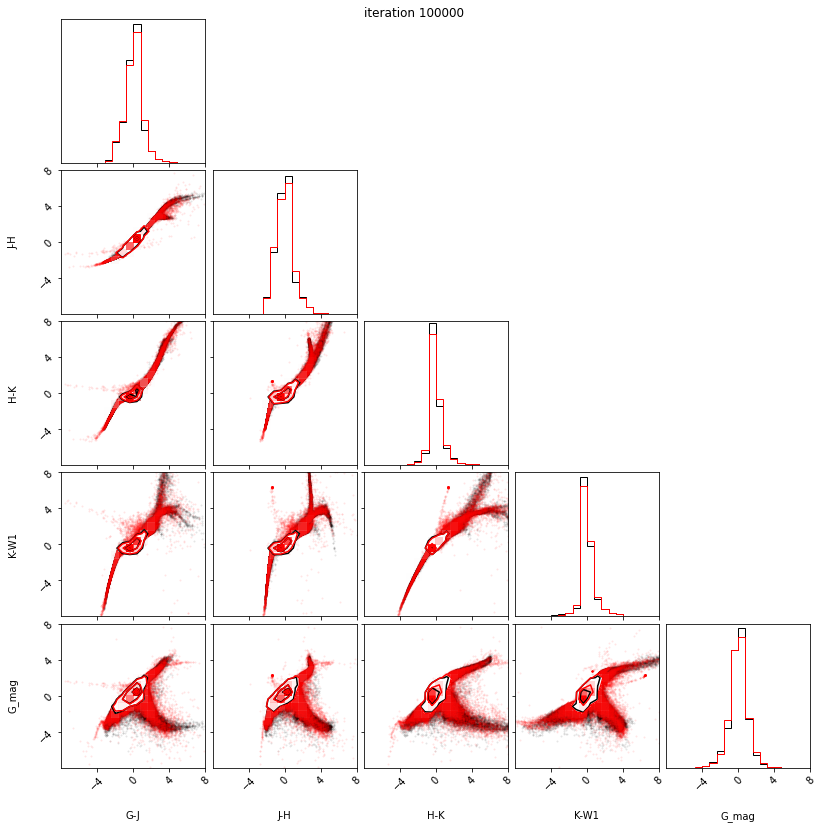

100100 -4.478787422180176 -5.89866828918457 1.2459750175476074 -inf
100200 -6.08859395980835 -6.096738338470459 1.1543359756469727 -inf
100300 -5.46060848236084 -5.709611892700195 0.9599452018737793 -inf
100400 -4.650813102722168 -3.9740748405456543 1.1090965270996094 -inf
100500 -6.124197483062744 -6.126066207885742 1.1056480407714844 -inf
100600 -5.246067523956299 -5.873517990112305 0.9132781028747559 -inf
100700 -6.114470958709717 -6.069765567779541 1.1411027908325195 -inf
100800 -5.997509002685547 -5.843506813049316 1.1245551109313965 -inf
100900 -5.481881618499756 -5.520747184753418 0.9674415588378906 -inf
101000 -6.1273980140686035 -6.1334381103515625 1.1297059059143066 -inf
1.1297059059143066 -inf


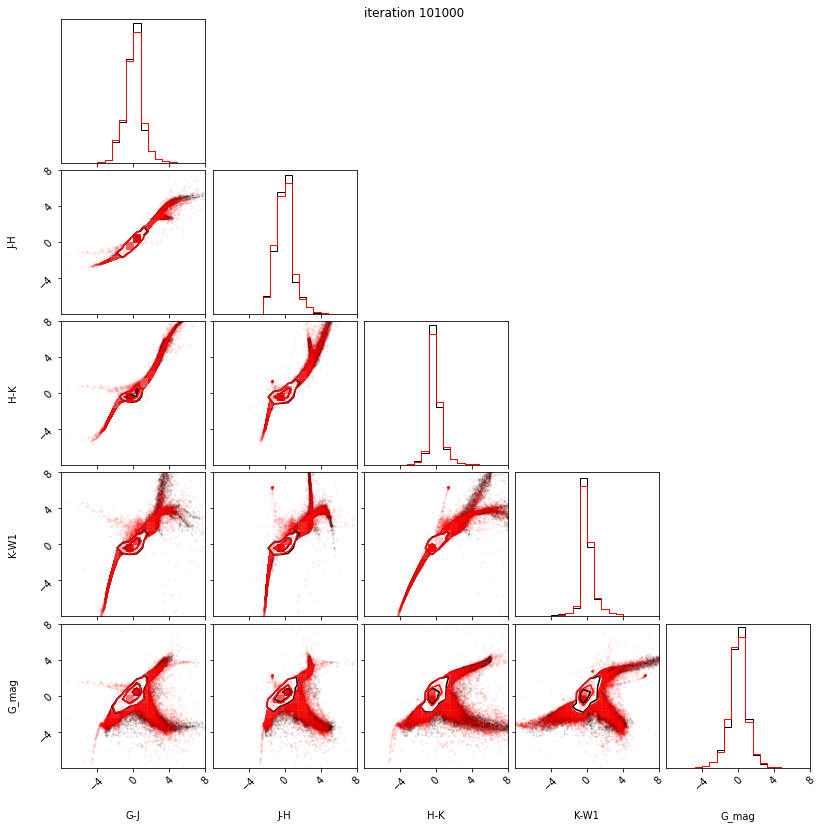

101100 -6.088999271392822 -6.095001220703125 1.08543062210083 -inf
101200 -5.7086968421936035 -5.742961406707764 1.1519432067871094 -inf
101300 -5.9582061767578125 -5.857166290283203 1.1054277420043945 -inf
101400 -6.144308090209961 -6.123775005340576 1.1425237655639648 -inf
101500 -6.045039176940918 -6.030661582946777 1.1284046173095703 -inf
101600 -6.066746711730957 -6.070713996887207 1.098264217376709 -inf
101700 -6.083525657653809 -6.146917343139648 1.0731306076049805 -inf
101800 -6.030378818511963 -6.032370090484619 1.13446044921875 -inf
101900 -6.079498291015625 -6.112981796264648 1.1222686767578125 -inf
102000 -6.096722602844238 -6.124749183654785 1.09710693359375 -inf
1.09710693359375 -inf


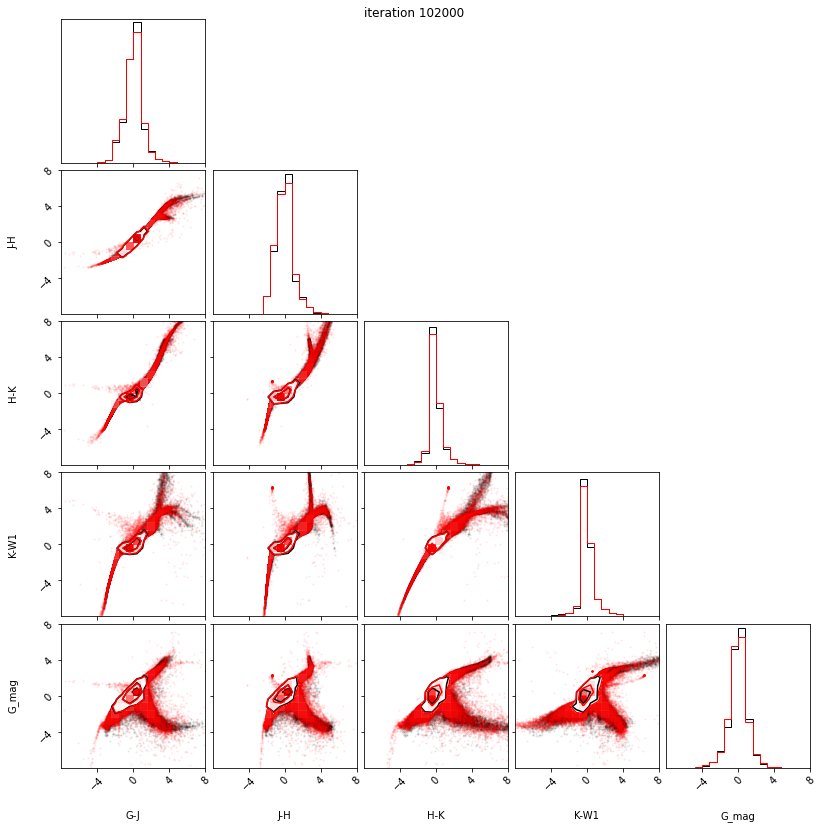

102100 -5.820540428161621 -5.689400672912598 1.2592487335205078 -inf
102200 -6.143824100494385 -6.149040699005127 1.0833864212036133 -inf
102300 -6.145261764526367 -6.147791862487793 1.0587897300720215 -inf
102400 -6.095191955566406 -6.112466812133789 1.0407695770263672 -inf
102500 -5.914283275604248 -6.051582336425781 1.0184812545776367 -inf
102600 -4.500697135925293 -4.67779541015625 0.7824773788452148 -inf
102700 -6.131184101104736 -6.140642166137695 1.109565258026123 -inf
102800 -6.090099334716797 -6.066910266876221 1.0665783882141113 -inf
102900 -5.962698459625244 -6.088849067687988 1.046471118927002 -inf
103000 -5.869389533996582 -5.905787467956543 1.0529813766479492 -inf
1.0529813766479492 -inf


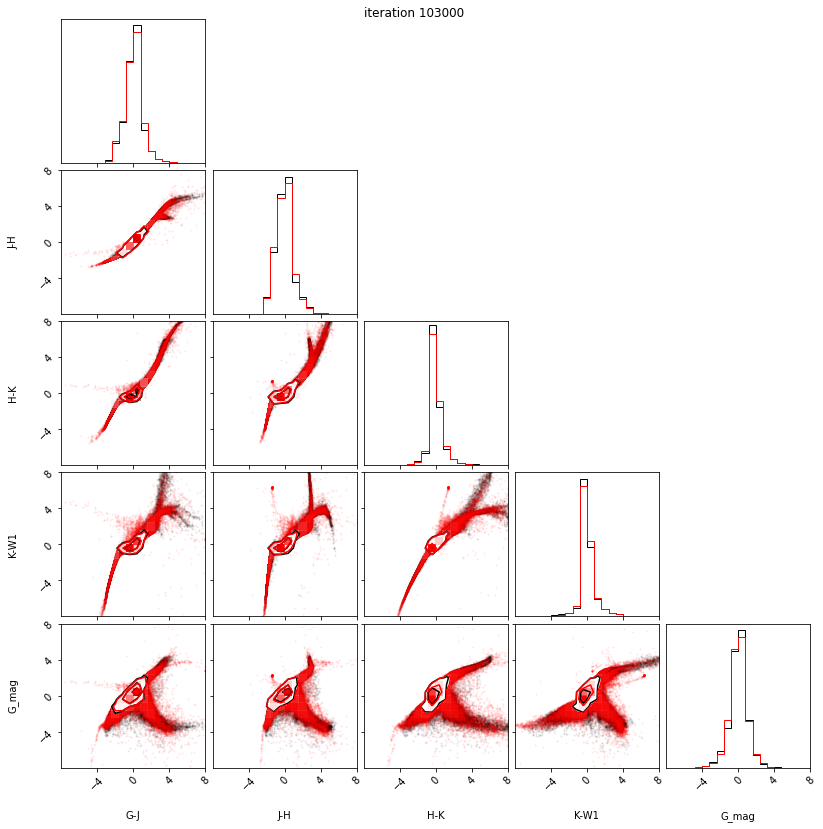

103100 -5.916119575500488 -5.718635082244873 0.9020376205444336 -inf
103200 -5.83554220199585 -6.041762828826904 1.026759147644043 -inf
103300 -5.398466110229492 -5.942831993103027 1.0529098510742188 -inf
103400 -6.109230995178223 -6.117643356323242 1.048100471496582 -inf
103500 -6.018038749694824 -5.993598461151123 0.9913167953491211 -inf
103600 -5.84789514541626 -5.59102725982666 1.0450310707092285 -inf
103700 -5.008066177368164 -5.930878639221191 0.9737262725830078 -inf
103800 -6.148556232452393 -6.1570820808410645 1.0487852096557617 -inf
103900 -6.099665641784668 -6.095422267913818 1.0512299537658691 -inf
104000 -6.000816822052002 -6.032032489776611 1.0665497779846191 -inf
1.0665497779846191 -inf


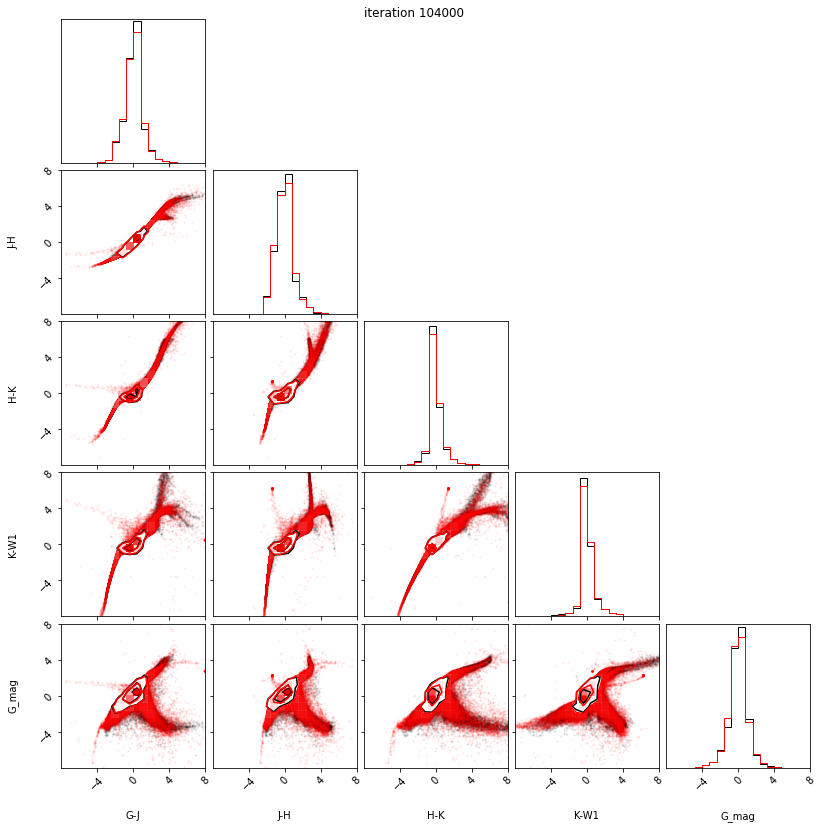

104100 -6.060399055480957 -6.001722812652588 0.9954919815063477 -inf
104200 -5.834035396575928 -6.038999080657959 1.0096511840820312 -inf
104300 -6.034339904785156 -5.983719348907471 1.0713586807250977 -inf
104400 -6.052423477172852 -5.934884071350098 1.006739616394043 -inf
104500 -5.971969127655029 -6.057777404785156 1.0594043731689453 -inf
104600 -5.951501369476318 -6.031835556030273 1.0583915710449219 -inf
104700 -5.783102512359619 -5.978671073913574 1.1147241592407227 -inf
104800 -5.569535255432129 -4.618585586547852 0.4470820426940918 -inf
104900 -6.149627208709717 -6.160754203796387 1.0281414985656738 -inf
105000 -6.127109050750732 -6.155069351196289 0.9847469329833984 -inf
0.9847469329833984 -inf


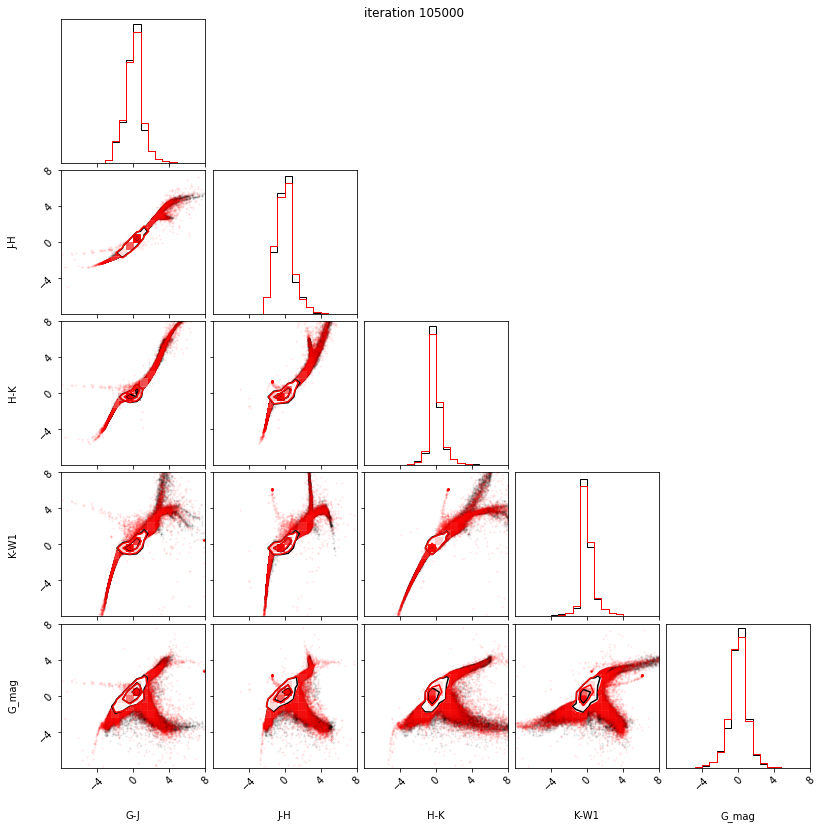

105100 -6.049173831939697 -6.042866230010986 1.0132265090942383 -inf
105200 -6.118753910064697 -6.148324012756348 1.0040392875671387 -inf
105300 -6.137404918670654 -6.150907516479492 0.989079475402832 -inf
105400 -5.63761568069458 -5.890591144561768 0.8281674385070801 -inf
105500 -5.799376010894775 -5.815456867218018 1.0128669738769531 -inf
105600 -5.484449863433838 -5.586806297302246 1.010960578918457 -inf
105700 -6.092324256896973 -5.73976993560791 0.9874467849731445 -inf
105800 -6.094342231750488 -6.114672660827637 1.063669204711914 -inf
105900 -5.867020130157471 -6.064229965209961 1.0514912605285645 -inf
106000 -6.020894527435303 -5.870242118835449 1.074502944946289 -inf
1.074502944946289 -inf


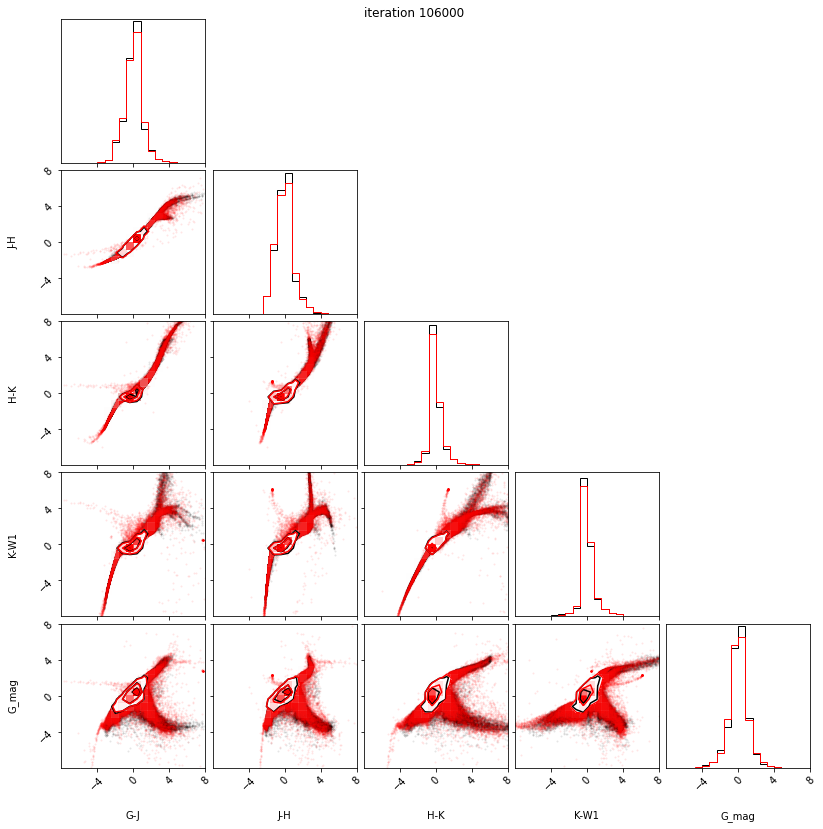

106100 -5.890523910522461 -5.81160831451416 0.9789142608642578 -inf
106200 -5.112131595611572 -5.509550094604492 0.8106303215026855 -inf
106300 -6.156063079833984 -6.160577774047852 1.005317211151123 -inf
106400 -5.9956207275390625 -6.013240814208984 1.0073204040527344 -inf
106500 -5.403069972991943 -4.399282455444336 1.0939865112304688 -inf
106600 -6.165719032287598 -6.1533355712890625 0.9845056533813477 -inf
106700 -6.039468765258789 -5.927793979644775 0.9880485534667969 -inf
106800 -5.032927989959717 -5.054347515106201 0.8166651725769043 -inf
106900 -6.172932147979736 -6.1826324462890625 0.9681887626647949 -inf
107000 -6.121101379394531 -6.167845726013184 0.9713048934936523 -inf
0.9713048934936523 -inf


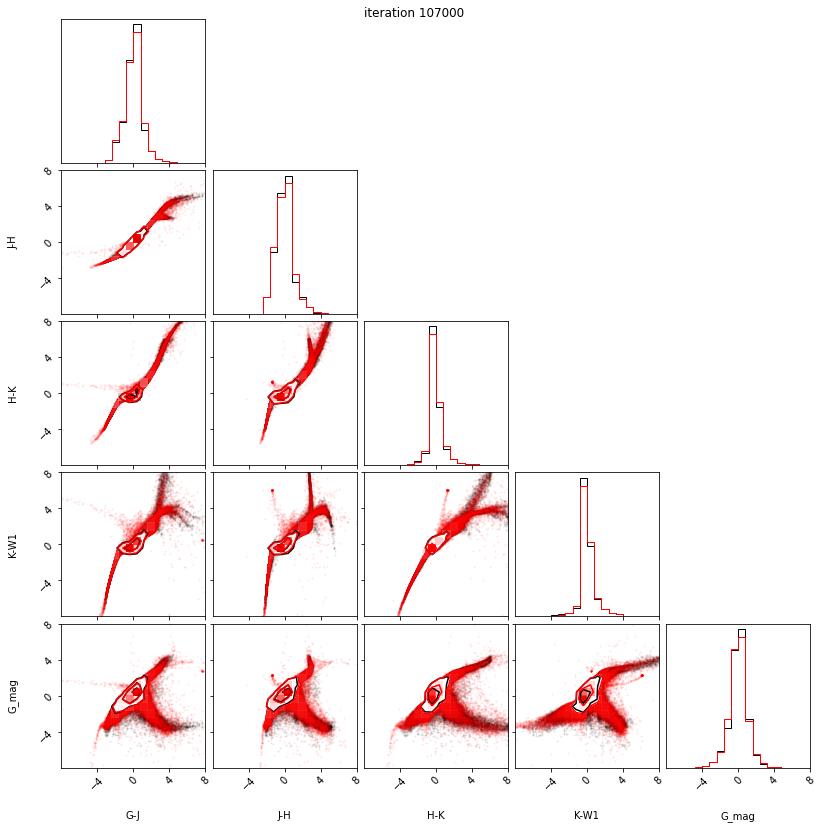

107100 -5.836754322052002 -5.95866060256958 0.9524655342102051 -inf
107200 -6.165964603424072 -6.138811111450195 0.9650387763977051 -inf
107300 -6.113157749176025 -6.059918403625488 0.9466209411621094 -inf
107400 -6.069993495941162 -5.980961799621582 0.9856758117675781 -inf
107500 -5.562107086181641 -5.6061835289001465 0.932441234588623 -inf
107600 -6.098240852355957 -6.03565788269043 0.9815797805786133 -inf
107700 -6.006752014160156 -5.874715328216553 0.9673042297363281 -inf
107800 -5.789490222930908 -5.978124618530273 0.9704680442810059 -inf
107900 -5.9460344314575195 -6.11767053604126 0.9394092559814453 -inf
108000 -5.805293560028076 -5.959245204925537 0.9260311126708984 -inf
0.9260311126708984 -inf


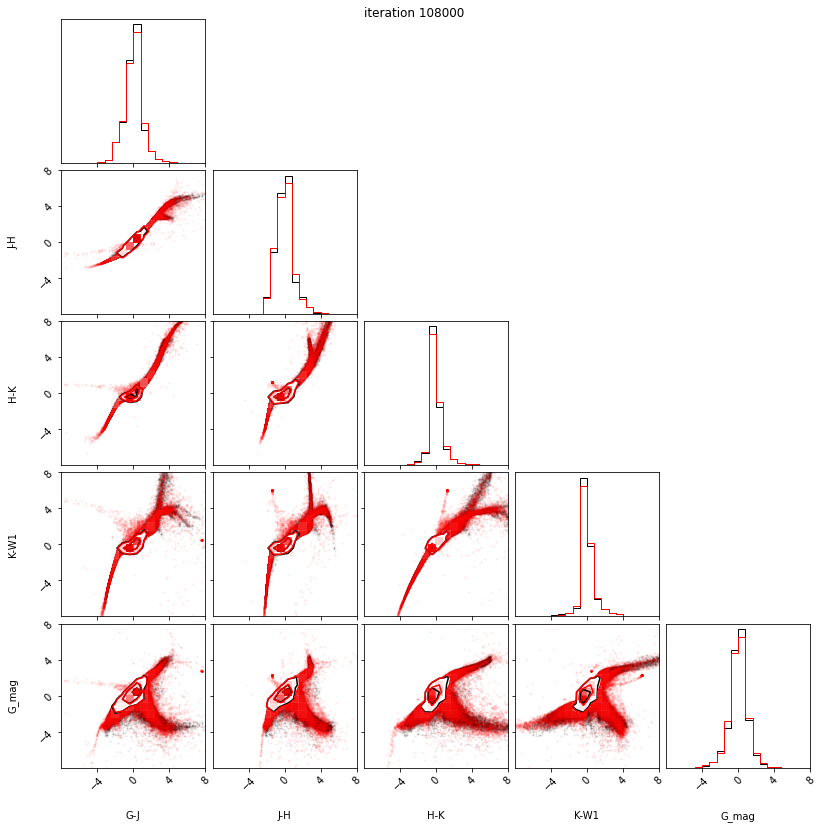

108100 -5.532325744628906 -5.9082255363464355 0.868891716003418 -inf
108200 -5.8029069900512695 -5.863811016082764 0.912287712097168 -inf
108300 -6.049594879150391 -6.026516437530518 0.9220461845397949 -inf
108400 -6.027642250061035 -5.998836994171143 0.947263240814209 -inf
108500 -6.0455098152160645 -6.056790828704834 0.9646968841552734 -inf
108600 -6.087299346923828 -6.153748512268066 0.9266119003295898 -inf
108700 -6.079782009124756 -6.077519416809082 1.0030536651611328 -inf
108800 -5.798749923706055 -6.06058406829834 0.8083500862121582 -inf
108900 -5.86065149307251 -6.005807876586914 0.8767356872558594 -inf
109000 -5.242274284362793 -4.629825115203857 0.9224891662597656 -inf
0.9224891662597656 -inf


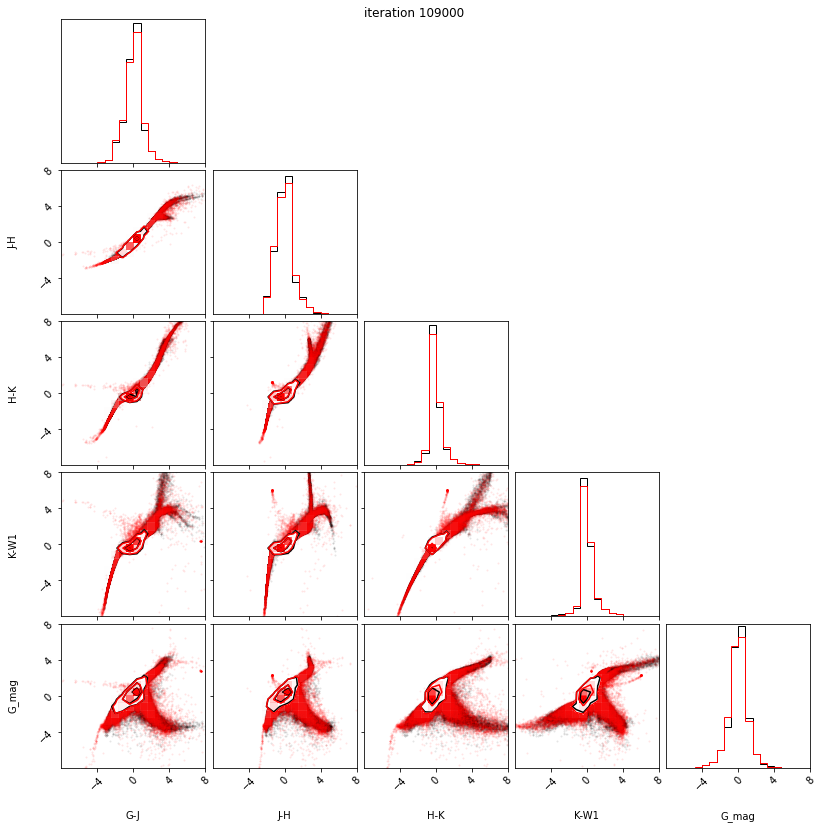

109100 -6.100977897644043 -6.126743793487549 0.9811086654663086 -inf
109200 -5.79984188079834 -5.847868919372559 0.9884281158447266 -inf
109300 -5.425851345062256 -5.315927982330322 0.7537531852722168 -inf
109400 -6.180703639984131 -6.188765048980713 0.8879961967468262 -inf
109500 -6.038550853729248 -6.100614070892334 0.899869441986084 -inf
109600 -6.092166423797607 -6.091628551483154 0.9880661964416504 -inf
109700 -6.034560680389404 -6.1113457679748535 0.914100170135498 -inf
109800 -5.900350570678711 -4.863837718963623 0.791050910949707 -inf
109900 -6.160213947296143 -6.158486843109131 0.8763532638549805 -inf
110000 -5.937532901763916 -5.965836524963379 0.8902454376220703 -inf
0.8902454376220703 -inf


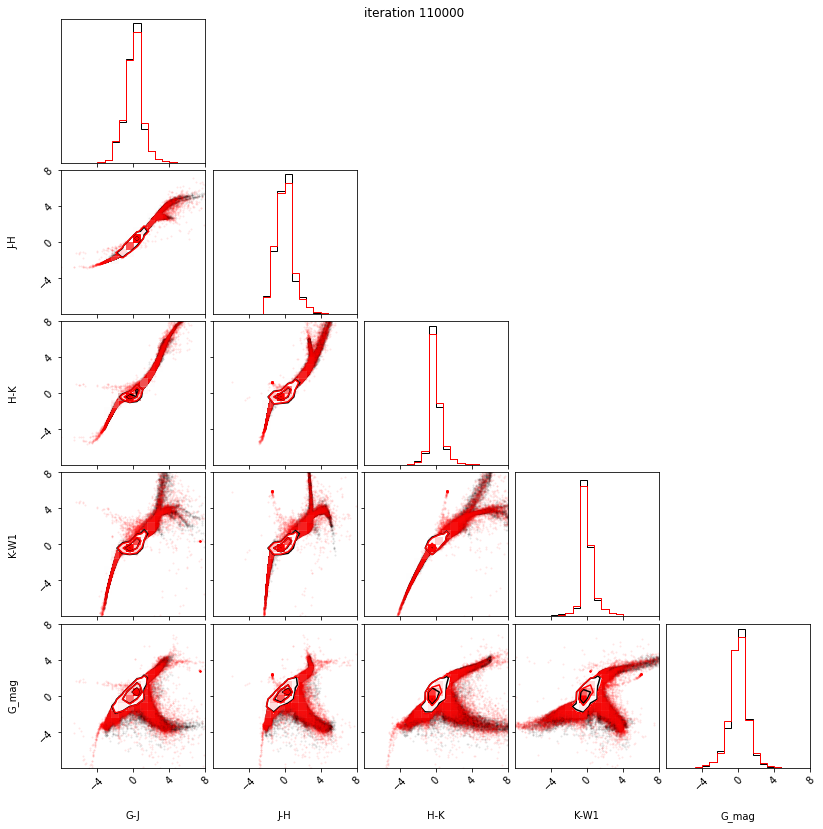

110100 -4.927713871002197 -5.796894550323486 0.8838801383972168 -inf
110200 -6.021346092224121 -5.769365310668945 0.9078636169433594 -inf
110300 -6.20222282409668 -6.21000862121582 0.8607296943664551 -inf
110400 -5.931601524353027 -5.97837495803833 0.9161720275878906 -inf
110500 -4.17532205581665 -5.178786754608154 0.7480969429016113 -inf
110600 -5.896205902099609 -6.021819114685059 0.892122745513916 -inf
110700 -5.744980335235596 -6.080609321594238 0.8456220626831055 -inf
110800 -6.117486476898193 -5.793501377105713 0.8968348503112793 -inf
110900 -6.1896138191223145 -6.2073750495910645 0.8731117248535156 -inf
111000 -5.787126541137695 -6.068607807159424 0.8276205062866211 -inf
0.8276205062866211 -inf


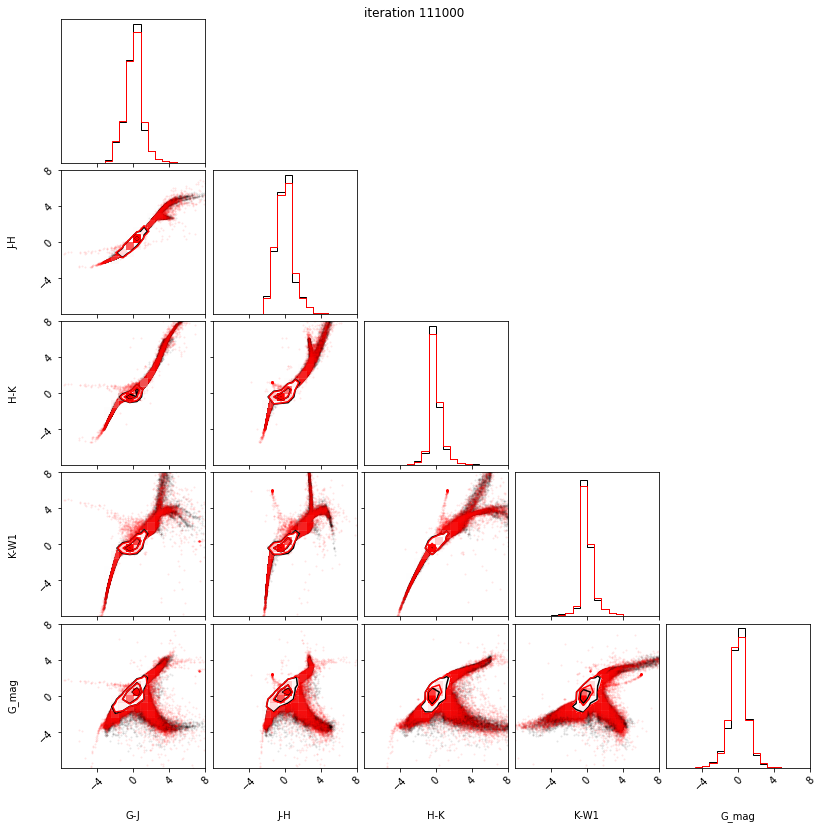

111100 -4.160035133361816 -4.405965328216553 0.7639493942260742 -inf
111200 -6.195731163024902 -6.19983434677124 0.8824315071105957 -inf
111300 -6.179849624633789 -6.189382076263428 0.8764586448669434 -inf
111400 -5.7855730056762695 -5.775283336639404 0.6755380630493164 -inf
111500 -5.898248672485352 -6.07462739944458 0.8464822769165039 -inf
111600 -5.256503582000732 -5.537586688995361 0.8092679977416992 -inf
111700 -5.099305152893066 -4.99901819229126 0.9422492980957031 -inf
111800 -6.0972208976745605 -6.149500846862793 0.840975284576416 -inf
111900 -6.1115617752075195 -5.9404616355896 0.8895606994628906 -inf
112000 -5.781585216522217 -6.041247844696045 0.8131122589111328 -inf
0.8131122589111328 -inf


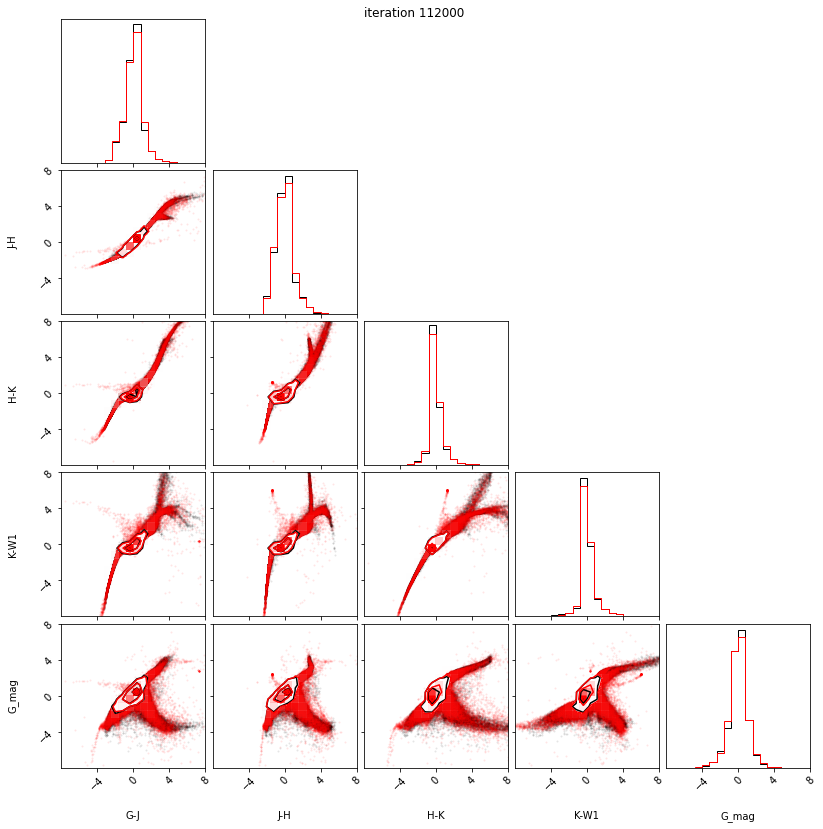

112100 -6.136135578155518 -6.1749114990234375 0.8748703002929688 -inf
112200 -6.076998233795166 -6.041994571685791 0.8394160270690918 -inf
112300 -6.159886360168457 -6.173307418823242 0.9084162712097168 -inf
112400 -5.755711555480957 -5.882317066192627 0.7801499366760254 -inf
112500 -5.4570207595825195 -5.863644599914551 0.7770524024963379 -inf
112600 -5.575774669647217 -5.577757835388184 0.782188892364502 -inf
112700 -6.083396911621094 -6.113495349884033 0.8357200622558594 -inf
112800 -6.146571159362793 -6.14160680770874 0.7573428153991699 -inf
112900 -5.659372329711914 -5.426003456115723 0.8243856430053711 -inf
113000 -5.37062406539917 -5.996706962585449 0.6607465744018555 -inf
0.6607465744018555 -inf


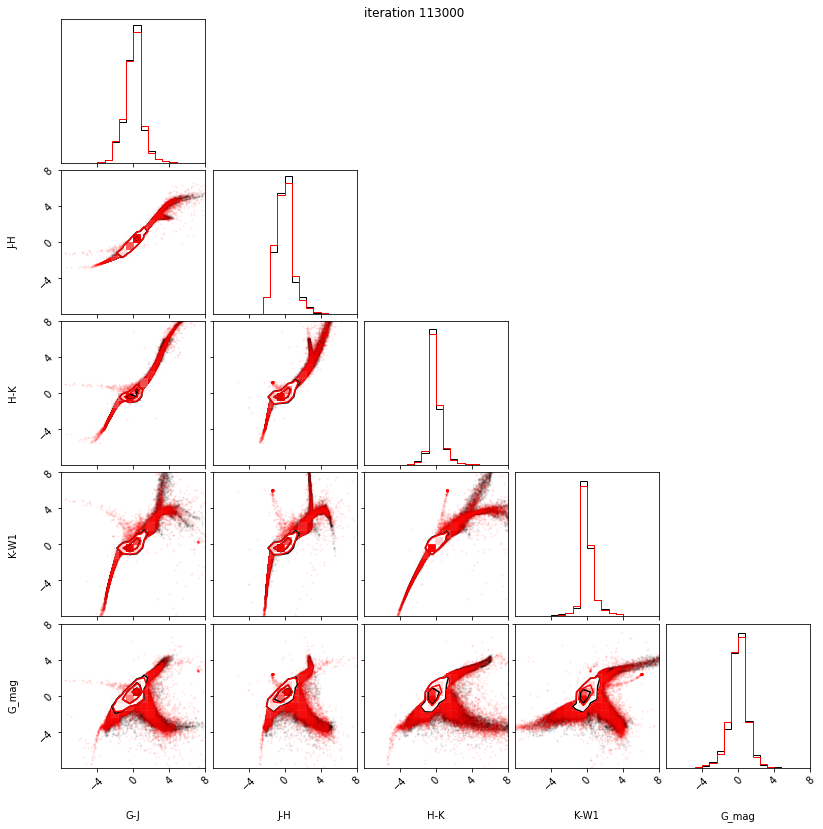

113100 -6.201913356781006 -6.168556213378906 0.861055850982666 -inf
113200 -6.209017753601074 -6.213685512542725 0.8042731285095215 -inf
113300 -6.170623302459717 -6.177238464355469 0.7970829010009766 -inf
113400 -5.909953594207764 -6.075597286224365 0.735285758972168 -inf
113500 -5.8381500244140625 -6.007434368133545 0.8673315048217773 -inf
113600 -6.16213321685791 -6.142879486083984 0.7991313934326172 -inf
113700 -5.497765064239502 -5.992521286010742 0.610938549041748 -inf
113800 -6.0271430015563965 -5.885015487670898 0.7970304489135742 -inf
113900 -6.147246837615967 -6.096909046173096 0.8571138381958008 -inf
114000 -6.176698684692383 -6.199606895446777 0.7420096397399902 -inf
0.7420096397399902 -inf


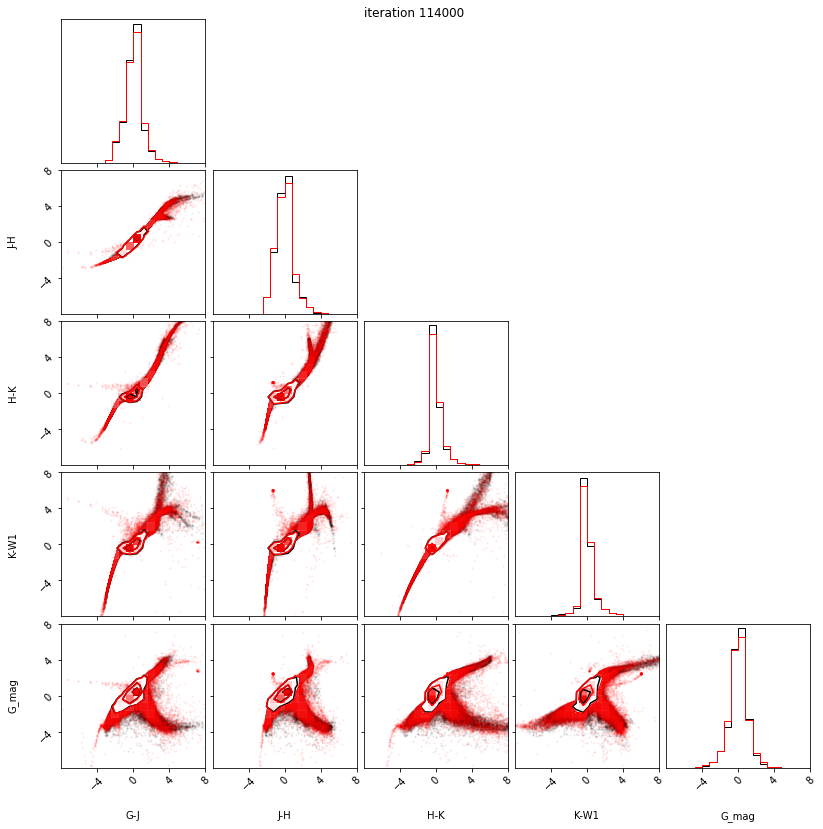

114100 -6.2173075675964355 -6.207123279571533 0.8239984512329102 -inf
114200 -6.0901031494140625 -6.155167102813721 0.7365989685058594 -inf
114300 -5.756527900695801 -5.799520492553711 0.8370928764343262 -inf
114400 -6.083716869354248 -5.570544242858887 0.8236322402954102 -inf
114500 -6.117820739746094 -5.607007026672363 0.9251017570495605 -inf
114600 -6.078132152557373 -5.975661754608154 0.8494119644165039 -inf
114700 -6.078228950500488 -6.1340837478637695 0.7614855766296387 -inf
114800 -6.127577781677246 -6.178402423858643 0.7671413421630859 -inf
114900 -6.116543769836426 -6.11744499206543 0.8760900497436523 -inf
115000 -5.909114837646484 -5.773512363433838 0.7272443771362305 -inf
0.7272443771362305 -inf


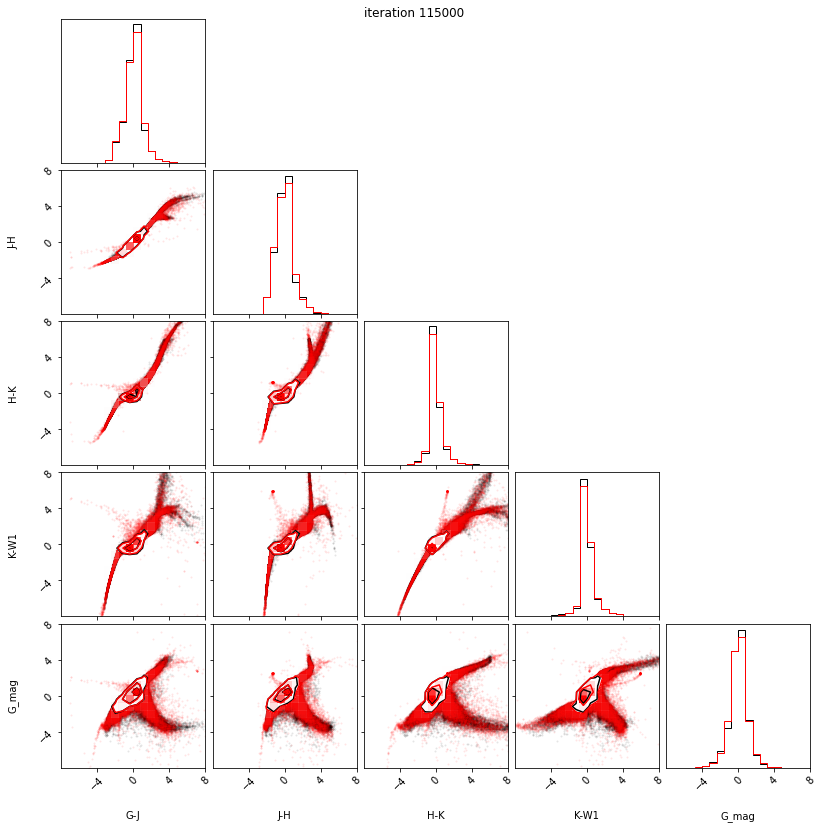

115100 -5.849823951721191 -5.532268524169922 0.7074189186096191 -inf
115200 -5.463186740875244 -5.954592227935791 0.7301874160766602 -inf
115300 -5.811798572540283 -5.63596248626709 0.7702603340148926 -inf
115400 -6.030634880065918 -5.836611747741699 0.8515057563781738 -inf
115500 -4.7955121994018555 -5.8036723136901855 0.5278964042663574 -inf
115600 -5.875717639923096 -5.948793411254883 0.7155842781066895 -inf
115700 -5.663631916046143 -5.334444046020508 0.6372394561767578 -inf
115800 -6.087087631225586 -6.142064094543457 0.8251857757568359 -inf
115900 -5.648761749267578 -5.734731674194336 0.7821245193481445 -inf
116000 -6.180806636810303 -6.214452743530273 0.8402118682861328 -inf
0.8402118682861328 -inf


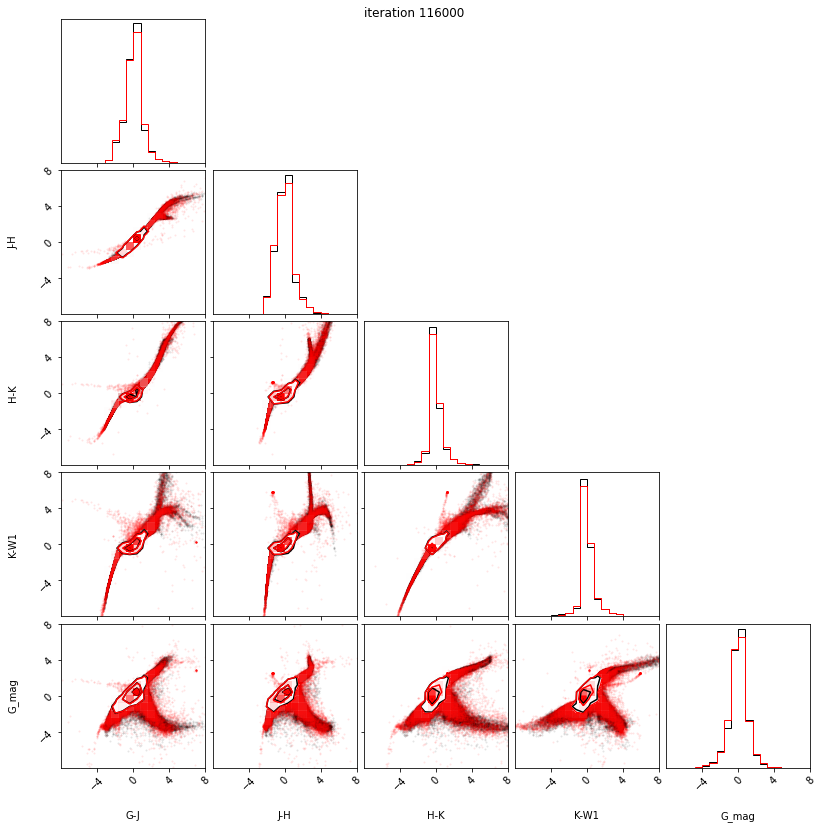

116100 -6.1586480140686035 -6.199590682983398 0.6901955604553223 -inf
116200 -6.001130104064941 -5.772290229797363 0.7464199066162109 -inf
116300 -6.1917643547058105 -6.17549991607666 0.762209415435791 -inf
116400 -4.698146820068359 -5.085674285888672 0.794745922088623 -inf
116500 -6.0241522789001465 -5.802722454071045 0.7657299041748047 -inf
116600 -6.2060017585754395 -6.203181266784668 0.7555627822875977 -inf
116700 -5.998688220977783 -6.010554313659668 0.8071208000183105 -inf
116800 -6.048567771911621 -6.138549327850342 0.7558813095092773 -inf
116900 -5.980358600616455 -5.7569074630737305 0.7760391235351562 -inf
117000 -5.52499532699585 -5.62363338470459 0.6736507415771484 -inf
0.6736507415771484 -inf


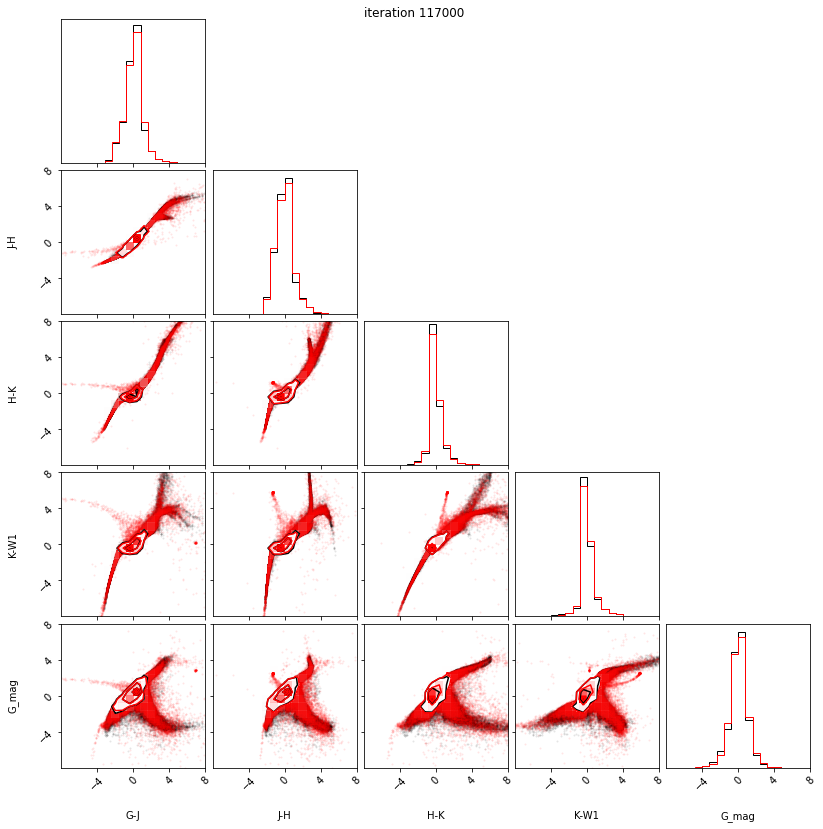

117100 -6.238929271697998 -6.237166881561279 0.716742992401123 -inf
117200 -6.1857991218566895 -6.1614203453063965 0.6458263397216797 -inf
117300 -6.1614789962768555 -6.173169136047363 0.7473769187927246 -inf
117400 -6.003689765930176 -5.990818500518799 0.6199793815612793 -inf
117500 -4.630335807800293 -4.7275004386901855 0.40166234970092773 -inf
117600 -5.894214153289795 -5.768524646759033 0.6058459281921387 -inf
117700 -6.162128925323486 -6.095003128051758 0.6762251853942871 -inf
117800 -6.24672794342041 -6.23776912689209 0.6379637718200684 -inf
117900 -6.242391586303711 -6.247008323669434 0.7032113075256348 -inf
118000 -6.07073974609375 -6.036929130554199 0.6270618438720703 -inf
0.6270618438720703 -inf


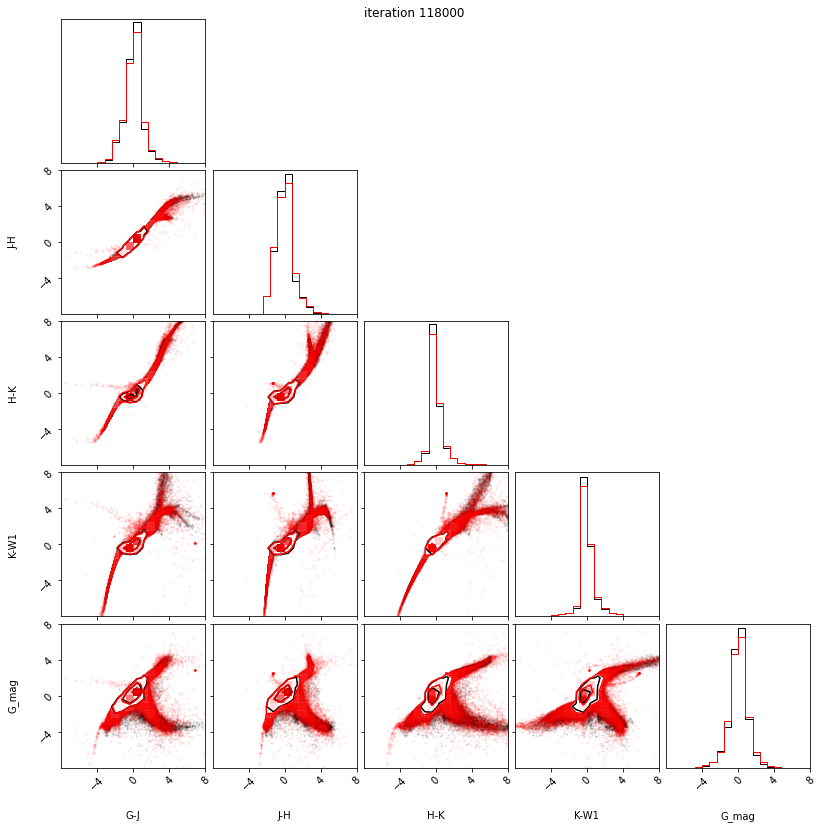

118100 -6.120753288269043 -6.172540664672852 0.7495837211608887 -inf
118200 -5.9773688316345215 -6.136405944824219 0.6817564964294434 -inf
118300 -6.042436122894287 -6.09498405456543 0.7867908477783203 -inf
118400 -6.0630974769592285 -6.098920822143555 0.6261129379272461 -inf
118500 -6.0674567222595215 -6.0997843742370605 0.6443815231323242 -inf
118600 -6.1536149978637695 -6.188555717468262 0.6941723823547363 -inf
118700 -5.722568035125732 -5.675625801086426 0.49820566177368164 -inf
118800 -5.208244323730469 -5.271826267242432 0.674065113067627 -inf
118900 -6.206315040588379 -6.1900224685668945 0.6848220825195312 -inf
119000 -5.4820075035095215 -5.429691314697266 0.7016391754150391 -inf
0.7016391754150391 -inf


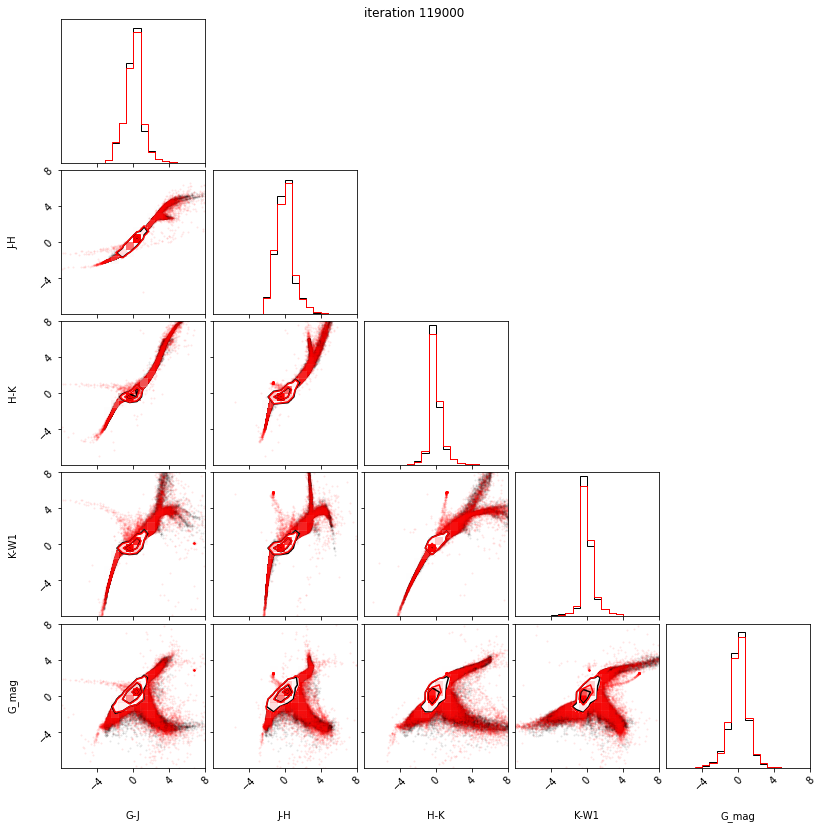

119100 -5.134368419647217 -5.380594253540039 0.7058196067810059 -inf
119200 -6.142362117767334 -5.7389326095581055 0.803718090057373 -inf
119300 -5.360349655151367 -4.25385046005249 0.5525407791137695 -inf
119400 -6.156773090362549 -6.228496074676514 0.7144598960876465 -inf
119500 -6.159696102142334 -6.160179615020752 0.6488785743713379 -inf
119600 -6.154786586761475 -6.018986701965332 0.684417724609375 -inf
119700 -5.476105213165283 -5.684843063354492 0.6146860122680664 -inf
119800 -6.2597527503967285 -6.269228935241699 0.6593923568725586 -inf
119900 -6.103521823883057 -5.929836750030518 0.5850415229797363 -inf
120000 -6.226727485656738 -6.24447774887085 0.7050089836120605 -inf
0.7050089836120605 -inf


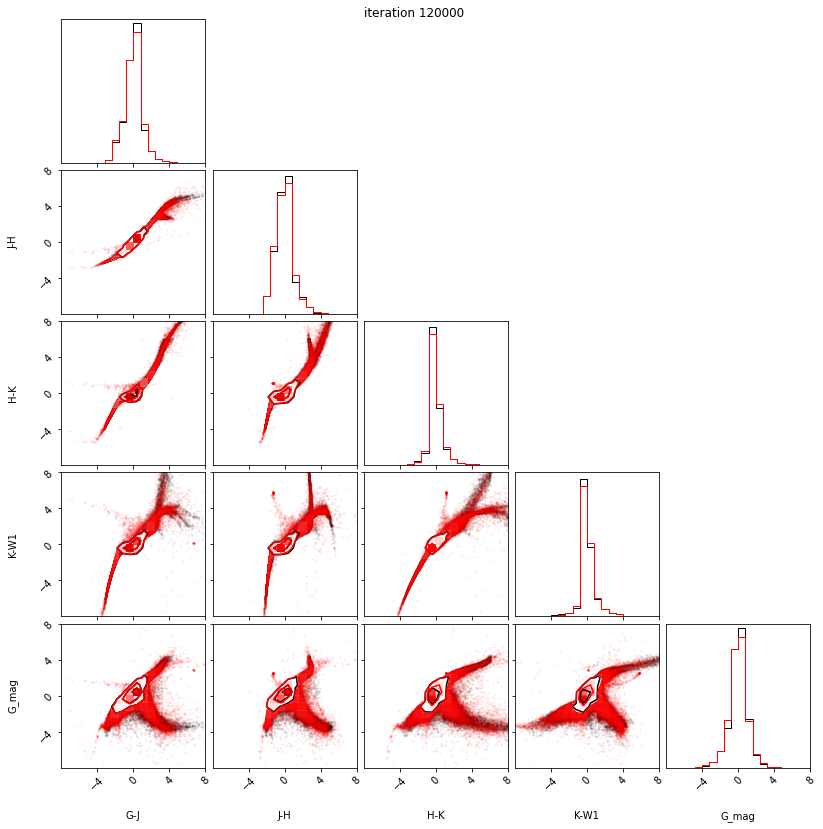

120100 -6.192115306854248 -6.195464611053467 0.5709829330444336 -inf
120200 -6.116198539733887 -6.131038188934326 0.6035656929016113 -inf
120300 -5.731141090393066 -5.631771564483643 0.5902009010314941 -inf
120400 -5.342883110046387 -5.099069595336914 0.7279877662658691 -inf
120500 -6.12903356552124 -6.22398567199707 0.7997341156005859 -inf
120600 -5.603108882904053 -5.820056438446045 0.5699710845947266 -inf
120700 -5.971491813659668 -5.8578104972839355 0.567779541015625 -inf
120800 -5.843932628631592 -6.040991306304932 0.5682373046875 -inf
120900 -6.0754499435424805 -6.104432106018066 0.6936511993408203 -inf
121000 -6.1370625495910645 -5.869009017944336 0.6306576728820801 -inf
0.6306576728820801 -inf


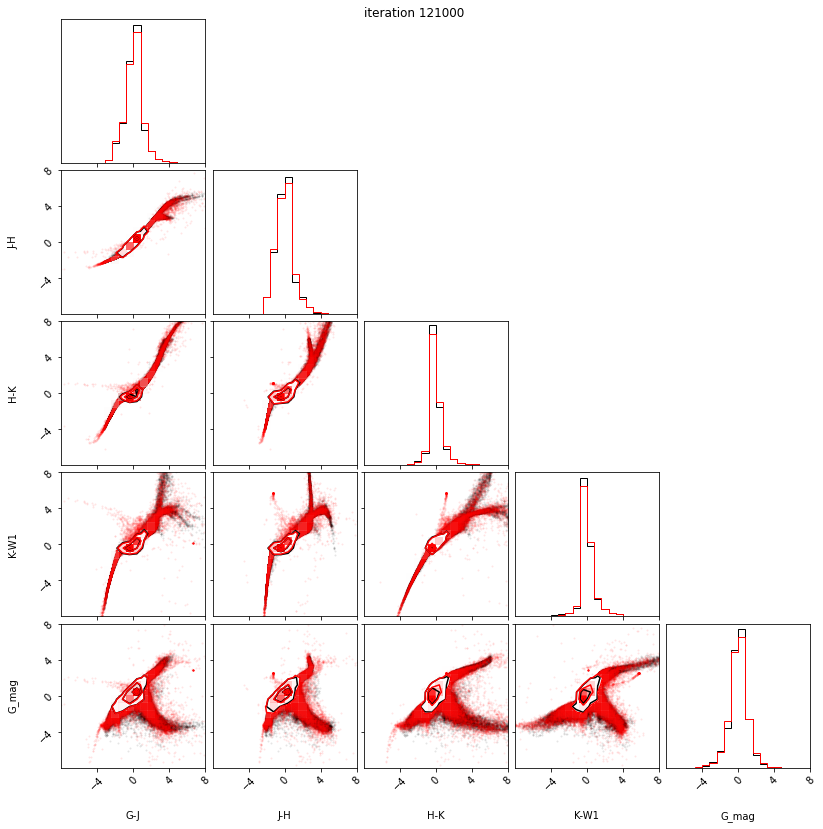

121100 -6.151073455810547 -6.114680767059326 0.6526026725769043 -inf
121200 -6.098489761352539 -6.132851600646973 0.7539806365966797 -inf
121300 -6.048642158508301 -5.530553817749023 0.6544375419616699 -inf
121400 -5.673048973083496 -5.333950519561768 0.47470951080322266 -inf
121500 -5.735412120819092 -6.033135890960693 0.687739372253418 -inf
121600 -5.177668571472168 -5.672913074493408 0.4628777503967285 -inf
121700 -6.157764911651611 -6.215904712677002 0.6329221725463867 -inf
121800 -6.2490234375 -6.245047569274902 0.5949764251708984 -inf
121900 -5.1973395347595215 -4.912772178649902 0.587944507598877 -inf
122000 -6.214425563812256 -6.22406530380249 0.5195016860961914 -inf
0.5195016860961914 -inf


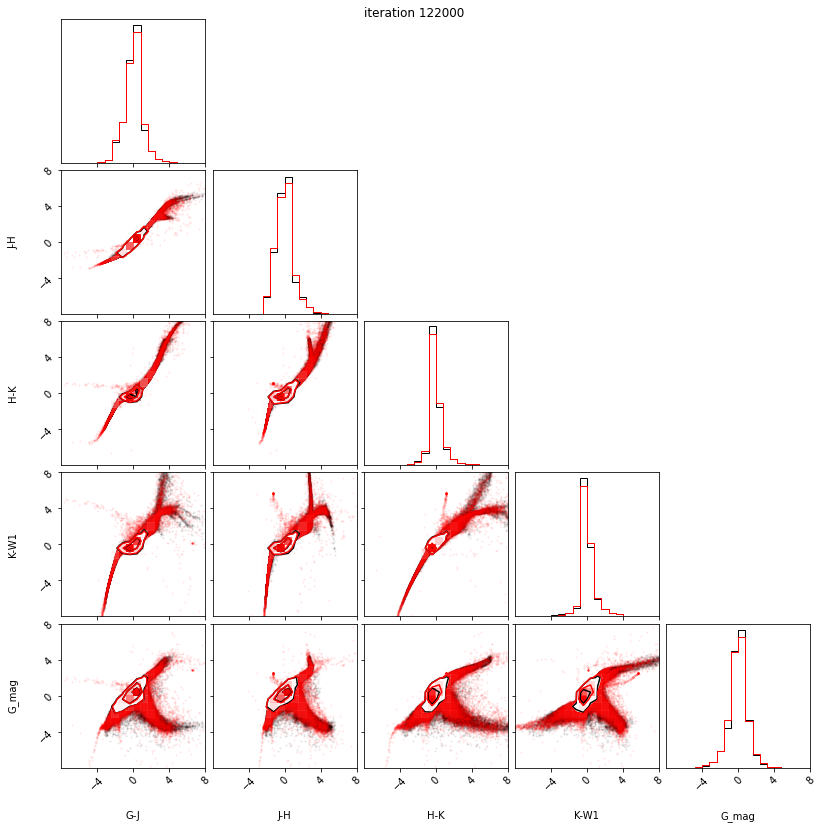

122100 -6.211329460144043 -6.240067958831787 0.5897245407104492 -inf
122200 -5.167159080505371 -5.446380138397217 0.6095561981201172 -inf
122300 -6.164499282836914 -6.142291069030762 0.5996913909912109 -inf
122400 -6.191930770874023 -6.249100685119629 0.5833926200866699 -inf
122500 -6.182114124298096 -6.217677116394043 0.5038681030273438 -inf
122600 -6.0923895835876465 -6.143662929534912 0.5001001358032227 -inf
122700 -5.678244590759277 -6.04518985748291 0.7192502021789551 -inf
122800 -5.430771827697754 -5.7407546043396 0.7872686386108398 -inf
122900 -5.916808128356934 -5.681357383728027 0.5338387489318848 -inf
123000 -6.209909439086914 -6.267630100250244 0.6470708847045898 -inf
0.6470708847045898 -inf


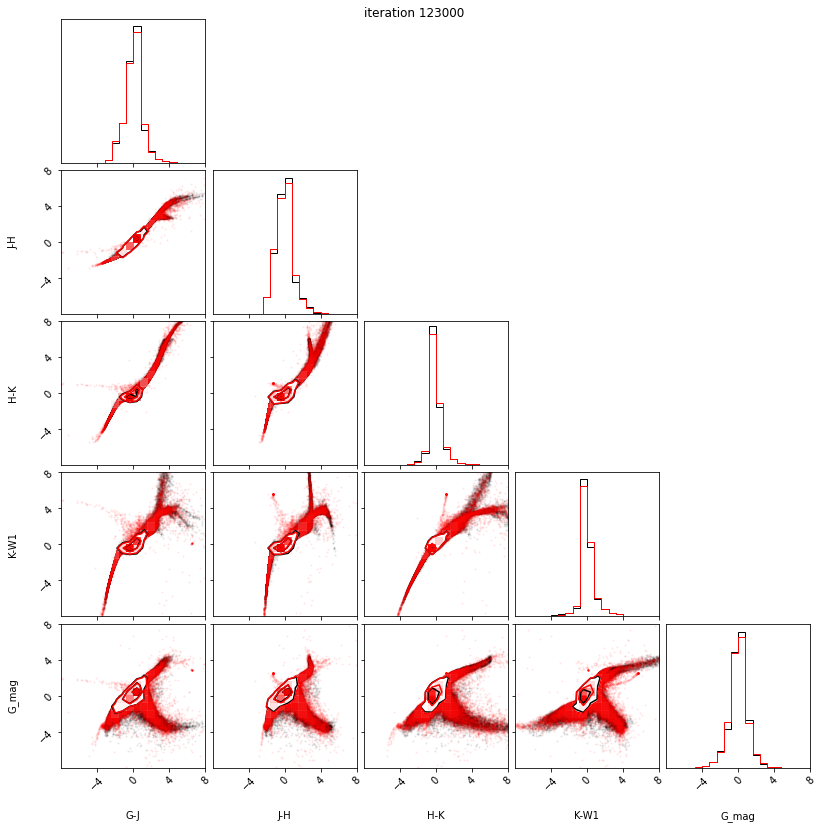

123100 -6.173986911773682 -6.171393394470215 0.5799770355224609 -inf
123200 -5.969027996063232 -6.126736164093018 0.6773128509521484 -inf
123300 -6.1966071128845215 -6.16360330581665 0.5435152053833008 -inf
123400 -6.158874988555908 -6.023789882659912 0.6958270072937012 -inf
123500 -6.186931133270264 -6.203991889953613 0.6975259780883789 -inf
123600 -5.922666072845459 -6.0546875 0.6524295806884766 -inf
123700 -5.75097131729126 -5.686070442199707 0.6279172897338867 -inf
123800 -5.985345363616943 -6.027919292449951 0.6956791877746582 -inf
123900 -5.900912284851074 -6.068322658538818 0.5252647399902344 -inf
124000 -6.165812969207764 -6.2248616218566895 0.6854186058044434 -inf
0.6854186058044434 -inf


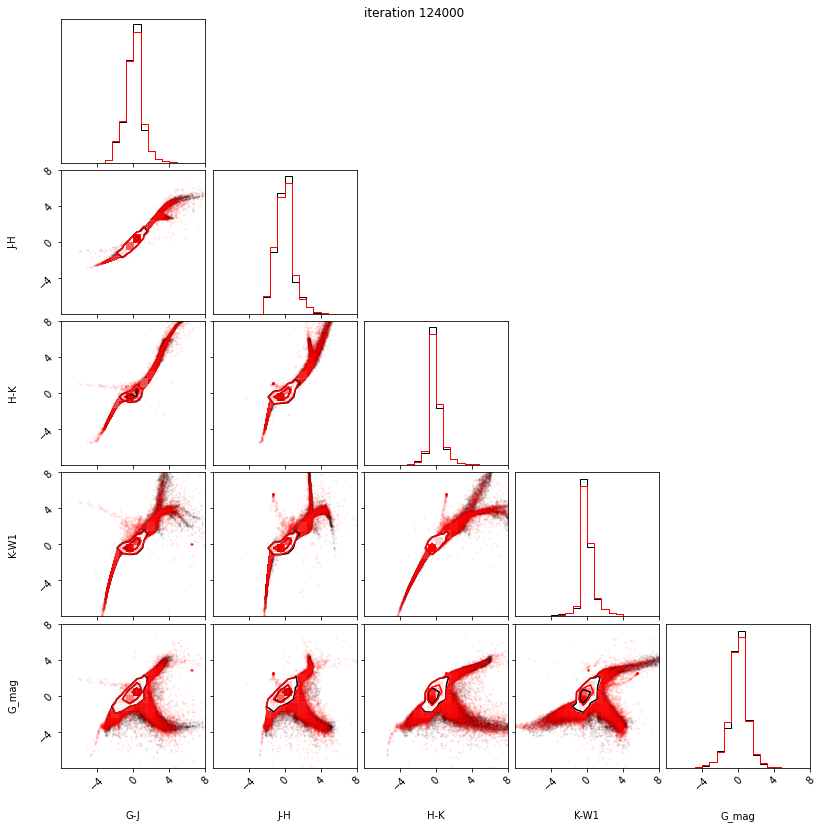

124100 -6.16628885269165 -6.2466912269592285 0.6387410163879395 -inf
124200 -6.250853061676025 -6.265463352203369 0.6509099006652832 -inf
124300 -5.2608208656311035 -5.056477069854736 0.6810722351074219 -inf
124400 -5.697688102722168 -5.376139163970947 0.6284451484680176 -inf
124500 -6.054815292358398 -6.019547462463379 0.5322980880737305 -inf
124600 -6.180758476257324 -6.222160816192627 0.5471696853637695 -inf
124700 -6.245640277862549 -6.2690653800964355 0.6233639717102051 -inf
124800 -5.502076625823975 -6.069764137268066 0.4978451728820801 -inf
124900 -6.080316066741943 -6.0135579109191895 0.5565404891967773 -inf
125000 -6.174215316772461 -6.123241901397705 0.5903778076171875 -inf
0.5903778076171875 -inf


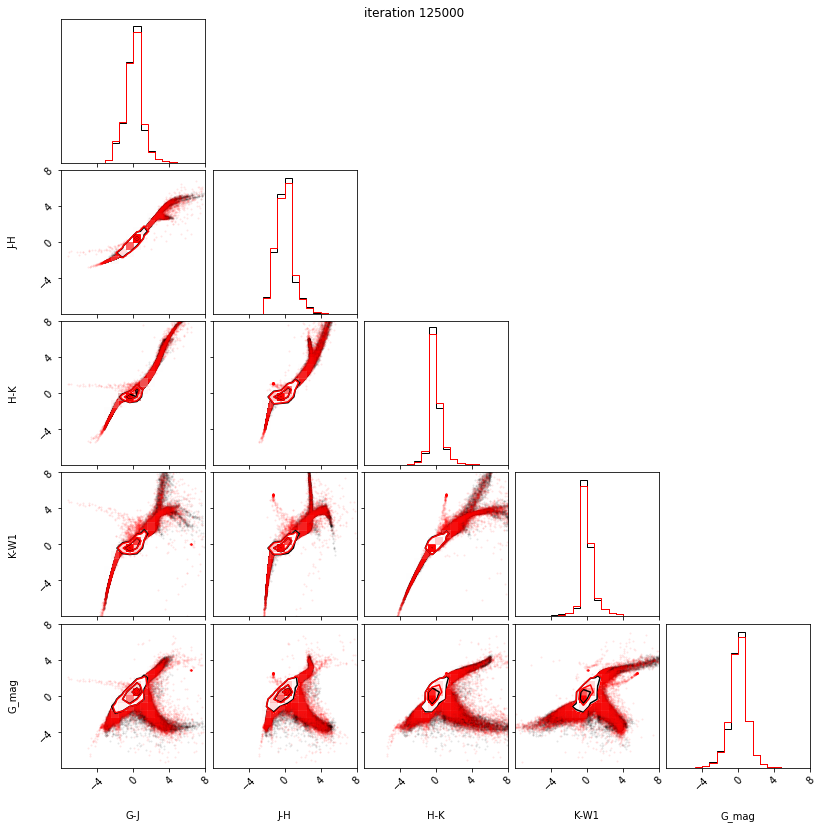

125100 -6.237767219543457 -6.241457939147949 0.5572199821472168 -inf
125200 -6.158639430999756 -6.150548458099365 0.5587081909179688 -inf
125300 -6.006276607513428 -6.059751987457275 0.6304745674133301 -inf
125400 -4.7765421867370605 -5.071131706237793 0.4582843780517578 -inf
125500 -6.215609073638916 -6.09766960144043 0.5462517738342285 -inf
125600 -6.1418585777282715 -5.947824954986572 0.5831408500671387 -inf
125700 -6.220463275909424 -6.196681022644043 0.5910587310791016 -inf
125800 -6.158190727233887 -6.094371795654297 0.5241298675537109 -inf
125900 -5.960176944732666 -5.716097831726074 0.6633367538452148 -inf
126000 -5.203119277954102 -5.797614097595215 0.5886054039001465 -inf
0.5886054039001465 -inf


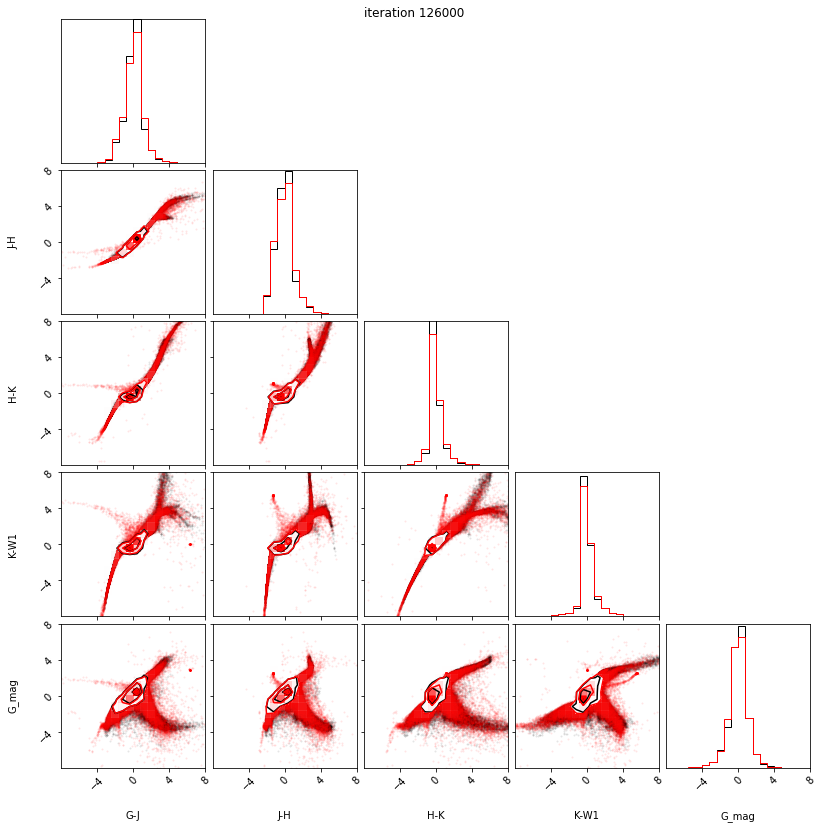

126100 -5.6646037101745605 -5.085031509399414 0.640009880065918 -inf
126200 -6.256434440612793 -6.238533020019531 0.5276093482971191 -inf
126300 -6.265373706817627 -6.276033401489258 0.4780998229980469 -inf
126400 -6.2374444007873535 -6.253158092498779 0.5857782363891602 -inf
126500 -6.244755744934082 -6.142740249633789 0.5100440979003906 -inf
126600 -6.156036853790283 -6.080629348754883 0.582097053527832 -inf
126700 -5.772514820098877 -6.133304595947266 0.681304931640625 -inf
126800 -5.766315460205078 -5.344438552856445 0.4556159973144531 -inf
126900 -6.284445762634277 -6.286476135253906 0.576904296875 -inf
127000 -5.969974994659424 -6.173676490783691 0.5391407012939453 -inf
0.5391407012939453 -inf


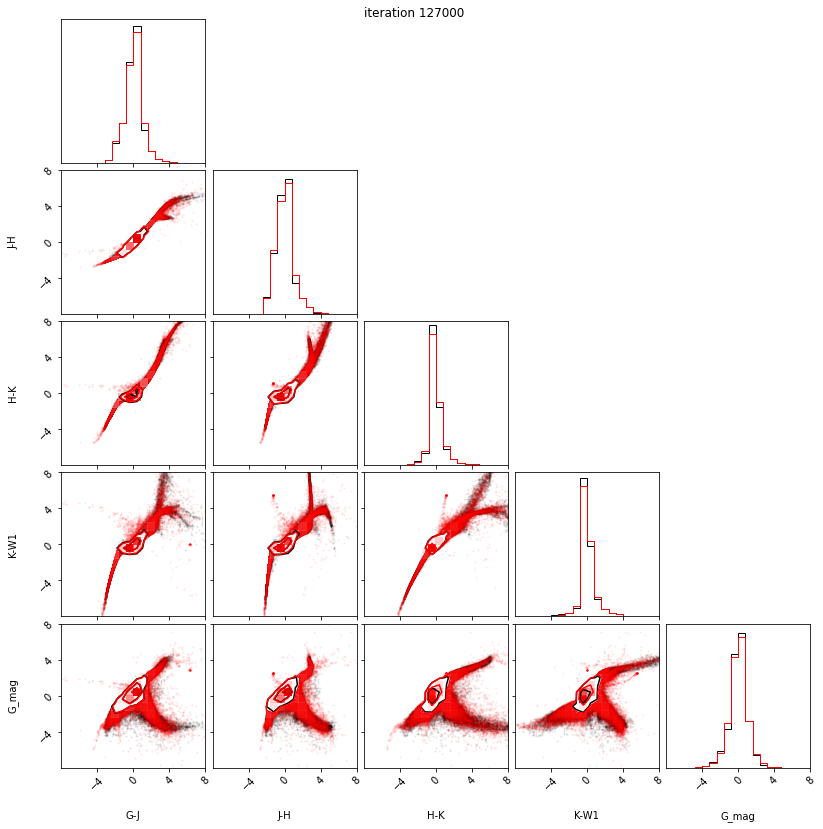

127100 -5.973076343536377 -5.946104526519775 0.6718754768371582 -inf
127200 -6.0586724281311035 -6.21539831161499 0.5308189392089844 -inf
127300 -5.894044399261475 -5.853209972381592 0.567695140838623 -inf
127400 -6.071884632110596 -6.210524559020996 0.45384693145751953 -inf
127500 -6.047770023345947 -6.113800048828125 0.5809187889099121 -inf
127600 -6.130211353302002 -5.697387218475342 0.5394148826599121 -inf
127700 -4.652369499206543 -5.632846832275391 0.5520248413085938 -inf
127800 -5.09811544418335 -4.682830810546875 0.6003608703613281 -inf
127900 -6.2832818031311035 -6.279358863830566 0.5386710166931152 -inf
128000 -6.005177021026611 -6.062987327575684 0.358919620513916 -inf
0.358919620513916 -inf


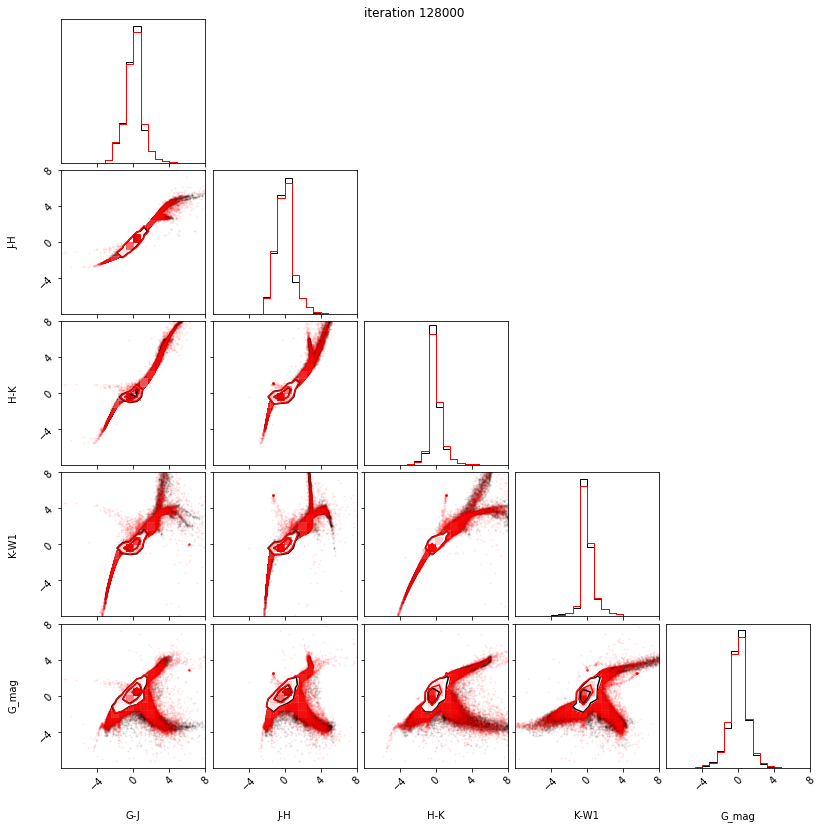

128100 -6.162606716156006 -6.203591346740723 0.5081791877746582 -inf
128200 -6.04060173034668 -6.045464515686035 0.463346004486084 -inf
128300 -5.885355472564697 -5.987877368927002 0.6495485305786133 -inf
128400 -5.143774032592773 -5.121890068054199 0.40293216705322266 -inf
128500 -5.60591983795166 -5.860337257385254 0.524958610534668 -inf
128600 -6.066902160644531 -6.020595550537109 0.5084609985351562 -inf
128700 -5.485228538513184 -4.355388164520264 0.6670904159545898 -inf
128800 -6.085048198699951 -5.460168838500977 0.7036361694335938 -inf
128900 -6.266610622406006 -6.258973121643066 0.5180654525756836 -inf
129000 -6.310298442840576 -6.305768966674805 0.5265913009643555 -inf
0.5265913009643555 -inf


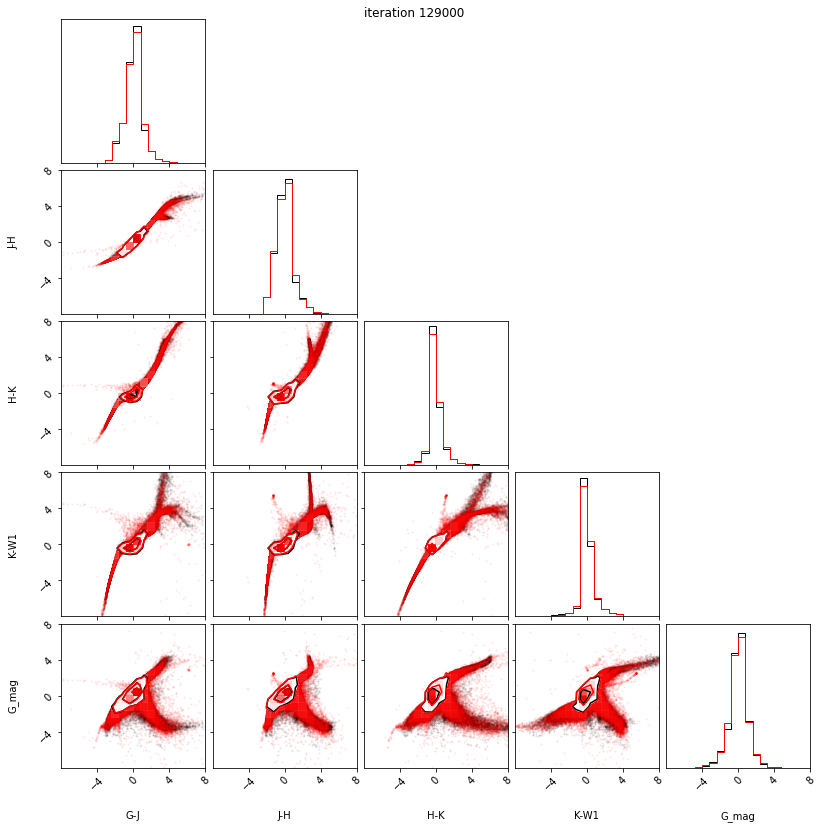

129100 -6.270082473754883 -6.1952996253967285 0.5511288642883301 -inf
129200 -6.215210914611816 -6.222838401794434 0.6606297492980957 -inf
129300 -5.807611465454102 -5.752204418182373 0.5291152000427246 -inf
129400 -6.277301788330078 -6.1668877601623535 0.5901546478271484 -inf
129500 -4.376453876495361 -5.915553569793701 0.39998579025268555 -inf
129600 -5.254068374633789 -5.591869354248047 0.36527252197265625 -inf
129700 -5.390146732330322 -5.473771095275879 0.49884653091430664 -inf
129800 -5.912143707275391 -5.395004749298096 0.5071759223937988 -inf
129900 -4.678082466125488 -5.614063739776611 0.218353271484375 -inf
130000 -6.012532711029053 -6.048335075378418 0.43457889556884766 -inf
0.43457889556884766 -inf


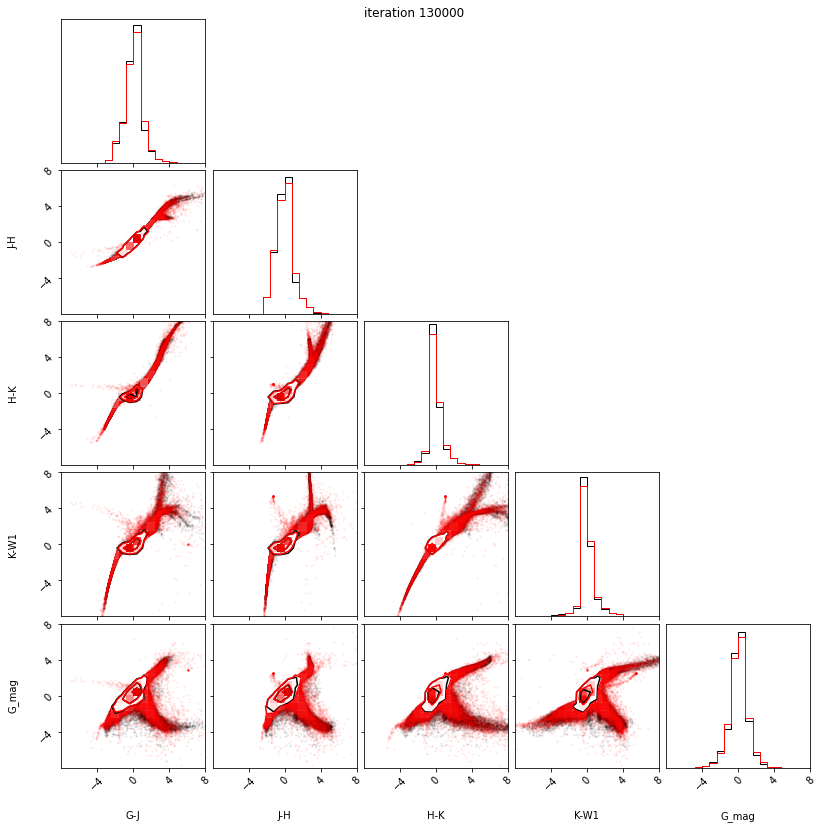

130100 -5.9876227378845215 -6.059693813323975 0.32557058334350586 -inf
130200 -6.168661117553711 -6.192808628082275 0.5442581176757812 -inf
130300 -6.028956890106201 -5.763092041015625 0.5252470970153809 -inf
130400 -6.087463855743408 -6.16441535949707 0.5190277099609375 -inf
130500 -5.823463439941406 -6.008082866668701 0.2676362991333008 -inf
130600 -6.129383087158203 -5.7741827964782715 0.5543780326843262 -inf
130700 -4.917226314544678 -4.621277332305908 0.07147502899169922 -inf
130800 -6.091737270355225 -6.198112964630127 0.4423642158508301 -inf
130900 -5.562932014465332 -4.683541774749756 0.4776325225830078 -inf
131000 -5.39674711227417 -4.00495719909668 0.5076985359191895 -inf
0.5076985359191895 -inf


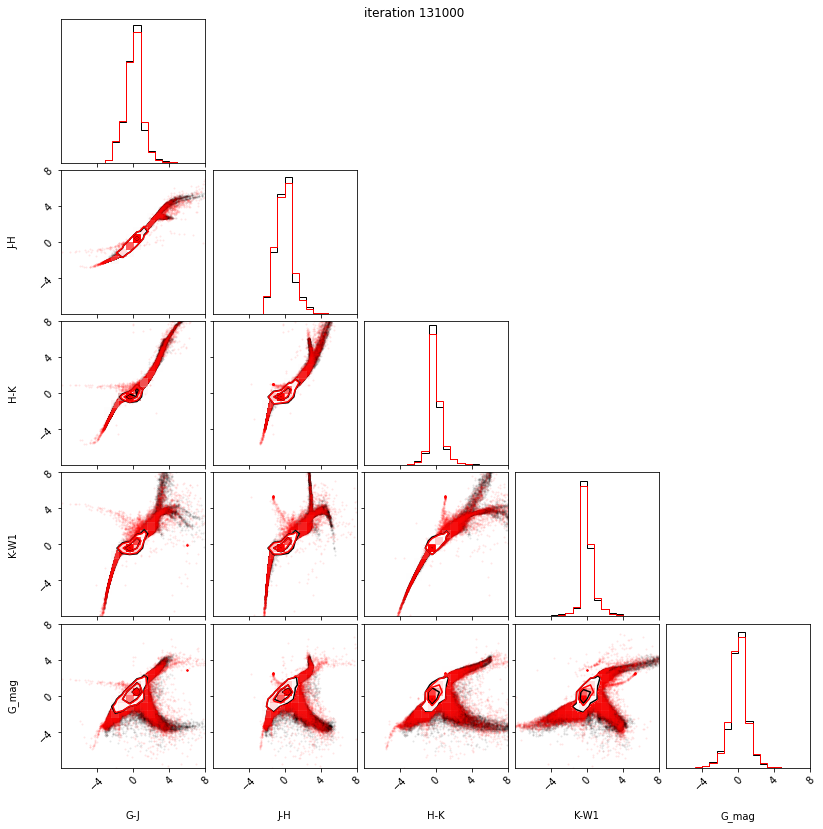

131100 -6.27275276184082 -6.251019477844238 0.4050254821777344 -inf
131200 -5.71660041809082 -5.594211578369141 0.3620767593383789 -inf
131300 -6.059020042419434 -5.934032440185547 0.39054250717163086 -inf
131400 -5.976711750030518 -5.598916053771973 0.393404483795166 -inf
131500 -5.99064302444458 -6.184264659881592 0.4844498634338379 -inf
131600 -5.698966979980469 -4.485457897186279 0.2349252700805664 -inf
131700 -6.17203950881958 -5.905872344970703 0.4052915573120117 -inf
131800 -6.247969150543213 -6.264845371246338 0.2689056396484375 -inf
131900 -5.915802955627441 -5.7807464599609375 0.44098663330078125 -inf
132000 -6.067478179931641 -6.106019496917725 0.3465557098388672 -inf
0.3465557098388672 -inf


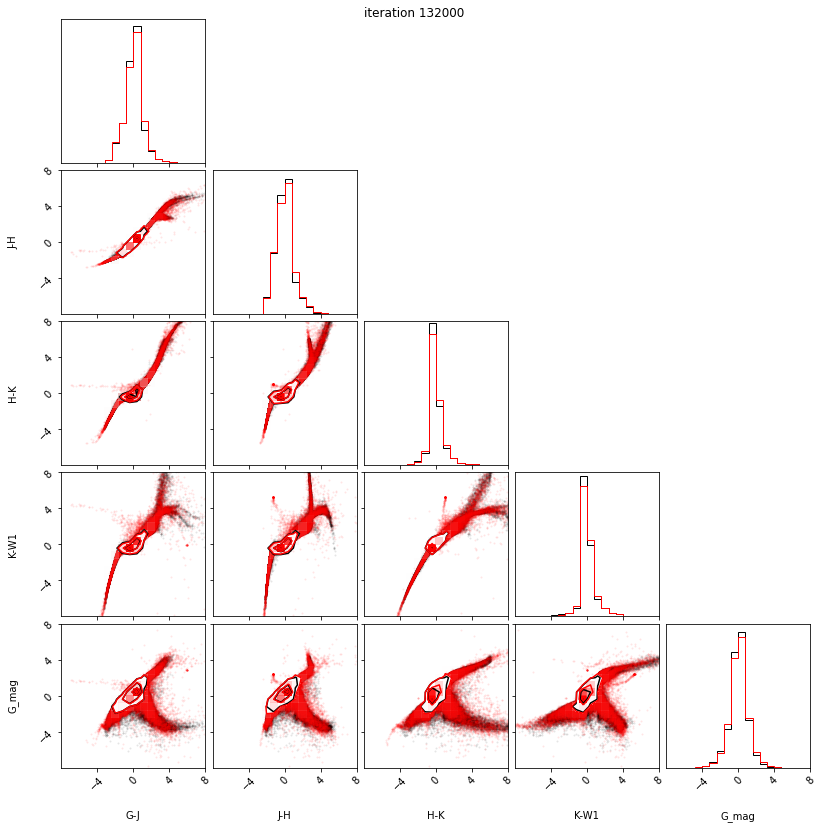

132100 -5.630840301513672 -5.570451259613037 0.5015144348144531 -inf
132200 -5.600671291351318 -5.553187370300293 0.10181045532226562 -inf
132300 -6.119577407836914 -5.980836391448975 0.5011863708496094 -inf
132400 -5.755797386169434 -5.925053119659424 0.3555436134338379 -inf
132500 -5.882556915283203 -6.155208587646484 0.20498180389404297 -inf
132600 -5.519130706787109 -5.451371669769287 0.030181407928466797 -inf
132700 -5.296775817871094 -4.529105186462402 0.2873249053955078 -inf
132800 -6.317871570587158 -6.32141637802124 0.30338001251220703 -inf
132900 -5.937862873077393 -6.079059600830078 0.4388256072998047 -inf
133000 -6.096442222595215 -5.8037824630737305 0.0017685890197753906 -inf
0.0017685890197753906 -inf


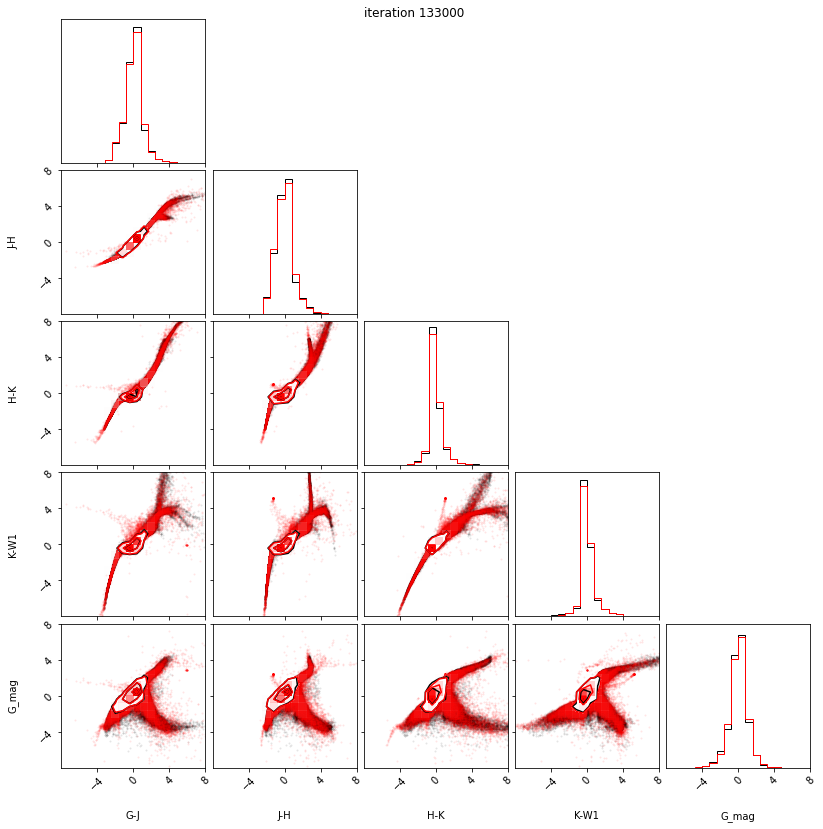

133100 -5.6175336837768555 -5.65867805480957 0.14929485321044922 -inf
133200 -6.1617021560668945 -6.119439601898193 0.36986303329467773 -inf
133300 -5.968053340911865 -5.961996078491211 0.4838705062866211 -inf
133400 -5.790794372558594 -5.563976764678955 0.4437551498413086 -inf
133500 -4.881950855255127 -5.928664684295654 0.38634443283081055 -inf
133600 -4.8580241203308105 -5.726811408996582 0.35814905166625977 -inf
133700 -4.236062049865723 -5.424906253814697 0.3640460968017578 -inf
133800 -6.2271881103515625 -6.249745845794678 0.38613271713256836 -inf
133900 -5.8984694480896 -5.852859973907471 0.23072576522827148 -inf
134000 -6.239194393157959 -6.239346504211426 0.27886009216308594 -inf
0.27886009216308594 -inf


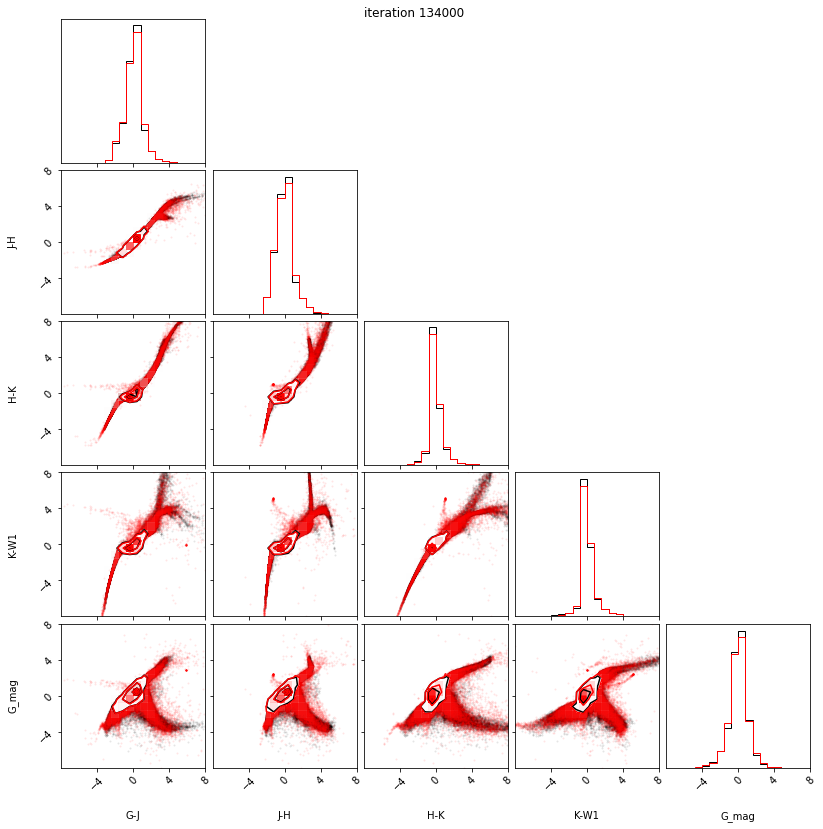

134100 -6.3028059005737305 -6.321651458740234 0.4219322204589844 -inf
134200 -5.887685298919678 -5.638034343719482 0.45681095123291016 -inf
134300 -5.799335956573486 -6.005064487457275 0.5135664939880371 -inf
134400 -6.114536762237549 -5.9862961769104 0.48013734817504883 -inf
134500 -6.164565086364746 -6.225316047668457 0.4179115295410156 -inf
134600 -5.92575216293335 -5.492396831512451 0.4560708999633789 -inf
134700 -5.4777984619140625 -3.9031007289886475 -0.019659996032714844 -inf
134800 -6.2988505363464355 -6.237695693969727 0.32207298278808594 -inf
134900 -6.299387454986572 -6.294919013977051 0.27053260803222656 -inf
135000 -6.237447738647461 -6.266690731048584 0.35397911071777344 -inf
0.35397911071777344 -inf


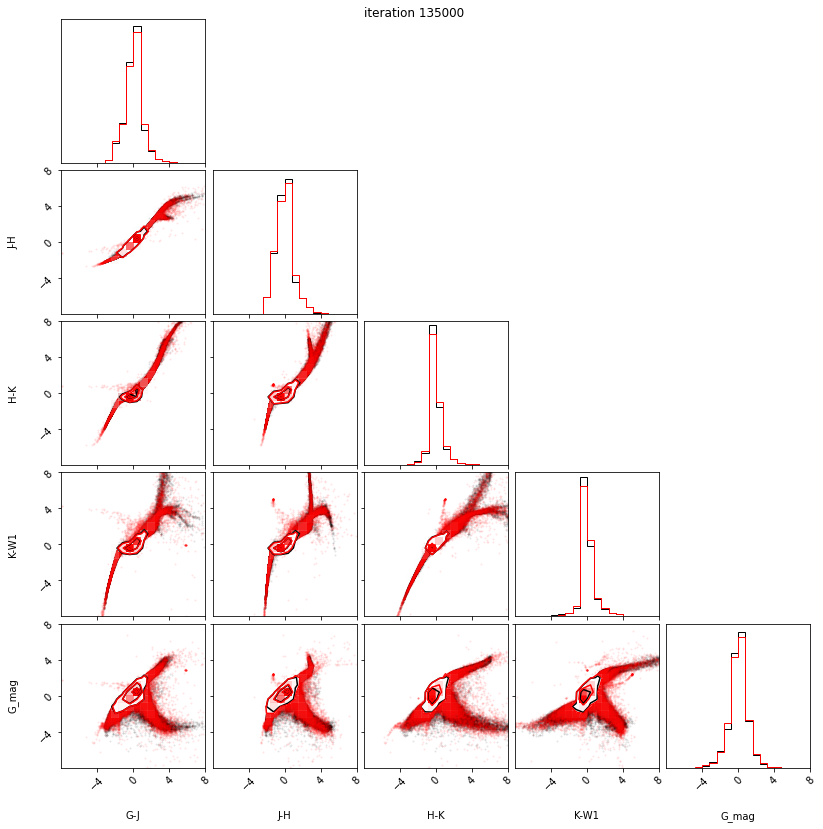

135100 -6.212889671325684 -6.237166881561279 0.27832889556884766 -inf
135200 -5.854044437408447 -5.8397932052612305 0.3711357116699219 -inf
135300 -6.268625736236572 -6.240417003631592 0.28966665267944336 -inf
135400 -6.068661689758301 -6.101149082183838 0.18932628631591797 -inf
135500 -6.1142354011535645 -6.042747497558594 0.18937253952026367 -inf
135600 -5.093154430389404 -5.801385879516602 0.0913233757019043 -inf
135700 -5.110352039337158 -5.194329738616943 0.06920337677001953 -inf
135800 -5.629641532897949 -4.631579399108887 0.11910486221313477 -inf
135900 -6.309406280517578 -6.305293560028076 0.25948667526245117 -inf
136000 -6.098062515258789 -6.039710998535156 0.38604259490966797 -inf
0.38604259490966797 -inf


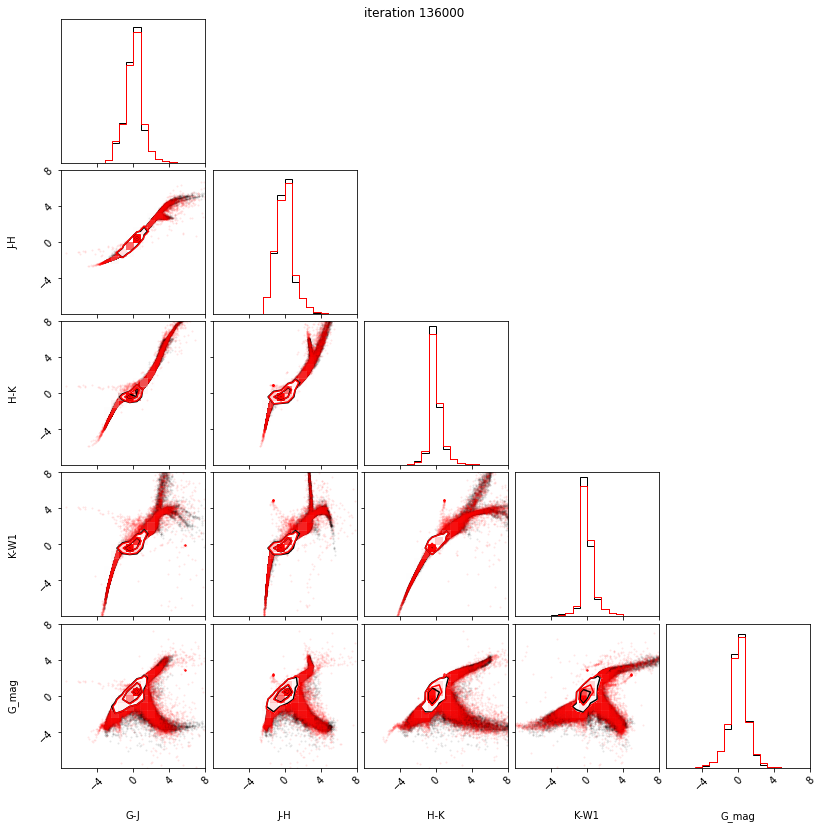

136100 -5.309482097625732 -4.656922340393066 0.3841252326965332 -inf
136200 -6.12753438949585 -6.138363361358643 0.27367496490478516 -inf
136300 -6.165347576141357 -6.223088264465332 0.27329206466674805 -inf
136400 -5.919699668884277 -6.106942653656006 0.008502006530761719 -inf
136500 -5.904098987579346 -5.972200393676758 0.27187347412109375 -inf
136600 -5.677511692047119 -5.327567100524902 0.16593408584594727 -inf
136700 -6.178666114807129 -6.220693111419678 0.2020888328552246 -inf
136800 -6.0631303787231445 -6.105605125427246 0.3342766761779785 -inf
136900 -5.616067886352539 -5.284716606140137 0.45131444931030273 -inf
137000 -5.339814186096191 -6.144826889038086 0.33345460891723633 -inf
0.33345460891723633 -inf


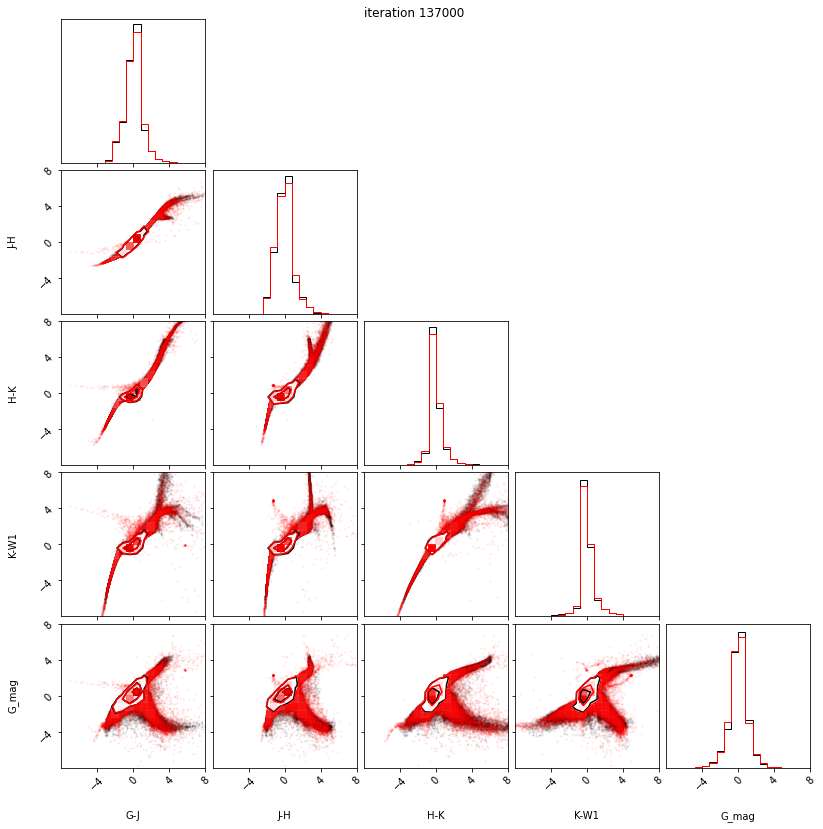

137100 -6.331754684448242 -6.313399791717529 0.27579498291015625 -inf
137200 -6.309722900390625 -6.3195977210998535 0.3022947311401367 -inf
137300 -6.144290924072266 -6.216136455535889 0.35324716567993164 -inf
137400 -6.103331089019775 -5.879952430725098 0.40891218185424805 -inf
137500 -5.944414138793945 -5.398561954498291 0.3264760971069336 -inf
137600 -5.989741325378418 -6.019298076629639 0.43618059158325195 -inf
137700 -6.188866138458252 -6.143364906311035 0.27431631088256836 -inf
137800 -5.890281677246094 -6.150665283203125 0.3081026077270508 -inf
137900 -5.779030799865723 -5.943828582763672 0.3603501319885254 -inf
138000 -5.983374118804932 -6.139108657836914 0.3227725028991699 -inf
0.3227725028991699 -inf


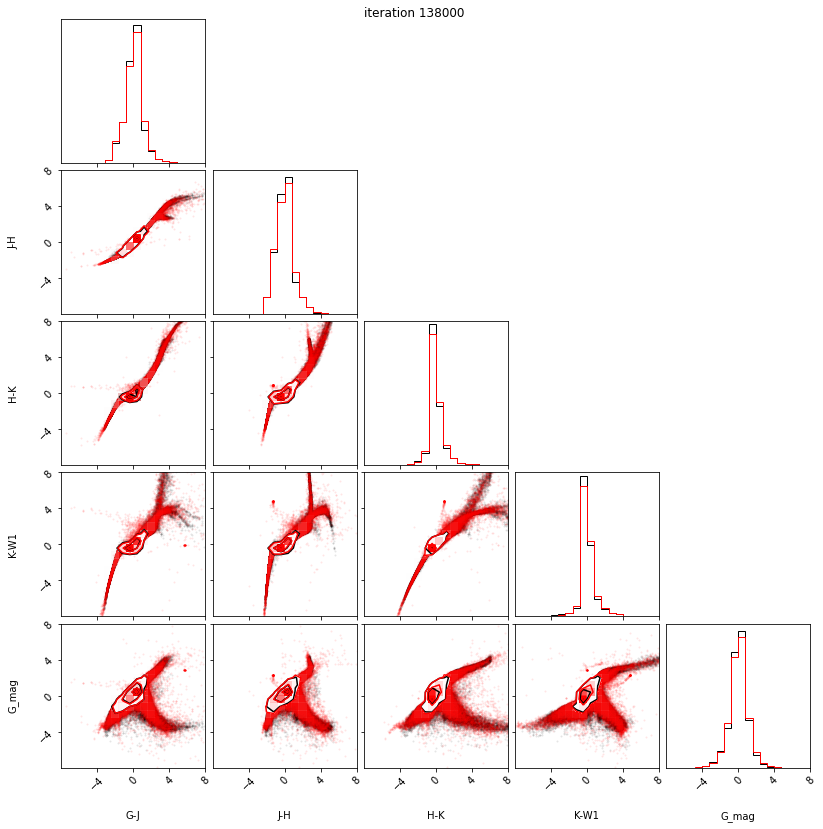

138100 -6.070387363433838 -6.159164905548096 0.15548992156982422 -inf
138200 -6.021773338317871 -6.232194423675537 0.36776161193847656 -inf
138300 -6.268268585205078 -6.352597713470459 0.3388051986694336 -inf
138400 -5.99970006942749 -5.79200553894043 0.2670407295227051 -inf
138500 -5.417681694030762 -5.980417251586914 0.12609100341796875 -inf
138600 -5.767086029052734 -5.750312805175781 0.2813253402709961 -inf
138700 -6.161846160888672 -5.904668807983398 0.24303340911865234 -inf
138800 -5.447082042694092 -5.27114200592041 -0.0993490219116211 -inf
138900 -6.260636329650879 -6.264113903045654 0.2303638458251953 -inf
139000 -5.512694358825684 -5.560667991638184 0.24949264526367188 -inf
0.24949264526367188 -inf


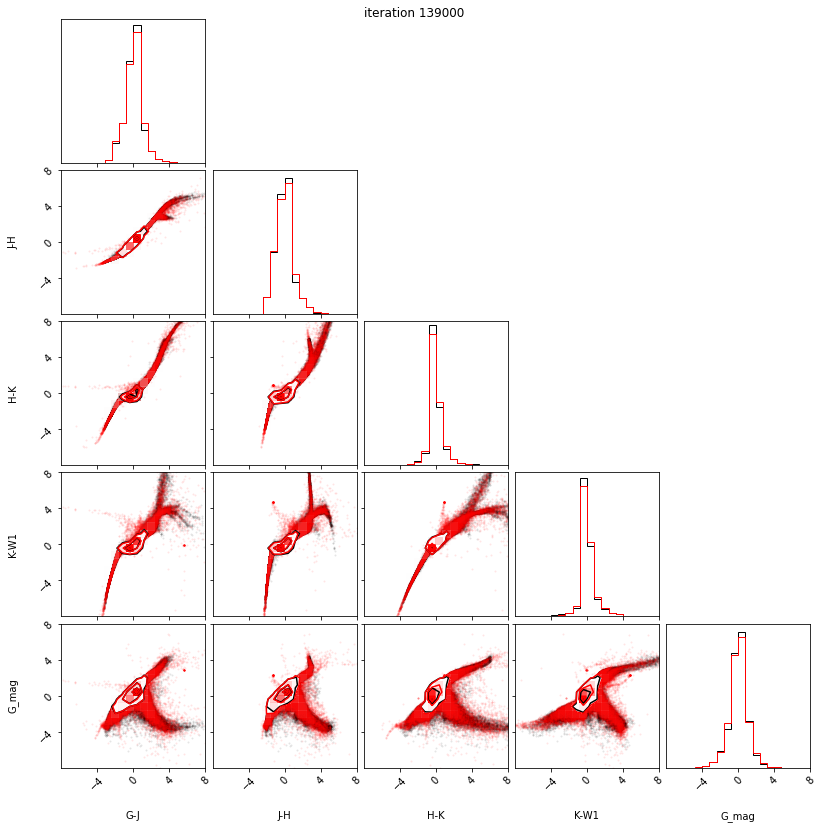

139100 -5.649372100830078 -5.821074962615967 0.20192575454711914 -inf
139200 -5.493206024169922 -6.179713726043701 0.29608917236328125 -inf
139300 -4.32717752456665 -3.7091100215911865 0.2566666603088379 -inf
139400 -6.358660697937012 -6.363070487976074 0.26426076889038086 -inf
139500 -4.76623010635376 -6.127946853637695 0.3059720993041992 -inf
139600 -6.298264026641846 -6.295891284942627 0.2268238067626953 -inf
139700 -6.181175231933594 -6.284648895263672 0.3112039566040039 -inf
139800 -5.938802242279053 -6.194067001342773 0.2513608932495117 -inf
139900 -4.543441295623779 -2.867368221282959 0.149322509765625 -inf
140000 -6.32550048828125 -6.330153465270996 0.17943954467773438 -inf
0.17943954467773438 -inf


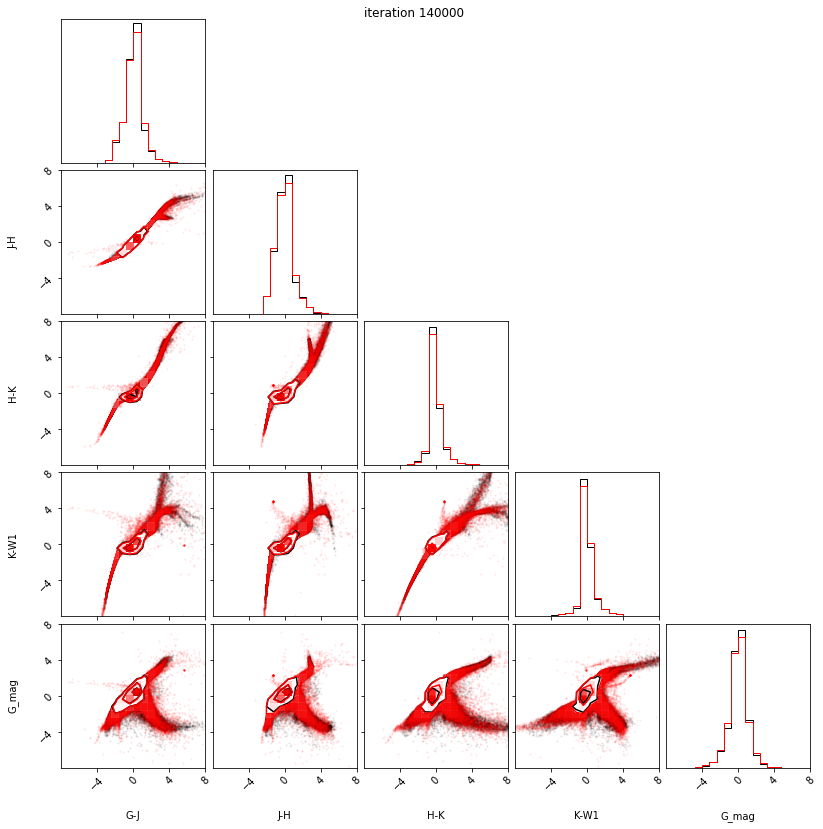

140100 -6.2779951095581055 -6.238903999328613 0.2046060562133789 -inf
140200 -6.325872421264648 -6.331838130950928 0.19293975830078125 -inf
140300 -6.3200459480285645 -6.305427074432373 0.2814626693725586 -inf
140400 -6.305042743682861 -6.265528678894043 0.06752538681030273 -inf
140500 -6.242090702056885 -6.183483600616455 0.27652740478515625 -inf
140600 -5.9569993019104 -5.823469161987305 -0.39098215103149414 -inf
140700 -5.962375640869141 -5.925174236297607 0.14023399353027344 -inf
140800 -6.171977519989014 -6.185378074645996 0.2845635414123535 -inf
140900 -6.2816162109375 -6.303240776062012 0.11317825317382812 -inf
141000 -6.204288959503174 -6.296790599822998 0.14358091354370117 -inf
0.14358091354370117 -inf


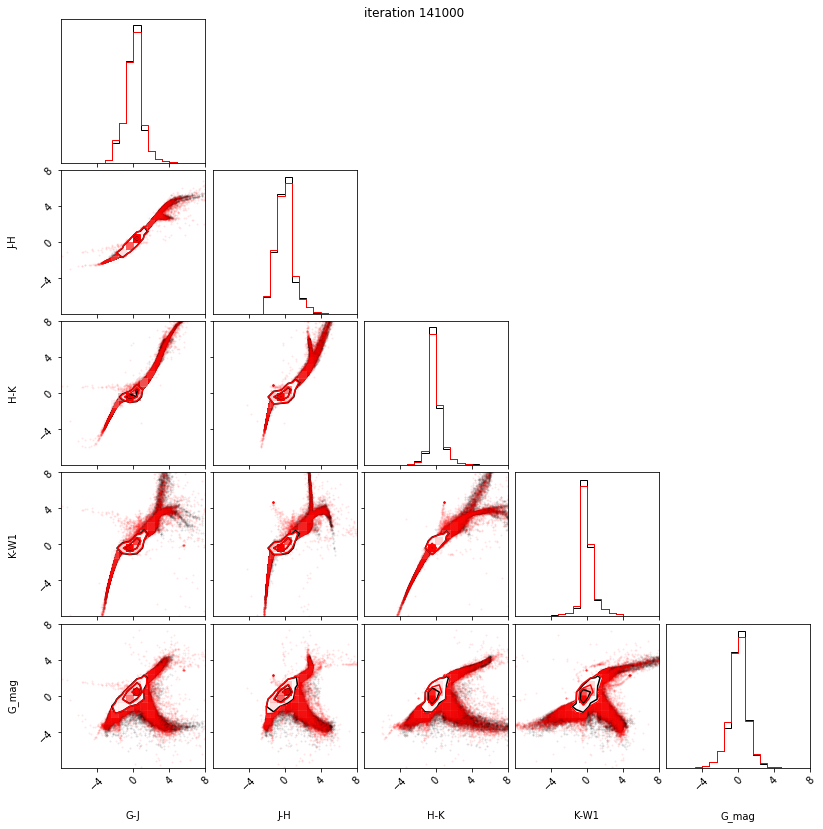

141100 -5.673027038574219 -5.249606609344482 0.03382539749145508 -inf
141200 -6.004470348358154 -6.128528594970703 0.2138233184814453 -inf
141300 -6.239038944244385 -6.190279960632324 0.05700349807739258 -inf
141400 -5.625797748565674 -6.046360969543457 0.28393030166625977 -inf
141500 -4.090312957763672 -4.6201090812683105 0.31484317779541016 -inf
141600 -4.237735271453857 -3.436717987060547 0.5782527923583984 -inf
141700 -6.310978889465332 -6.334311485290527 0.20054244995117188 -inf
141800 -6.279998302459717 -6.2779316902160645 0.11621856689453125 -inf
141900 -6.289373397827148 -6.293381690979004 0.3075432777404785 -inf
142000 -6.213687419891357 -6.204350471496582 0.28214502334594727 -inf
0.28214502334594727 -inf


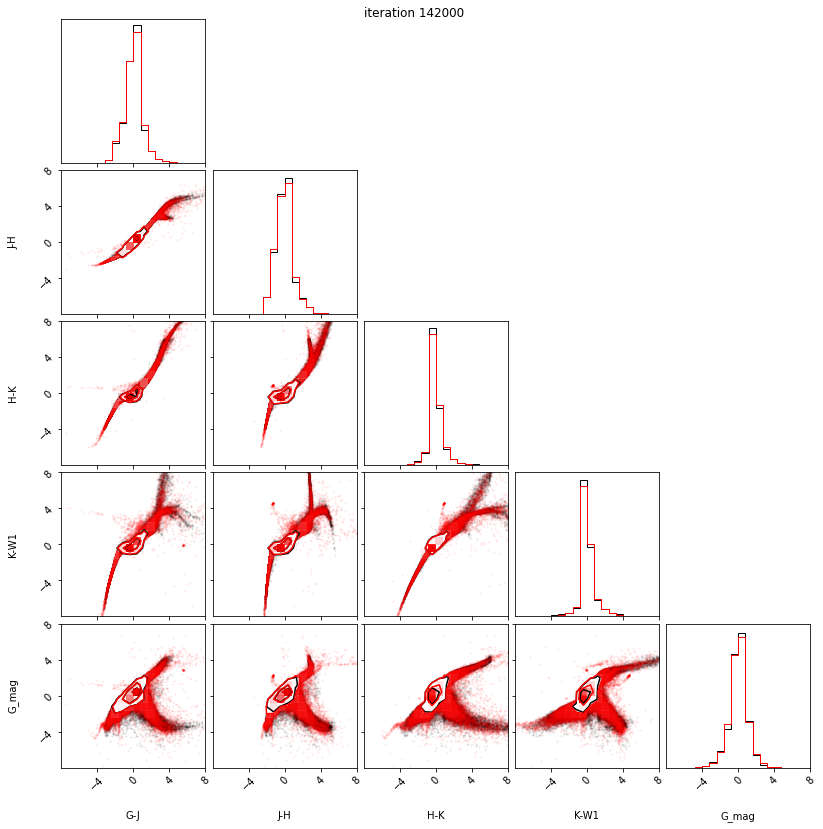

142100 -6.160022735595703 -6.164237022399902 0.14258098602294922 -inf
142200 -5.431702613830566 -5.9004082679748535 0.07927417755126953 -inf
142300 -5.777812480926514 -6.10825777053833 0.3062582015991211 -inf
142400 -6.084567070007324 -6.087648868560791 -0.0047092437744140625 -inf
142500 -6.318623065948486 -6.306692600250244 0.3380579948425293 -inf
142600 -5.746143817901611 -5.506285190582275 0.23876380920410156 -inf
142700 -5.852304458618164 -6.023683547973633 0.17592906951904297 -inf
142800 -5.161089897155762 -6.027688980102539 0.23821353912353516 -inf
142900 -5.783604621887207 -4.784811973571777 0.4661870002746582 -inf
143000 -6.182788848876953 -5.983639717102051 0.15502405166625977 -inf
0.15502405166625977 -inf


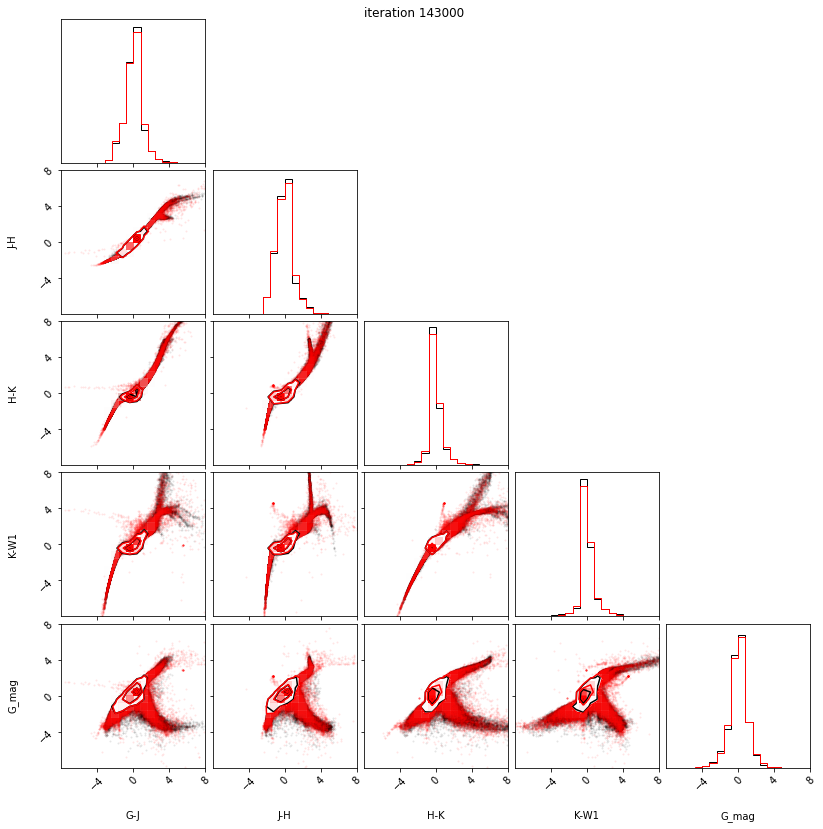

143100 -4.636131763458252 -5.323994159698486 0.16550493240356445 -inf
143200 -6.3014235496521 -6.2277116775512695 0.27838754653930664 -inf
143300 -5.894175052642822 -4.089639186859131 0.13608551025390625 -inf
143400 -6.355849742889404 -6.236093997955322 0.2751035690307617 -inf
143500 -5.376798629760742 -5.414640426635742 0.20394039154052734 -inf
143600 -5.594840049743652 -5.53062629699707 0.2607231140136719 -inf
143700 -5.117986679077148 -5.81471061706543 0.1882338523864746 -inf
143800 -5.491817951202393 -6.0447187423706055 0.19447040557861328 -inf
143900 -5.749360084533691 -5.681834697723389 0.14383268356323242 -inf
144000 -6.237181186676025 -6.207211017608643 0.24676513671875 -inf
0.24676513671875 -inf


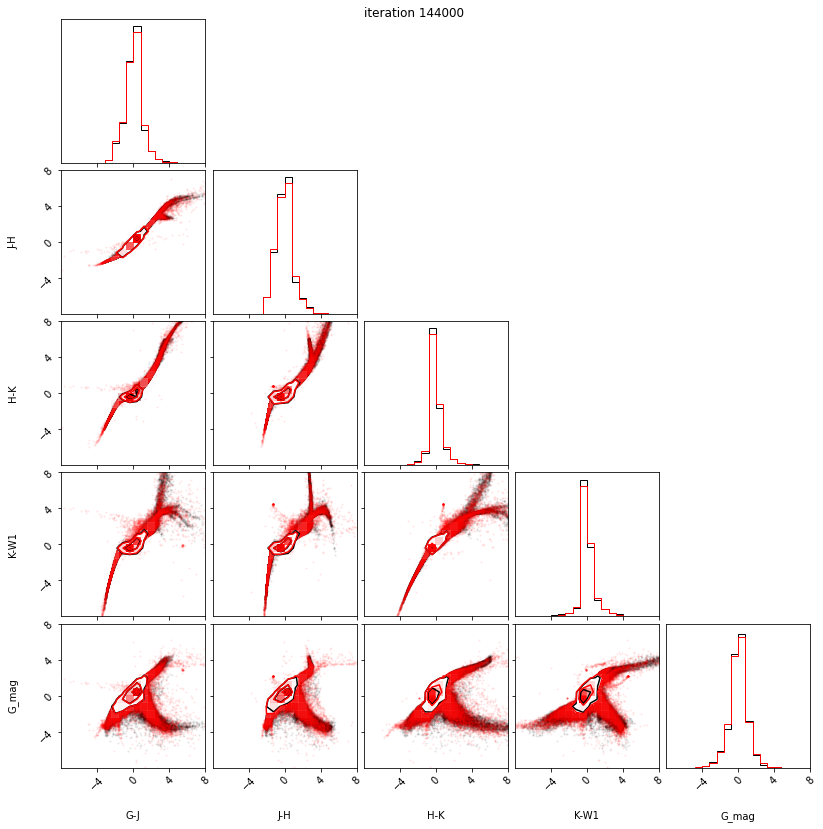

144100 -6.245724678039551 -6.316646099090576 0.28651905059814453 -inf
144200 -6.0314412117004395 -6.22428035736084 0.17079448699951172 -inf
144300 -6.204219341278076 -6.059034824371338 0.15020275115966797 -inf
144400 -6.357069492340088 -6.357022285461426 0.16730833053588867 -inf
144500 -6.239582061767578 -6.2892632484436035 0.10506677627563477 -inf
144600 -6.1727752685546875 -6.259368419647217 0.22963380813598633 -inf
144700 -5.83158016204834 -5.456639766693115 0.2627081871032715 -inf
144800 -6.296083450317383 -6.264656066894531 0.2748093605041504 -inf
144900 -6.286678314208984 -6.311099052429199 0.1681537628173828 -inf
145000 -6.293276309967041 -6.265980243682861 0.18531084060668945 -inf
0.18531084060668945 -inf


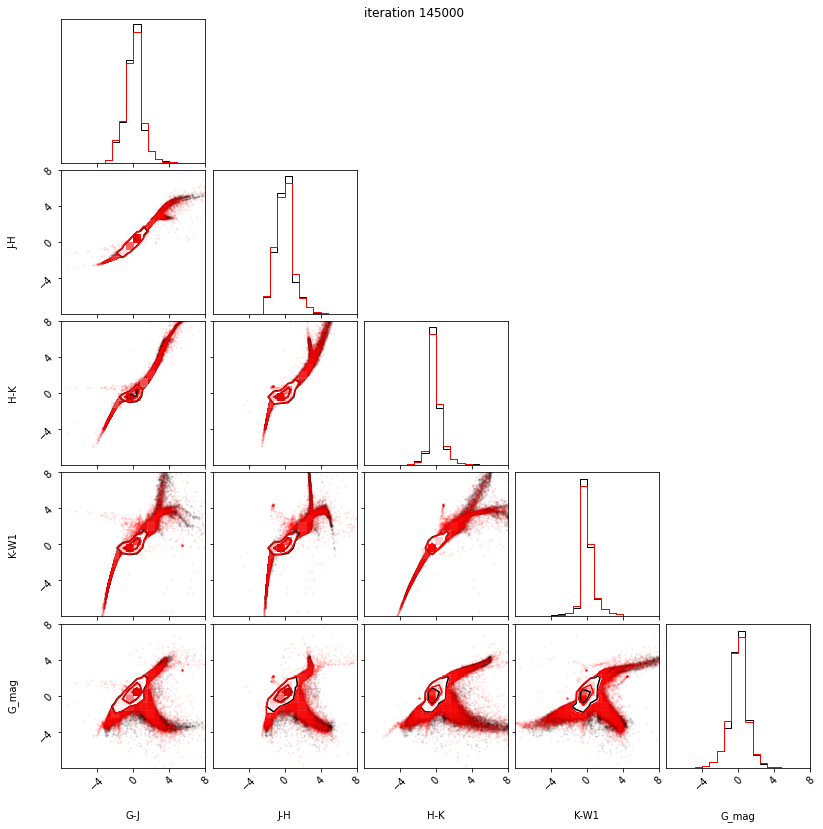

145100 -6.059147357940674 -6.199639797210693 0.20473098754882812 -inf
145200 -6.268913269042969 -6.323205947875977 0.1389622688293457 -inf
145300 -6.029874801635742 -6.053990364074707 0.14103078842163086 -inf
145400 -6.331328868865967 -6.342994213104248 0.11722564697265625 -inf
145500 -5.06834077835083 -5.615016460418701 -0.10491800308227539 -inf
145600 -6.108174800872803 -6.30061149597168 0.1485433578491211 -inf
145700 -5.863070964813232 -6.200038433074951 0.25916147232055664 -inf
145800 -3.5706939697265625 -3.8789358139038086 0.14913034439086914 -inf
145900 -6.345026969909668 -6.357875823974609 0.0851588249206543 -inf
146000 -6.177712917327881 -6.111449241638184 0.15483474731445312 -inf
0.15483474731445312 -inf


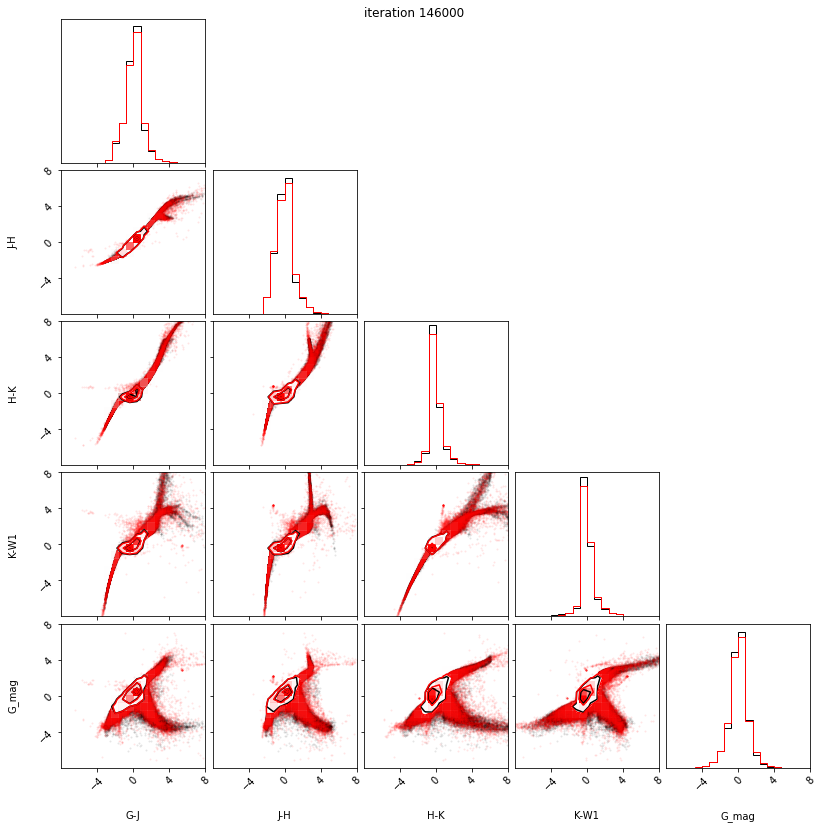

146100 -5.4722723960876465 -4.967275142669678 0.01793670654296875 -inf
146200 -5.539039611816406 -5.582939624786377 0.08569622039794922 -inf
146300 -6.0708513259887695 -6.330089569091797 0.1809678077697754 -inf
146400 -4.815989971160889 -5.119790077209473 0.22745466232299805 -inf
146500 -5.214114665985107 -5.63754415512085 0.26384735107421875 -inf
146600 -6.098644256591797 -6.052164554595947 0.06940555572509766 -inf
146700 -6.1882524490356445 -6.275797367095947 0.29571056365966797 -inf
146800 -6.322482109069824 -6.262734413146973 0.08869171142578125 -inf
146900 -6.32405424118042 -6.332695484161377 0.35875463485717773 -inf
147000 -5.958847522735596 -5.966636657714844 -0.007743358612060547 -inf
-0.007743358612060547 -inf


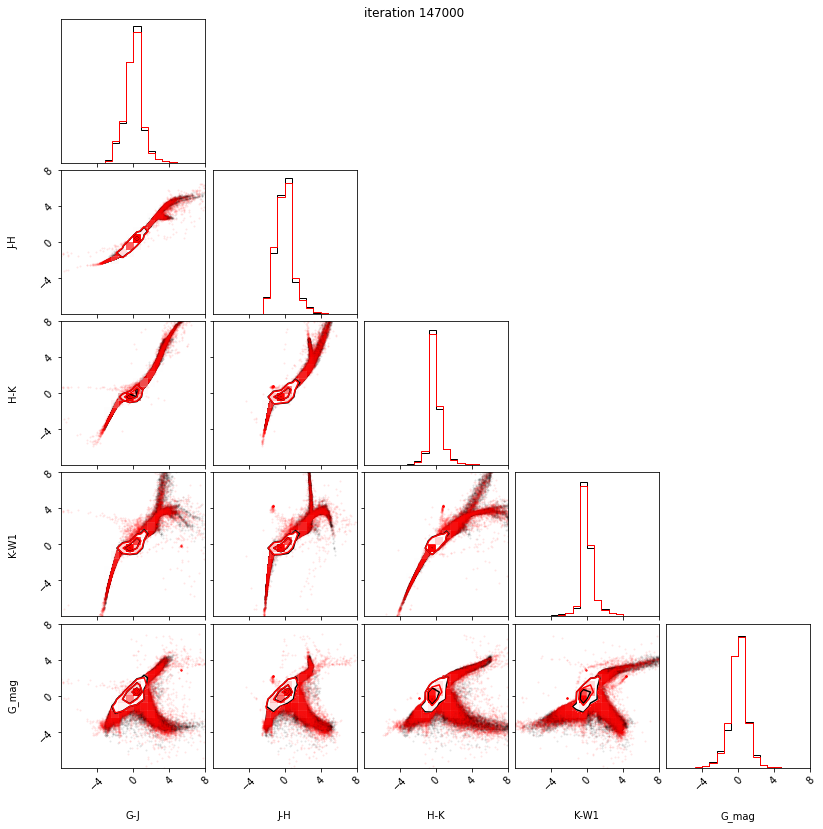

147100 -6.267119407653809 -6.270724773406982 -0.040531158447265625 -inf
147200 -6.147732734680176 -6.173783302307129 0.21498775482177734 -inf
147300 -6.172845363616943 -6.054759502410889 0.045546531677246094 -inf
147400 -6.116702079772949 -6.184858322143555 0.022506237030029297 -inf
147500 -6.1631975173950195 -5.978635787963867 0.2636432647705078 -inf
147600 -6.285419464111328 -6.261313438415527 0.266446590423584 -inf
147700 -6.126745700836182 -5.725454330444336 0.1774148941040039 -inf
147800 -6.376554489135742 -6.35394811630249 0.18910551071166992 -inf
147900 -6.315757751464844 -6.326413154602051 0.11809730529785156 -inf
148000 -6.377337455749512 -6.3829264640808105 0.2942180633544922 -inf
0.2942180633544922 -inf


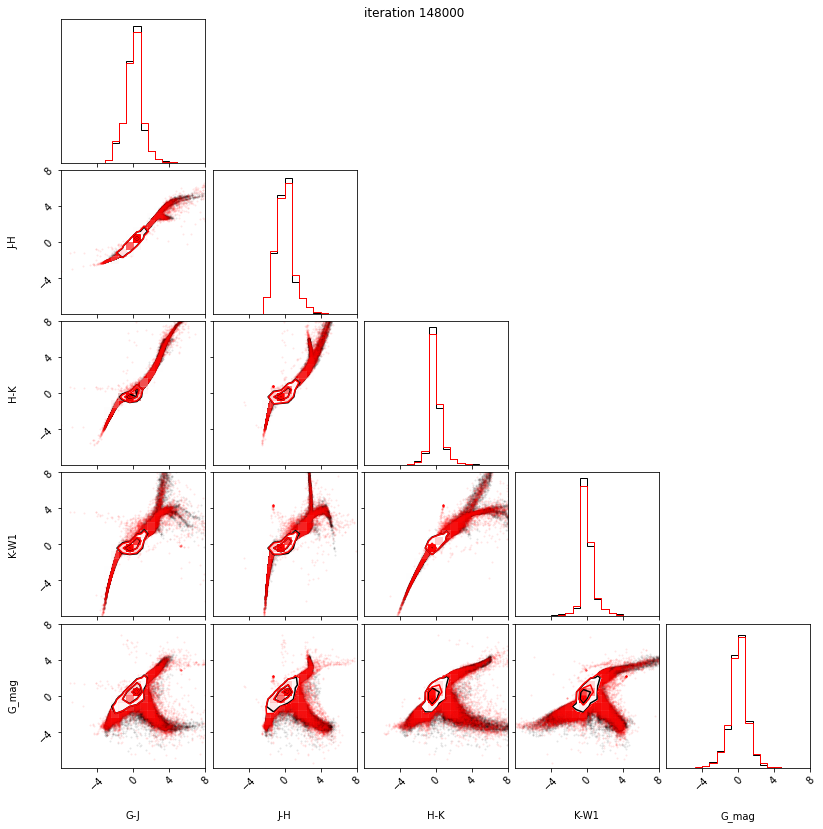

148100 -6.256397247314453 -6.2155232429504395 -0.0348663330078125 -inf
148200 -6.168802261352539 -6.277039051055908 -0.059871673583984375 -inf
148300 -6.27597188949585 -6.292707443237305 0.1411137580871582 -inf
148400 -6.284298896789551 -6.232860088348389 0.0804896354675293 -inf
148500 -6.28586483001709 -6.243101596832275 0.2124156951904297 -inf
148600 -6.275774955749512 -6.328432559967041 0.2751760482788086 -inf
148700 -6.112207412719727 -6.166245460510254 0.20453739166259766 -inf
148800 -6.215019702911377 -6.261759281158447 0.24763870239257812 -inf
148900 -5.559250831604004 -5.091442108154297 0.07661771774291992 -inf
149000 -5.888083457946777 -6.048139572143555 0.33393239974975586 -inf
0.33393239974975586 -inf


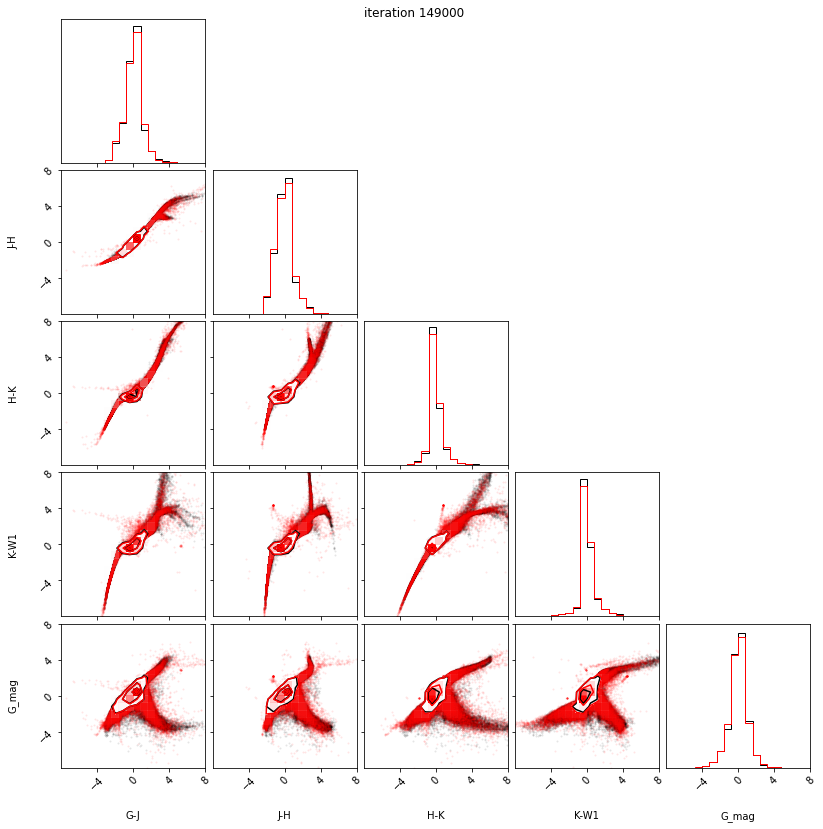

149100 -6.323247909545898 -6.315798282623291 -0.0017175674438476562 -inf
149200 -6.355185031890869 -6.340950012207031 0.3481564521789551 -inf
149300 -6.213198661804199 -6.212372303009033 0.0023965835571289062 -inf
149400 -6.2427449226379395 -6.282052993774414 0.008556842803955078 -inf
149500 -4.534139633178711 -5.980762958526611 0.05719947814941406 -inf
149600 -5.964010238647461 -5.923346519470215 0.035251617431640625 -inf
149700 -6.223240852355957 -6.162700653076172 -0.04914665222167969 -inf
149800 -6.254590034484863 -6.14664363861084 0.2949995994567871 -inf
149900 -6.331536769866943 -6.339926242828369 0.10385608673095703 -inf
150000 -6.273136615753174 -6.316228866577148 0.03378486633300781 -inf
0.03378486633300781 -inf


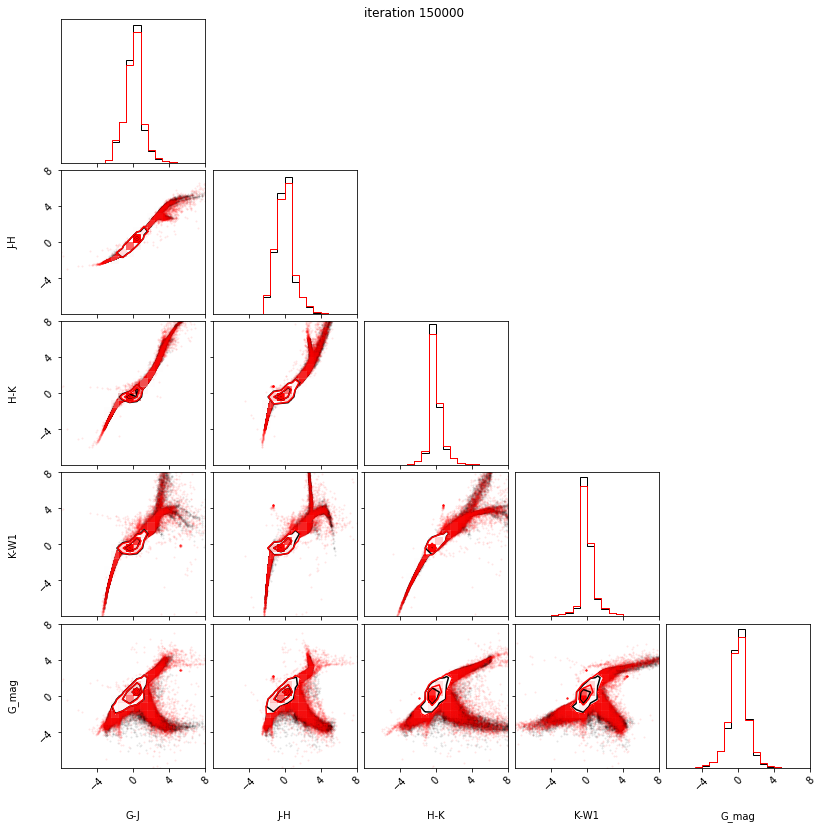

150100 -6.218718528747559 -6.257663726806641 -0.02443218231201172 -inf
150200 -6.388542175292969 -6.393336296081543 0.31916332244873047 -inf
150300 -5.859504222869873 -5.8010735511779785 -0.020249366760253906 -inf
150400 -5.813311576843262 -5.951481342315674 0.01146554946899414 -inf
150500 -6.336111545562744 -6.302181243896484 0.41745615005493164 -inf
150600 -6.38699197769165 -6.361249923706055 0.3370704650878906 -inf
150700 -5.907535552978516 -6.167154788970947 0.1374354362487793 -inf
150800 -6.203464031219482 -6.140576362609863 0.07525920867919922 -inf
150900 -6.095624923706055 -6.256470203399658 0.3482809066772461 -inf
151000 -6.135095596313477 -6.171905517578125 0.11517524719238281 -inf
0.11517524719238281 -inf


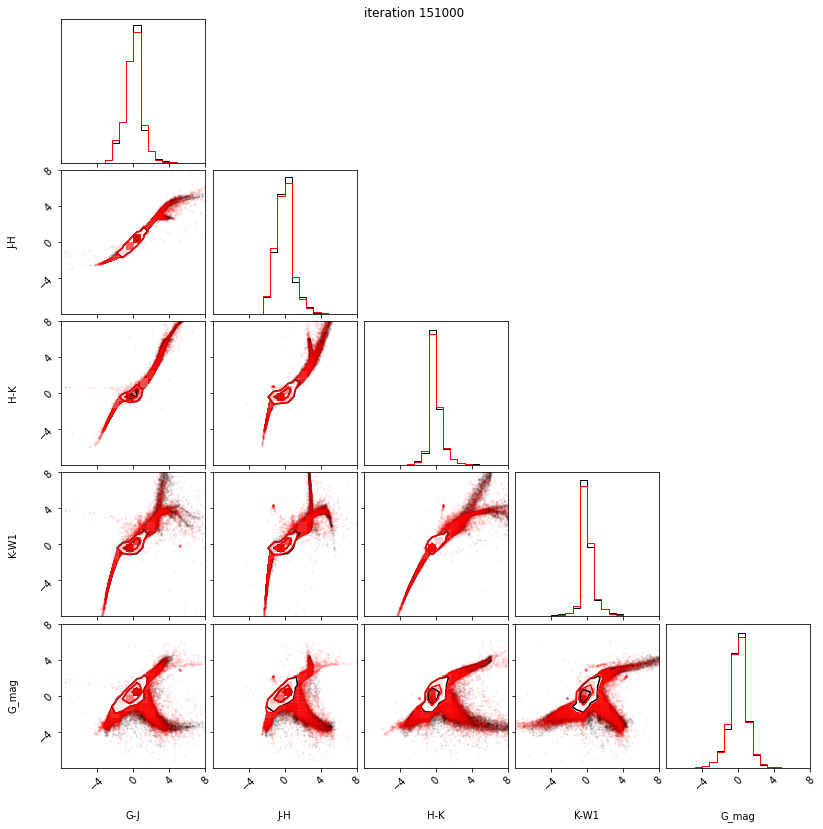

151100 -6.350485801696777 -5.970273494720459 0.2109818458557129 -inf
151200 -6.251245498657227 -6.248605728149414 -0.007906436920166016 -inf
151300 -6.09791374206543 -6.050843715667725 0.0608677864074707 -inf
151400 -6.123325824737549 -6.1810126304626465 0.06048107147216797 -inf
151500 -6.248656272888184 -5.889035701751709 0.3002471923828125 -inf
151600 -6.299120903015137 -6.044559955596924 0.4465312957763672 -inf
151700 -6.409237384796143 -6.229176044464111 0.29358911514282227 -inf
151800 -5.314968585968018 -4.978338718414307 0.1245875358581543 -inf
151900 -6.24122428894043 -6.147396564483643 0.3872828483581543 -inf
152000 -5.952946662902832 -5.794283390045166 0.16198968887329102 -inf
0.16198968887329102 -inf


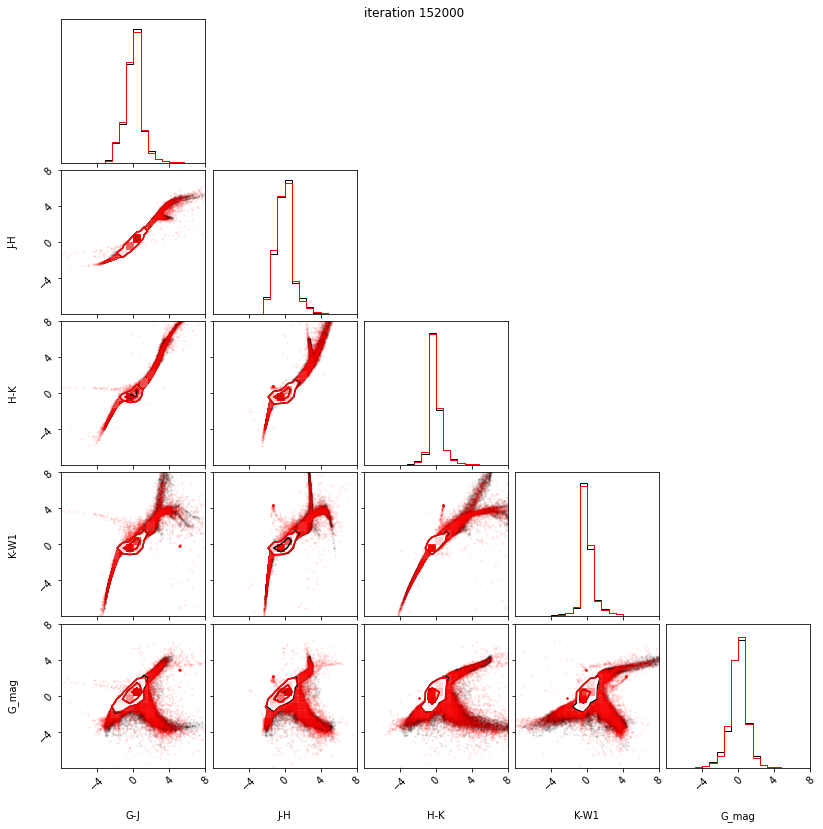

152100 -5.760589122772217 -5.566532611846924 0.34061431884765625 -inf
152200 -4.213519096374512 -4.260720729827881 0.5194602012634277 -inf
152300 -6.2027692794799805 -5.66488790512085 0.015236377716064453 -inf
152400 -5.3585357666015625 -6.048434734344482 0.15128564834594727 -inf
152500 -5.899585723876953 -5.758007526397705 0.1782999038696289 -inf
152600 -6.3271074295043945 -6.236087799072266 0.15349245071411133 -inf
152700 -5.875919342041016 -5.718482494354248 0.1340498924255371 -inf
152800 -5.938210964202881 -6.103036403656006 -0.09096479415893555 -inf
152900 -5.698663234710693 -5.752424240112305 0.42720890045166016 -inf
153000 -5.3852972984313965 -5.956874847412109 0.16720199584960938 -inf
0.16720199584960938 -inf


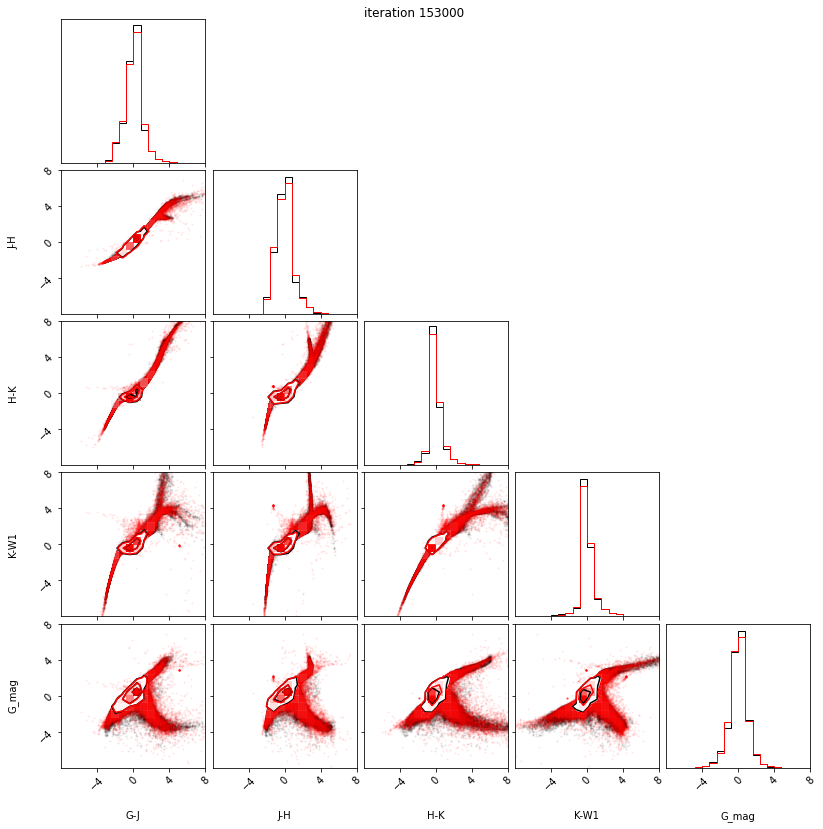

153100 -5.683925151824951 -5.635660648345947 0.22099590301513672 -inf
153200 -5.727872371673584 -6.205399036407471 0.24377918243408203 -inf
153300 -6.145082473754883 -5.727345943450928 0.1426534652709961 -inf
153400 -5.0969414710998535 -5.022763729095459 0.1791520118713379 -inf
153500 -6.221494197845459 -6.369376182556152 0.2079486846923828 -inf
153600 -5.52469539642334 -5.3449201583862305 0.03262901306152344 -inf
153700 -5.973617076873779 -5.397080898284912 0.3233938217163086 -inf
153800 -6.173277378082275 -6.272272109985352 0.009129047393798828 -inf
153900 -5.82840633392334 -5.477599143981934 0.558405876159668 -inf
154000 -6.311821937561035 -6.295971393585205 0.28966426849365234 -inf
0.28966426849365234 -inf


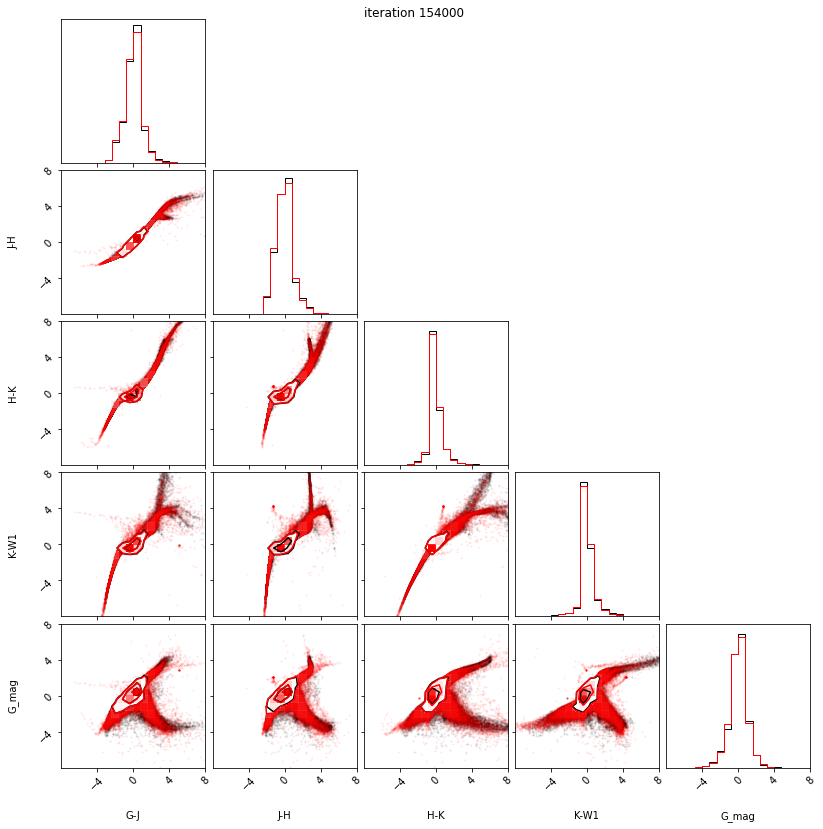

154100 -6.4232401847839355 -6.416393756866455 0.27223777770996094 -inf
154200 -6.104481220245361 -5.815629482269287 0.05617666244506836 -inf
154300 -6.034031867980957 -6.063666820526123 0.17772388458251953 -inf
154400 -6.137230396270752 -5.655797004699707 0.05216407775878906 -inf
154500 -6.227453708648682 -6.231569290161133 0.17545223236083984 -inf
154600 -5.947623252868652 -5.927760124206543 0.04213523864746094 -inf
154700 -6.111591815948486 -6.12506103515625 -0.20807504653930664 -inf
154800 -6.110770225524902 -6.0834832191467285 0.26353979110717773 -inf
154900 -6.2454328536987305 -6.142054557800293 0.3406333923339844 -inf
155000 -6.29277229309082 -6.247696876525879 0.1641225814819336 -inf
0.1641225814819336 -inf


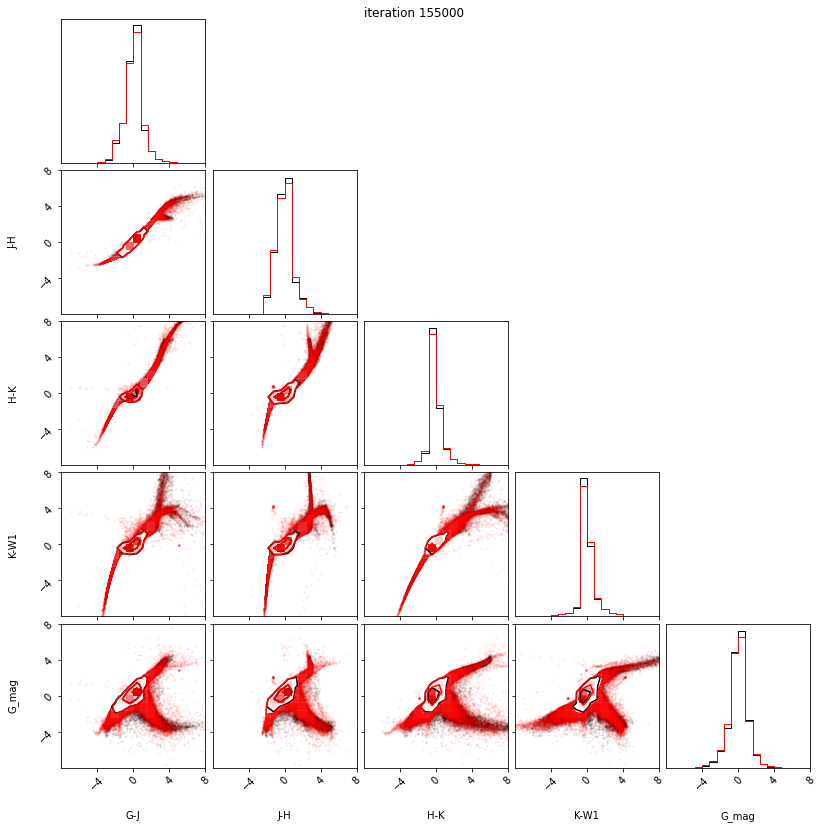

155100 -6.096493244171143 -5.78951358795166 -0.28345680236816406 -inf
155200 -6.3266191482543945 -6.226979732513428 0.22749042510986328 -inf
155300 -5.67953634262085 -5.254227161407471 -0.016053199768066406 -inf
155400 -5.859691619873047 -5.754940509796143 0.15780973434448242 -inf
155500 -6.06618595123291 -6.106960773468018 0.3516716957092285 -inf
155600 -5.544846534729004 -5.603384017944336 -0.30364513397216797 -inf
155700 -6.26878023147583 -6.122986793518066 0.22775602340698242 -inf
155800 -5.671234130859375 -5.5663957595825195 0.23676300048828125 -inf
155900 -4.812349796295166 -5.936585903167725 0.18979835510253906 -inf
156000 -5.797368049621582 -6.204739093780518 0.026420116424560547 -inf
0.026420116424560547 -inf


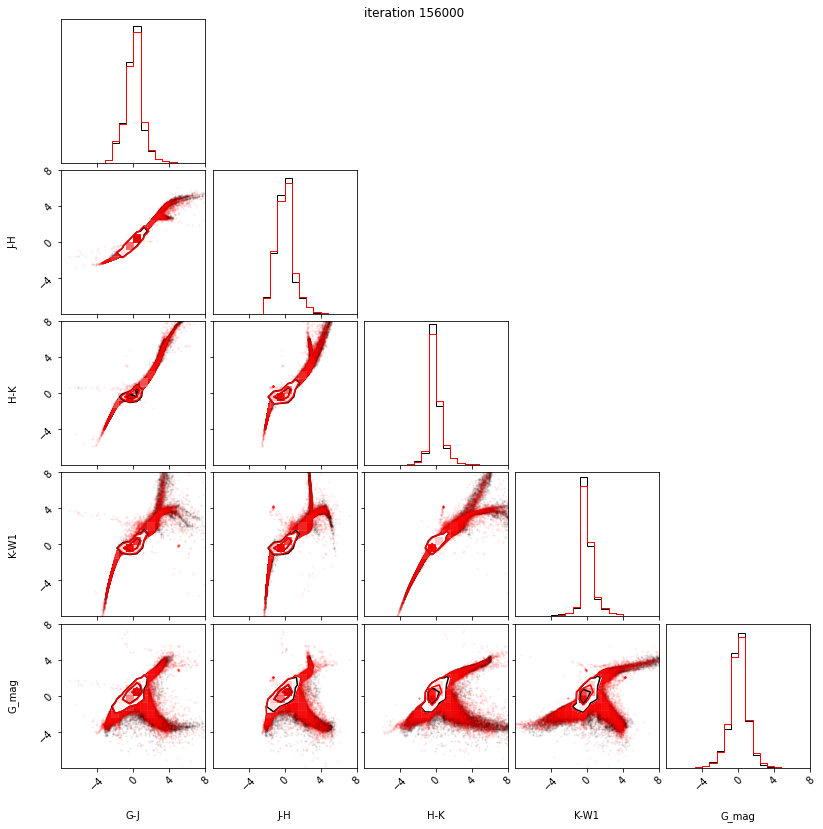

156100 -6.339236736297607 -5.547684669494629 0.40944528579711914 -inf
156200 -5.25139856338501 -5.662364482879639 -0.0672006607055664 -inf
156300 -5.613160133361816 -5.802220821380615 0.3217010498046875 -inf
156400 -6.325005531311035 -6.3815178871154785 0.21845340728759766 -inf
156500 -6.413844108581543 -6.413460731506348 0.09424161911010742 -inf
156600 -6.274537563323975 -6.296011924743652 0.18620538711547852 -inf
156700 -5.757021903991699 -5.5616254806518555 0.2815084457397461 -inf
156800 -6.147216320037842 -6.119309425354004 0.037550926208496094 -inf
156900 -6.168835639953613 -6.0742506980896 0.27586841583251953 -inf
157000 -6.045006275177002 -6.154725074768066 0.23328399658203125 -inf
0.23328399658203125 -inf


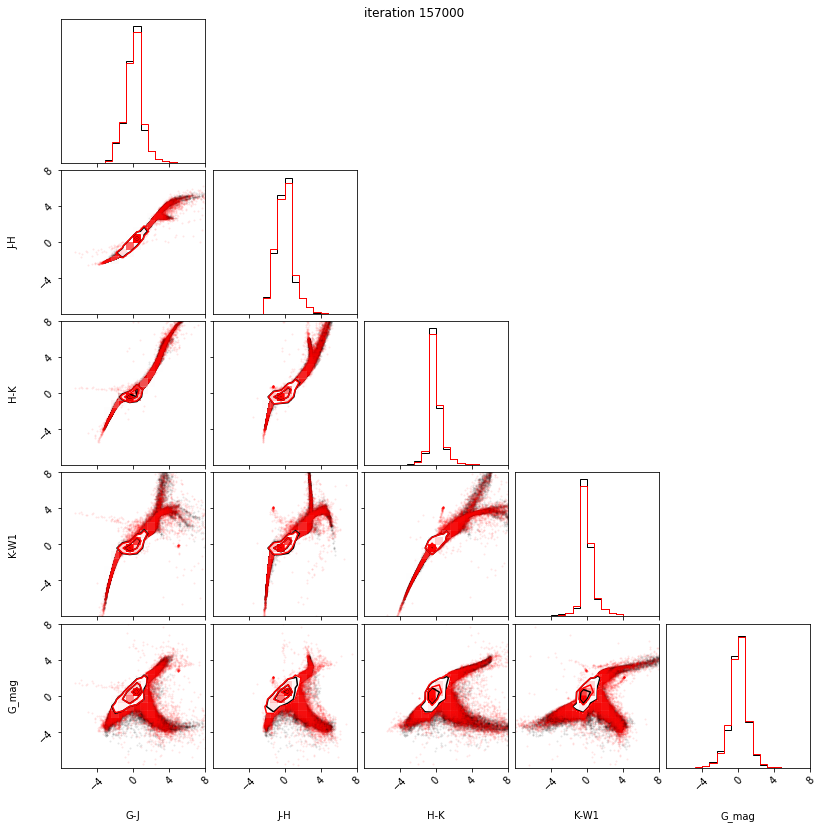

157100 -6.038339138031006 -6.144456386566162 0.29676008224487305 -inf
157200 -5.952245712280273 -5.619786262512207 0.18478965759277344 -inf
157300 -5.501413345336914 -6.098227024078369 0.37261199951171875 -inf
157400 -6.042219161987305 -6.199324131011963 0.06328105926513672 -inf
157500 -5.951303482055664 -5.950991153717041 -0.31279563903808594 -inf
157600 -5.914814472198486 -6.118629455566406 -0.025006771087646484 -inf
157700 -6.1372761726379395 -5.9256391525268555 0.18616342544555664 -inf
157800 -6.007028579711914 -5.750668525695801 0.2075505256652832 -inf
157900 -4.95656681060791 -5.924455165863037 -0.24065923690795898 -inf
158000 -6.083792209625244 -6.2867817878723145 0.1602325439453125 -inf
0.1602325439453125 -inf


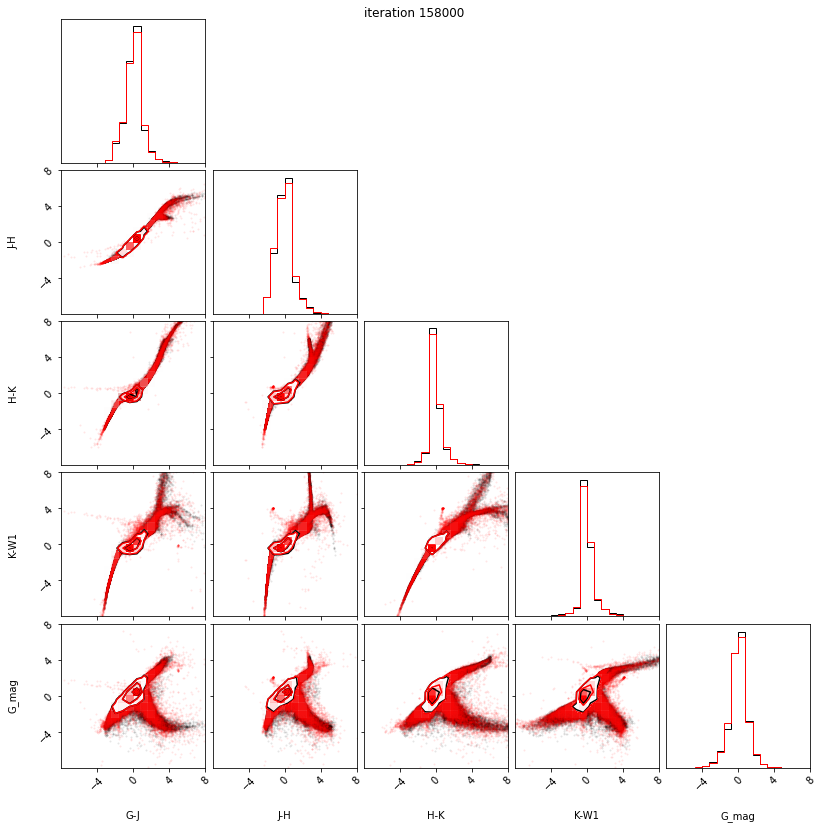

158100 -5.427042007446289 -4.768278121948242 0.46378374099731445 -inf
158200 -6.339404106140137 -6.3004021644592285 0.25286197662353516 -inf
158300 -6.292410373687744 -6.298381805419922 0.16762256622314453 -inf
158400 -6.356276035308838 -6.328238487243652 -0.0090484619140625 -inf
158500 -6.339056015014648 -6.15831995010376 0.12550830841064453 -inf
158600 -6.4022603034973145 -6.325606822967529 0.014157295227050781 -inf
158700 -6.367088317871094 -6.321369171142578 0.2608675956726074 -inf
158800 -5.938115119934082 -5.945984840393066 -0.09881782531738281 -inf
158900 -5.063558578491211 -5.610467910766602 -0.02742481231689453 -inf
159000 -5.818413734436035 -5.750974655151367 0.3600344657897949 -inf
0.3600344657897949 -inf


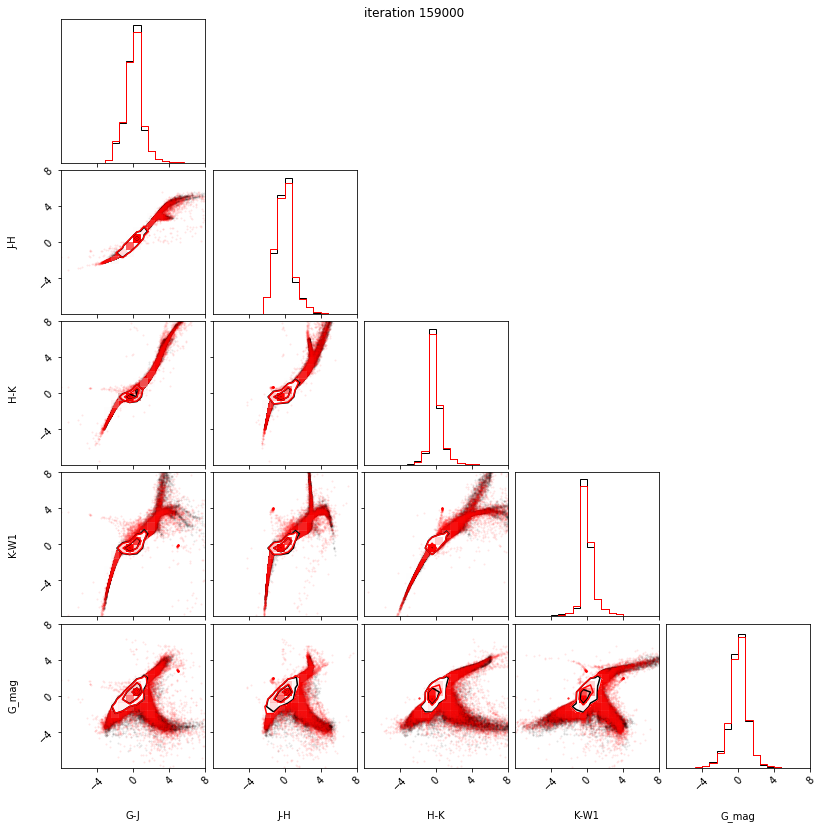

159100 -5.835146903991699 -6.017180919647217 -0.3143596649169922 -inf
159200 -6.162961006164551 -6.311412811279297 0.29999208450317383 -inf
159300 -6.193152904510498 -5.852426052093506 0.3855552673339844 -inf
159400 -6.376023292541504 -6.383749485015869 0.18593835830688477 -inf
159500 -6.207020282745361 -6.131646156311035 0.0017881393432617188 -inf
159600 -6.399609565734863 -6.354948043823242 0.03676414489746094 -inf
159700 -6.034804344177246 -6.046455383300781 -0.10843515396118164 -inf
159800 -6.225736618041992 -6.31160831451416 -0.03394317626953125 -inf
159900 -6.3198981285095215 -6.367486000061035 0.13266658782958984 -inf
160000 -5.701303482055664 -5.705560207366943 0.2681879997253418 -inf
0.2681879997253418 -inf


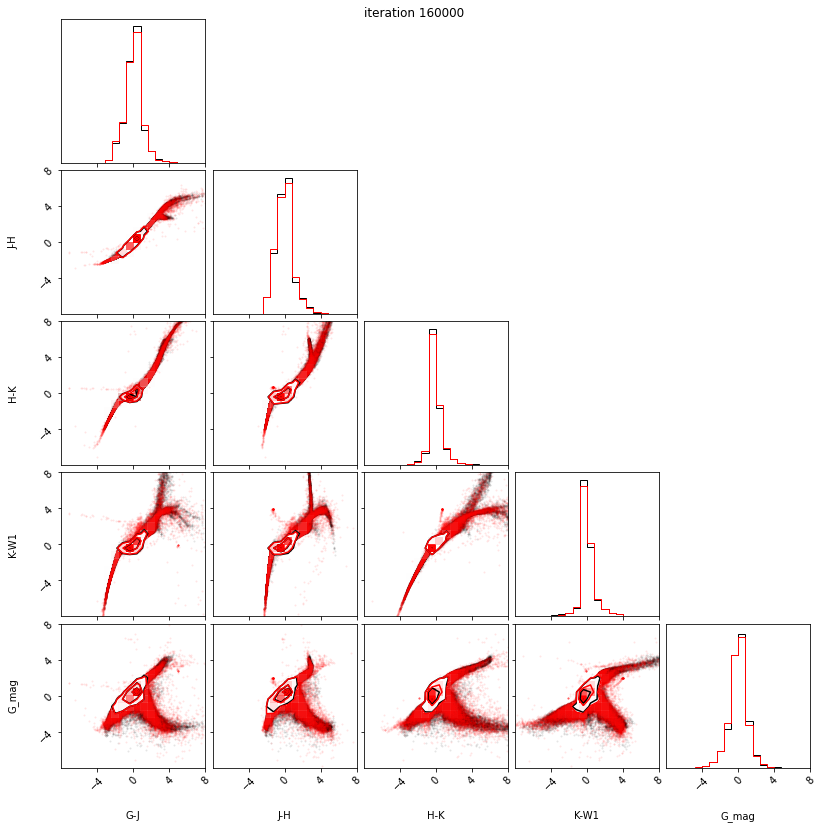

160100 -6.072505950927734 -6.334752082824707 0.06012439727783203 -inf
160200 -6.043161392211914 -5.667931079864502 -0.14720726013183594 -inf
160300 -6.31199836730957 -6.317368507385254 0.031617164611816406 -inf
160400 -5.026485443115234 -5.374496936798096 -0.02837657928466797 -inf
160500 -4.64500617980957 -5.268759727478027 0.06429147720336914 -inf
160600 -4.887807846069336 -4.239816188812256 0.2347278594970703 -inf
160700 -6.442896366119385 -6.44613790512085 -0.12529563903808594 -inf
160800 -6.087286472320557 -6.297692775726318 -0.04549360275268555 -inf
160900 -6.350817680358887 -6.336707592010498 -0.07155084609985352 -inf
161000 -6.067855358123779 -6.111556053161621 -0.06328201293945312 -inf
-0.06328201293945312 -inf


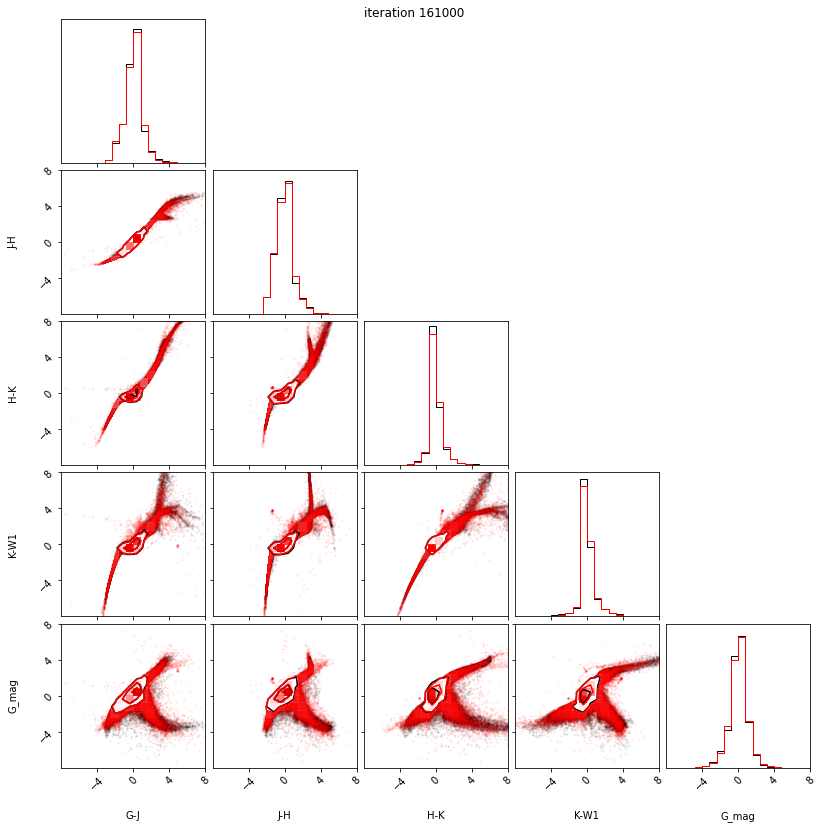

161100 -6.302520275115967 -6.331150054931641 -0.047602176666259766 -inf
161200 -6.282230854034424 -5.679760932922363 0.3093876838684082 -inf
161300 -5.583938121795654 -6.022137641906738 -0.027307510375976562 -inf
161400 -6.257214546203613 -6.321104526519775 0.0929117202758789 -inf
161500 -6.4488396644592285 -6.459213733673096 -0.13779211044311523 -inf
161600 -6.439056873321533 -6.374545097351074 -0.2771453857421875 -inf
161700 -5.9118804931640625 -5.937504768371582 -0.13063669204711914 -inf
161800 -6.185966968536377 -6.1720290184021 0.2478618621826172 -inf
161900 -6.0793023109436035 -6.114624977111816 0.12365436553955078 -inf
162000 -6.163734436035156 -5.957361698150635 0.1829061508178711 -inf
0.1829061508178711 -inf


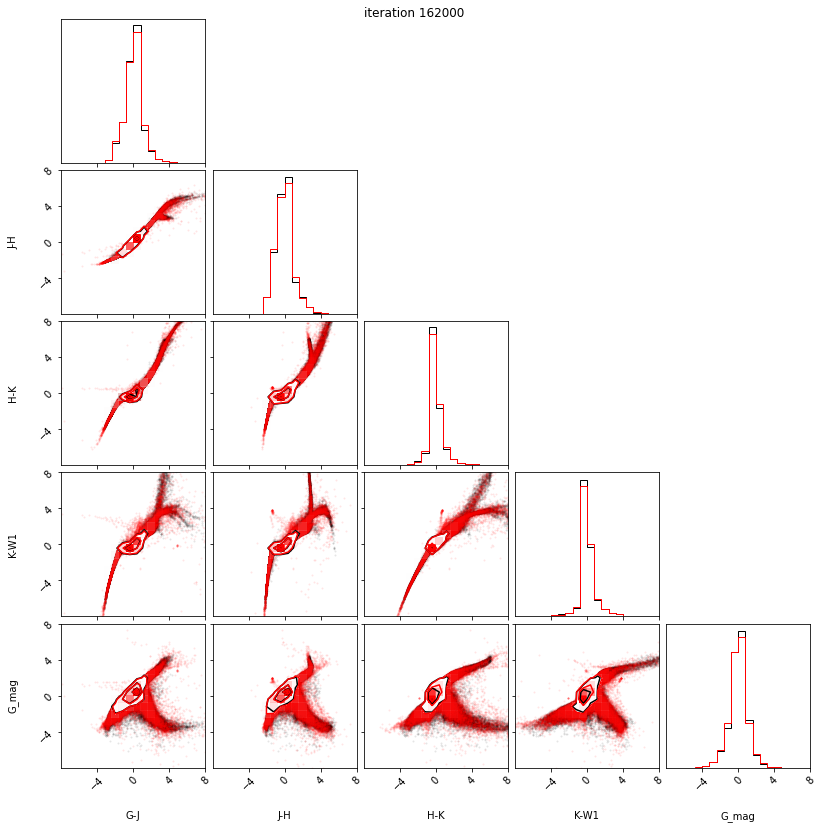

162100 -6.314002990722656 -6.308043003082275 -0.23122406005859375 -inf
162200 -5.850484371185303 -5.915757656097412 0.011479377746582031 -inf
162300 -6.068349838256836 -6.105435848236084 -0.018416881561279297 -inf
162400 -6.303384304046631 -6.280181884765625 -0.12204313278198242 -inf
162500 -6.368279933929443 -6.4123029708862305 -0.04480886459350586 -inf
162600 -6.233310222625732 -6.320483207702637 -0.15369319915771484 -inf
162700 -5.982377052307129 -5.750482559204102 0.04574298858642578 -inf
162800 -6.320943832397461 -6.348595142364502 -0.11613178253173828 -inf
162900 -6.234093189239502 -6.164811611175537 0.15351343154907227 -inf
163000 -6.0030670166015625 -6.036143779754639 -0.2649569511413574 -inf
-0.2649569511413574 -inf


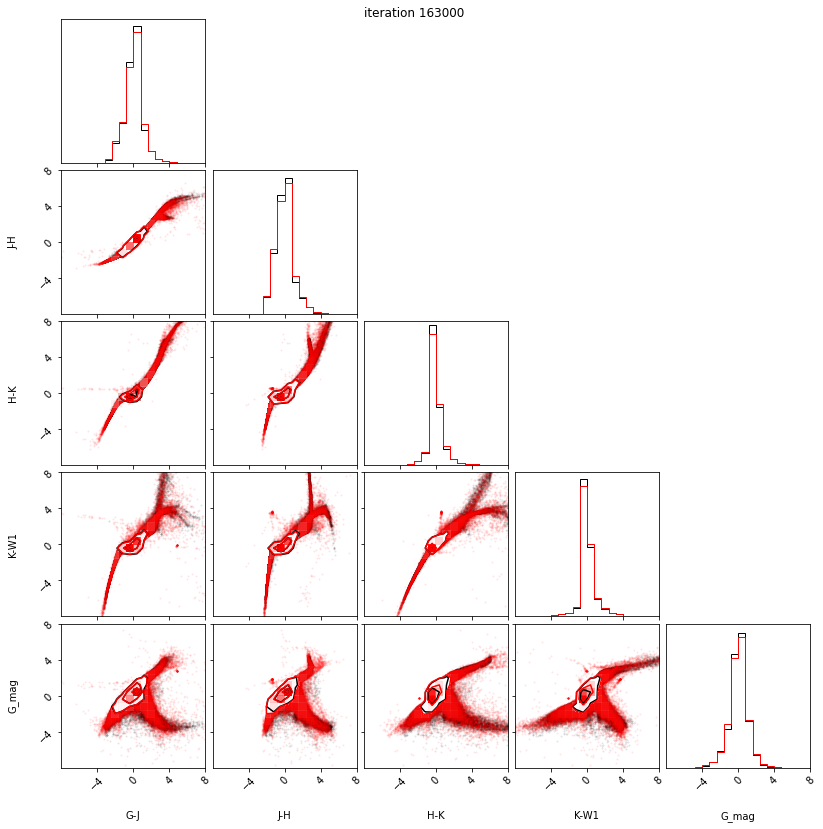

163100 -5.60905647277832 -2.7009940147399902 0.1219778060913086 -inf
163200 -5.768195152282715 -5.738834381103516 0.3752784729003906 -inf
163300 -5.717382431030273 -6.024912357330322 -0.01586627960205078 -inf
163400 -6.3685455322265625 -6.361419200897217 -0.19490718841552734 -inf
163500 -6.320345878601074 -6.336069583892822 -0.38649797439575195 -inf
163600 -6.310948371887207 -6.406848907470703 -0.12717866897583008 -inf
163700 -6.327432155609131 -6.409773349761963 0.009590625762939453 -inf
163800 -6.093157768249512 -6.025445461273193 0.12958192825317383 -inf
163900 -6.061054706573486 -6.123100280761719 0.04779052734375 -inf
164000 -5.267258644104004 -5.406183242797852 -0.44941234588623047 -inf
-0.44941234588623047 -inf


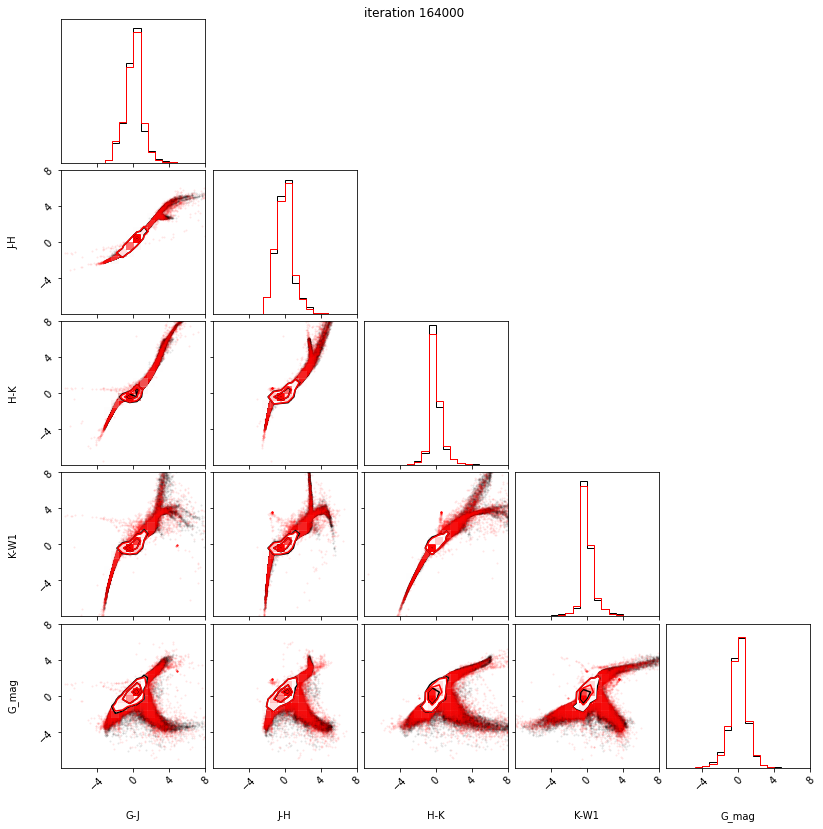

164100 -6.324472904205322 -6.293796062469482 -0.26739501953125 -inf
164200 -5.701223373413086 -5.618881702423096 0.26125288009643555 -inf
164300 -5.606121063232422 -5.938523769378662 0.005898952484130859 -inf
164400 -6.093947887420654 -5.142539024353027 0.2261524200439453 -inf
164500 -5.614384174346924 -5.783341884613037 -0.39088869094848633 -inf
164600 -6.003437042236328 -5.5111308097839355 0.35868167877197266 -inf
164700 -5.745741367340088 -5.656680583953857 0.061921119689941406 -inf
164800 -5.180393695831299 -5.778481960296631 0.4325904846191406 -inf
164900 -5.678914546966553 -5.851338863372803 -0.1744670867919922 -inf
165000 -5.864284038543701 -5.980538368225098 0.04648876190185547 -inf
0.04648876190185547 -inf


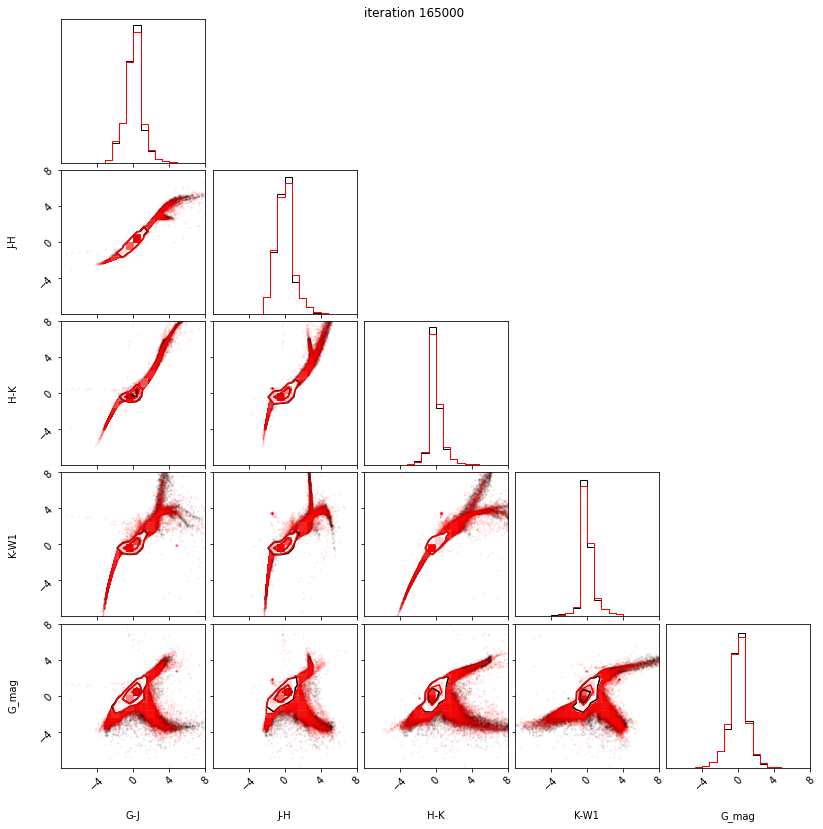

165100 -3.4799158573150635 -4.486950874328613 -0.2119579315185547 -inf
165200 -5.7023210525512695 -6.035942077636719 0.24126338958740234 -inf
165300 -6.110506057739258 -6.308807849884033 -0.14794921875 -inf
165400 -6.178077220916748 -6.166705131530762 -0.10021066665649414 -inf
165500 -6.267131805419922 -6.331226348876953 -0.5505995750427246 -inf
165600 -6.318013668060303 -6.350941181182861 -0.26911163330078125 -inf
165700 -6.230699062347412 -6.249843120574951 0.16867876052856445 -inf
165800 -6.44898796081543 -6.447579383850098 -0.14194488525390625 -inf
165900 -6.361024856567383 -6.2473015785217285 -0.3513655662536621 -inf
166000 -6.119961738586426 -5.889035224914551 -0.3673863410949707 -inf
-0.3673863410949707 -inf


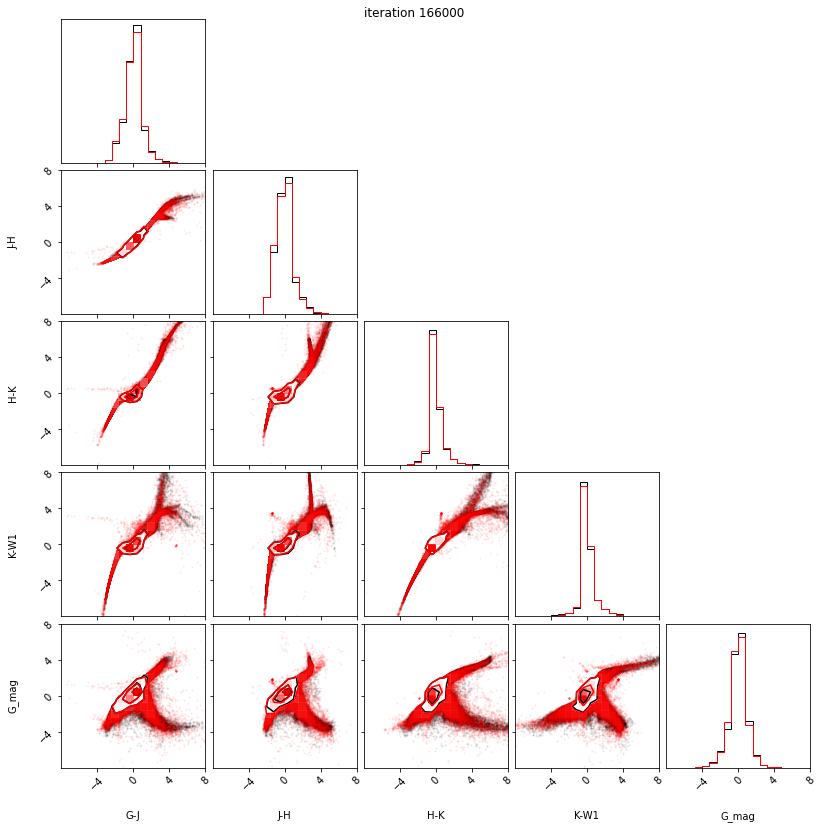

166100 -6.360408306121826 -6.3623881340026855 0.027213096618652344 -inf
166200 -6.0427656173706055 -6.265697956085205 -0.45040416717529297 -inf
166300 -5.691876411437988 -5.997276306152344 -0.09587383270263672 -inf
166400 -5.720759868621826 -6.013704299926758 -0.2744889259338379 -inf
166500 -6.031843185424805 -5.562310218811035 0.3111295700073242 -inf
166600 -6.425710201263428 -6.441547870635986 -0.05217742919921875 -inf
166700 -6.3827433586120605 -6.414411544799805 -0.020470619201660156 -inf
166800 -2.0564169883728027 -4.947131156921387 -0.02772998809814453 -inf
166900 -6.28195858001709 -5.758841514587402 -0.004501819610595703 -inf
167000 -5.497573375701904 -4.820338726043701 -0.23000526428222656 -inf
-0.23000526428222656 -inf


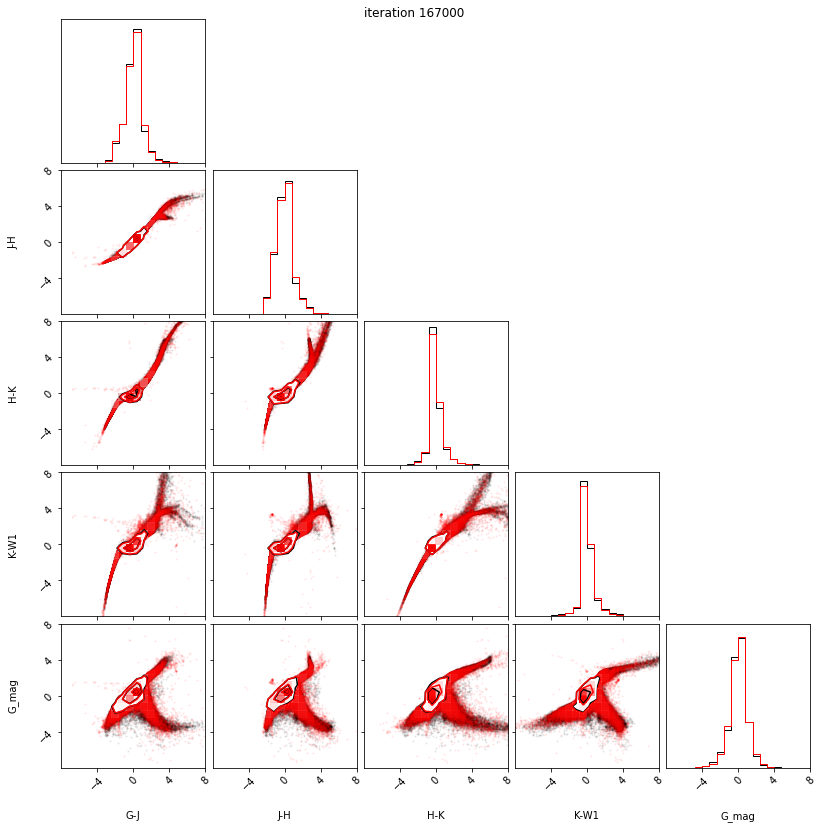

167100 -6.40245246887207 -6.410501956939697 -0.2830495834350586 -inf
167200 -5.54152250289917 -6.216561794281006 -0.01662588119506836 -inf
167300 -6.37672758102417 -6.099893569946289 -0.013495922088623047 -inf
167400 -5.786845684051514 -4.563093662261963 0.023021697998046875 -inf
167500 -5.804413318634033 -5.566039085388184 -0.3734159469604492 -inf
167600 -6.178447723388672 -6.089466094970703 -0.08156728744506836 -inf
167700 -6.209219932556152 -6.270578861236572 -0.12446308135986328 -inf
167800 -6.359284400939941 -6.405824184417725 -0.34514760971069336 -inf
167900 -4.960482597351074 -5.9195685386657715 0.028525829315185547 -inf
168000 -5.787593841552734 -4.097837924957275 0.14272308349609375 -inf
0.14272308349609375 -inf


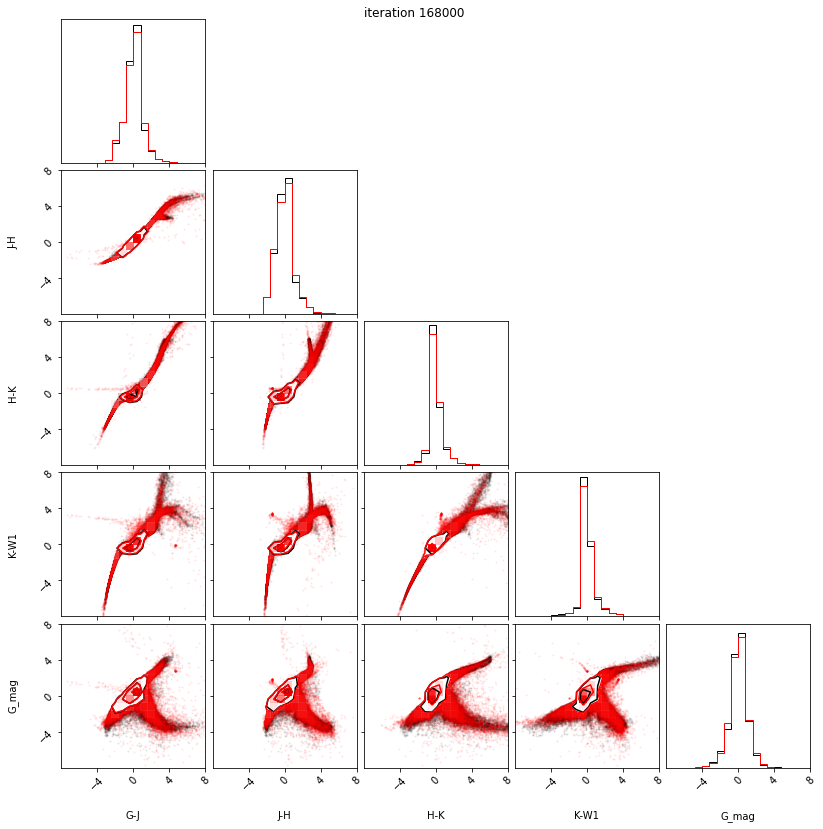

168100 -5.966081142425537 -6.22791862487793 0.09990596771240234 -inf
168200 -6.092317581176758 -6.306840419769287 0.20287847518920898 -inf
168300 -5.830286026000977 -5.935606002807617 0.004291057586669922 -inf
168400 -6.331625461578369 -6.401455879211426 -0.3306431770324707 -inf
168500 -6.391523361206055 -6.408868789672852 -0.36498165130615234 -inf
168600 -6.397631645202637 -6.327800750732422 -0.1387181282043457 -inf
168700 -6.040279388427734 -5.551772594451904 -0.03535747528076172 -inf
168800 -6.3010358810424805 -6.330227851867676 -0.08645391464233398 -inf
168900 -5.650158405303955 -3.8696861267089844 -0.04482889175415039 -inf
169000 -5.96724271774292 -6.110231876373291 -0.17371082305908203 -inf
-0.17371082305908203 -inf


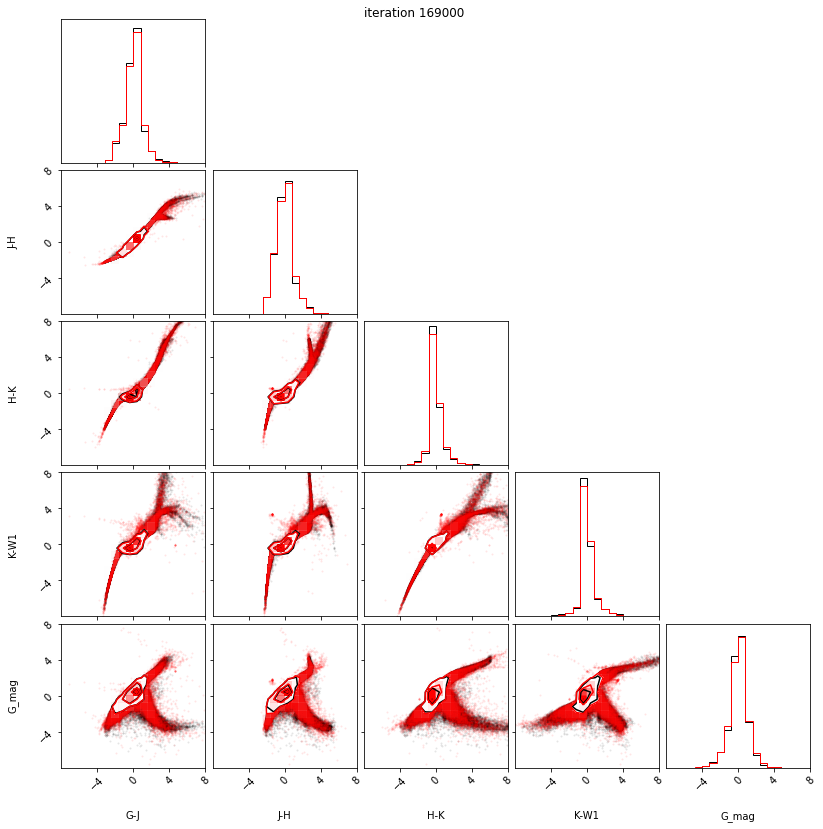

169100 -6.433529853820801 -6.430266380310059 -0.20494651794433594 -inf
169200 -5.957180500030518 -6.037112712860107 -0.013597965240478516 -inf
169300 -6.1984639167785645 -6.070145130157471 -0.08336305618286133 -inf
169400 -6.175901412963867 -6.237244606018066 -0.13036584854125977 -inf
169500 -5.576406002044678 -5.929356575012207 -0.11549615859985352 -inf
169600 -5.774882793426514 -5.906576633453369 -0.07434654235839844 -inf
169700 -6.088231086730957 -6.045200824737549 0.005745887756347656 -inf
169800 -6.176440238952637 -6.046988010406494 -0.1739501953125 -inf
169900 -6.060629844665527 -5.498798847198486 -0.11605978012084961 -inf
170000 -6.337289333343506 -6.104933738708496 -0.15234994888305664 -inf
-0.15234994888305664 -inf


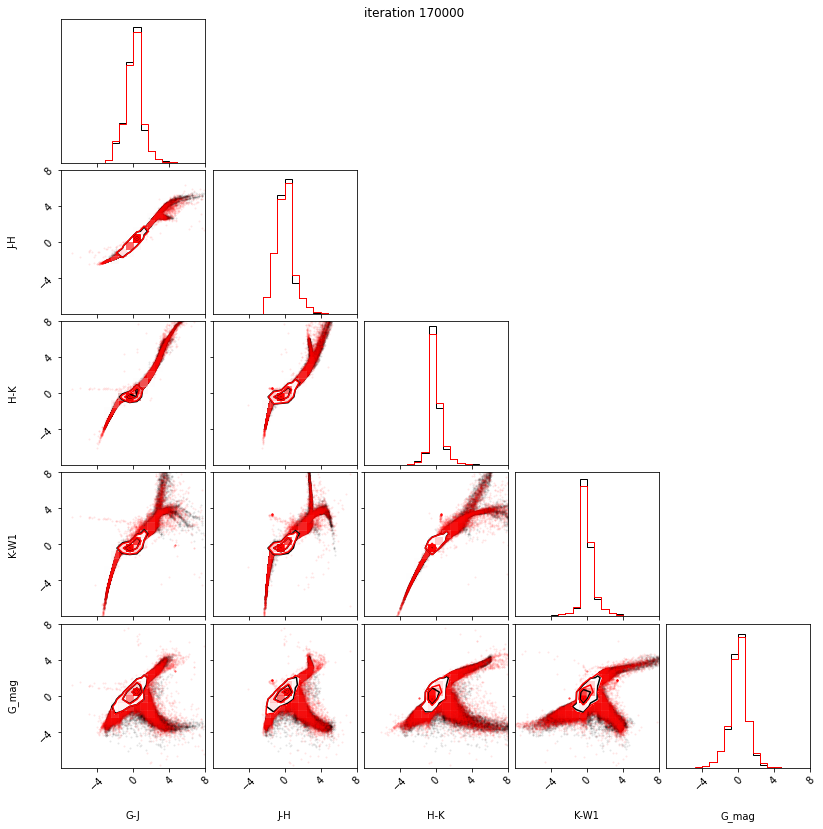

170100 -5.487693786621094 -5.075150012969971 0.09609603881835938 -inf
170200 -5.831931114196777 -6.1023125648498535 -0.5732517242431641 -inf
170300 -6.123639106750488 -5.790192604064941 -0.2277364730834961 -inf
170400 -6.352357864379883 -6.420358657836914 0.06542301177978516 -inf
170500 -6.111219882965088 -6.295997619628906 -0.35895299911499023 -inf
170600 -6.310251235961914 -6.132274627685547 0.19427013397216797 -inf
170700 -5.541267395019531 -5.700806617736816 0.1684107780456543 -inf
170800 -4.647709846496582 -4.520727157592773 -0.31290674209594727 -inf
170900 -5.48051643371582 -6.063990116119385 0.32102012634277344 -inf
171000 -6.432226657867432 -6.452739715576172 -0.046436309814453125 -inf
-0.046436309814453125 -inf


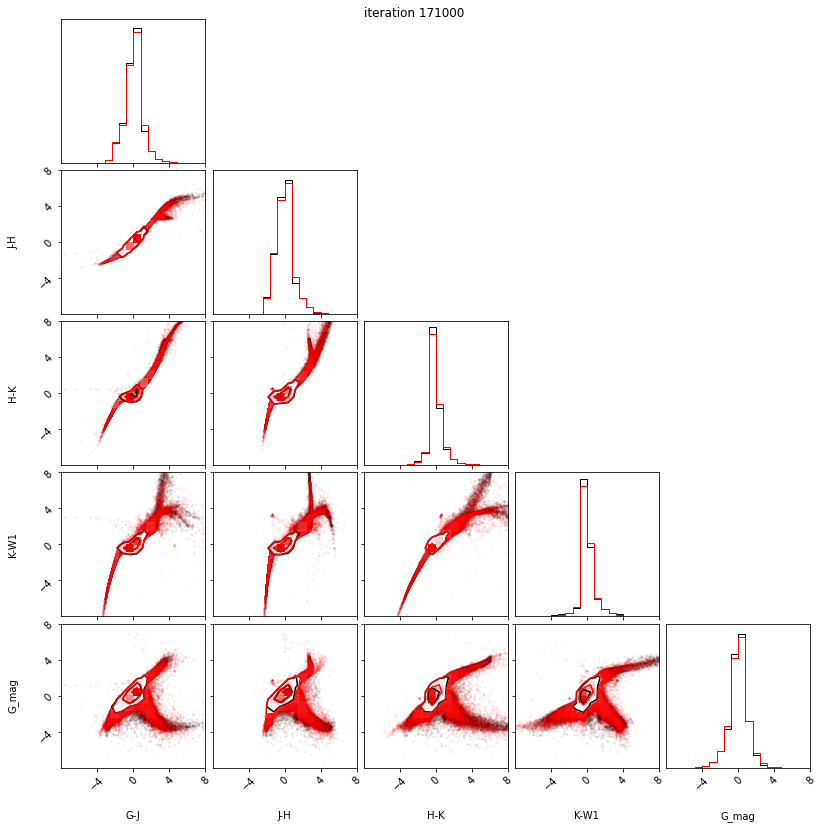

171100 -5.733454704284668 -5.789106845855713 0.17265605926513672 -inf
171200 -5.826244354248047 -5.89302921295166 0.14656972885131836 -inf
171300 -6.0834832191467285 -6.376493453979492 -0.31484127044677734 -inf
171400 -5.936433792114258 -5.910292148590088 -0.007068634033203125 -inf
171500 -4.978809833526611 -5.352606773376465 -0.6948981285095215 -inf
171600 -6.4708476066589355 -6.336728572845459 0.013195514678955078 -inf
171700 -6.049678802490234 -6.160752773284912 -0.12166452407836914 -inf
171800 -6.1031341552734375 -6.151265621185303 -0.6973838806152344 -inf
171900 -5.960594177246094 -5.96422815322876 -0.41528844833374023 -inf
172000 -6.339747428894043 -6.197551250457764 -0.078582763671875 -inf
-0.078582763671875 -inf


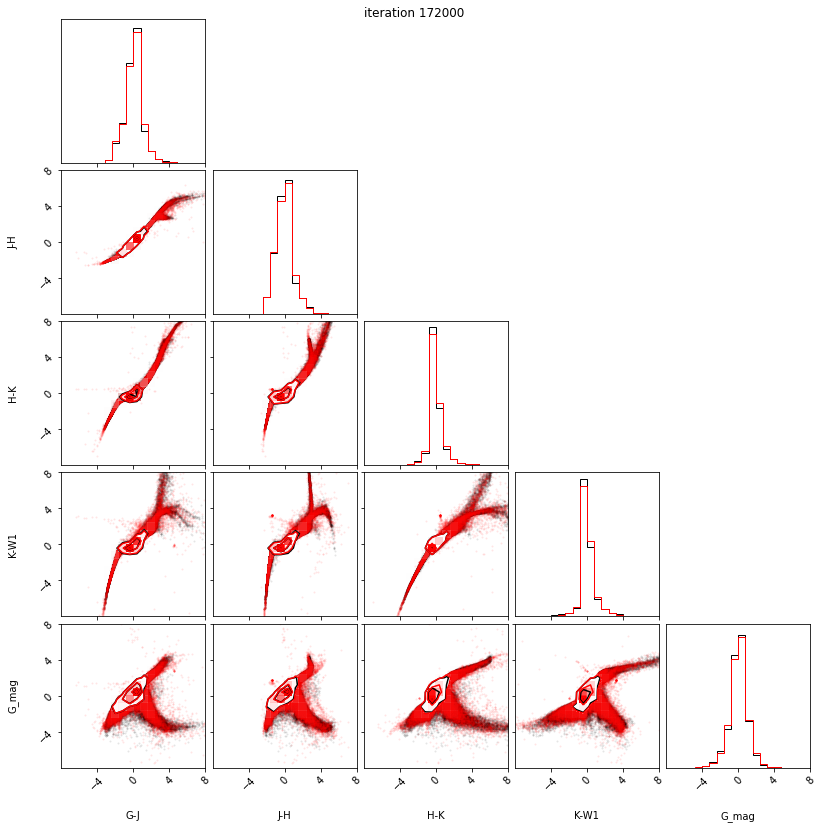

172100 -6.295081615447998 -5.389752388000488 0.029691696166992188 -inf
172200 -6.155313014984131 -6.202889919281006 -0.23234176635742188 -inf
172300 -6.375792980194092 -6.350216865539551 -0.38611316680908203 -inf
172400 -6.246854305267334 -5.954161167144775 -0.0551915168762207 -inf
172500 -6.096027374267578 -6.014477252960205 -0.06851530075073242 -inf
172600 -5.697421550750732 -5.811376571655273 0.48551321029663086 -inf
172700 -6.022847652435303 -5.540248394012451 -0.07464456558227539 -inf
172800 -6.382460594177246 -6.332878112792969 -0.2272500991821289 -inf
172900 -5.725762844085693 -5.274129867553711 0.04032325744628906 -inf
173000 -5.7414655685424805 -5.371376037597656 0.016674518585205078 -inf
0.016674518585205078 -inf


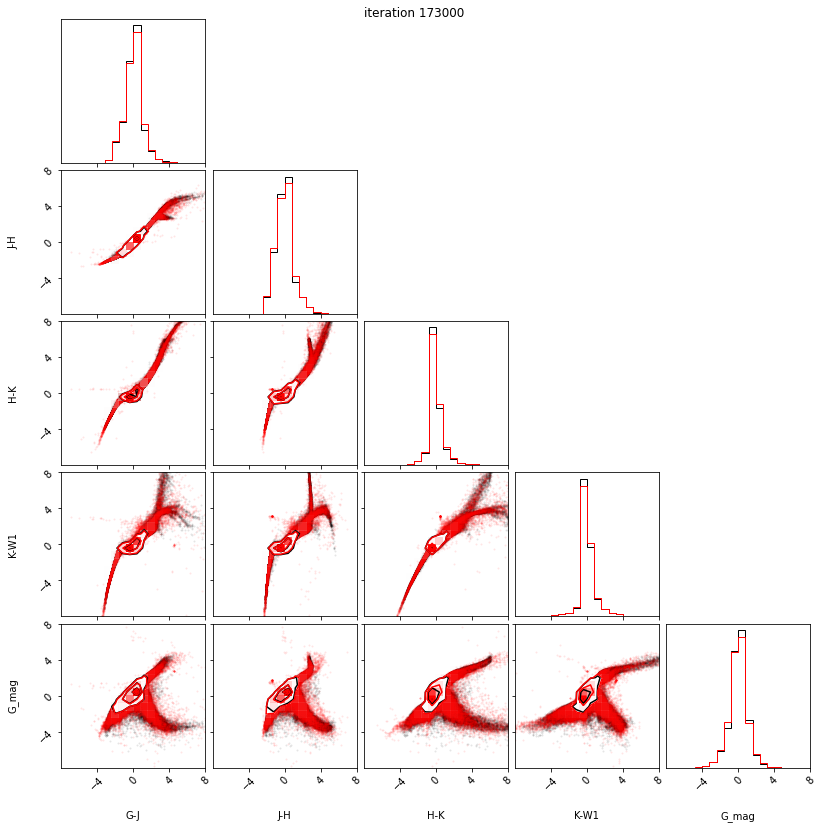

173100 -5.4060959815979 -4.280555248260498 0.09554624557495117 -inf
173200 -6.299376964569092 -6.319826602935791 -0.12106466293334961 -inf
173300 -6.411078929901123 -6.345396518707275 -0.11675882339477539 -inf
173400 -6.0831170082092285 -6.273372650146484 0.010759830474853516 -inf
173500 -6.39147424697876 -6.398202419281006 -0.2949357032775879 -inf
173600 -6.313218593597412 -6.052951812744141 -0.0967092514038086 -inf
173700 -4.458538055419922 -4.20751953125 -0.081512451171875 -inf
173800 -6.277289390563965 -6.1142988204956055 0.005389213562011719 -inf
173900 -6.433744430541992 -6.439484596252441 -0.03525590896606445 -inf
174000 -5.877065658569336 -4.494079113006592 0.0038285255432128906 -inf
0.0038285255432128906 -inf


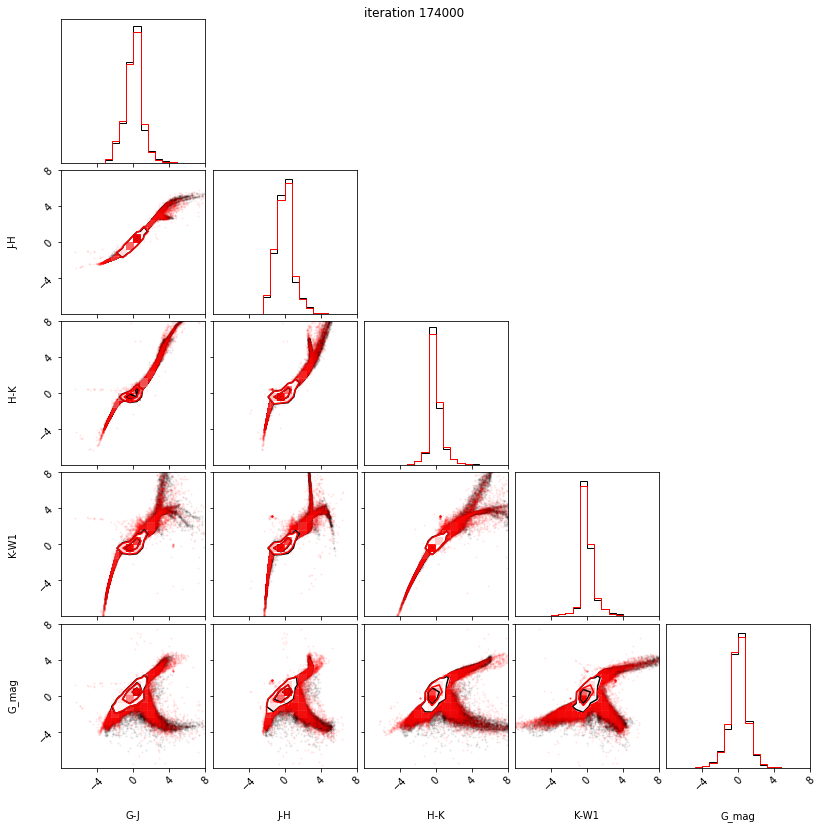

174100 -6.26508903503418 -6.3362250328063965 -0.2112751007080078 -inf
174200 -6.376298427581787 -6.4318952560424805 0.08474349975585938 -inf
174300 -6.45289421081543 -6.464879512786865 -0.456876277923584 -inf
174400 -6.2900285720825195 -6.343975067138672 -0.22346830368041992 -inf
174500 -6.262119293212891 -6.378174781799316 -0.0267486572265625 -inf
174600 -6.123621940612793 -5.630317687988281 -0.0365300178527832 -inf
174700 -6.443027973175049 -6.423625946044922 0.033942222595214844 -inf
174800 -6.365053176879883 -6.429739952087402 0.06343269348144531 -inf
174900 -3.387010097503662 -5.842345714569092 0.09183979034423828 -inf
175000 -6.500196933746338 -6.496014595031738 0.03246498107910156 -inf
0.03246498107910156 -inf


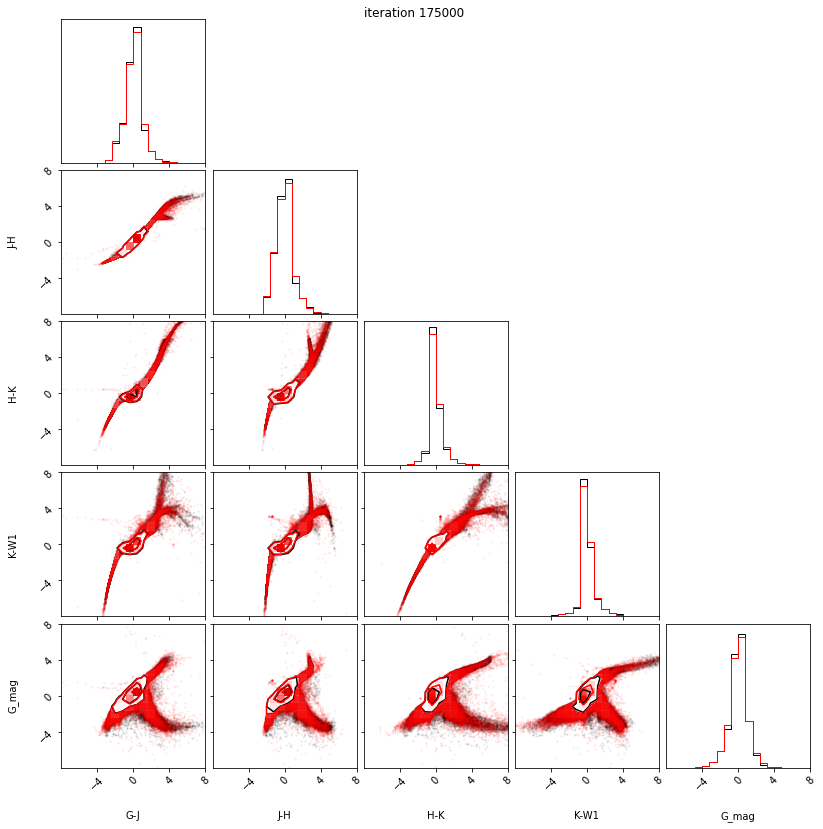

175100 -6.0386857986450195 -6.3195109367370605 0.11433219909667969 -inf
175200 -6.264250755310059 -6.3248515129089355 -0.07177448272705078 -inf
175300 -6.288930892944336 -6.318868637084961 0.07474470138549805 -inf
175400 -6.255853176116943 -6.123359680175781 -0.08418798446655273 -inf
175500 -5.969699859619141 -6.233763694763184 0.23243284225463867 -inf
175600 -5.8499908447265625 -5.6252241134643555 -0.0015215873718261719 -inf
175700 -5.046983242034912 -3.960362672805786 -0.45075511932373047 -inf
175800 -6.071337699890137 -6.187006950378418 0.10882759094238281 -inf
175900 -5.706894874572754 -6.10151481628418 -0.49676942825317383 -inf
176000 -6.318615913391113 -6.352024078369141 0.07738399505615234 -inf
0.07738399505615234 -inf


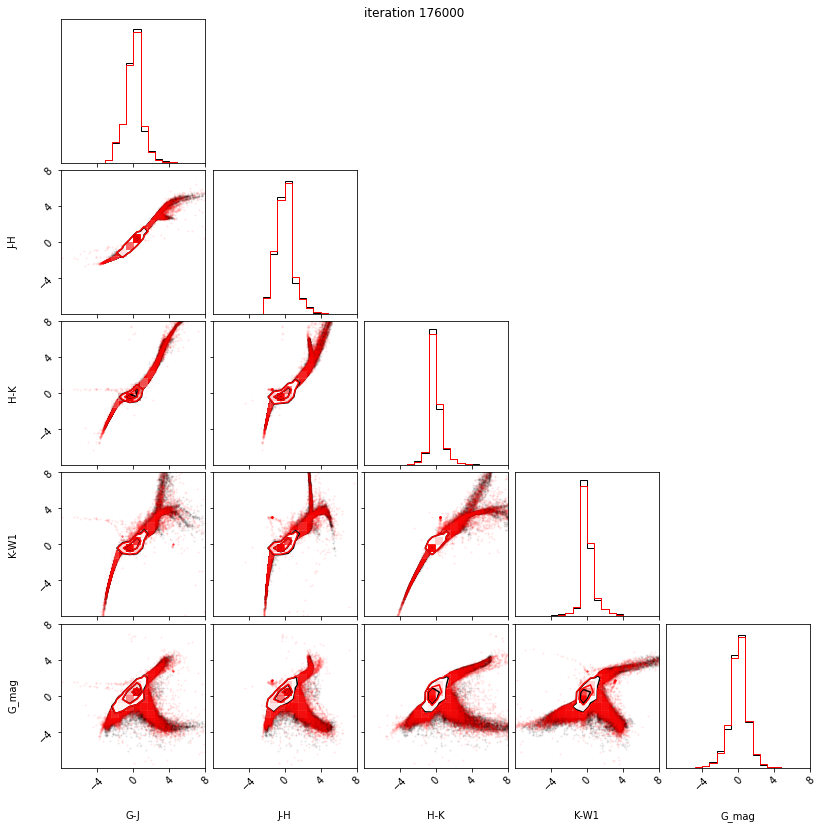

176100 -6.4383320808410645 -6.4199538230896 0.018931865692138672 -inf
176200 -6.334543704986572 -6.361583232879639 -0.4524698257446289 -inf
176300 -6.1098222732543945 -5.987468719482422 0.3746199607849121 -inf
176400 -5.742666721343994 -6.397767066955566 -0.1767416000366211 -inf
176500 -4.8975830078125 -3.148052215576172 -0.13483524322509766 -inf
176600 -6.138432025909424 -5.595813274383545 0.26874303817749023 -inf
176700 -4.785519599914551 -6.084723472595215 0.054053306579589844 -inf
176800 -4.488090991973877 -6.013535976409912 -0.0438542366027832 -inf
176900 -6.32874059677124 -6.257095813751221 0.047955989837646484 -inf
177000 -5.218001842498779 -3.4835357666015625 0.09848785400390625 -inf
0.09848785400390625 -inf


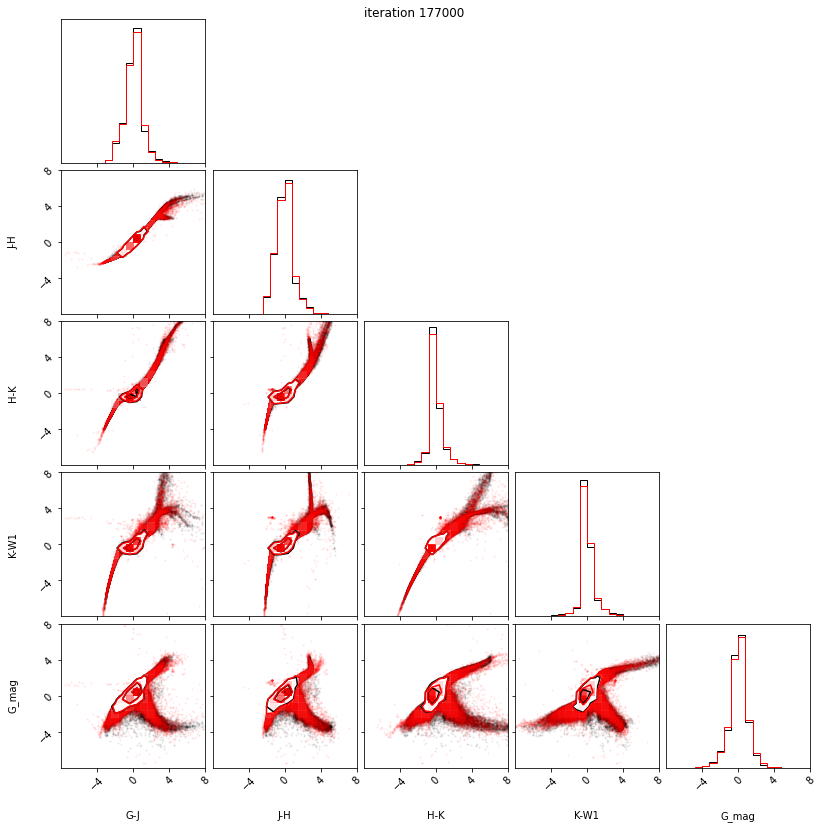

177100 -5.9187912940979 -5.7201151847839355 -0.156951904296875 -inf
177200 -6.155118942260742 -6.322383880615234 0.14927196502685547 -inf
177300 -6.224251747131348 -6.35476016998291 0.022502422332763672 -inf
177400 -5.836038112640381 -6.053187847137451 0.26419687271118164 -inf
177500 -6.3424224853515625 -6.341619968414307 -0.048043251037597656 -inf
177600 -6.357067584991455 -6.41060209274292 -0.1756906509399414 -inf
177700 -6.387375831604004 -6.4017205238342285 0.04373741149902344 -inf
177800 -6.3725504875183105 -6.409041404724121 0.007965564727783203 -inf
177900 -5.9455180168151855 -6.097434043884277 -0.03526782989501953 -inf
178000 -6.345836162567139 -6.442130088806152 -0.06363773345947266 -inf
-0.06363773345947266 -inf


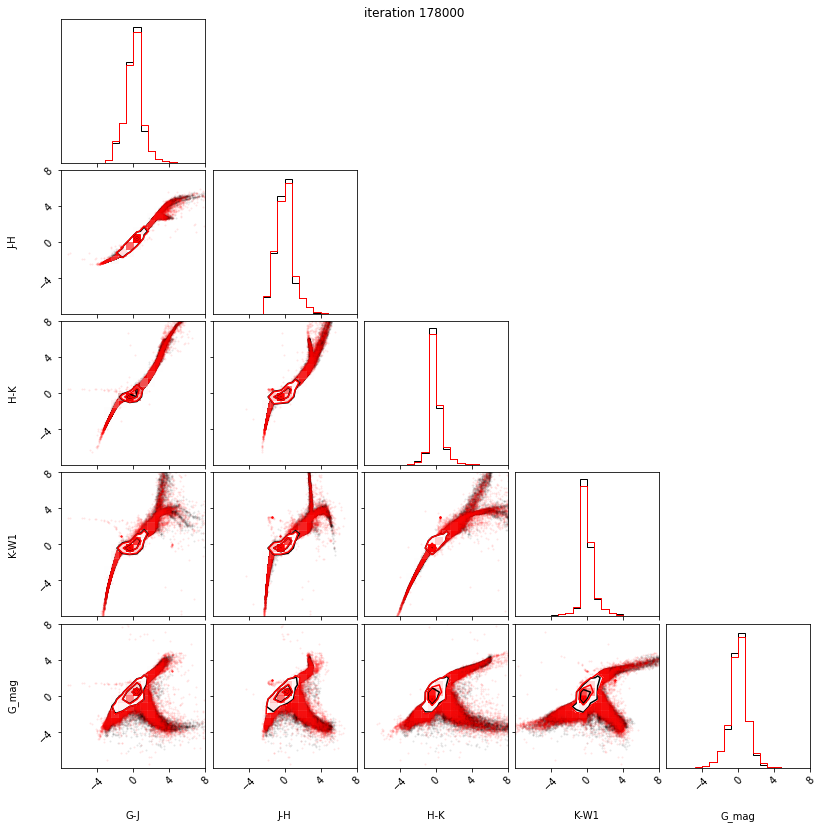

178100 -6.240108489990234 -6.251321792602539 0.20374250411987305 -inf
178200 -4.847364902496338 -5.062558650970459 0.3887972831726074 -inf
178300 -6.350369453430176 -5.821746349334717 0.2711477279663086 -inf
178400 -5.43824577331543 -4.859896183013916 0.33648157119750977 -inf
178500 -6.326530933380127 -6.245284080505371 0.1913909912109375 -inf
178600 -6.3408942222595215 -6.281442642211914 0.018917083740234375 -inf
178700 -5.978128433227539 -5.9345293045043945 -0.29927682876586914 -inf
178800 -5.812216281890869 -5.67838191986084 -0.3873324394226074 -inf
178900 -6.078235626220703 -6.258471488952637 0.47765111923217773 -inf
179000 -6.4604716300964355 -6.453343391418457 0.05519819259643555 -inf
0.05519819259643555 -inf


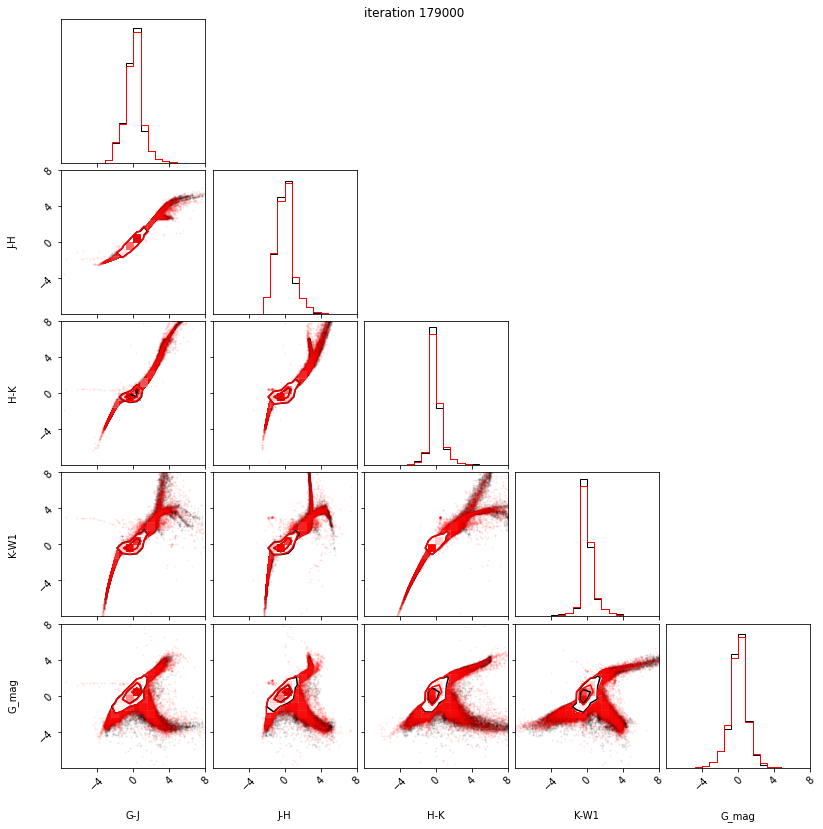

179100 -6.4871296882629395 -6.514492034912109 0.2962970733642578 -inf
179200 -4.504969120025635 -6.118773937225342 0.23862218856811523 -inf
179300 -5.908964157104492 -5.7408127784729 0.18401765823364258 -inf
179400 -6.233769416809082 -6.097275733947754 0.18971538543701172 -inf
179500 -6.245261192321777 -6.242983818054199 0.0686488151550293 -inf
179600 -5.272223949432373 -5.144944190979004 0.17093181610107422 -inf
179700 -6.288639545440674 -6.229192733764648 0.2512950897216797 -inf
179800 -5.868547439575195 -6.170297622680664 0.01301431655883789 -inf
179900 -6.026933670043945 -5.734360694885254 -0.1358804702758789 -inf
180000 -6.1348748207092285 -6.046764850616455 -0.03991413116455078 -inf
-0.03991413116455078 -inf


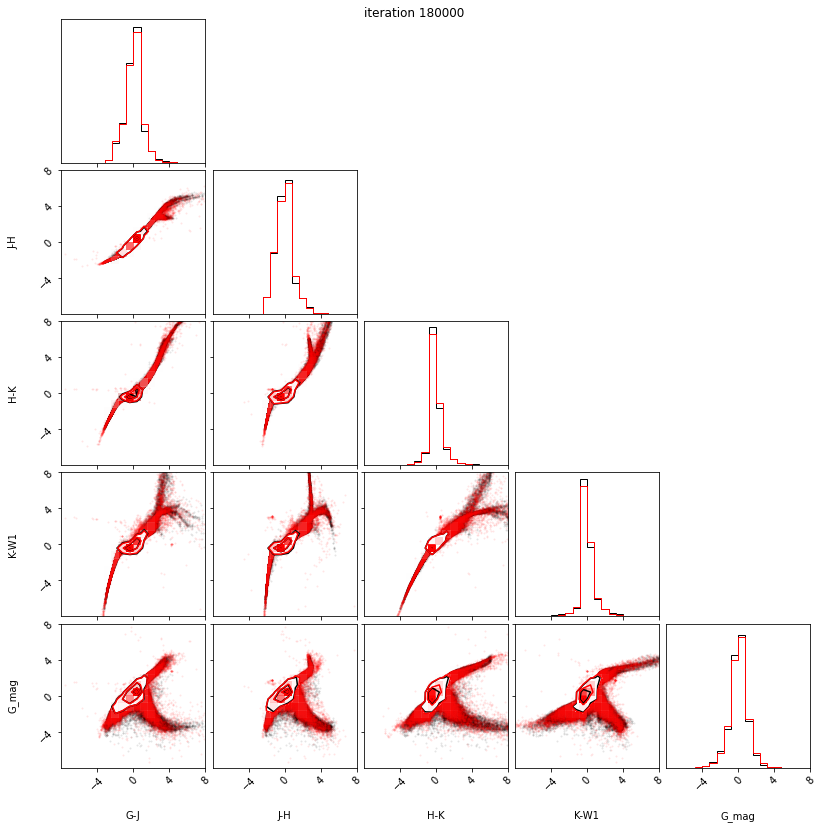

180100 -6.467225074768066 -6.4746928215026855 -0.040578365325927734 -inf
180200 -6.441428184509277 -6.397467613220215 0.04492330551147461 -inf
180300 -6.235416889190674 -5.658464431762695 0.2633495330810547 -inf
180400 -5.9297356605529785 -5.976232051849365 0.14954185485839844 -inf
180500 -6.215963840484619 -5.994856834411621 0.07550048828125 -inf
180600 -6.461650371551514 -6.483597278594971 0.022216796875 -inf
180700 -6.174760341644287 -6.278775215148926 -0.06954240798950195 -inf
180800 -6.412148952484131 -6.421717643737793 -0.04143333435058594 -inf
180900 -6.3335418701171875 -6.283633232116699 0.16229724884033203 -inf
181000 -5.441606044769287 -5.931952476501465 0.12293243408203125 -inf
0.12293243408203125 -inf


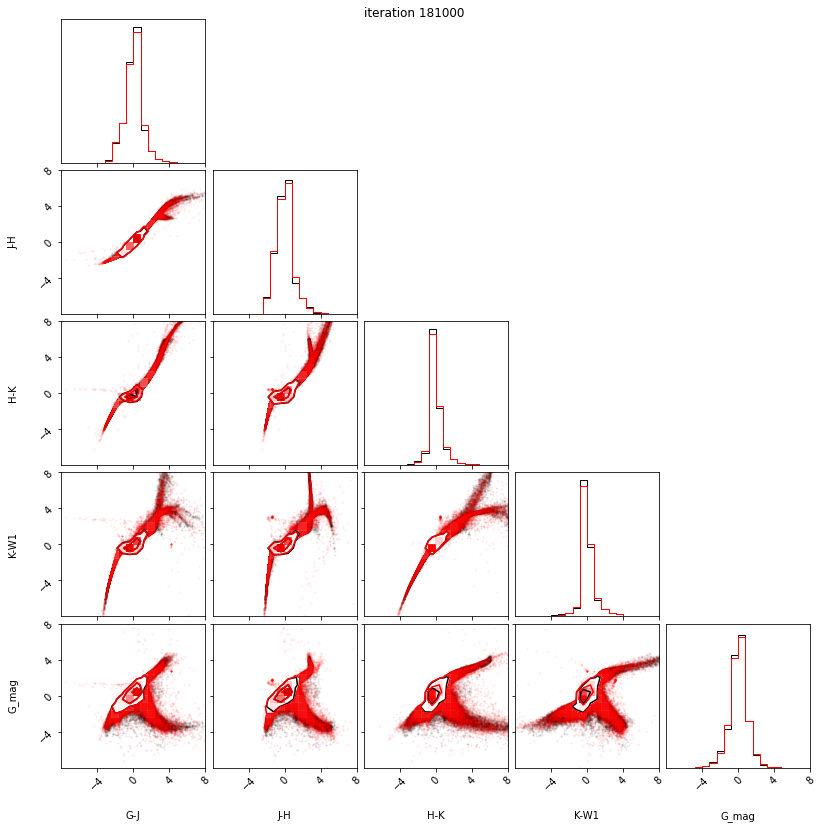

181100 -6.354751110076904 -6.369809627532959 -0.03100442886352539 -inf
181200 -6.30064058303833 -6.361205101013184 0.09652996063232422 -inf
181300 -6.031219959259033 -6.27443790435791 -0.20312023162841797 -inf
181400 -5.857995510101318 -5.2284836769104 0.050083160400390625 -inf
181500 -6.3125410079956055 -5.862857818603516 0.32640647888183594 -inf
181600 -5.619295120239258 -4.581107139587402 0.016026020050048828 -inf
181700 -6.372005939483643 -6.263289451599121 0.3156161308288574 -inf
181800 -6.1381707191467285 -5.977851390838623 0.03991413116455078 -inf
181900 -6.4246602058410645 -6.413493633270264 0.13659381866455078 -inf
182000 inf 5.320385944972013e+25 -53.65050506591797 -inf
-53.65050506591797 -inf


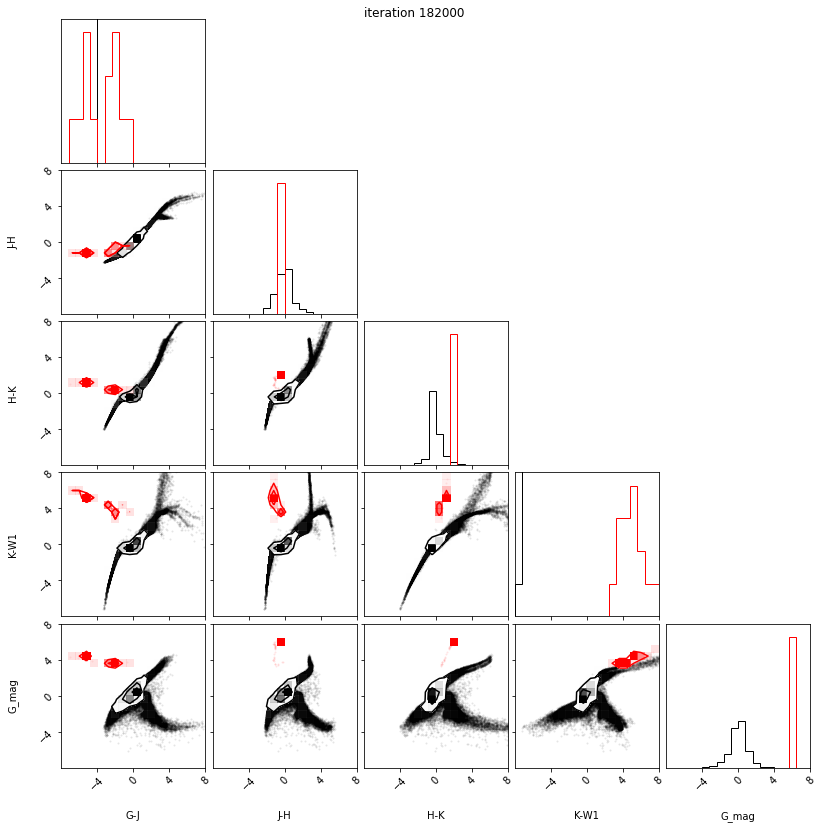

182100 inf 3.597280423317123e+25 -154.32070922851562 -inf
182200 inf 3.4884630800263105e+25 -1172.4586181640625 -inf
182300 inf 3.4233624449314812e+25 -3485.01708984375 -inf
182400 inf 3.381331538559534e+25 -3939.068603515625 -inf
182500 inf 3.37265395956296e+25 -5937.57421875 -inf
182600 inf 3.3636978347308732e+25 -10825.0751953125 -inf
182700 inf 3.3636039869203982e+25 -17761.939453125 -inf
182800 inf 3.3635209765720665e+25 -22712.892578125 -inf
182900 inf 3.330611062807365e+25 -29582.818359375 -inf
183000 inf 3.3305243631102186e+25 -34225.72265625 -inf
-34225.72265625 -inf


/mnt/home/landerson/src/nflows/nflows/lib/python3.7/site-packages/corner/corner.py:387: UserWarning: Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.
  ax.set_ylim(0, 1.1 * np.max(n))
/mnt/home/landerson/src/nflows/nflows/lib/python3.7/site-packages/corner/corner.py:714: RuntimeWarning: invalid value encountered in true_divide
  sm /= sm[-1]
/mnt/home/landerson/src/nflows/nflows/lib/python3.7/site-packages/corner/corner.py:718: RuntimeWarning: invalid value encountered in less_equal
  V[i] = Hflat[sm <= v0][-1]


In [ ]:
num_iter = 100000
num_samples = int(nsamplesdata)
start = 0

torch.set_default_tensor_type('torch.cuda.FloatTensor')
for i in range(start, epochs):
    trloss = 0.0
    tsloss = 0.0
    for (X,) in train:
        optimizer.zero_grad()
        X = X.to(device)
        trainloss = -flow.log_prob(inputs=X).mean()
        trainloss.backward()
        optimizer.step()
        trloss += trainloss
        
    for (X,) in test:
        optimizer.zero_grad()
        X = X.to(device)
        testloss = -flow.log_prob(inputs=X).mean()
        tsloss += testloss
        
    sched.step()
    
    if (i + 1) % 100 == 0:
        logp = flow.log_prob(inputs=xyinput.to(device))

        print(i+1, trloss.item(), tsloss.item(), torch.max(logp).item(), torch.min(logp).item())

    
    if (i + 1) % 1000 == 0:
        logp = flow.log_prob(inputs=xyinput.to(device))
        print(torch.max(logp).item(), torch.min(logp).item())
        with torch.no_grad():
            samples = flow.sample(num_samples).detach().cpu().numpy()
            #samples = ss.inverse_transform(flow.sample(num_samples).detach().cpu().numpy())
        fig = corner.corner(data, labels=labels, range=binrange_ss)
        corner.corner(samples, label=labels, range=binrange_ss, fig=fig, color='red')
        fig.suptitle('iteration {}'.format(i + 1))
        plt.savefig(f'checkpoint{i+1}epochs_cycle_gpu_nsamples{nsamplesdata}.pdf', rasterized=True)

        checkpoint = {
                'epoch': i,
                'model': flow.state_dict(),
                'optimizer': optimizer.state_dict(),
                'lr_sched': sched,
                'loss':tsloss}
        torch.save(checkpoint, f'checkpoint{i+1}epochs_cycle_gpu_nsamples{nsamplesdata}.pth')

In [ ]:
checkpoint = {
                'epoch': i,
                'model': flow.state_dict(),
                'optimizer': optimizer.state_dict(),
                'lr_sched': sched,
                'loss':tsloss}
torch.save(checkpoint, f'checkpoint{i}epochs_cycle.pth')